# Inspect Jingcheng's biophysical modeling results (Heatmap Part)

In [1]:
import os
import json
import pandas as pd
import numpy as np
import scipy.stats as st
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.patches import Patch
import warnings
from scipy.signal import find_peaks, butter, filtfilt
from scipy.optimize import curve_fit
from scipy.ndimage import binary_opening, label
import seaborn as sns

# ignore runtime warning
warnings.filterwarnings("ignore", category=RuntimeWarning)

root_folder_path = '/G/results/simulation/'

In [2]:
def load_data(exp):
    
    try:
        v_path = [root_folder_path, exp, 'dend_v_array.npy']
        i_path = [root_folder_path, exp, 'dend_i_array.npy']
        nmda_path = [root_folder_path, exp, 'dend_nmda_i_array.npy']
        ampa_path = [root_folder_path, exp, 'dend_ampa_i_array.npy']
        
        nmda_g_path = [root_folder_path, exp, 'dend_nmda_g_array.npy']
        ampa_g_path = [root_folder_path, exp, 'dend_ampa_g_array.npy']
        
        soma_path = [root_folder_path, exp, 'soma_v_array.npy']
        apic_v_path = [root_folder_path, exp, 'apic_v_array.npy']
        apic_ica_path = [root_folder_path, exp, 'apic_ica_array.npy']

        soma_i_path = [root_folder_path, exp, 'soma_i_array.npy']
            
        trunk_v_path = [root_folder_path, exp, 'trunk_v_array.npy']
        basal_v_path = [root_folder_path, exp, 'basal_v_array.npy']
        tuft_v_path = [root_folder_path, exp, 'tuft_v_array.npy']

        basal_bg_i_nmda_path = [root_folder_path, exp, 'basal_bg_i_nmda_array.npy']
        basal_bg_i_ampa_path = [root_folder_path, exp, 'basal_bg_i_ampa_array.npy']
        tuft_bg_i_nmda_path = [root_folder_path, exp, 'tuft_bg_i_nmda_array.npy']
        tuft_bg_i_ampa_path = [root_folder_path, exp, 'tuft_bg_i_ampa_array.npy']

        v = np.load(os.path.join(*v_path))
        i = np.load(os.path.join(*i_path))
        nmda = np.load(os.path.join(*nmda_path))
        ampa = np.load(os.path.join(*ampa_path))
        
        nmda_g = np.load(os.path.join(*nmda_g_path))
        ampa_g = np.load(os.path.join(*ampa_g_path))
        
        soma = np.load(os.path.join(*soma_path))
        apic_v = np.load(os.path.join(*apic_v_path))
        apic_ica = np.load(os.path.join(*apic_ica_path))

        soma_i = np.load(os.path.join(*soma_i_path))

        trunk_v = np.load(os.path.join(*trunk_v_path))
        basal_v = np.load(os.path.join(*basal_v_path))
        tuft_v = np.load(os.path.join(*tuft_v_path))

        basal_bg_i_nmda = np.load(os.path.join(*basal_bg_i_nmda_path))
        basal_bg_i_ampa = np.load(os.path.join(*basal_bg_i_ampa_path))
        tuft_bg_i_nmda = np.load(os.path.join(*tuft_bg_i_nmda_path))
        tuft_bg_i_ampa = np.load(os.path.join(*tuft_bg_i_ampa_path)) 

    except FileNotFoundError:
        pass

    dt = 1/40000

    # read info from json and add to plot
    with open(os.path.join(root_folder_path, exp, 'simulation_params.json')) as f:
        simu_info = json.load(f)
    
    with open(os.path.join(root_folder_path, exp, 'section_synapse_df.csv')) as f:
        sec_syn_df = pd.read_csv(f)

    try:
        return v, i, nmda, ampa, nmda_g, ampa_g, soma, apic_v, apic_ica, soma_i, \
               trunk_v, basal_v, tuft_v, basal_bg_i_nmda, basal_bg_i_ampa, \
               tuft_bg_i_nmda, tuft_bg_i_ampa, dt, simu_info, sec_syn_df
    
    except NameError:
        return simu_info, sec_syn_df
    
def count_subfolders(root_folder_path, exp):
    folder_path = os.path.join(root_folder_path, exp)
    all_items = os.listdir(folder_path)
    subfolders = [item for item in all_items if os.path.isdir(os.path.join(folder_path, item))]
    return len(subfolders)

def find_num_peaks(voltage_array):
    num_peaks = len(find_peaks(voltage_array, height=0)[0])
    return num_peaks

def find_longest_continuous_ones(bool_array):
    max_length = 0
    current_length = 0

    for value in bool_array:
        if value == 1:
            current_length += 1
            max_length = max(max_length, current_length)
        else:
            current_length = 0

    return max_length

# Create a Butterworth low-pass filter
def butter_lowpass(cutoff, fs, order=5):
    nyquist = 0.5 * fs  # 奈奎斯特频率
    normal_cutoff = cutoff / nyquist  # 归一化截止频率
    b, a = butter(order, normal_cutoff, btype='low', analog=False)  # 巴特沃斯低通滤波器
    return b, a

# Apply a Butterworth low-pass filter
def lowpass_filter(data, cutoff=50, fs=40000, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = filtfilt(b, a, data)  # 应用双向滤波器
    return y

def detect_nmda_spike(voltage_array):
    min_length = 26 * 40
    structure = np.ones(min_length)

    # 对序列进行形态学开运算
    opened_sequence = binary_opening(voltage_array, structure=structure).astype(int)

    # 对开运算后的序列进行标记，找到每个连续1的区段
    labeled_sequence, num_features = label(opened_sequence)

    # 找出每个特征区段的起始索引（onset）
    unique_labels, first_indices = np.unique(labeled_sequence, return_index=True)

    # 排除标签为0的部分（即非1的部分）
    onsets = first_indices[unique_labels != 0]

    t = 500
    spike_flag = 1 if np.any((onsets >= (t-30)*40) & (onsets <= (t+30)*40)) else 0

    return spike_flag

def detect_calcium_spike(voltage_array):
    min_length = 26 * 40
    structure = np.ones(min_length)

    opened_sequence = binary_opening(voltage_array, structure=structure).astype(int)
    labeled_sequence, num_features = label(opened_sequence)
    unique_labels, first_indices = np.unique(labeled_sequence, return_index=True)
    onsets = first_indices[unique_labels != 0]

    t = 500
    spike_flag = 1 if np.any((onsets >= (t-30)*40) & (onsets <= (t+100)*40)) else 0

    return spike_flag

def align_calcium_voltage_trace(apic_v, t_start, t_end, t_center):

    # align calcium
    # Assuming apic_v is your array with shape [40000, 40, 20]
    # Extract the 16000-24000 segment from the second dimension
    apic_v_segment = apic_v[t_start:t_end, :, :]  # Shape: [8000, 40, 20]

    # Find the peak index in the extracted segment
    peak_indices = np.argmax(apic_v_segment, axis=0)  # Shape: [40, 20]

    # Reference peak index (for the first trial in each cluster)
    peak_positions = peak_indices + t_start  # Shape: [40, 20]

    # Find peak values to check if they are greater than -40 mV
    peak_values = np.max(apic_v_segment, axis=0)  # Shape: [40, 20]

    # Mask for peaks greater than -40 mV
    valid_mask = peak_values > -40  # Shape: [40, 20]

    # Initialize an array to store the reference trial indices
    ref_trial_index = np.full(apic_v.shape[1], -1, dtype=int)  # Shape: [40]

    for epoch_idx in range(apic_v.shape[1]):
        valid_trials = np.where(valid_mask[epoch_idx])[0]
        if valid_trials.size > 0:
            closest_trial = valid_trials[np.argmin(np.abs(peak_positions[epoch_idx, valid_trials] - t_center))]
            ref_trial_index[epoch_idx] = closest_trial

    # 计算参考峰值位置
    ref_peak_positions = peak_positions[np.arange(apic_v.shape[1]), ref_trial_index]  # Shape: [40]

    # 计算滚动偏移量
    shifts = ref_peak_positions[:, np.newaxis] - peak_positions  # Shape: [40, 20]

    # 对于不满足条件的项，将 shift 设置为 0
    shifts[~valid_mask] = 0  # Shape: [40, 20]

    # 创建对齐后的结果数组
    aligned_apic_v = np.empty_like(apic_v)

    # 使用 np.roll 对满足条件的数据进行滚动
    for epoch_idx in range(apic_v_segment.shape[1]):
        for trial_idx in range(apic_v_segment.shape[2]):
            shift = int(shifts[epoch_idx, trial_idx])
            aligned_apic_v[:, epoch_idx, trial_idx] = np.roll(
                apic_v[:, epoch_idx, trial_idx], shift, axis=0
            )

    return aligned_apic_v

def mark_peaks(signal):
    peaks, _ = find_peaks(signal, height=0)
    peak_signal = np.zeros_like(signal)
    peak_signal[peaks] = 1
    return peak_signal

def soma_bin_peak(soma_segment, binsize=400, dt=1/40000):

    num_times = soma_segment.shape[0]
    num_affs = soma_segment.shape[1]
    num_bins = num_times // binsize

    ap_boolean = np.apply_along_axis(mark_peaks, axis=0, arr=soma_segment) # Shape: [num_times, num_affs, num_trials] 
    binned_ap_boolean = np.mean(ap_boolean.reshape(num_bins, binsize, num_affs, -1), axis=1) # Shape: [num_bins, num_affs, num_trials]

    # f = sum of spikes / (num_trials * duration)
    binned_firing_rate = np.mean(binned_ap_boolean, axis=-1) / dt # Shape: [num_times, num_affs] 
    peak_firing_rate = np.max(binned_firing_rate, axis=0)
    
    return peak_firing_rate

In [39]:
def find_v_array(folder_path, data_type):
    if data_type == 'Soma':
        return np.load(os.path.join(folder_path, 'soma_v_array.npy'))
    elif data_type == 'Nexus':
        return np.load(os.path.join(folder_path, 'apic_v_array.npy'))
    elif data_type == 'Dend':
        return np.load(os.path.join(folder_path, 'dend_v_array.npy'))

def calculate_mag_values(folder_path, num_epochs=1, data_type='', attr_type='Peak'):
    t = 500
    dt = 1/40000
    t_start, t_end = (t-20)*40, (t+100)*40
    x = np.arange(0, t_end-t_start)*dt

    mag_values = []
    root_v_list = []

    for epoch in range(1, num_epochs+1):
        epoch_folder_path = os.path.join(folder_path, f'{epoch}')
        
        if data_type == 'Soma':
            try:
                soma = find_v_array(epoch_folder_path, data_type)
                if soma.ndim == 4:
                    soma = np.mean(soma, axis=1)
                    soma_baseline = np.median(soma[(t+200)*40:(t+400)*40, :, :]) # shape: [num_times, num_affs, num_trials]
                if attr_type == 'Peak':
                    # peak
                    peak_soma_spikes = np.max(soma[t_start:t_end,:,:])-np.min(soma[t_start:t_end,:,:])
                    mag_values.append(peak_soma_spikes) 
                elif attr_type == 'Area':
                    # area
                    soma_over_baseline = np.clip(soma[t_start:t_end, :, :] - soma_baseline, 0, None)
                    area_soma_spikes = np.mean(np.trapz(soma_over_baseline, x, axis=0)) # np.mean(np.trapz(calcium_positive, x, axis=0), axis=1)
                    mag_values.append(area_soma_spikes)
                # Average soma voltage trace
                root_v_list.append(np.average(soma[t_start:t_end, 0, :],axis=1)-soma_baseline)
                
            except FileNotFoundError:
                pass

        elif data_type == 'Nexus':
            try:
                apic_v = find_v_array(epoch_folder_path, data_type)
                if apic_v.ndim == 4:
                    apic_v = np.mean(apic_v, axis=1)
                    nexus_baseline = np.median(apic_v[(t-200)*40:(t+400)*40, :, :]) # shape: [num_times, num_affs, num_trials]
                if attr_type == 'Peak':
                    # peak
                    peak_nexus_spikes = np.max(apic_v[t_start:t_end,:,:])-np.min(apic_v[t_start:t_end,:,:])
                    mag_values.append(peak_nexus_spikes) 
                elif attr_type == 'Area':
                    # area
                    nexus_over_baseline = np.clip(apic_v[t_start:t_end, :, :] - nexus_baseline, 0, None)
                    area_nexus_spikes = np.mean(np.trapz(nexus_over_baseline, x, axis=0)) # np.mean(np.trapz(calcium_positive, x, axis=0), axis=1)
                    mag_values.append(area_nexus_spikes)
                # Average apical nexus voltage trace
                root_v_list.append(np.average(apic_v[t_start:t_end, 0, :],axis=1)-nexus_baseline)

            except FileNotFoundError:
                pass

        elif data_type == 'Dend':
            try:
                dend_v = find_v_array(epoch_folder_path, data_type)
                if dend_v.ndim == 5:
                    dend_v = np.mean(dend_v, axis=2)
                    dend_baseline = np.median(dend_v[:,(t+200)*40:(t+400)*40, :, :])
                if attr_type == 'Peak':
                    mag_values.append(np.max(dend_v[:,t_start:t_end,:,:])-np.min(dend_v[:,t_start:t_end,:,:]))
                elif attr_type == 'Area':
                    dend_over_baseline = np.clip(np.mean(dend_v[:,t_start:t_end, :, :], axis=3) - dend_baseline, 0, None)
                    mag_values.append(np.mean(np.trapz(dend_over_baseline, x, axis=1)))
                # Average dend voltage trace
                root_v_list.append(np.average(dend_v[:, t_start:t_end, 0, :], axis=(0, 2))-dend_baseline)
                
            except FileNotFoundError:
                pass
    
    mean_mag_val = np.mean(mag_values)
    mean_root_v = np.mean(root_v_list, axis=0)
    std_root_v = np.std(root_v_list, axis=0)
    
    return mean_mag_val, mean_root_v, std_root_v
    
def create_matrix(root_folder_path, folder_path, num_syn_per_clus, num_clus, num_epochs=1, data_type='', attr_type='Peak'):
    
    mean_mag_val_mat = np.zeros((len(num_syn_per_clus), len(num_clus)))
    # Use dtype=object to store ndarrays
    mean_root_v_mat = np.zeros((len(num_syn_per_clus), len(num_clus)), dtype=object)  
    std_root_v_mat = np.zeros((len(num_syn_per_clus), len(num_clus)), dtype=object)  

    for subfolder_name in os.listdir(os.path.join(root_folder_path, folder_path)):
        subfolder_path = os.path.join(root_folder_path, folder_path, subfolder_name)
        if os.path.isdir(subfolder_path):
            # Read the simulation_params.json file from the 1st epoch folder
            params_file_path = os.path.join(subfolder_path, '1', 'simulation_params.json')
            with open(params_file_path, 'r') as f:
                params = json.load(f)
            syn_per_clus = params['number of synapses per cluster']
            clus = params['number of clusters']

            i = num_syn_per_clus.index(syn_per_clus)
            j = num_clus.index(clus)

            mean_mag_val, mean_root_v, std_root_v = calculate_mag_values(subfolder_path, num_epochs, data_type, attr_type)
        
            mean_mag_val_mat[i, j] = mean_mag_val
            mean_root_v_mat[i, j] = mean_root_v
            std_root_v_mat[i, j] = std_root_v

    print( "{:.2e}".format(np.min(mean_mag_val_mat)), 
           "{:.2e}".format(np.max(mean_mag_val_mat)))

    return mean_mag_val_mat, mean_root_v_mat, std_root_v_mat

def scale_and_visualize_matrix(matrix, title, data_type, attr_type):
    scaled_matrix = matrix

    if data_type == 'Soma':
        if attr_type == 'Peak':
            vmin, vmax = 0, 60 
        elif attr_type == 'Area':
            vmin, vmax = 0, 2.6
    elif data_type == 'Nexus':
        if attr_type == 'Peak':
            vmin, vmax = 0, 65
        elif attr_type == 'Area':
            vmin, vmax = 0, 7
    else:
        vmin, vmax = None, None  # Default range
        
    plt.figure(figsize=(6, 5))
    sns.heatmap(scaled_matrix[::-1], annot=True, cmap='viridis', 
                xticklabels=num_clus, yticklabels=num_syn_per_clus[::-1],
                vmin=vmin, vmax=vmax)
    plt.title(title)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Number of Preunits per Cluster')

    res_path = os.path.join(root_folder_path, 'matrices_results')
    if not os.path.exists(res_path):
        os.makedirs(res_path)
    plt.savefig(f'{res_path}/{title}.pdf')

def analyze_case(root_folder_path, folder_path, num_syn_per_clus, num_clus, num_epochs=1, case_name='', data_type='',attr_type='Peak'):
    mag_val_mat, root_v_mat, std_root_v_mat = create_matrix(root_folder_path, folder_path, num_syn_per_clus, num_clus, num_epochs, data_type, attr_type)
    # scale_and_visualize_matrix(mag_val_mat, f'{case_name} {data_type} {attr_type} Case', data_type, attr_type)
    
    return mag_val_mat, root_v_mat, std_root_v_mat

def calculate_ratio_and_draw_heatmap(mag_val_mat1, mag_val_mat2, 
                                     root_v_mat1, root_v_mat2, 
                                     std_root_v_mat1, std_root_v_mat2,
                                     title, attr1, attr2):
    
    res_path = os.path.join(root_folder_path, 'matrices_results')

    # ratio_matrix = mag_val_mat1 / mag_val_mat2
    # plt.figure(figsize=(6, 5))
    # sns.heatmap(ratio_matrix[::-1], annot=True, cmap='coolwarm',
    #             xticklabels=num_clus, yticklabels=num_syn_per_clus[::-1], center=1,
    #             vmin=0.5, vmax=2)
    
    # if 'NMDA vs non-NMDA' in title: 
    #     plt.suptitle('Ratio of NMDA to non-NMDA ' + title)
    # else:
    #     plt.suptitle('Ratio of Clustered to Dispersed ' + title)
        
    # plt.xlabel('Number of Clusters')
    # plt.ylabel('Number of Preunits per Cluster')

    # if not os.path.exists(res_path):
    #     os.makedirs(res_path)
    # plt.savefig(f'{res_path}/{title}.pdf')

    num_rows, num_cols = root_v_mat1.shape
    _, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols*1.2, num_rows*1.4)) 

    if 'NMDA vs non-NMDA' in title: 
        plt.suptitle('Ratio of NMDA to non-NMDA ' + title, fontsize=16)
    else:
        plt.suptitle('Ratio of Clustered to Dispersed ' + title, fontsize=16)

    t, dt = 500, 1/40000
    t_start, t_end = (t-20)*40, (t+100)*40
    t_vals = np.arange(t_start, t_end)*dt-t/1000
    
    # # Give the global max and min for two mats
    # all_root_v = [arr for arr in np.concatenate((root_v_mat1.flatten(), root_v_mat2.flatten())) if arr is not None]
    # root_v1_min = root_v2_min =  min(np.min(arr) for arr in all_root_v)
    # root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)
    
    # Iterate over each subplot and plot the corresponding avg_root_v array
    for i in range(num_rows):
        for j in range(num_cols):
            # Flip the row index to plot [1,1] at the lower-left and [num_rows, num_cols] at the upper-right
            ax = axes[num_rows-1-i, j]
            # ax = axes[i, j]
            root_v1 = root_v_mat1[i, j]
            root_v2 = root_v_mat2[i, j]

            std_root_v1 = std_root_v_mat1[i, j]
            std_root_v2 = std_root_v_mat2[i, j]

            # scaled_root_v1 = (root_v1 - root_v1_min) / (root_v1_max - root_v1_min)
            # scaled_root_v2 = (root_v2 - root_v2_min) / (root_v2_max - root_v2_min)

            # scaled_std_root_v1 = std_root_v1 / (root_v1_max - root_v1_min)
            # scaled_std_root_v2 = std_root_v2 / (root_v2_max - root_v2_min)

            scaled_root_v1, scaled_root_v2, \
            scaled_std_root_v1, scaled_std_root_v2 = root_v1, root_v2, \
                                                     std_root_v1, std_root_v2
            
            ax.plot(t_vals, scaled_root_v1, color='r') # clustered
            ax.fill_between(t_vals, scaled_root_v1 - scaled_std_root_v1, scaled_root_v1 + scaled_std_root_v1, color='r', alpha=0.3)
            ax.plot(t_vals, scaled_root_v2, color='b') # dispersed
            ax.fill_between(t_vals, scaled_root_v2 - scaled_std_root_v2, scaled_root_v2 + scaled_std_root_v2, color='b', alpha=0.3)
            ax.set_xlim(-0.02, 0.05)
            ax.set_ylim(-15, 70)
            # ax.set_yticks([-10, 30, 70])
            ax.hlines([30, 70], -0.02, 0.05, color='k', linestyle='--', linewidth=1)
            # add text to show max of root_v1 and v2
            ax.text(0.5, 0.6, f'r:{np.max(scaled_root_v1):.1f},b:{np.max(scaled_root_v2):.1f}', 
                    transform=ax.transAxes, va='center', ha='center', fontsize=6, fontweight='demibold')

            if j != 0:  # Not the leftmost column
                ax.set_yticks([])  # Remove y-axis ticks
                ax.spines["left"].set_visible(False)  # Remove left spine
            if i != 0:  # Not the bottom row
                ax.set_xticks([])  # Remove x-axis ticks
                ax.spines["bottom"].set_visible(False)  # Remove bottom spine

            if j == 0:
                ax.set_ylabel(f'{num_syn_per_clus[i]} synapses')
            if i == 0:
                ax.set_xlabel(f'{num_clus[j]} clusters')
            
            # Set label for two atrributes
            if i == 0 and j == num_cols-1:
                legend_patches = [
                Patch(facecolor='red', edgecolor='red', label=attr1, alpha=0.5),
                Patch(facecolor='blue', edgecolor='blue', label=attr2, alpha=0.5)]
                ax.legend(handles=legend_patches, loc='upper right', fontsize=6, frameon=True)

             # Remove upper and right spines (bounds)
            ax.spines["top"].set_visible(False)
            ax.spines["right"].set_visible(False)
    
    plt.tight_layout()
    plt.savefig(f'{res_path}/{title}_root_v.pdf')

def full_analyze_case(simu_cond1='clus_invitro_variedW', simu_cond2='distr_invitro_variedW', anal_loc='basal', record_loc='Soma', record_attr='Peak', range=0, num_epochs=20):
    # Clustered case
    clus_mag_val_mat, clus_root_v_mat, clus_std_root_v_mat = analyze_case(root_folder_path, anal_loc+f'_range{range}_'+simu_cond1, num_syn_per_clus, num_clus, num_epochs, simu_cond1+' '+anal_loc+' (Range 0)', record_loc, record_attr)
    # Dispersed case
    distr_mag_val_mat, distr_root_v_mat, distr_std_root_v_mat = analyze_case(root_folder_path, anal_loc+f'_range{range}_'+simu_cond2, num_syn_per_clus, num_clus, num_epochs, simu_cond2+' '+anal_loc+' (Range 0)', record_loc, record_attr)
 
    return clus_mag_val_mat, distr_mag_val_mat, \
           clus_root_v_mat, distr_root_v_mat, \
           clus_std_root_v_mat, distr_std_root_v_mat

def full_visualization_ver2(exp, k, fig, ax, data_type, stack_flag, exp_idx, alpha=1):
    try:
        v, i, nmda, ampa, nmda_g, ampa_g, soma, apic_v, apic_ica, soma_i, \
        trunk_v, basal_v, tuft_v, basal_bg_i_nmda, basal_bg_i_ampa, \
        tuft_bg_i_nmda, tuft_bg_i_ampa, dt, simu_info, sec_syn_df = load_data(exp)
    
    except ValueError:
        v, i, nmda, ampa, nmda_g, ampa_g, soma, apic_v, apic_ica, dt, simu_info = load_data(exp)
    
    if v.ndim == 5:
        v = np.mean(v, axis=2) # shape: [num_clusters, num_times, num_affs, num_trials]
        i = np.mean(i, axis=2) # shape: [num_clusters, num_times, num_affs, num_trials]
        nmda = np.mean(nmda, axis=2)
        ampa = np.mean(ampa, axis=2)
        nmda_g = np.mean(nmda_g, axis=2)
        ampa_g = np.mean(ampa_g, axis=2)
        
        soma = np.mean(soma, axis=1) # shape: [num_times, num_affs, num_trials]
        apic_v = np.mean(apic_v, axis=1) # shape: [num_times, num_affs, num_trials]

    t = simu_info['time point of stimulation']
    t_start = (t-20)*40
    t_end = (t+100)*40
    t_vals = np.arange(t_start, t_end)*dt-t/1000
    syn_num = v.shape[2]
    syn_num_step = 1
    
    # Check if soma fires an AP between -20 to 20 ms
    soma_AP_flag = np.max(soma[(t-20)*40:(t+20)*40, :, :]) > 0

    fig.subplots_adjust(wspace=0)

    num_clus_sampled = v.shape[0] if v.shape[0] < 5 else 5
    color_list = ['C0', 'C1', 'C2', 'C3', 'C4']
    
    for _ in range(0, syn_num, syn_num_step):      

        for clus_idx in range(num_clus_sampled):
            if data_type == 'v':
                ax[k//syn_num_step].plot(t_vals, np.average(v[clus_idx, t_start:t_end, 0, :],axis=1).squeeze().T+clus_idx*100, color=color_list[clus_idx], alpha=alpha)
            elif data_type == 'i':
                ax[k//syn_num_step].plot(t_vals, 15000*np.average(i[clus_idx, t_start:t_end, 0, :],axis=1).squeeze().T+clus_idx*100, color=color_list[clus_idx], alpha=alpha)
            elif data_type == 'nmda':
                ax[k//syn_num_step].plot(t_vals, 30000*np.average(nmda[clus_idx, t_start:t_end, 0, :],axis=1).squeeze().T+clus_idx*100, color=color_list[clus_idx], alpha=alpha)
            elif data_type == 'ampa':
                t_start, t_end = (t-20)*40, (t+20)*40
                t_vals = np.arange(t_start, t_end)*dt-t/1000
                ax[k//syn_num_step].plot(t_vals, 15000*np.average(ampa[clus_idx, t_start:t_end, 0, :],axis=1).squeeze().T+clus_idx*100, color=color_list[clus_idx], alpha=alpha)
            elif data_type == 'nmda_g':
                t_start, t_end = (t-20)*40, (t+50)*40
                t_vals = np.arange(t_start, t_end)*dt-t/1000
                ax[k//syn_num_step].plot(t_vals, 600000*np.average(nmda_g[clus_idx, t_start:t_end, 0, :],axis=1).squeeze().T+clus_idx*100, color=color_list[clus_idx], alpha=alpha)
            elif data_type == 'ampa_g':
                t_start, t_end = (t-20)*40, (t+20)*40
                t_vals = np.arange(t_start, t_end)*dt-t/1000
                ax[k//syn_num_step].plot(t_vals, 300000*np.average(ampa_g[clus_idx, t_start:t_end, 0, :],axis=1).squeeze().T+clus_idx*100, color=color_list[clus_idx], alpha=alpha)

        ax[k//syn_num_step].plot(t_vals, np.average(soma[t_start:t_end, 0, :],axis=1).squeeze()-100, color='k', alpha=alpha)
        ax[k//syn_num_step].plot(t_vals, np.average(apic_v[t_start:t_end, 0, :],axis=1).squeeze()-200, color='b', alpha=alpha)  

        # add red dash line between (t-20)*40 and (t+20)*40
        ax[k//syn_num_step].axvline(x=-20/1000, color='r', linestyle='--', alpha=0.5)
        ax[k//syn_num_step].axvline(x=20/1000, color='r', linestyle='--', alpha=0.5)

        ax[k//syn_num_step].set_yticks([])
        ax[k//syn_num_step].set_xlabel('Time (s)')
        
        if (not stack_flag) or (stack_flag and exp_idx == 0): # Draw label only once for the stacked visualization
            calcium_txt_loc = 0.06
            soma_txt_loc = 0.6-0.1*num_clus_sampled 
            dend_txt_init_loc = soma_txt_loc+0.25
            if k == 0:  # Add label only for the first subplot
                ax[k//syn_num_step].text(-0.1,calcium_txt_loc,'Ca', transform=ax[k].transAxes, va='center', ha='center', fontsize=12, fontweight='bold')
                ax[k//syn_num_step].text(-0.2,soma_txt_loc,'Soma', transform=ax[k].transAxes, va='center', ha='center', fontsize=12, fontweight='bold')
                for j in range(num_clus_sampled):
                    ax[k//syn_num_step].text(-0.1,dend_txt_init_loc+j*((1-dend_txt_init_loc)*1/num_clus_sampled), str(j+1), transform=ax[k].transAxes, va='center', ha='center', fontsize=12, fontweight='bold')

    # plt.savefig(os.path.join(root_folder_path, exp, 'full_visualization.pdf'))

    return soma_AP_flag, soma, apic_v, v

def full_visualization_comparison(exp_list, idx_list, data_list, stack_flag=False, num_epochs=10):
    t, dt = 500, 1/40000
    t_start, t_end = (t-20)*40, (t+100)*40
    t_vals = np.arange(t_start, t_end)*dt-t/1000
    
    num_experiments = len(exp_list)

    if not stack_flag:
        num_figs = num_experiments    
    else:
        num_figs = 1
    
    figs, axs = [], []

    for i in range(num_figs):
        fig, ax = plt.subplots(1, num_epochs+1, figsize=((num_epochs+1) * 2, 8), sharey=True)
        
        plt.suptitle(exp_list[i] + ' ' + str(idx_list[i]) + ' ' + data_list[i], fontsize=18)
        figs.append(fig)
        axs.append(ax)
    
    for exp_idx in range(num_experiments):

        soma_AP_sum = 0
        soma_list, apic_v_list, dend_v_list = [], [], []

        for epoch in range(num_epochs):
            if not stack_flag:
                soma_AP_flag, soma, apic_v, v = full_visualization_ver2(exp_list[exp_idx] + '/' + str(idx_list[exp_idx]) + '/' + str(epoch + 1) + '/', 
                                    epoch, figs[exp_idx], axs[exp_idx], data_list[exp_idx], stack_flag, exp_idx)
            else:
                soma_AP_flag, soma, apic_v, v = full_visualization_ver2(exp_list[exp_idx] + '/' + str(idx_list[exp_idx]) + '/' + str(epoch + 1) + '/', 
                                    epoch, figs[0], axs[0], data_list[exp_idx], stack_flag, exp_idx, alpha=(exp_idx+1)/num_experiments)
            soma_AP_sum += soma_AP_flag
            soma_list.append(np.average(soma[t_start:t_end, 0, :],axis=1).squeeze())
            apic_v_list.append(np.average(apic_v[t_start:t_end, 0, :],axis=1).squeeze())
            dend_v_list.append(np.average(v[:, t_start:t_end, 0, :],axis=(0, 2)).squeeze())

        if num_epochs > 100: # Only do this part when having 100 epochs for monoconn analysis
            soma_AP_prob = soma_AP_sum / num_epochs
            print('Probability of soma AP:', soma_AP_prob)

        if not stack_flag:
            ax = axs[exp_idx][epoch+1]
        else:
            ax = axs[0][epoch+1]

        # Draw the averaged soma and nexus voltage trace
        avg_soma, std_soma = np.mean(np.array(soma_list), axis=0), np.std(np.array(soma_list), axis=0)
        avg_apic_v, std_apic_v = np.mean(np.array(apic_v_list), axis=0), np.std(np.array(apic_v_list), axis=0)
        avg_dend_v, std_dend_v = np.mean(np.array(dend_v_list), axis=0), np.std(np.array(dend_v_list), axis=0)

        ax.plot(t_vals, avg_soma-100, color='k', alpha=(exp_idx+1)/num_experiments)
        # ax.fill_between(t_vals, avg_soma-std_soma-100, avg_soma+std_soma-100, color='k', alpha=0.3)
        ax.plot(t_vals, avg_apic_v-200, color='b', alpha=(exp_idx+1)/num_experiments)
        # ax.fill_between(t_vals, avg_apic_v-std_apic_v-200, avg_apic_v+std_apic_v-200, color='b', alpha=0.3)
        ax.plot(t_vals, avg_dend_v, color='C6', alpha=(exp_idx+1)/num_experiments)

        ax.axvline(x=-20/1000, color='r', linestyle='--', alpha=0.5)
        ax.axvline(x=20/1000, color='r', linestyle='--', alpha=0.5)
        ax.set_xlabel('Time (s)')
         
    for fig in figs:
        fig.tight_layout()

# Define parameters
num_clus = [1, 2, 3, 6, 9, 18] 
num_syn_per_clus = [1, 3, 6, 12, 24, 48, 72]  

### In vitro

#### NMDA and AMPA

##### Fixed W_dis

1.64e-03 2.67e+00
1.50e-03 2.30e+00
1.34e-03 2.64e+00
1.62e-03 2.64e+00
1.52e-03 2.92e+00
1.34e-03 2.03e+00


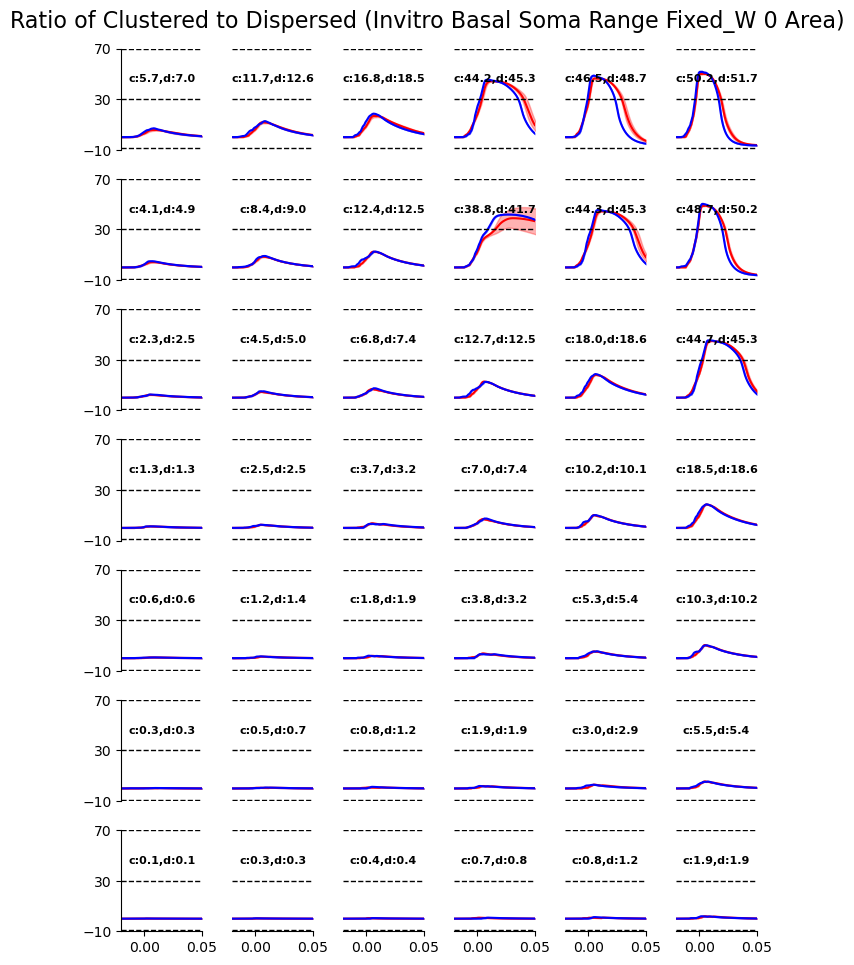

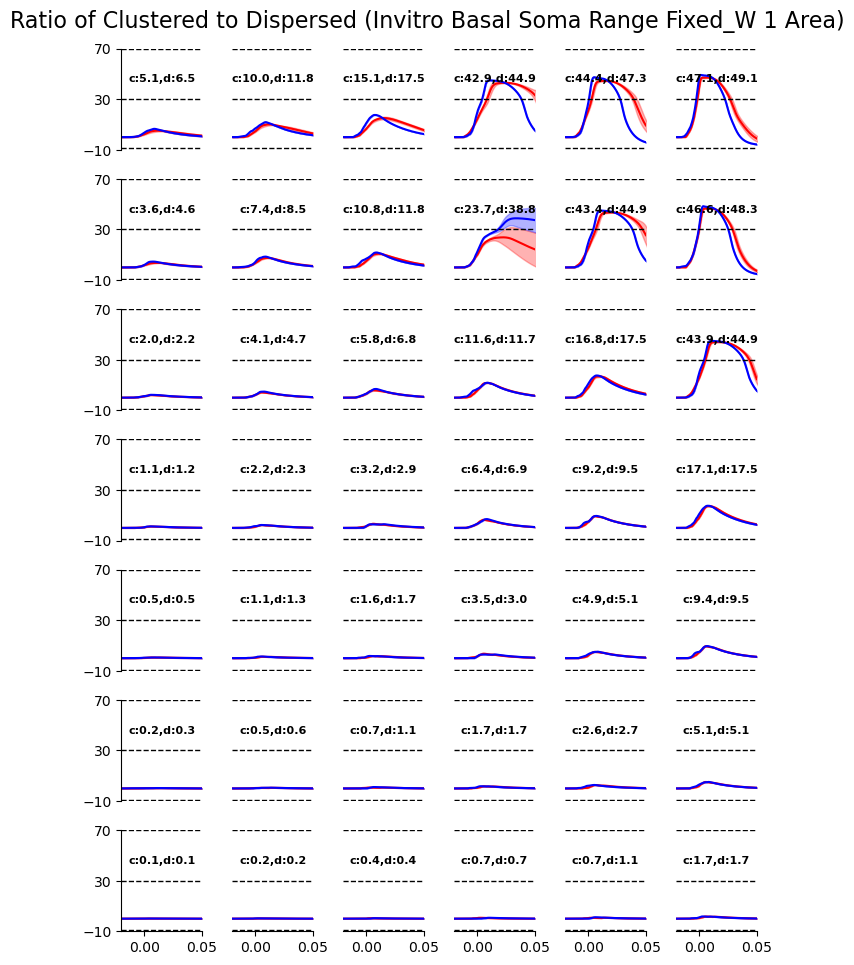

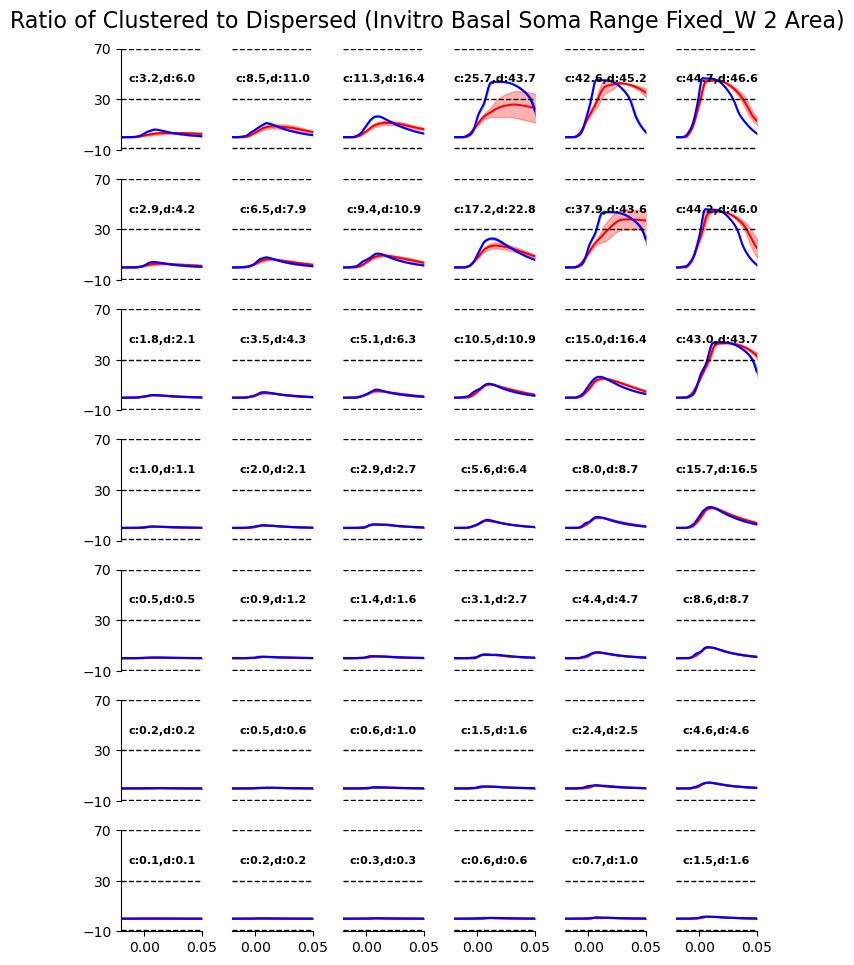

In [4]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invitro', 'distr_invitro', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Soma Range Fixed_W {range_idx} Area)')

6.34e-03 3.21e+00
2.26e-02 4.02e+00
4.30e-02 5.44e+00
8.58e-03 2.71e+00
1.71e-02 3.22e+00
3.58e-02 3.60e+00


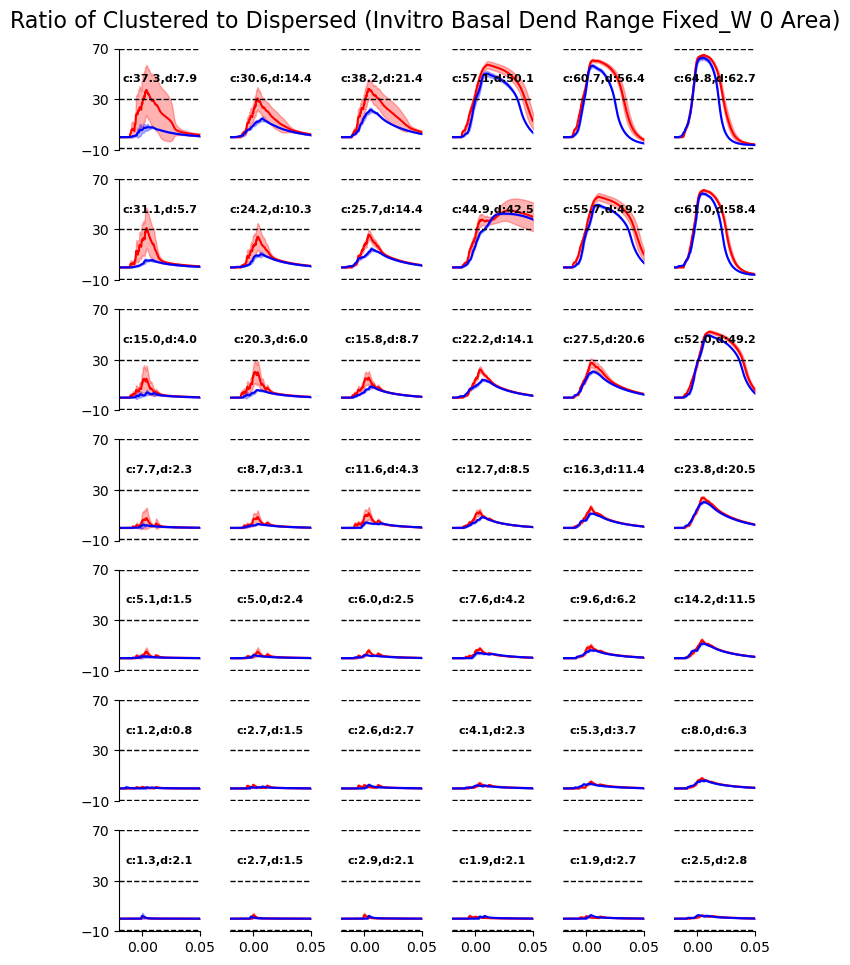

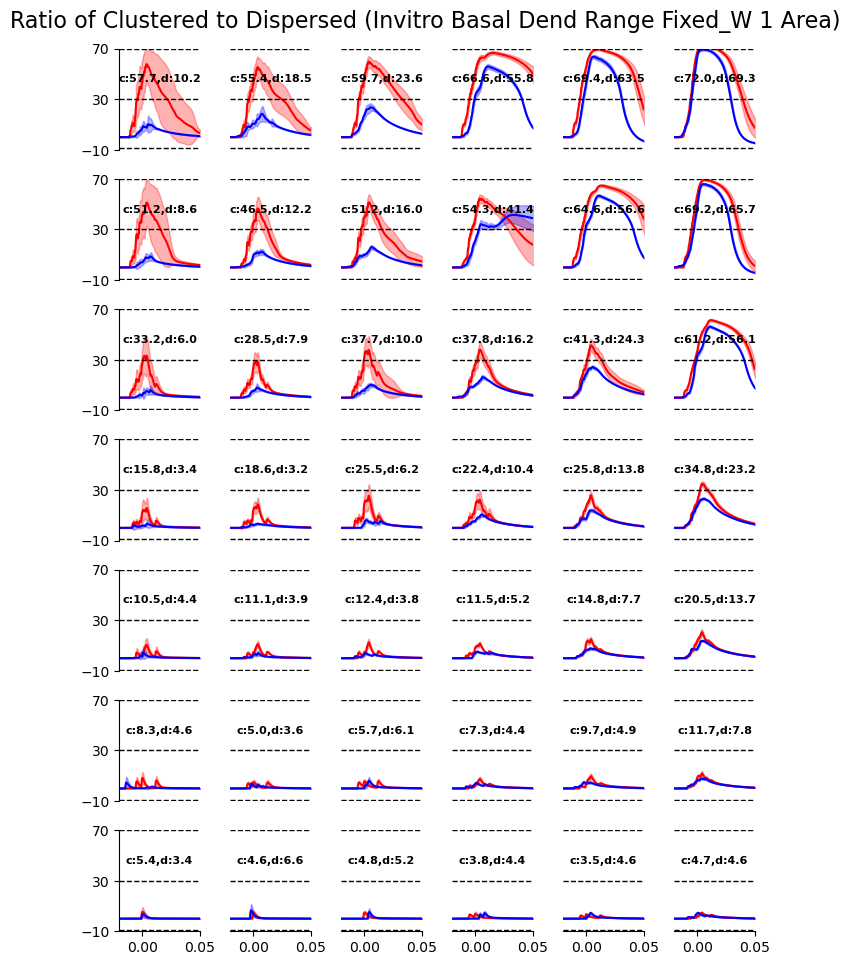

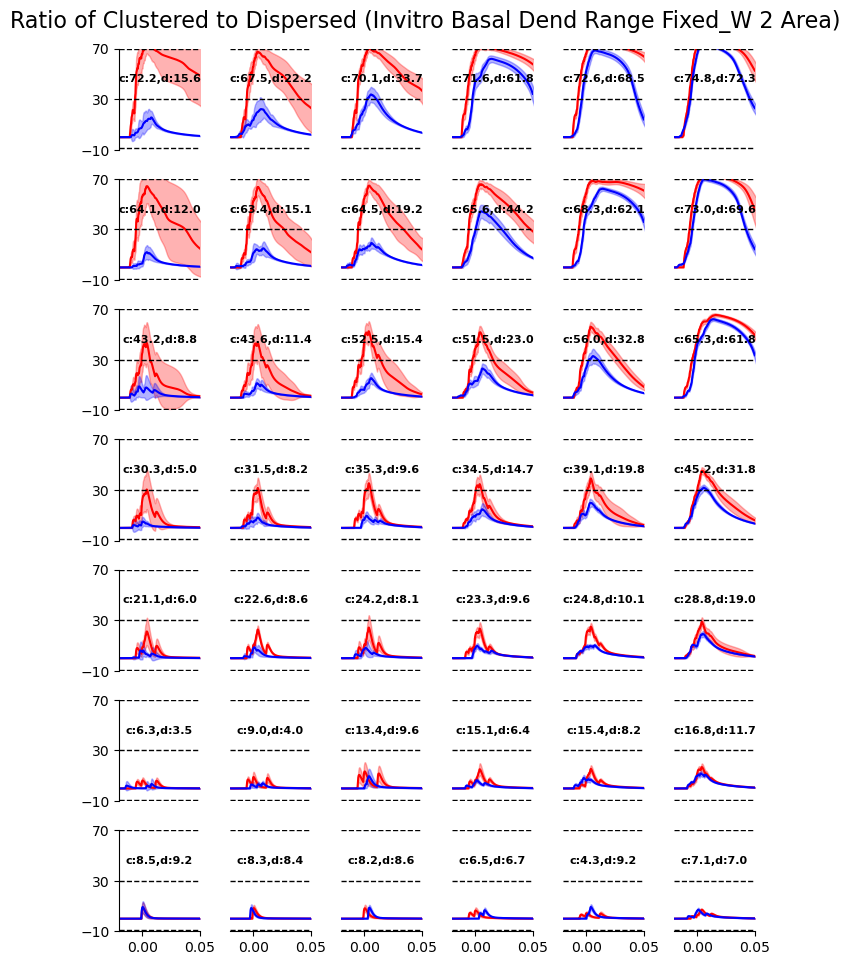

In [5]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro', 'distr_invitro', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Dend Range Fixed_W {range_idx} Area)')

1.64e-03 4.78e+00
8.55e-04 2.55e+00
1.78e-04 7.44e-01
1.75e-03 4.76e+00
6.99e-04 2.65e+00
2.15e-04 7.68e-01


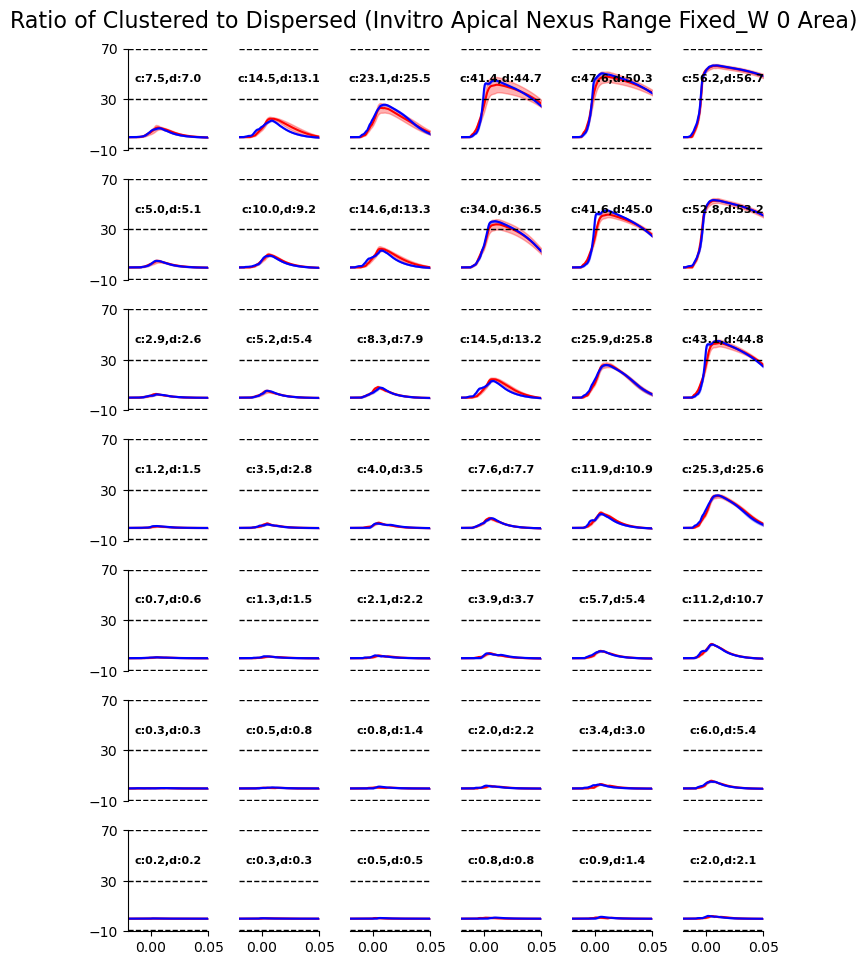

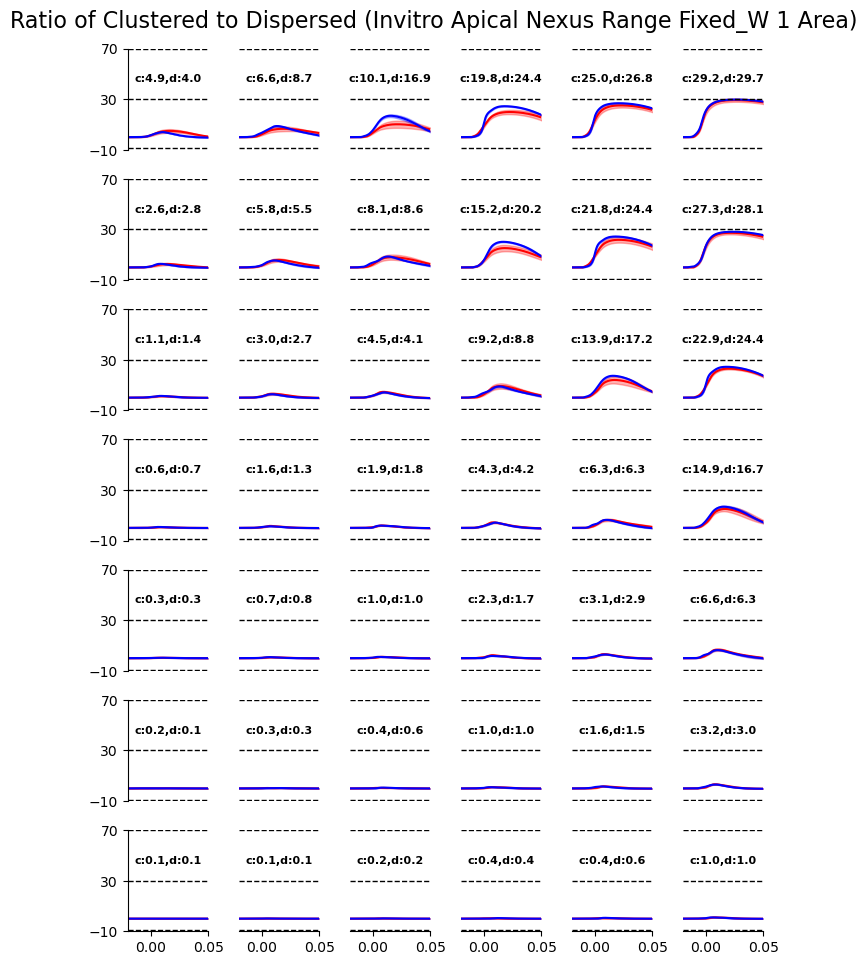

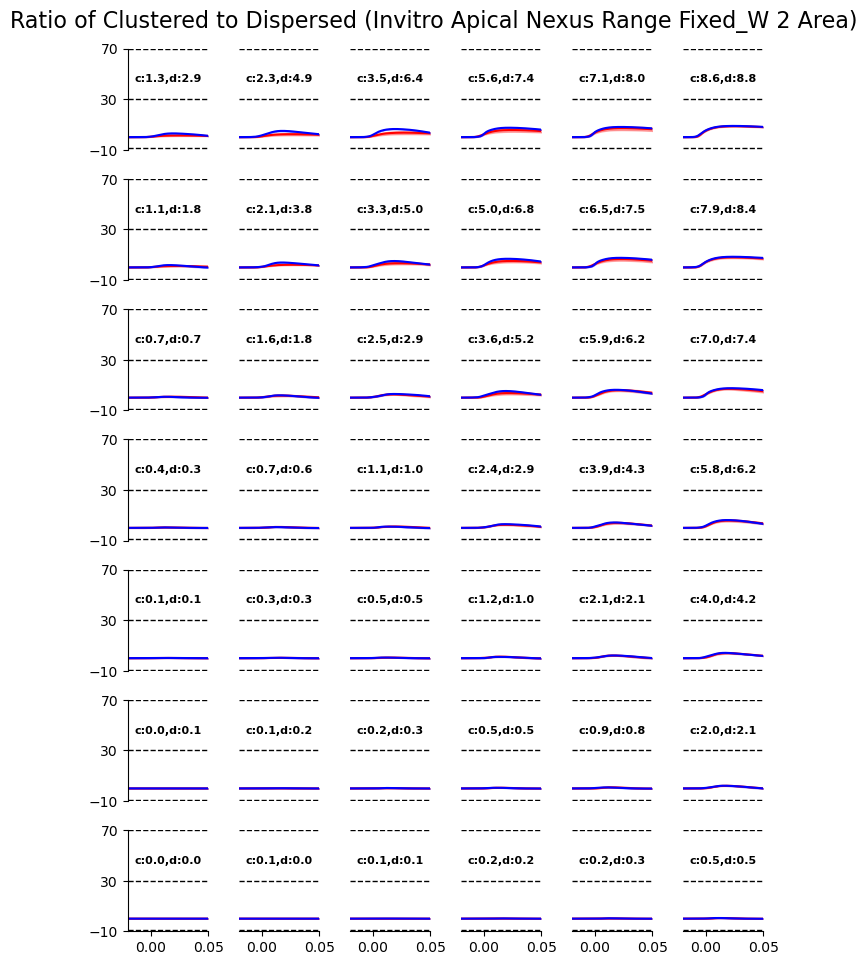

In [6]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invitro', 'distr_invitro', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Nexus Range Fixed_W {range_idx} Area)')

6.17e-03 5.61e+00
1.81e-02 5.94e+00
4.19e-02 6.39e+00
5.94e-03 5.55e+00
1.67e-02 5.87e+00
4.90e-02 6.32e+00


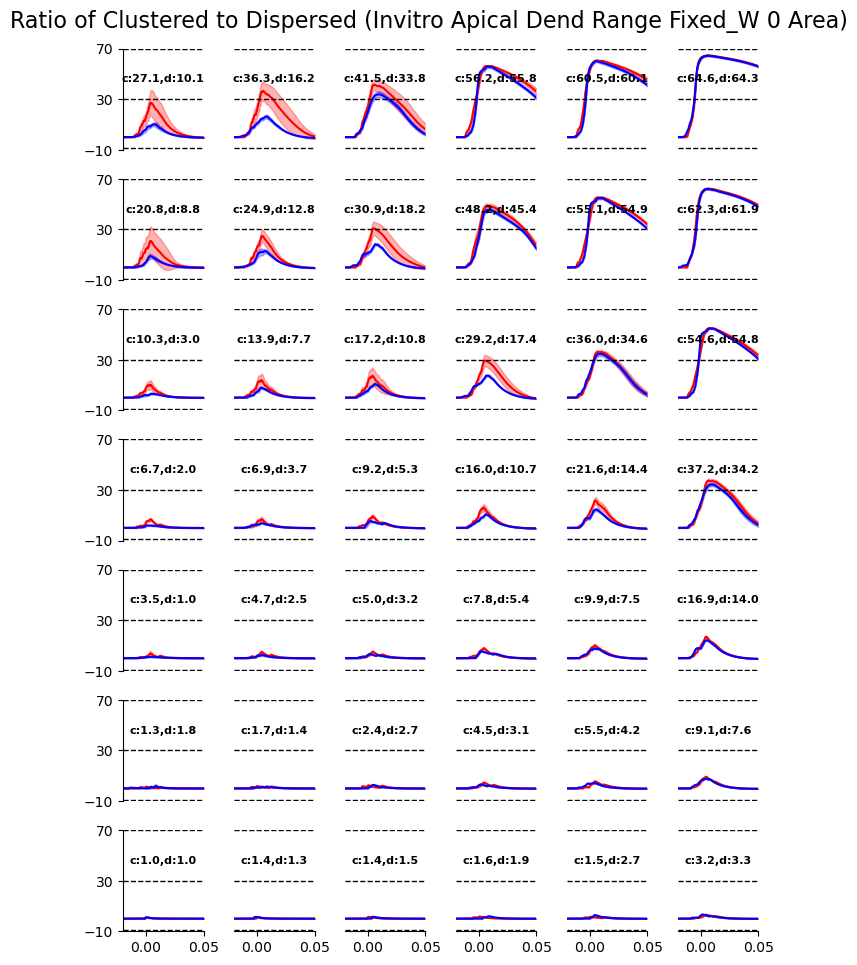

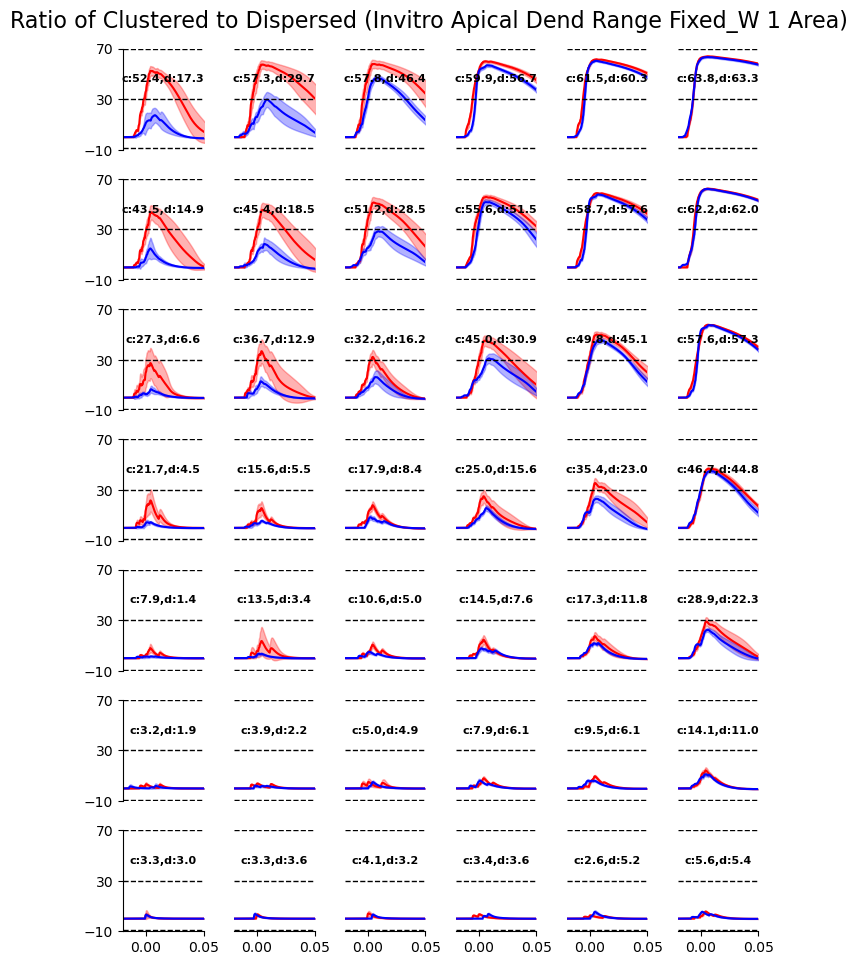

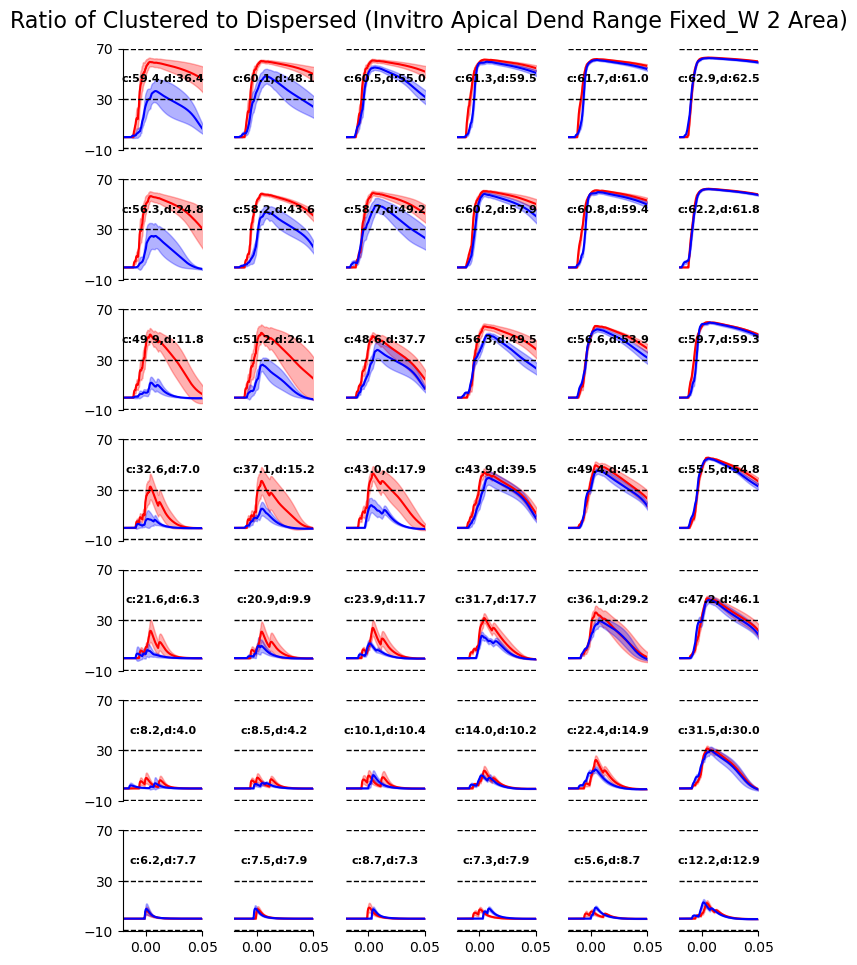

In [7]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro', 'distr_invitro', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Dend Range Fixed_W {range_idx} Area)')

##### Lognorm W_dis 

1.62e-03 2.29e+00
5.81e-04 2.58e+00
6.23e-04 2.38e+00
3.10e-04 2.31e+00
9.33e-04 2.32e+00
4.60e-04 2.24e+00


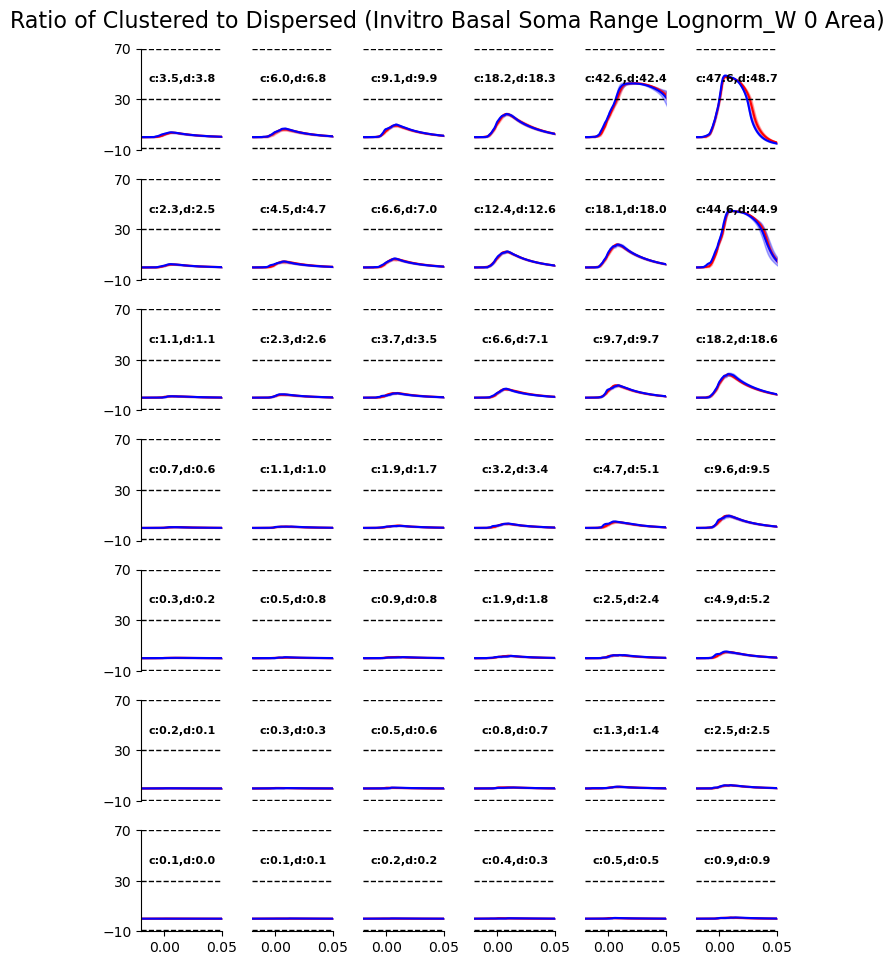

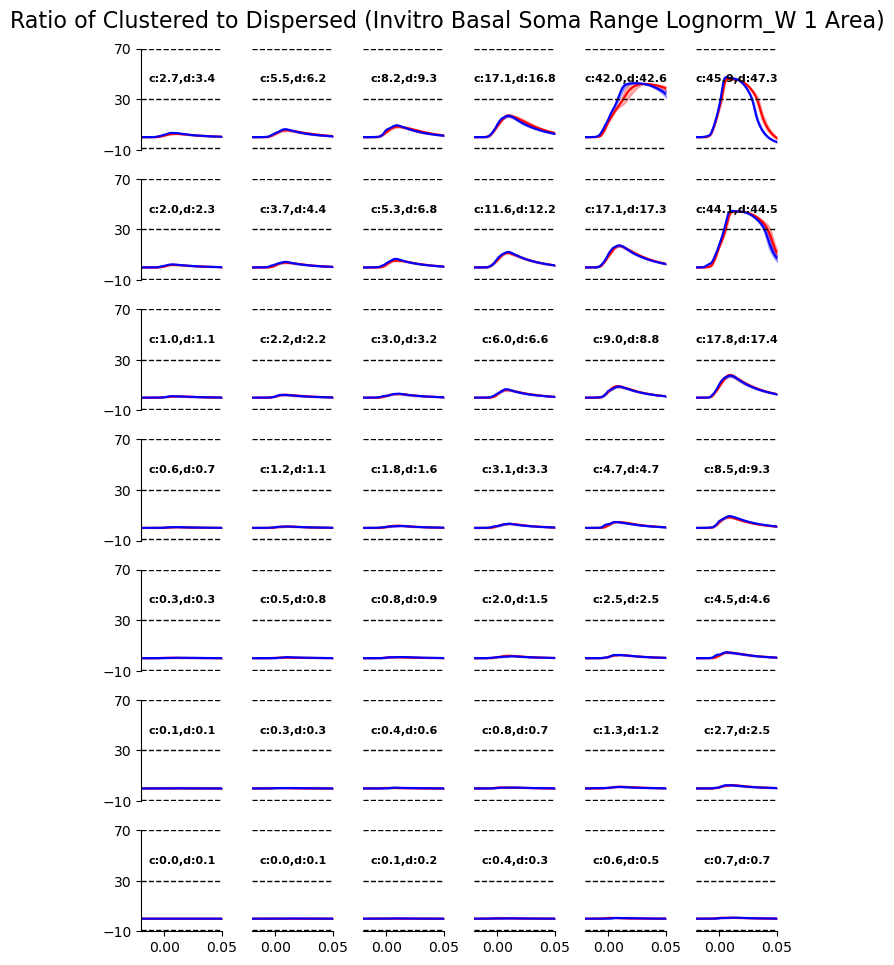

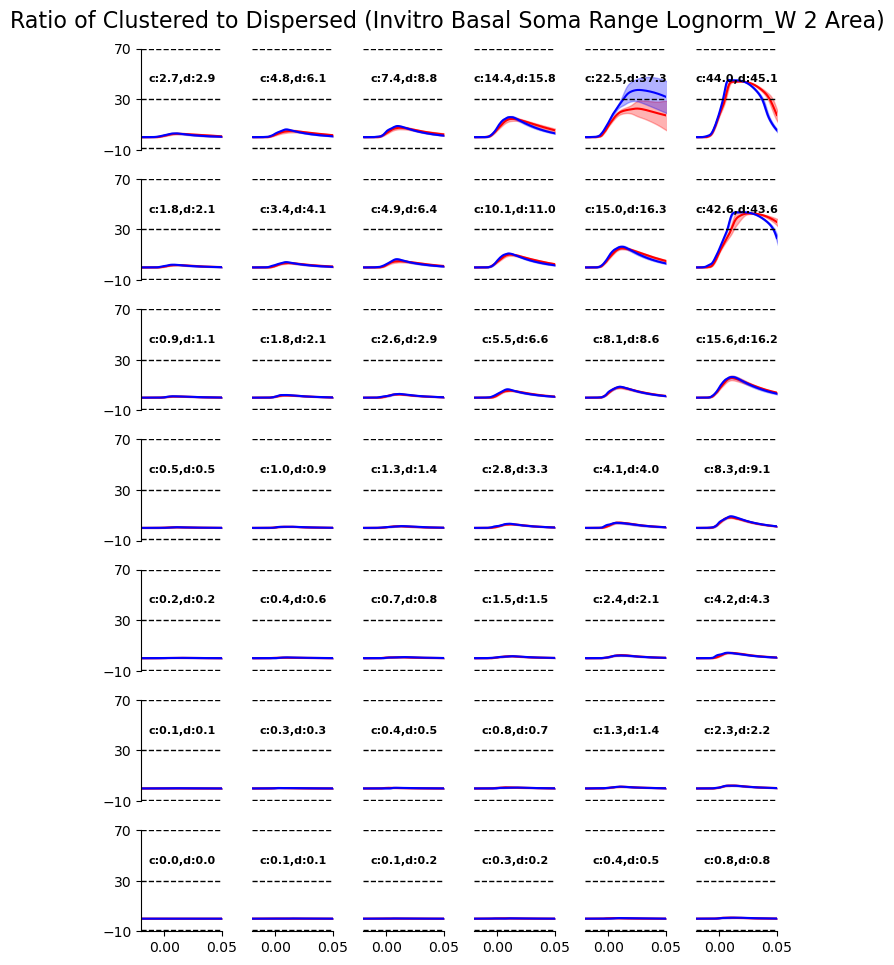

In [8]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invitro_variedW', 'distr_invitro_variedW', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Soma Range Lognorm_W {range_idx} Area)')

5.67e-03 2.66e+00
7.80e-03 3.73e+00
1.48e-02 4.21e+00
1.48e-03 2.42e+00
1.31e-02 2.64e+00
2.45e-02 3.21e+00


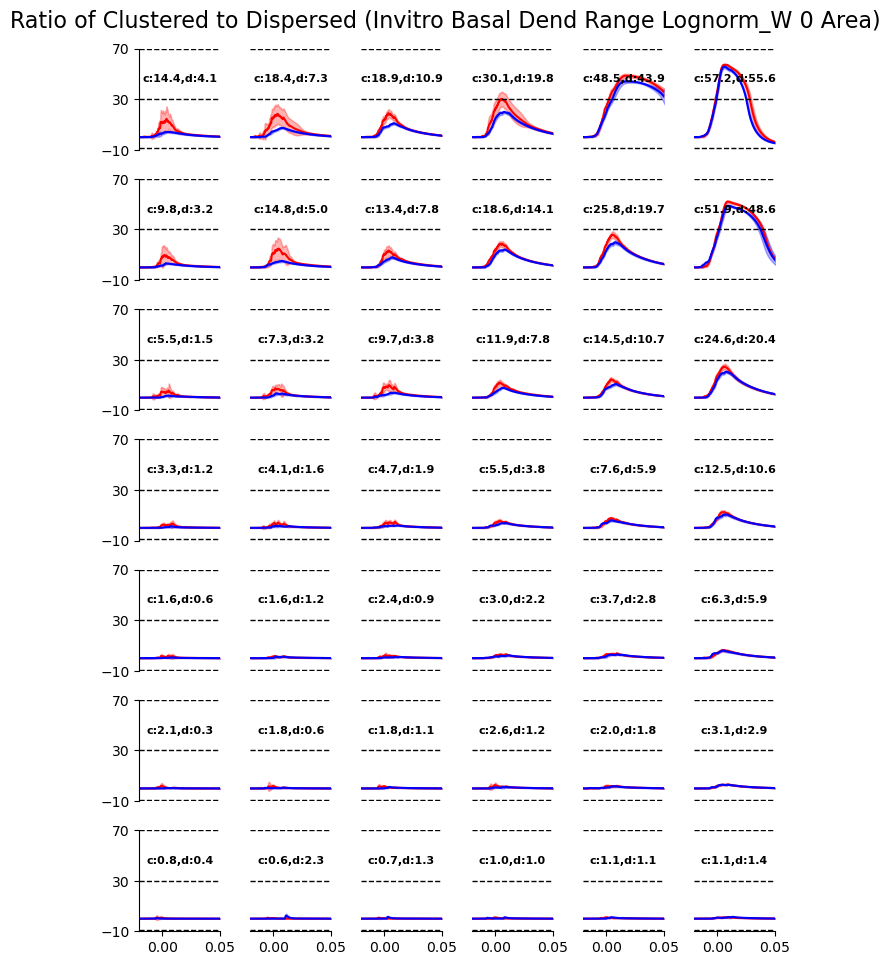

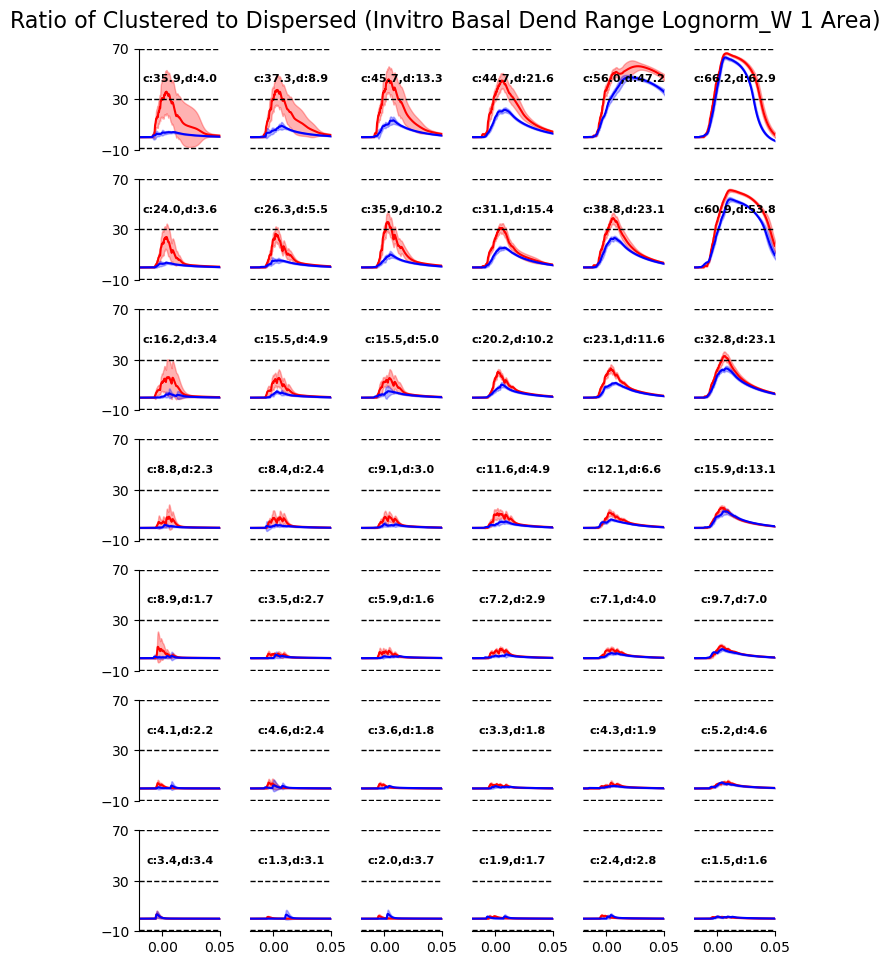

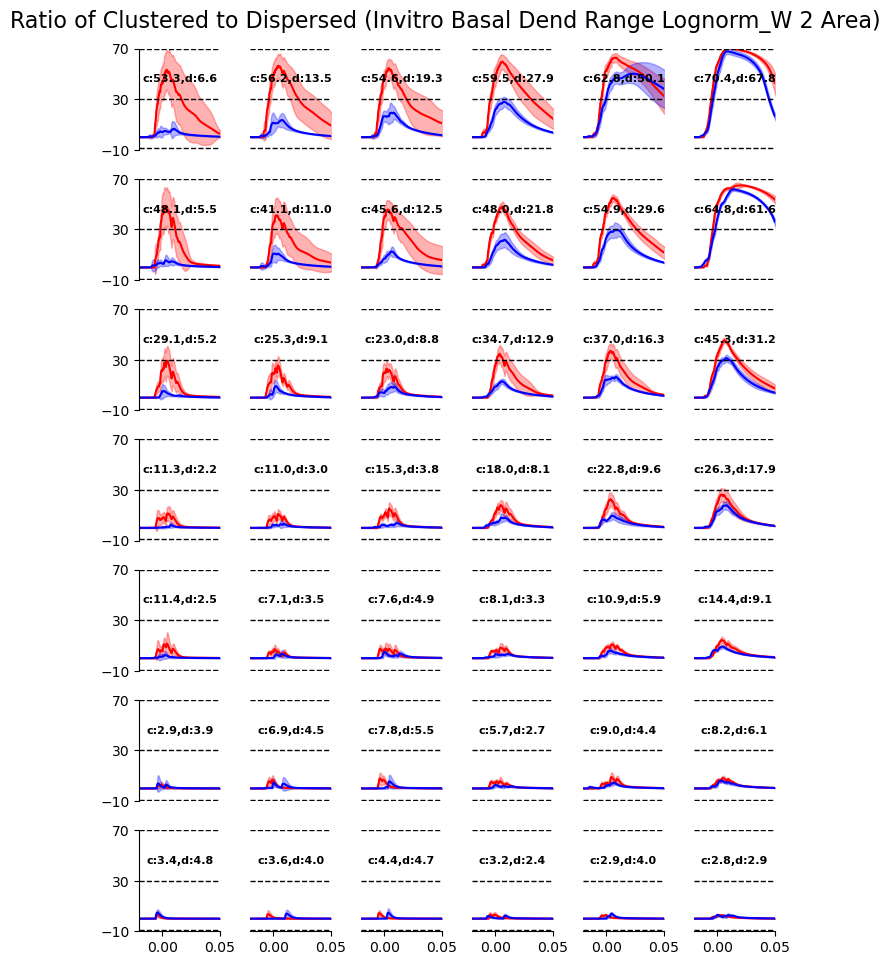

In [9]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_variedW', 'distr_invitro_variedW', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Dend Range Lognorm_W {range_idx} Area)')

6.31e-04 3.11e+00
9.58e-05 1.73e+00
9.97e-05 5.89e-01
6.53e-04 3.09e+00
2.76e-04 1.86e+00
8.16e-06 6.06e-01


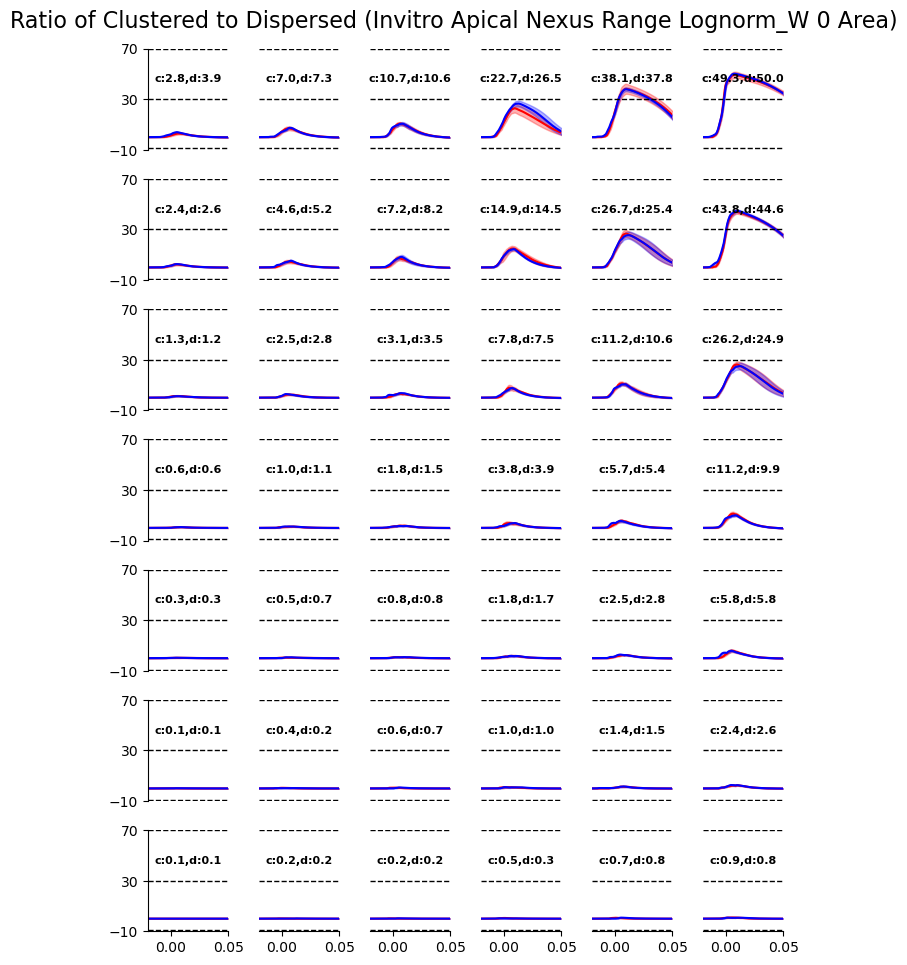

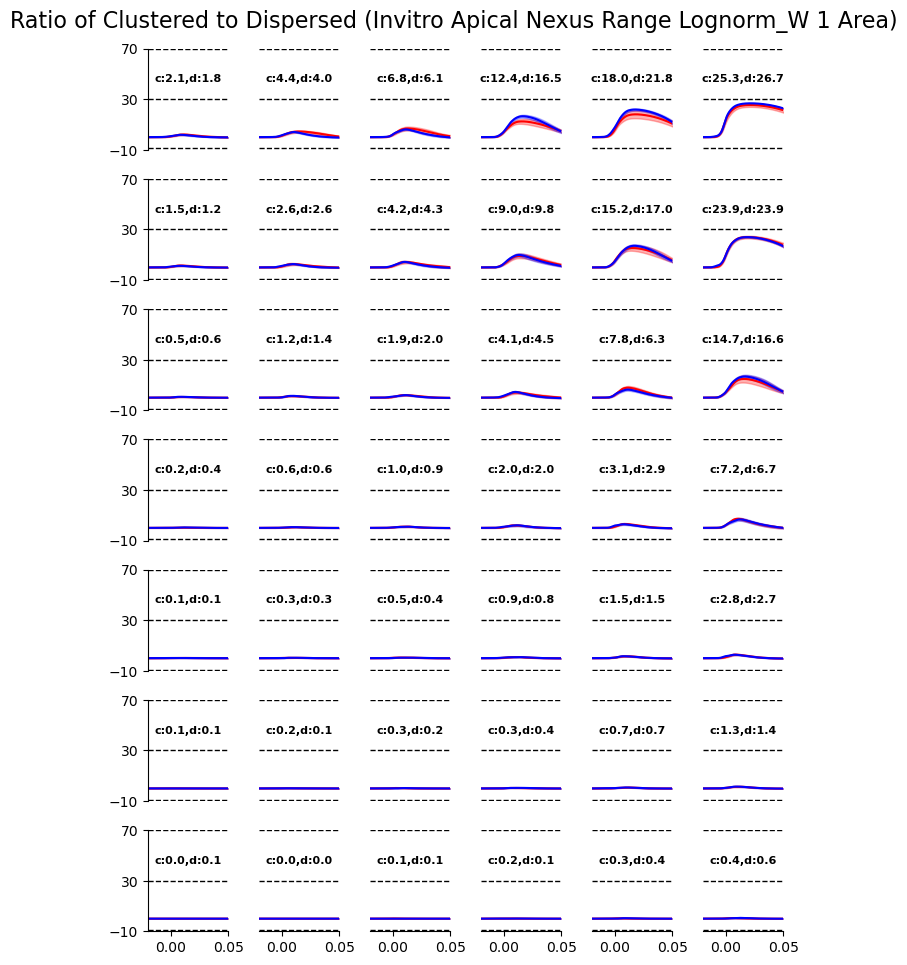

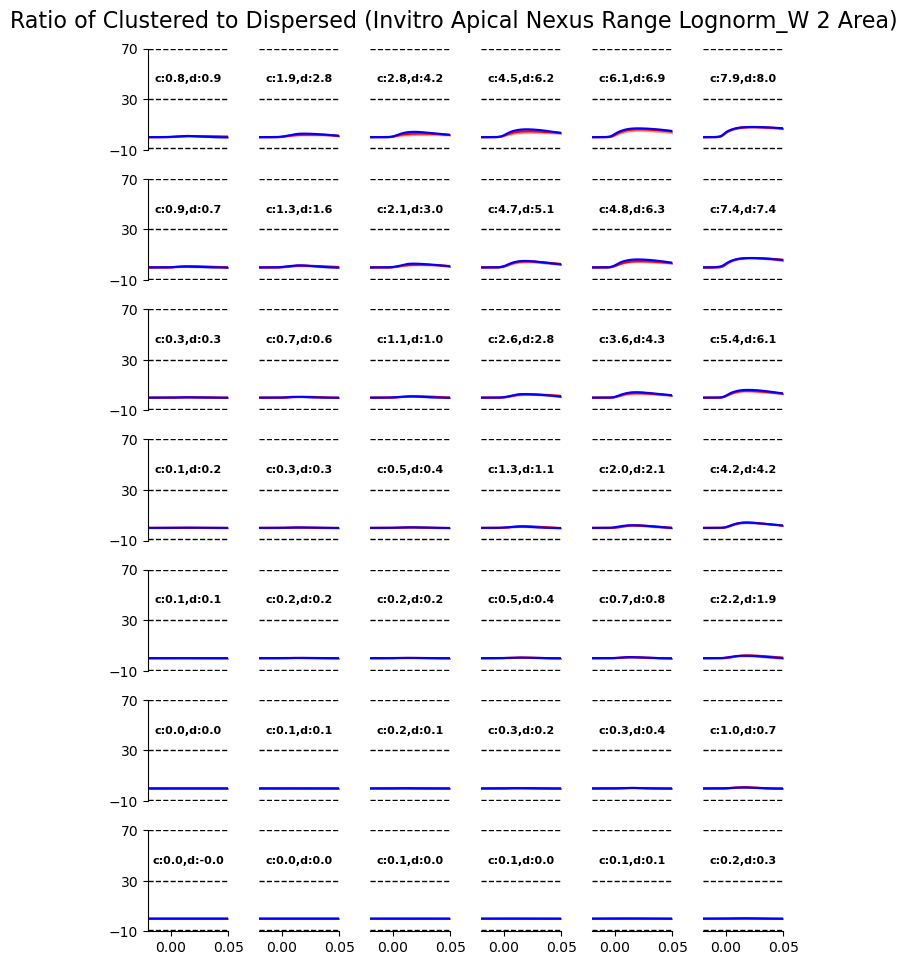

In [10]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invitro_variedW', 'distr_invitro_variedW', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Nexus Range Lognorm_W {range_idx} Area)')

3.51e-03 3.85e+00
4.20e-03 4.58e+00
2.08e-02 5.58e+00
2.36e-03 3.70e+00
1.06e-02 4.35e+00
1.01e-02 5.54e+00


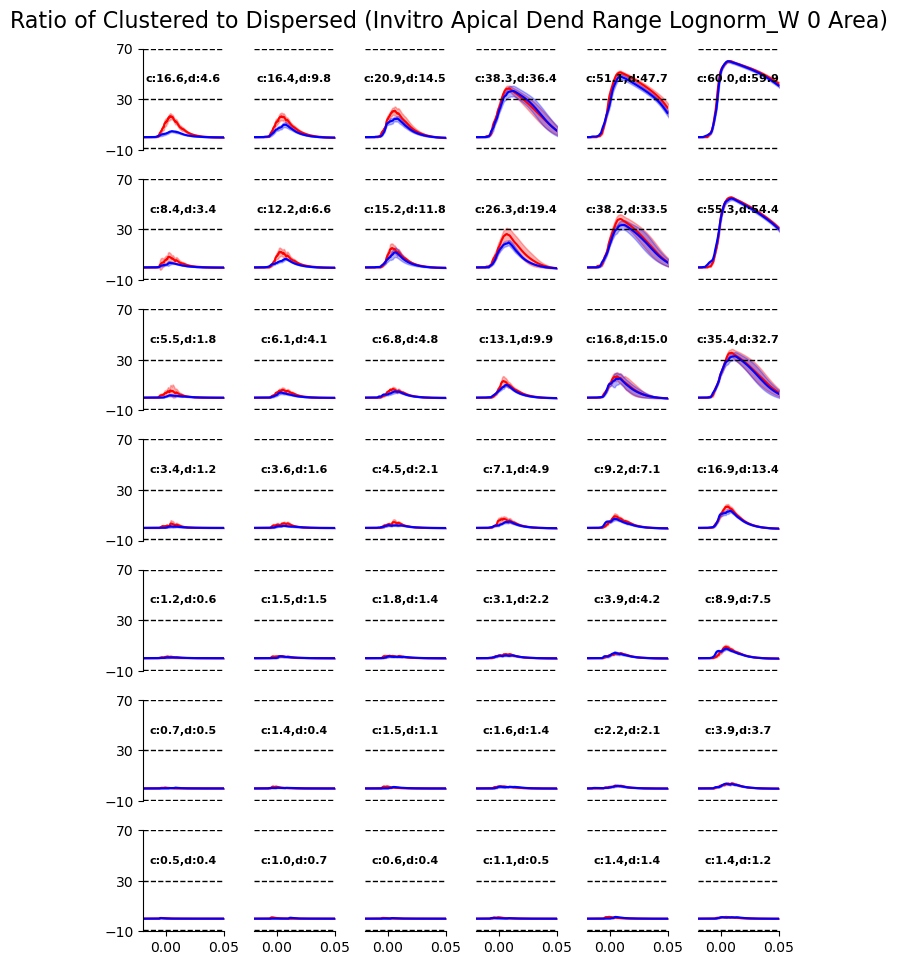

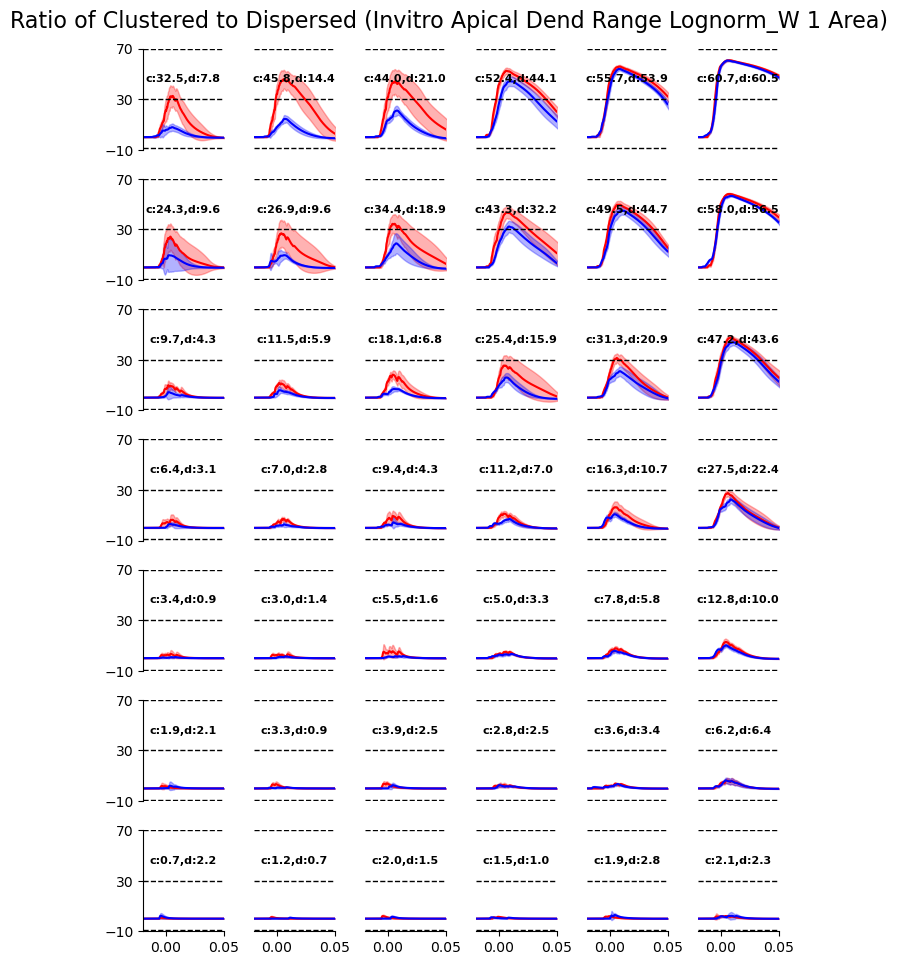

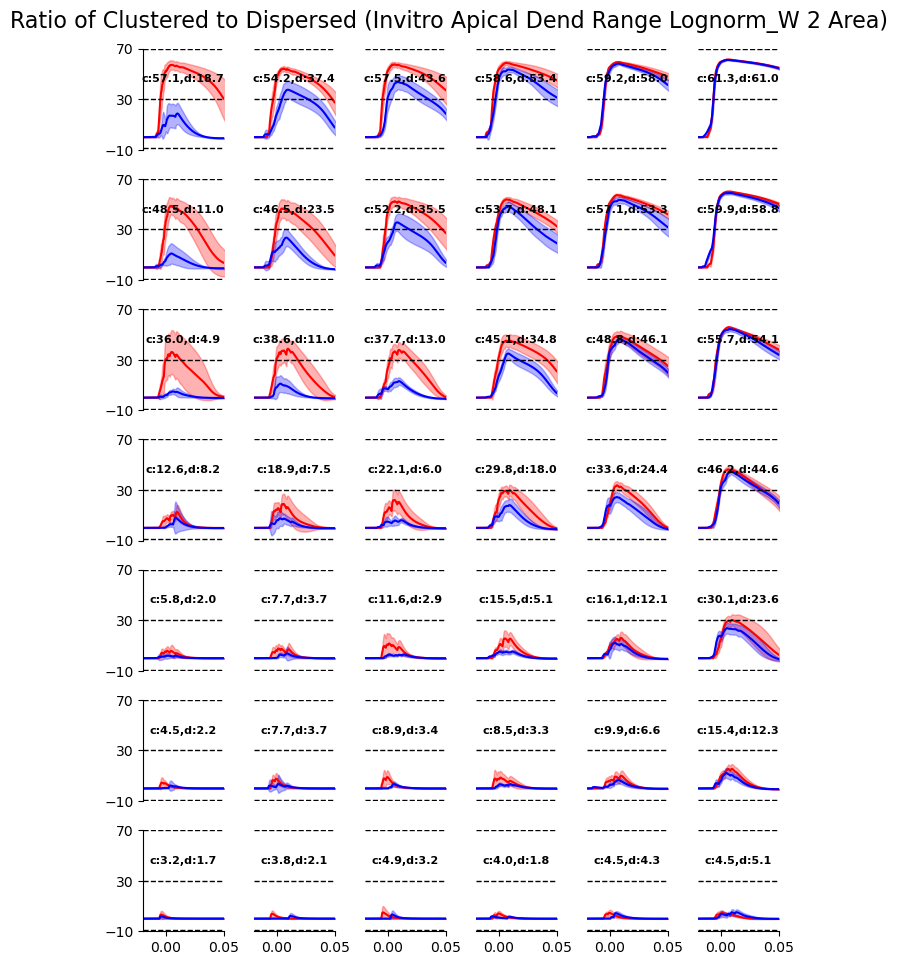

In [11]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_variedW', 'distr_invitro_variedW', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Dend Range Lognorm_W {range_idx} Area)')

##### Lognorm W_dis with AP

3.11e-04 7.86e-01
7.20e-04 8.51e-01
1.41e-03 1.03e+00
6.93e-05 7.52e-01
5.61e-04 7.90e-01
5.17e-04 9.08e-01


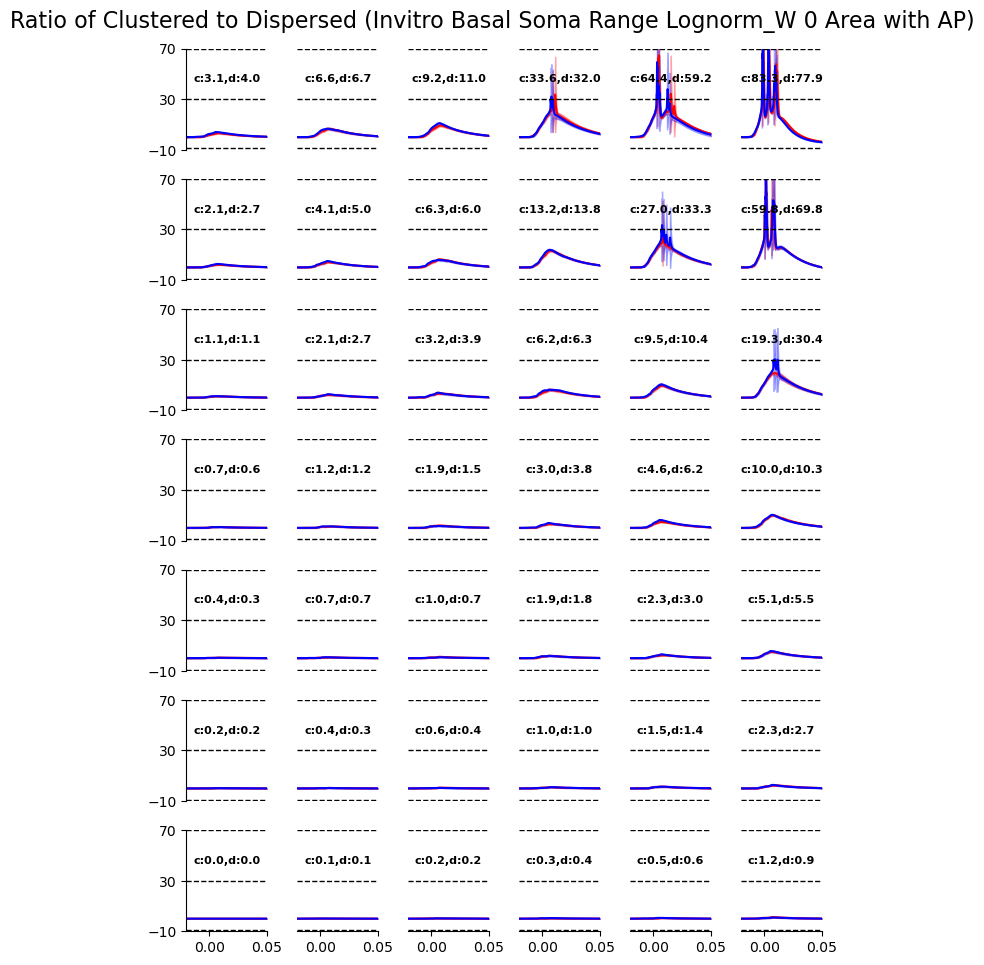

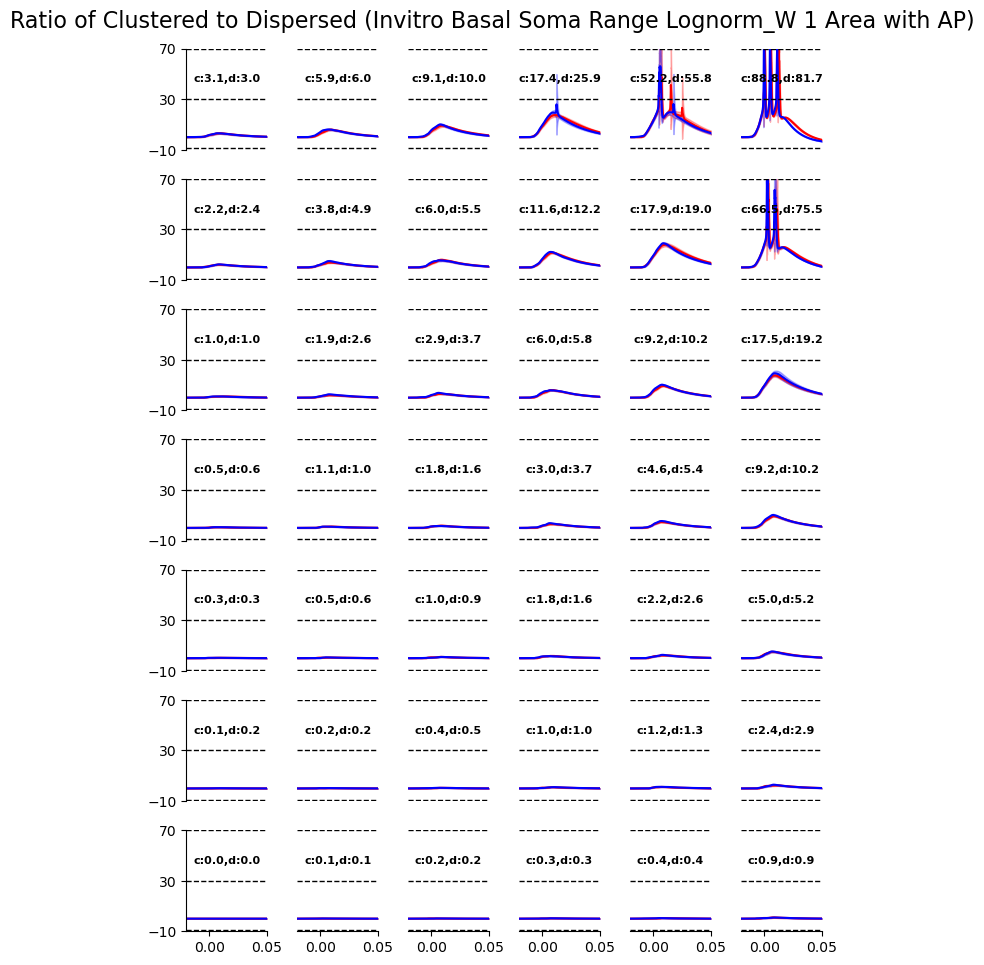

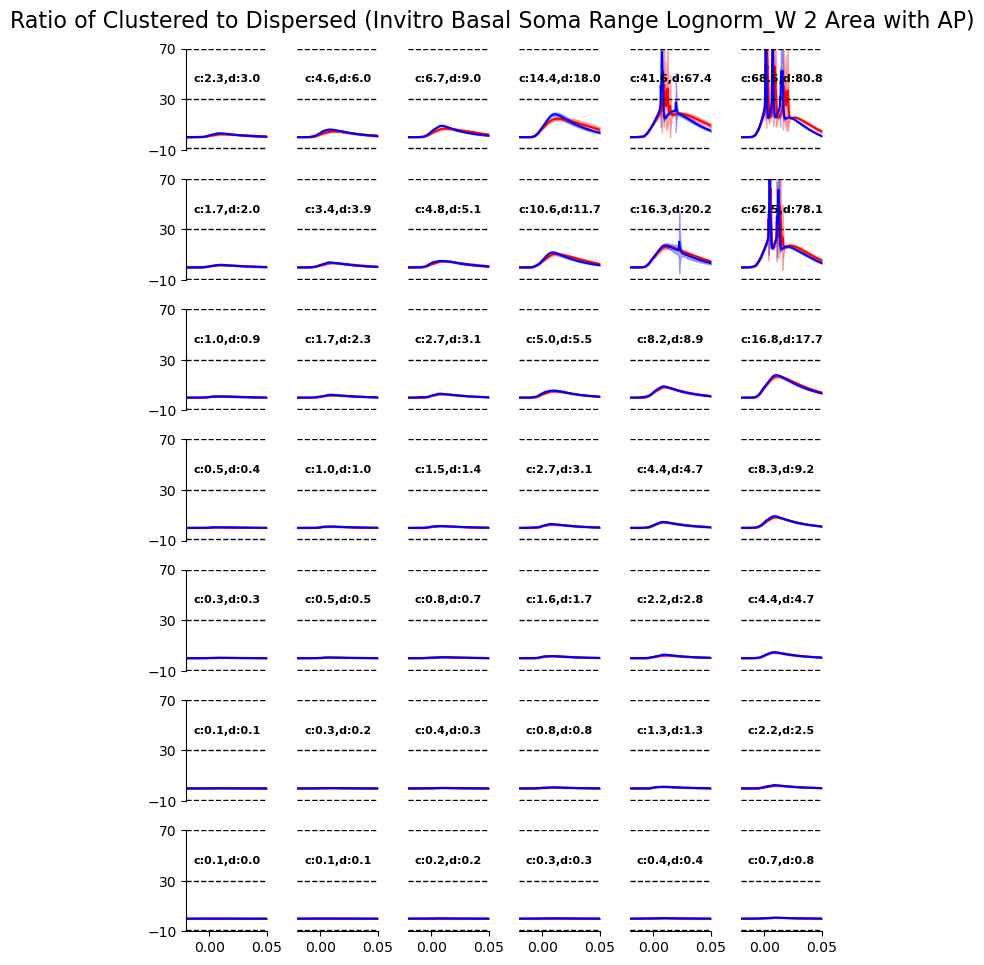

In [12]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_withAP', 'distr_invitro_variedW_withAP', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Soma Range Lognorm_W {range_idx} Area with AP)')

5.74e-03 9.95e-01
8.79e-03 1.60e+00
1.94e-02 2.93e+00
1.92e-03 8.47e-01
6.92e-03 1.19e+00
2.15e-02 2.07e+00


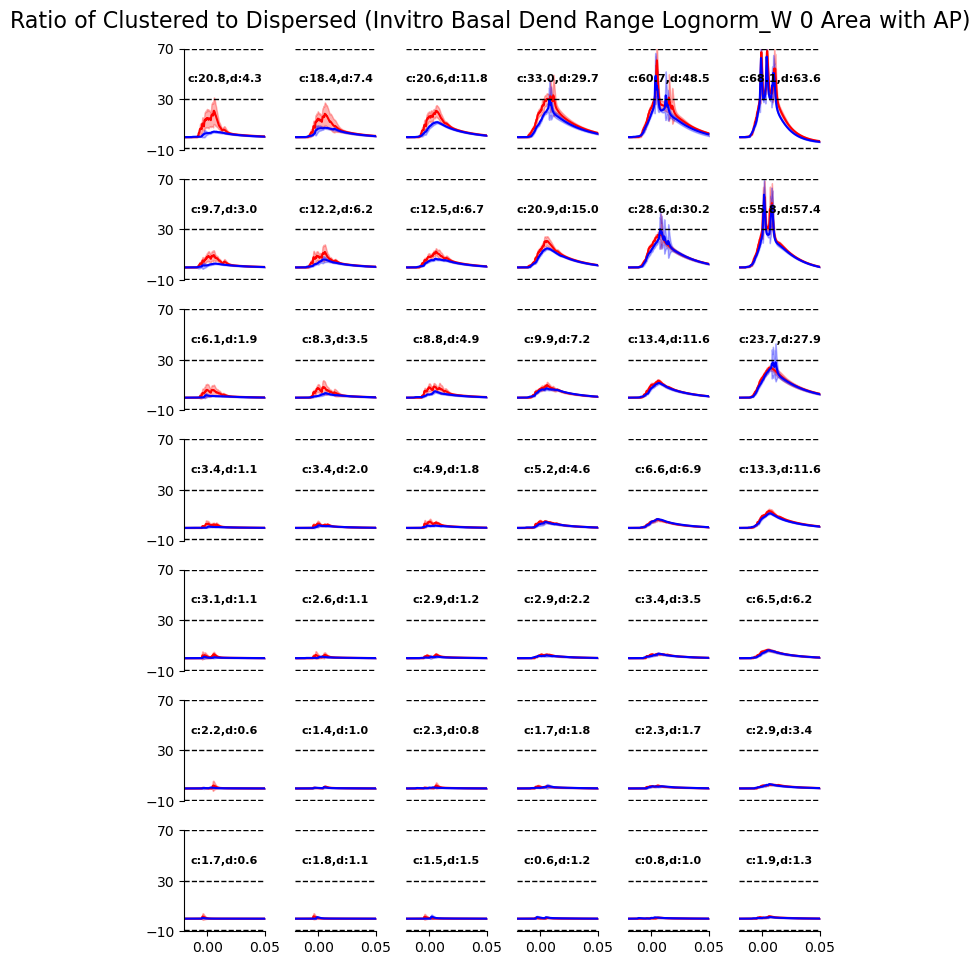

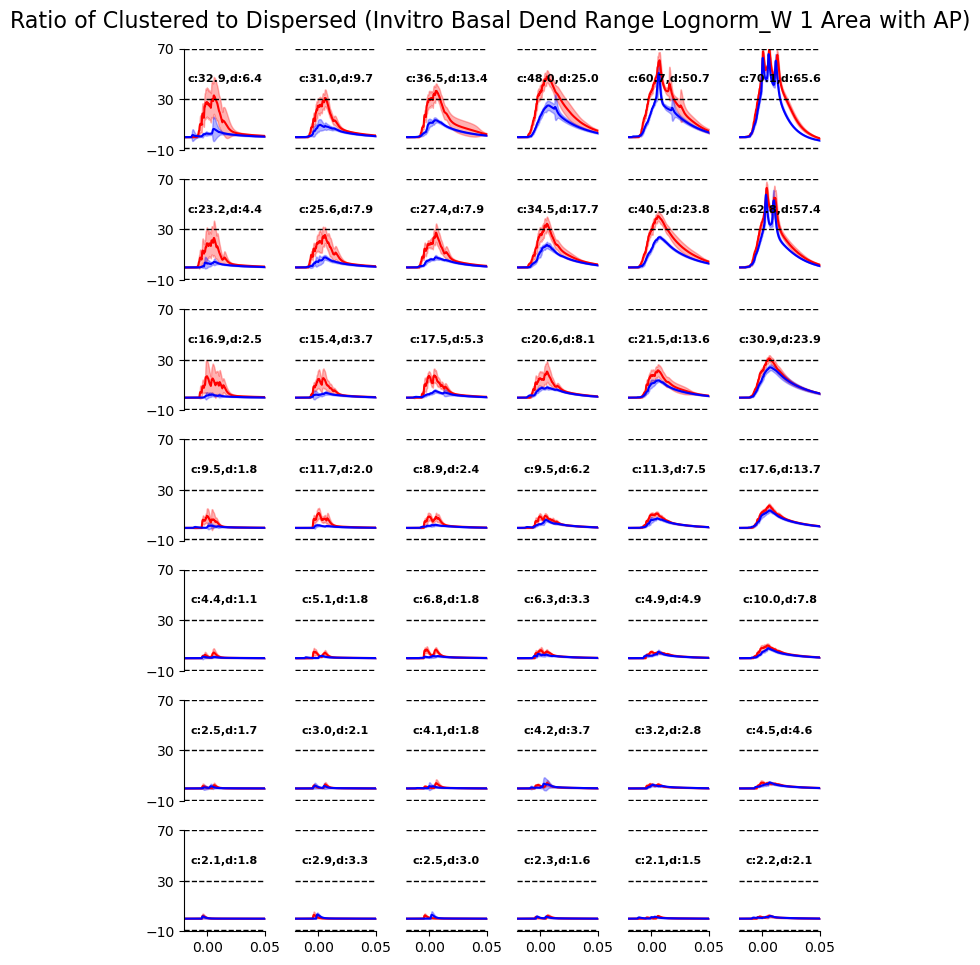

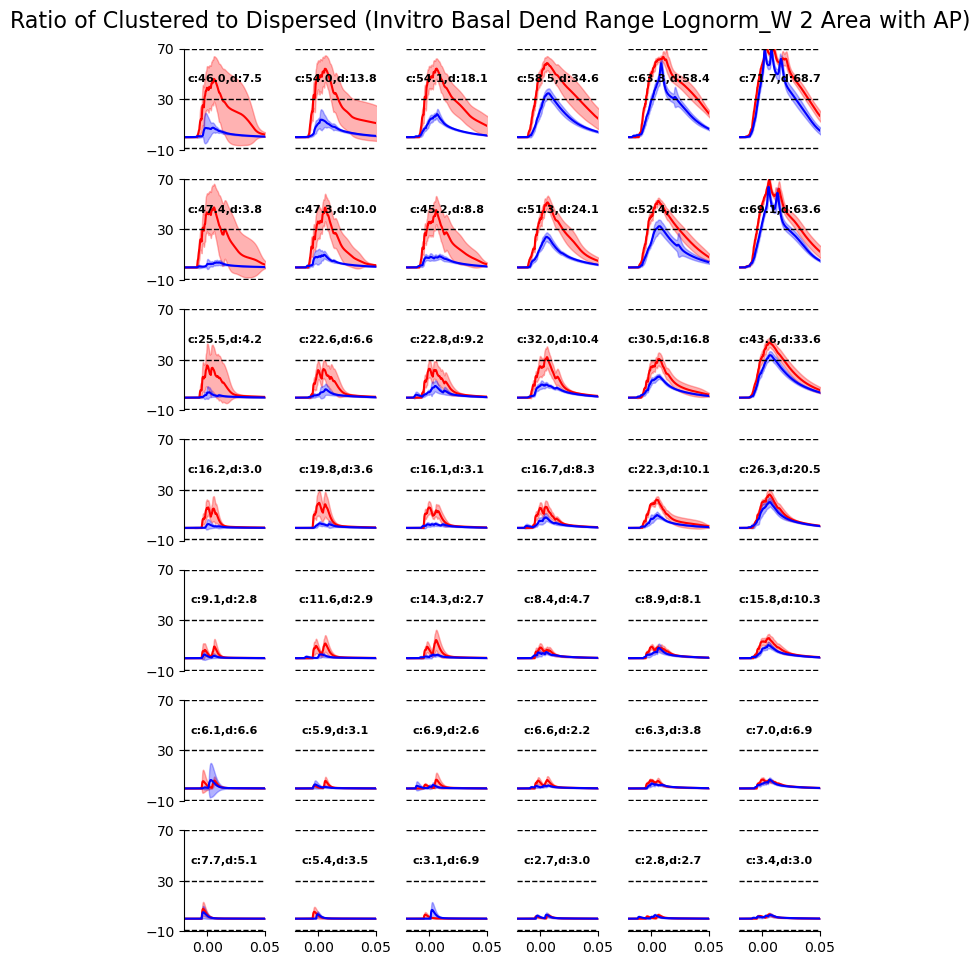

In [13]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_withAP', 'distr_invitro_variedW_withAP', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Dend Range Lognorm_W {range_idx} Area with AP)')

1.04e-03 2.55e+00
8.22e-05 2.11e+00
3.30e-05 6.46e-01
4.05e-04 2.58e+00
4.85e-04 2.10e+00
1.33e-04 6.78e-01


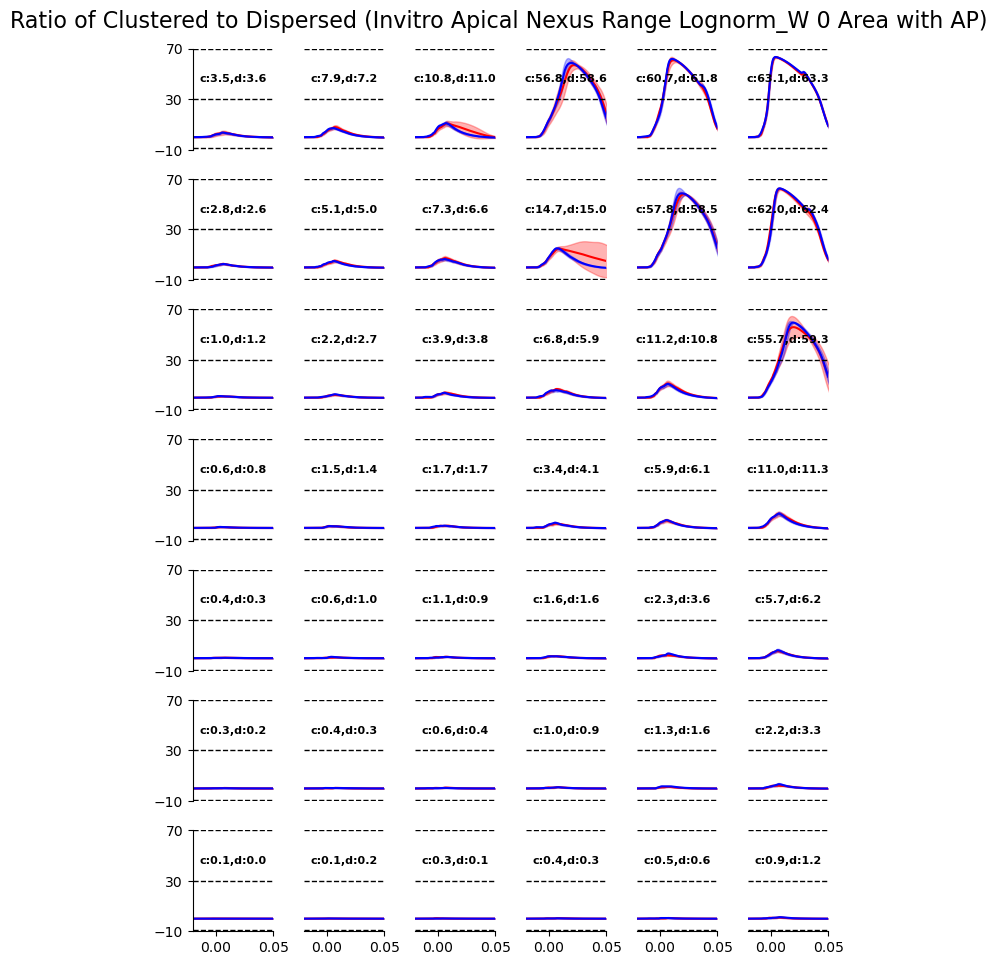

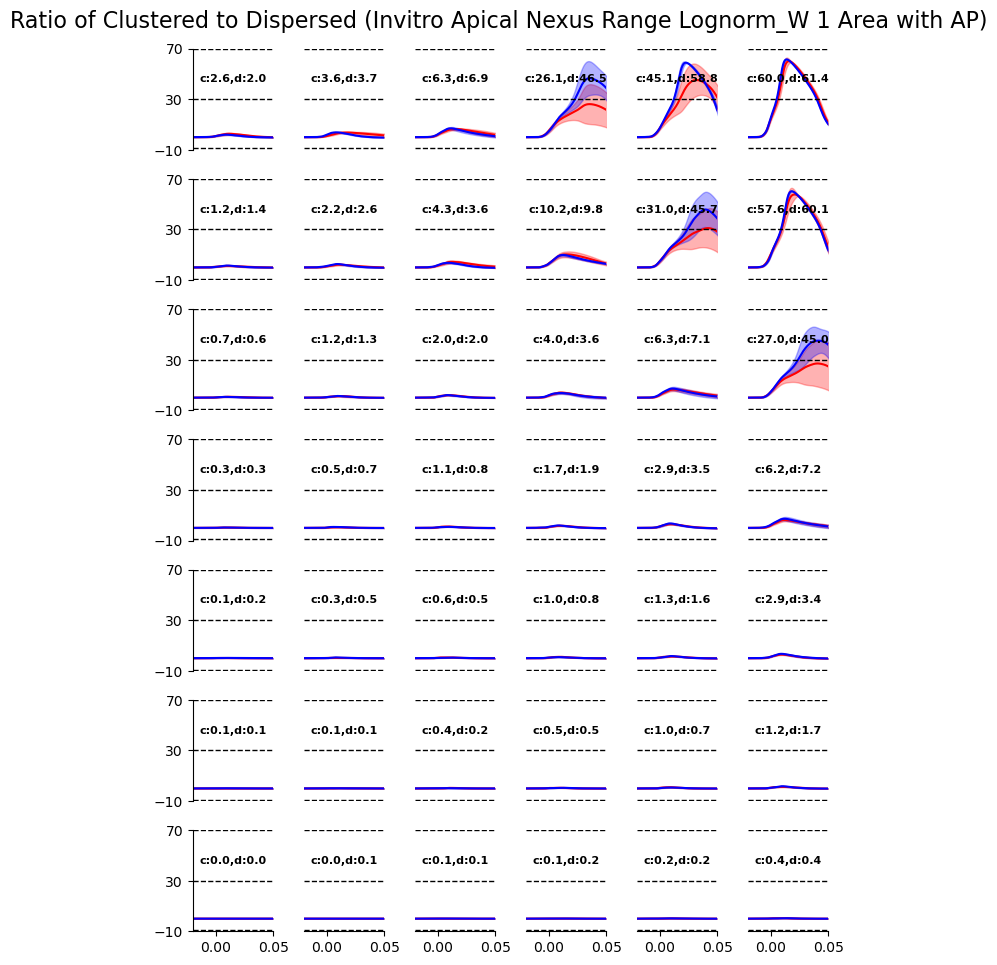

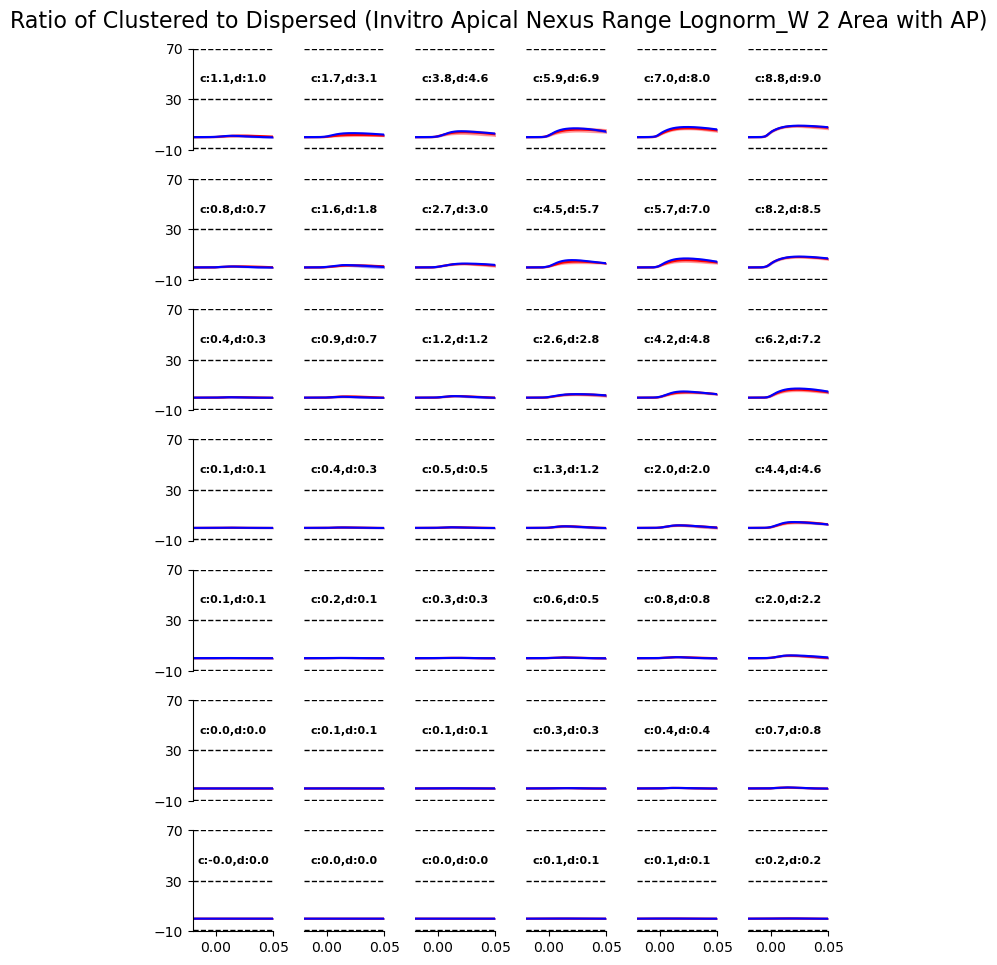

In [14]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_withAP', 'distr_invitro_variedW_withAP', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Nexus Range Lognorm_W {range_idx} Area with AP)')

2.52e-03 3.06e+00
4.95e-03 4.07e+00
1.64e-02 5.80e+00
3.89e-03 2.98e+00
1.08e-02 3.96e+00
1.85e-02 5.75e+00


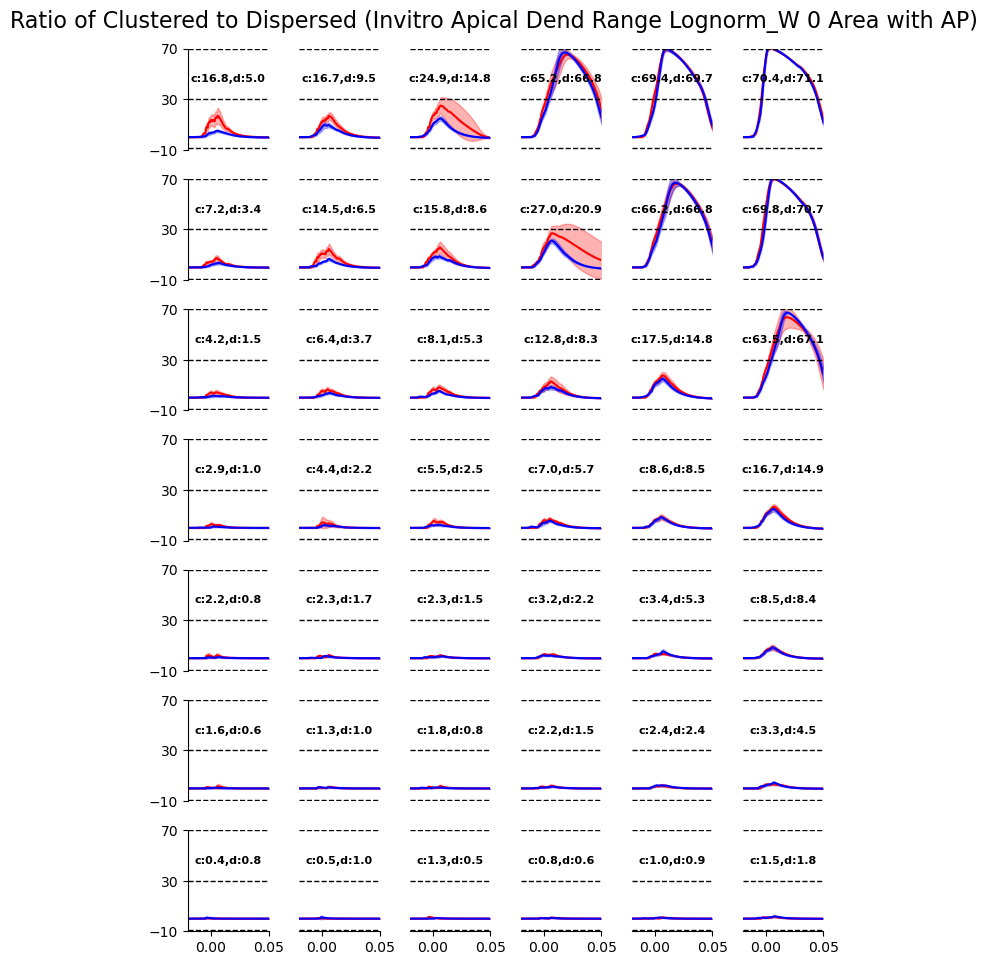

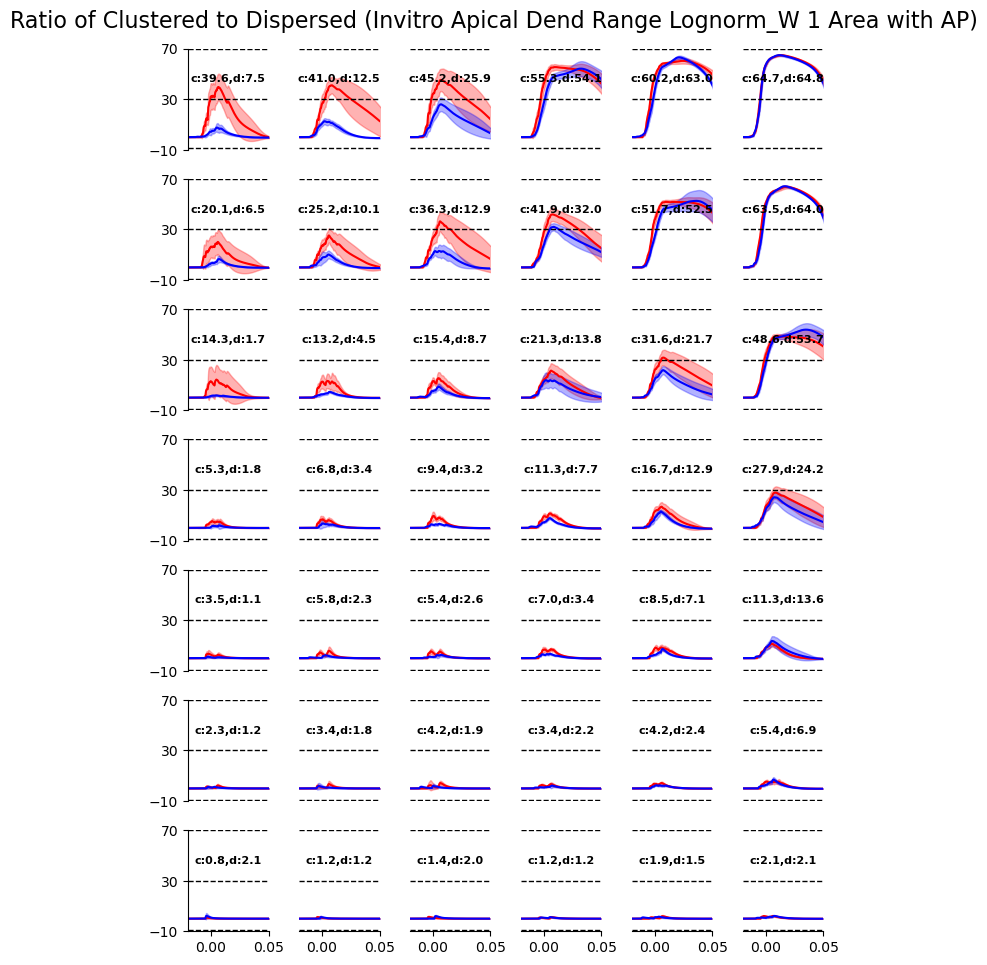

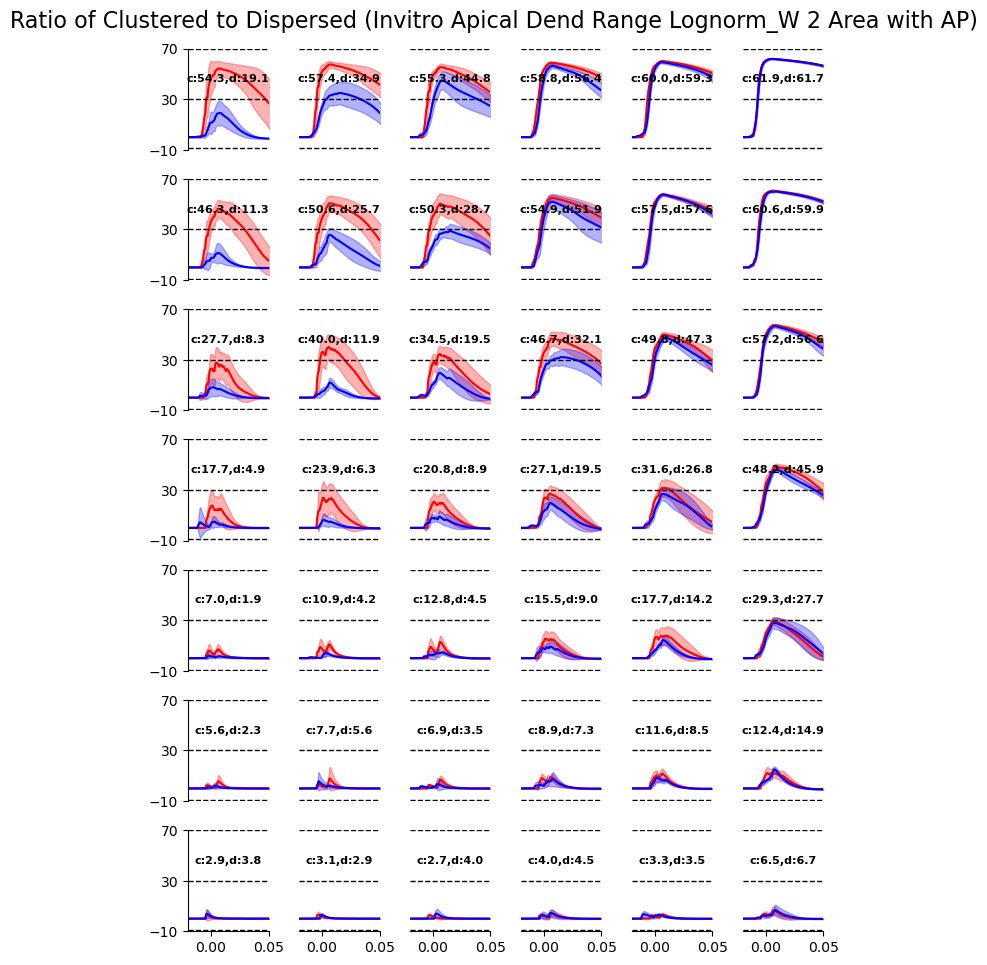

In [15]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_withAP', 'distr_invitro_variedW_withAP', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Dend Range Lognorm_W {range_idx} Area with AP)')

#### AMPA only

##### Fixed W_dis

1.49e-03 3.52e+00
1.35e-03 3.43e+00
1.21e-03 3.33e+00
1.45e-03 3.47e+00
1.35e-03 3.58e+00
1.20e-03 3.35e+00


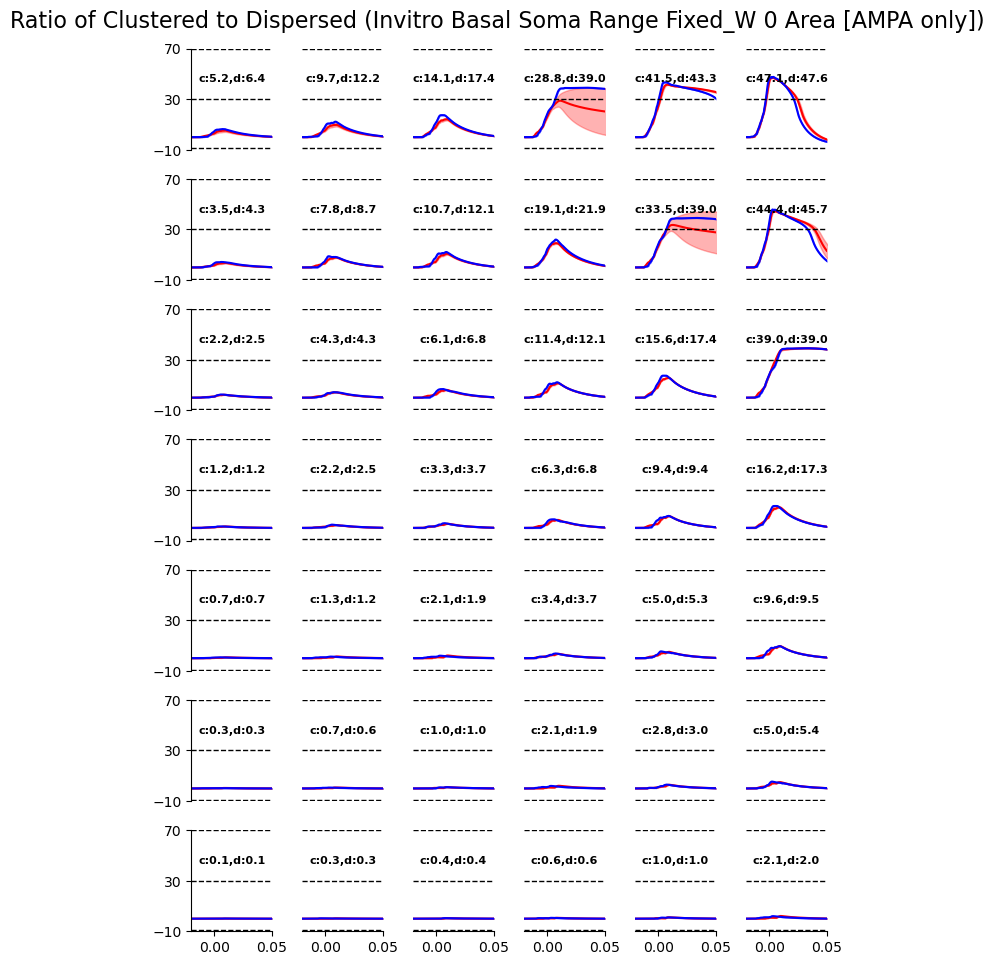

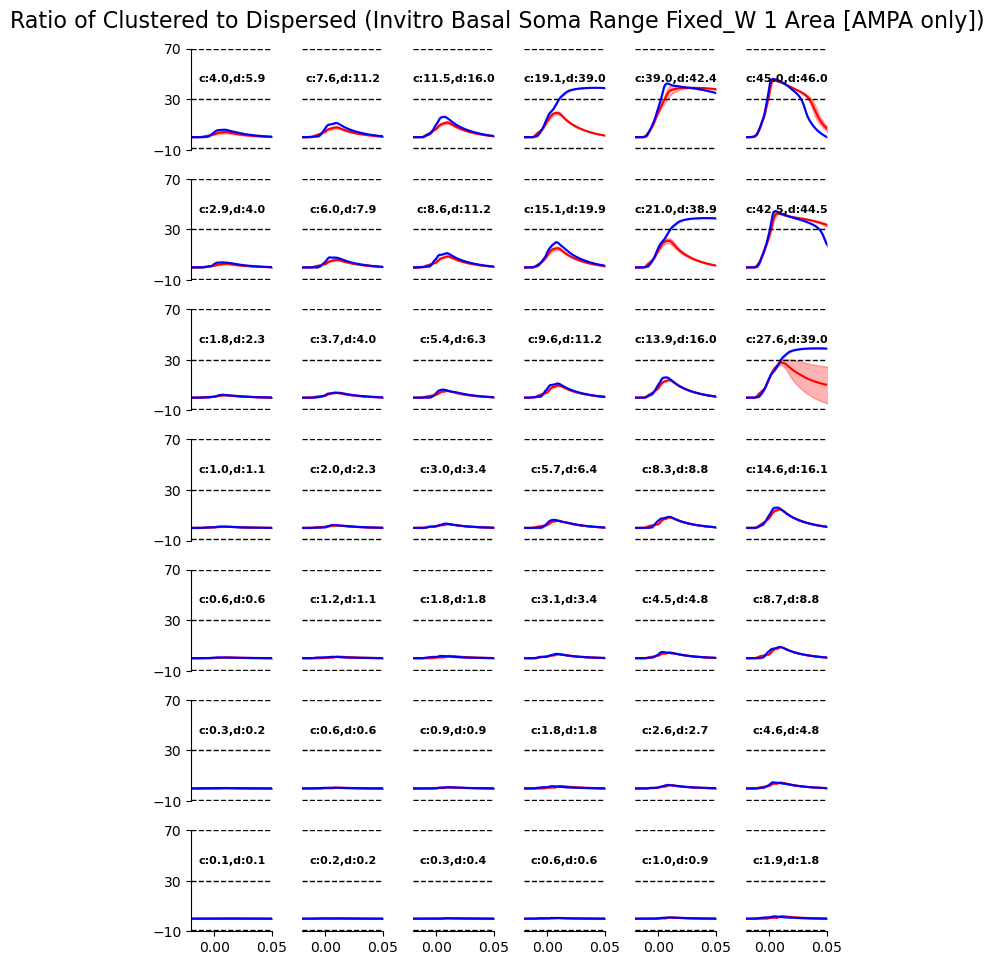

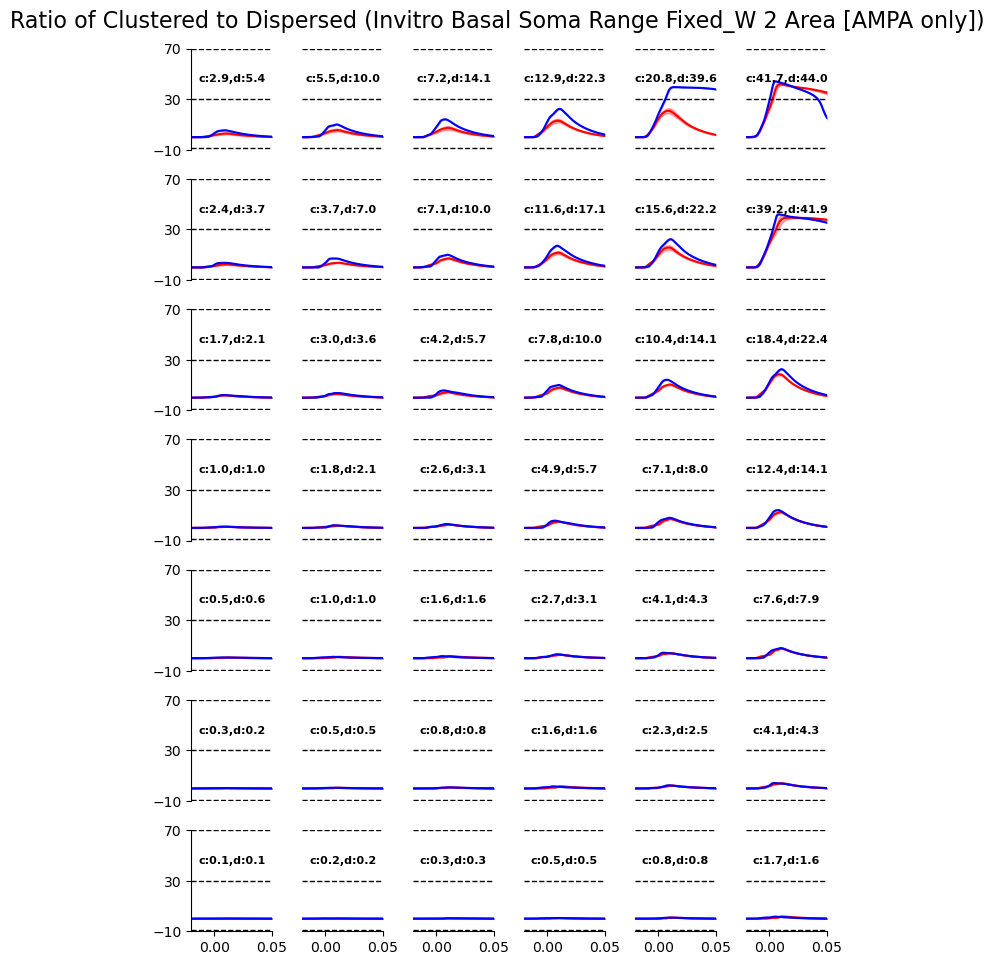

In [16]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invitro_AMPAonly', 'distr_invitro_AMPAonly', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Soma Range Fixed_W {range_idx} Area [AMPA only])')

5.14e-03 3.57e+00
1.85e-02 3.77e+00
3.70e-02 3.82e+00
8.44e-03 3.47e+00
1.63e-02 3.60e+00
3.57e-02 3.57e+00


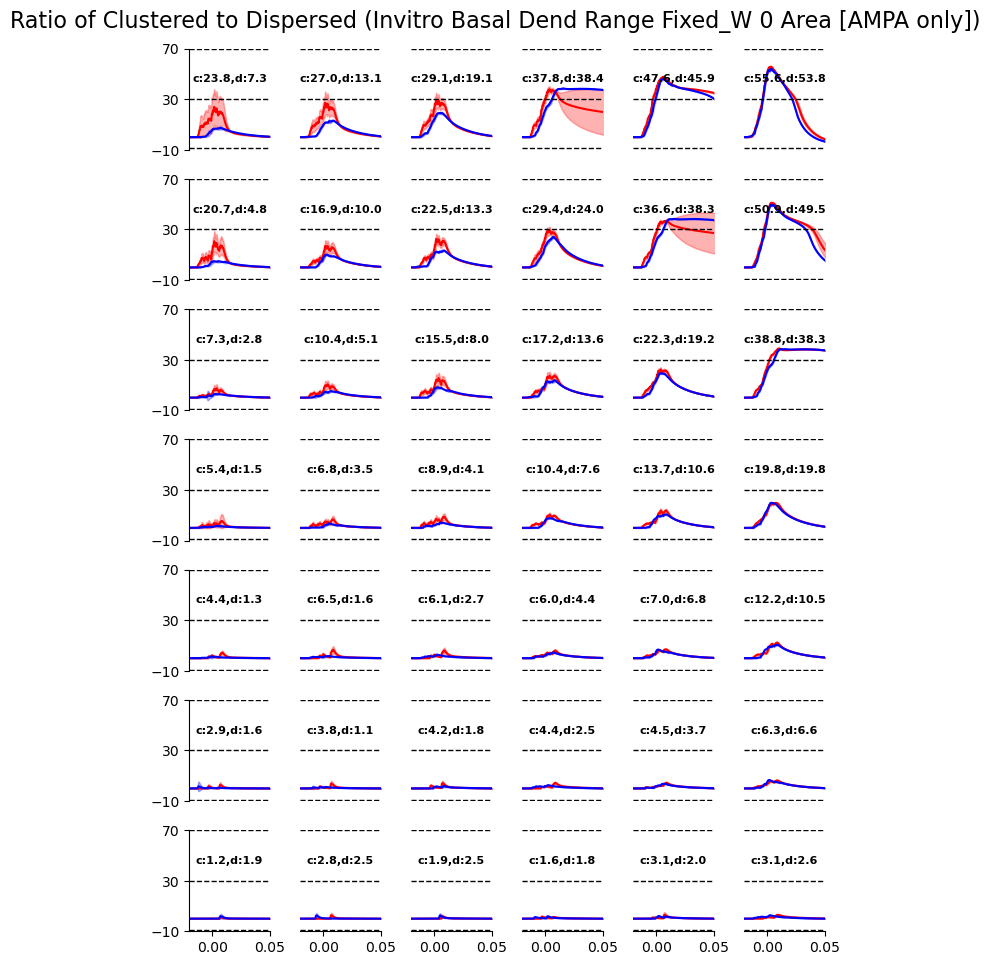

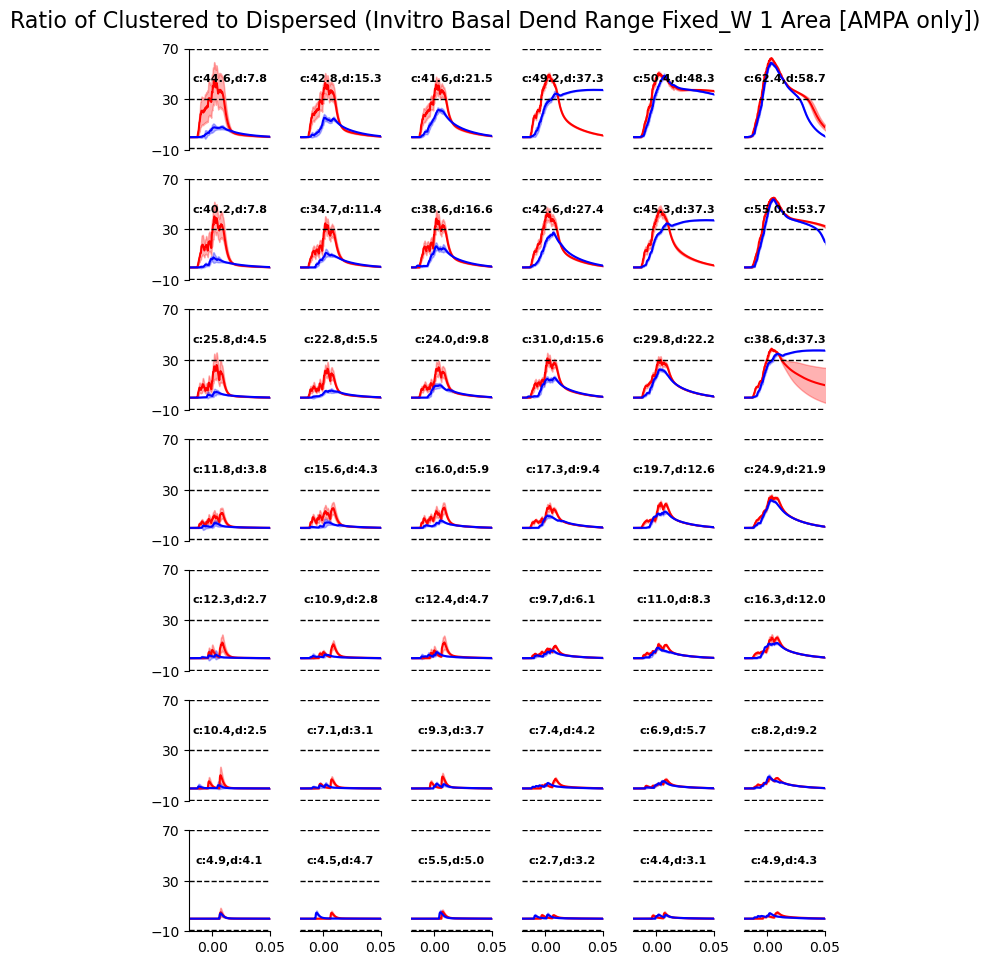

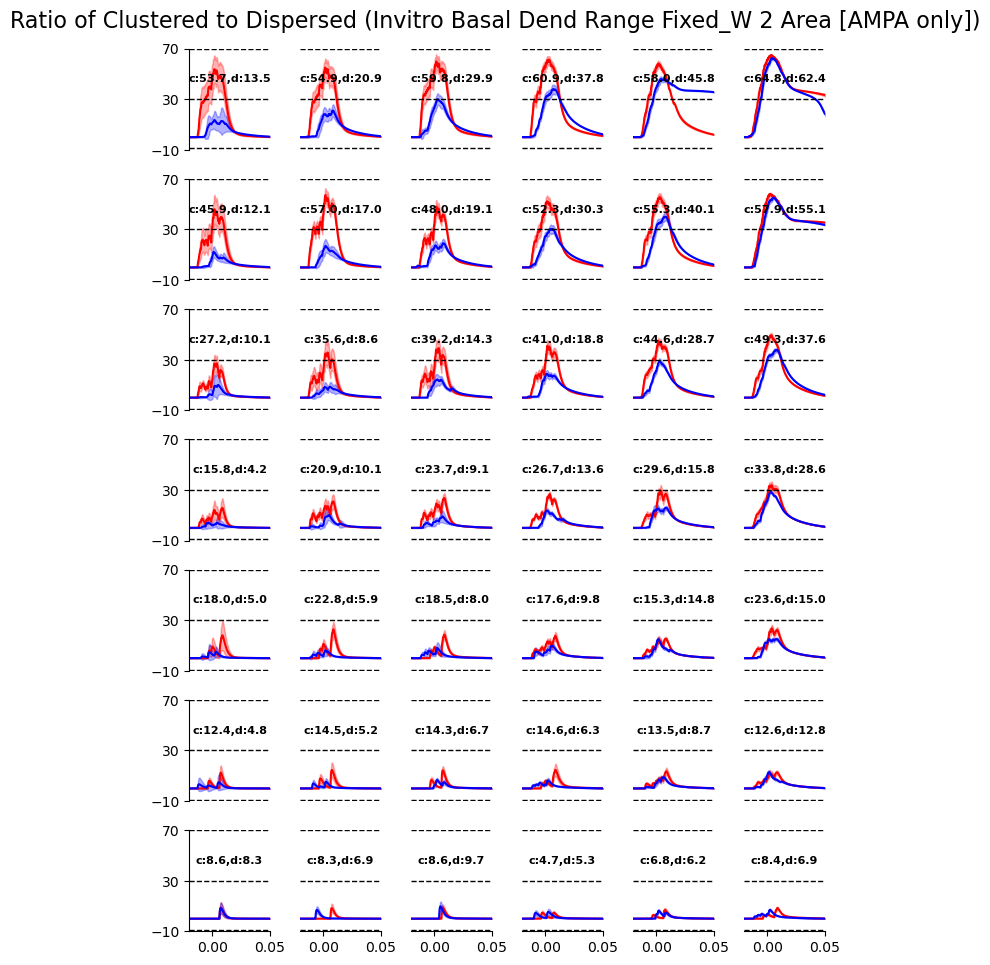

In [17]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_AMPAonly', 'distr_invitro_AMPAonly', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Dend Range Fixed_W {range_idx} Area [AMPA only])')

1.28e-03 1.15e+00
5.94e-04 5.76e-01
1.26e-04 1.79e-01
1.35e-03 1.19e+00
5.06e-04 5.93e-01
1.97e-04 1.87e-01


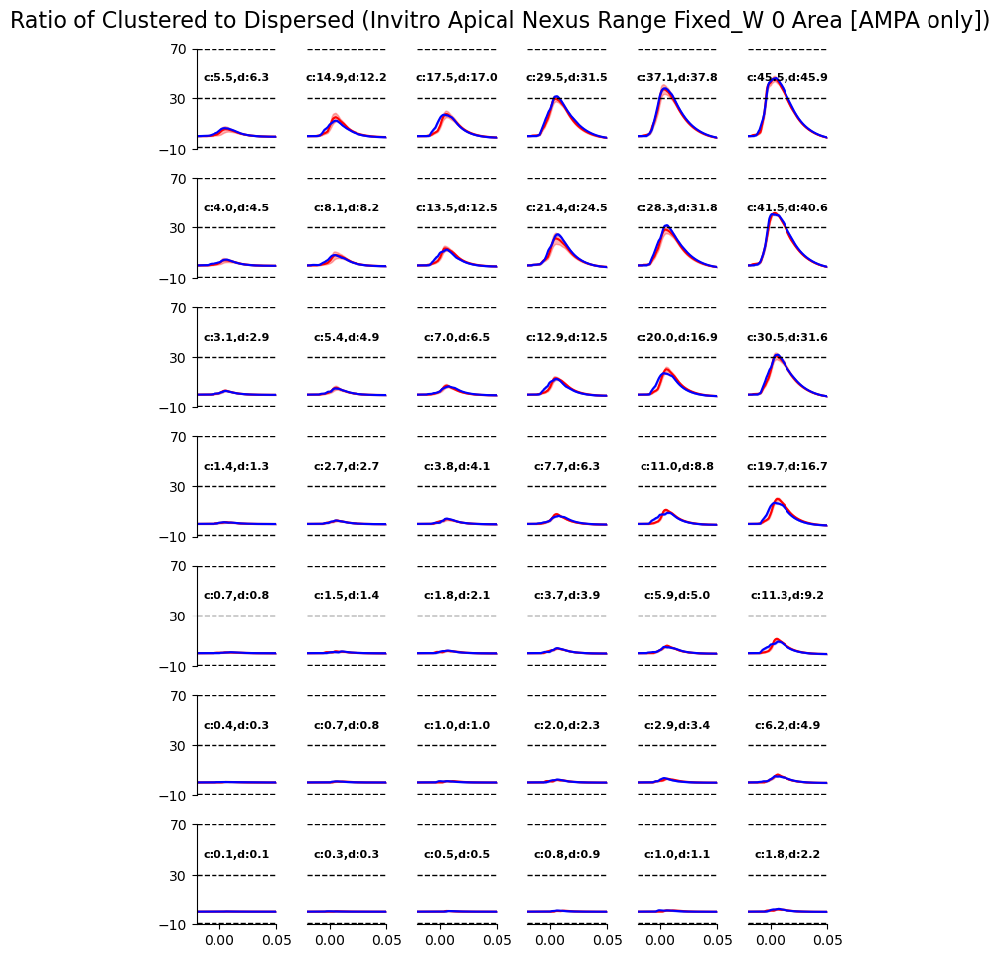

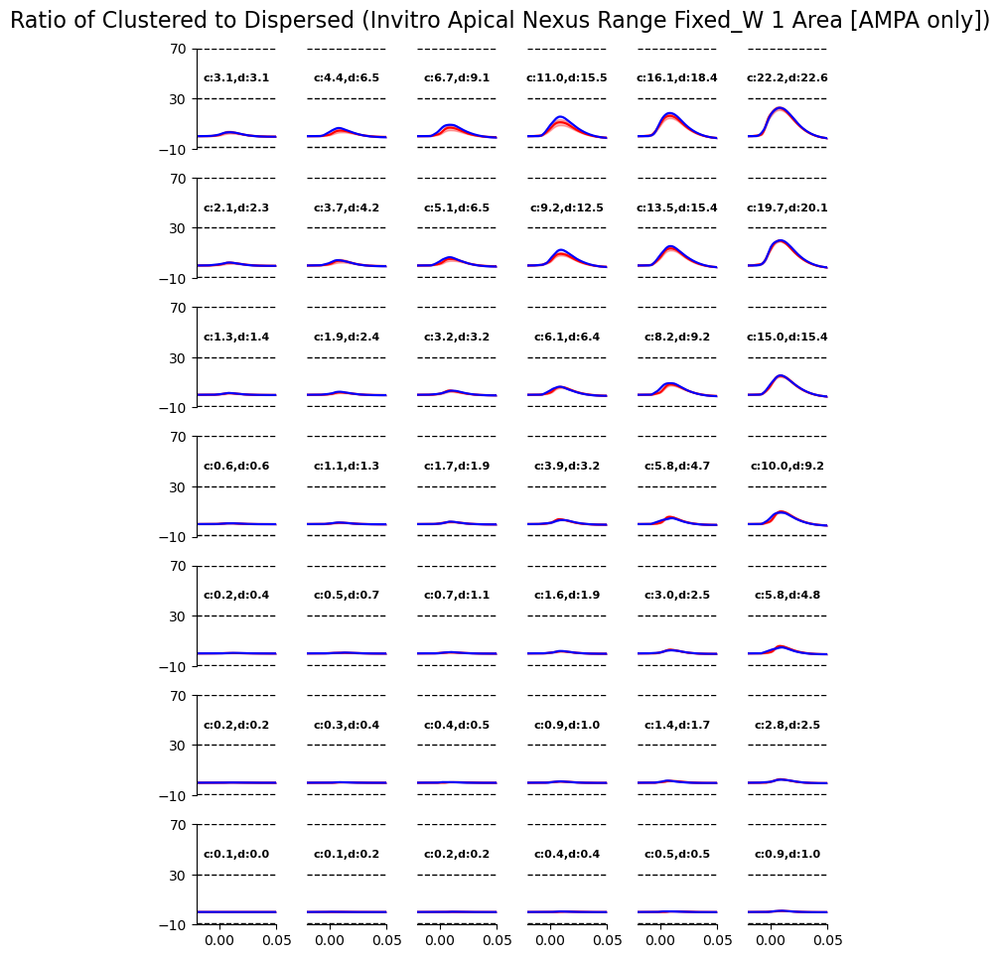

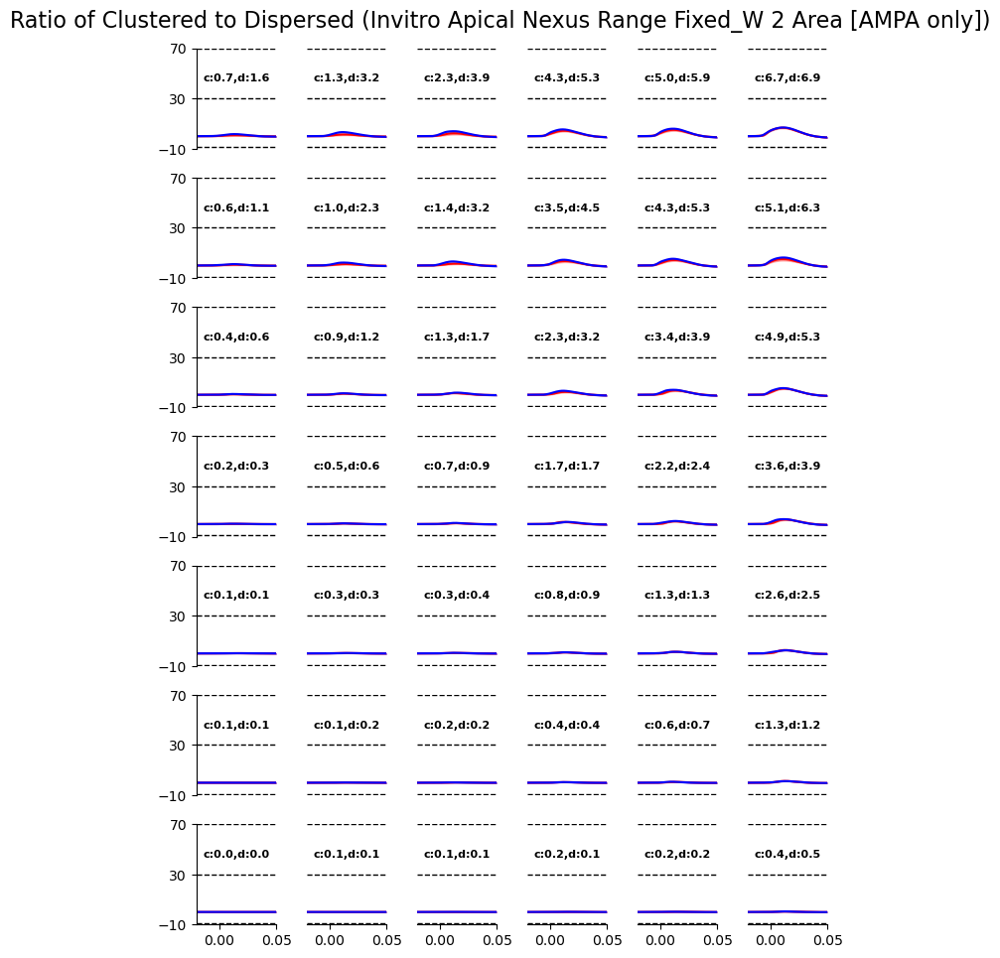

In [18]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invitro_AMPAonly', 'distr_invitro_AMPAonly', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Nexus Range Fixed_W {range_idx} Area [AMPA only])')

6.49e-03 1.41e+00
1.70e-02 1.45e+00
4.22e-02 1.57e+00
6.41e-03 1.43e+00
1.82e-02 1.44e+00
3.89e-02 1.59e+00


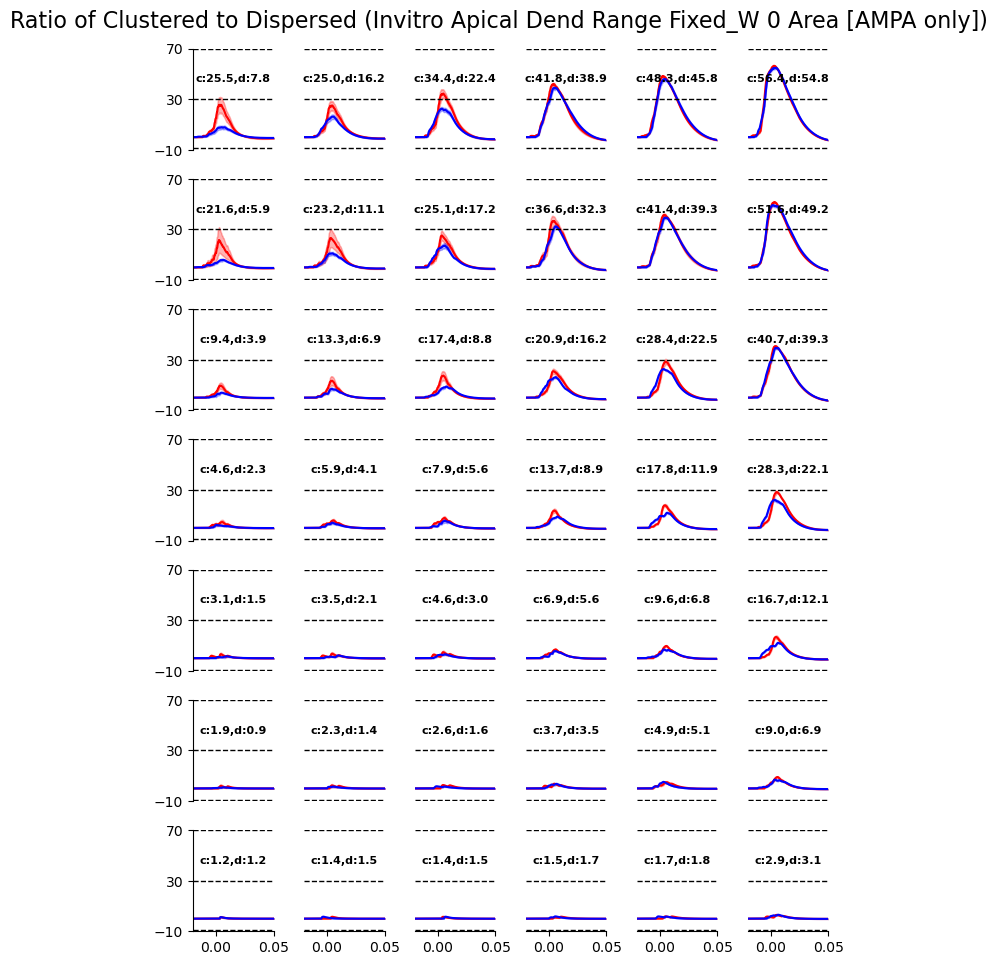

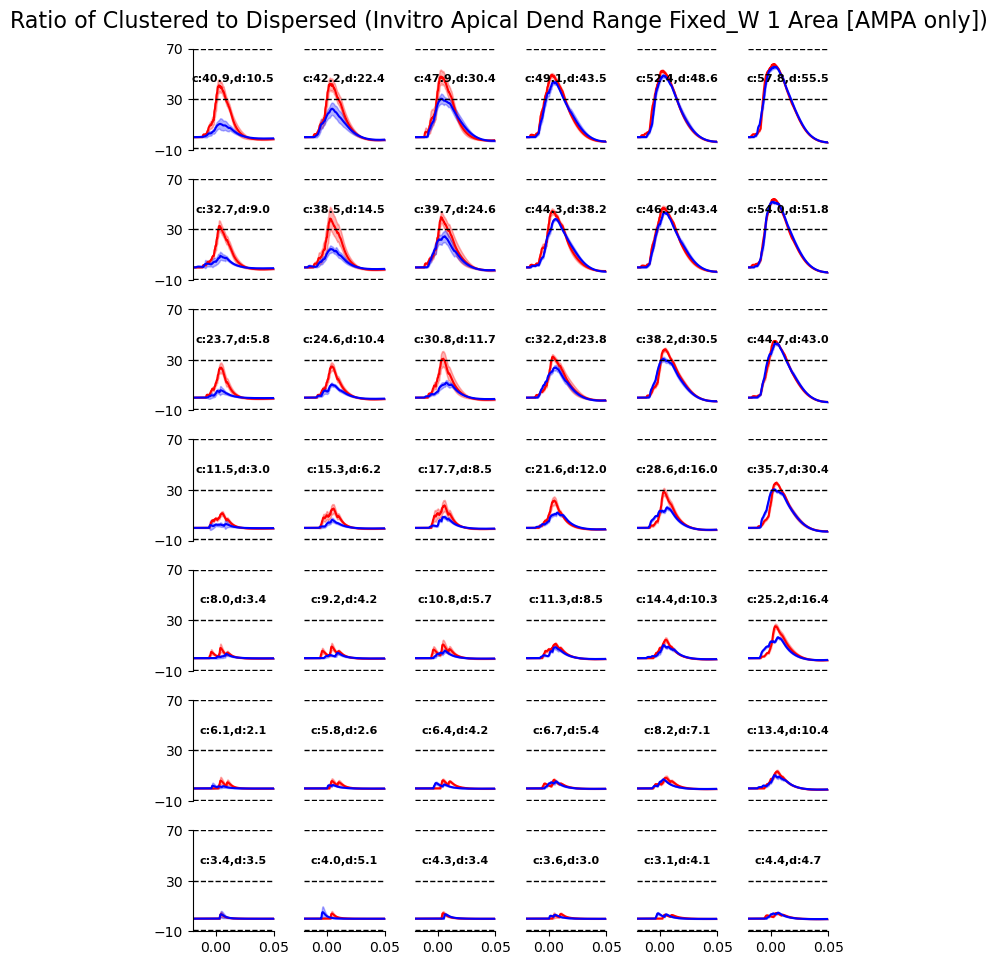

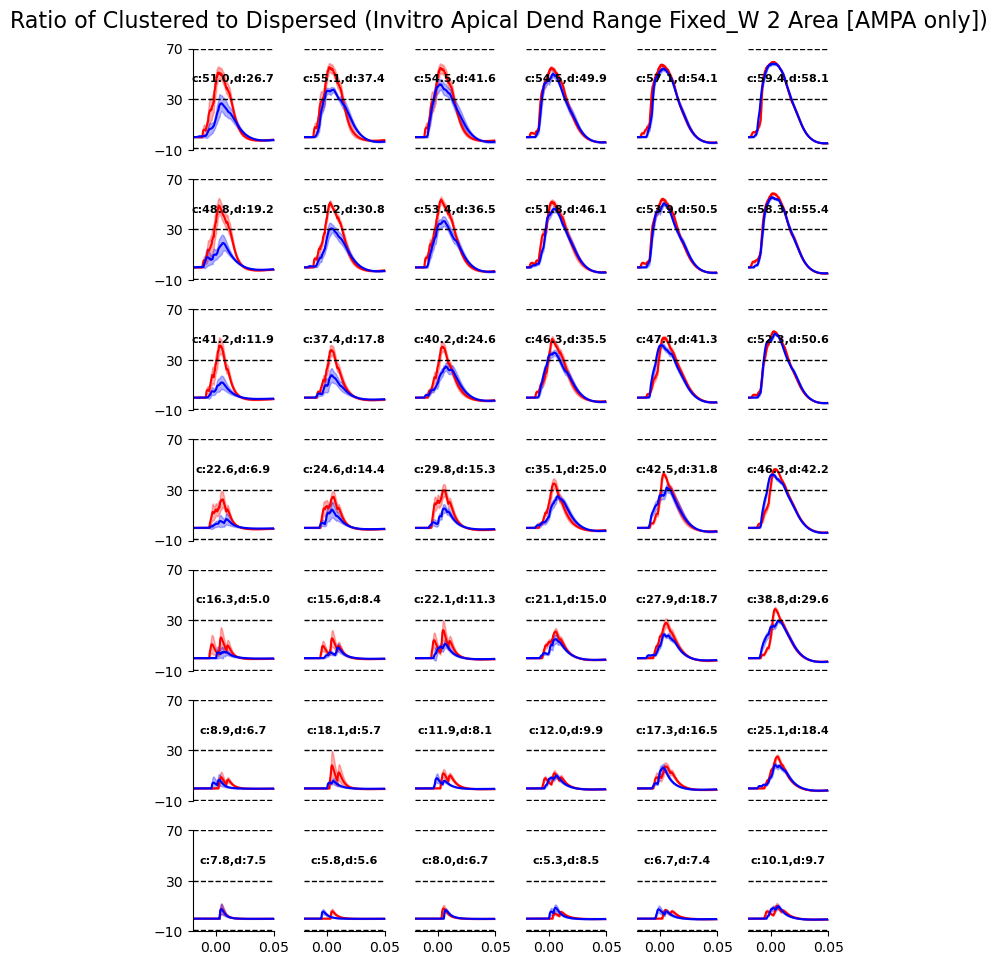

In [19]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_AMPAonly', 'distr_invitro_AMPAonly', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Dend Range Fixed_W {range_idx} Area [AMPA only])')

##### Lognorm W_dis 

2.74e-04 3.50e+00
3.29e-04 3.14e+00
1.24e-04 1.88e+00
5.46e-04 3.34e+00
6.35e-04 3.58e+00
7.15e-05 3.36e+00


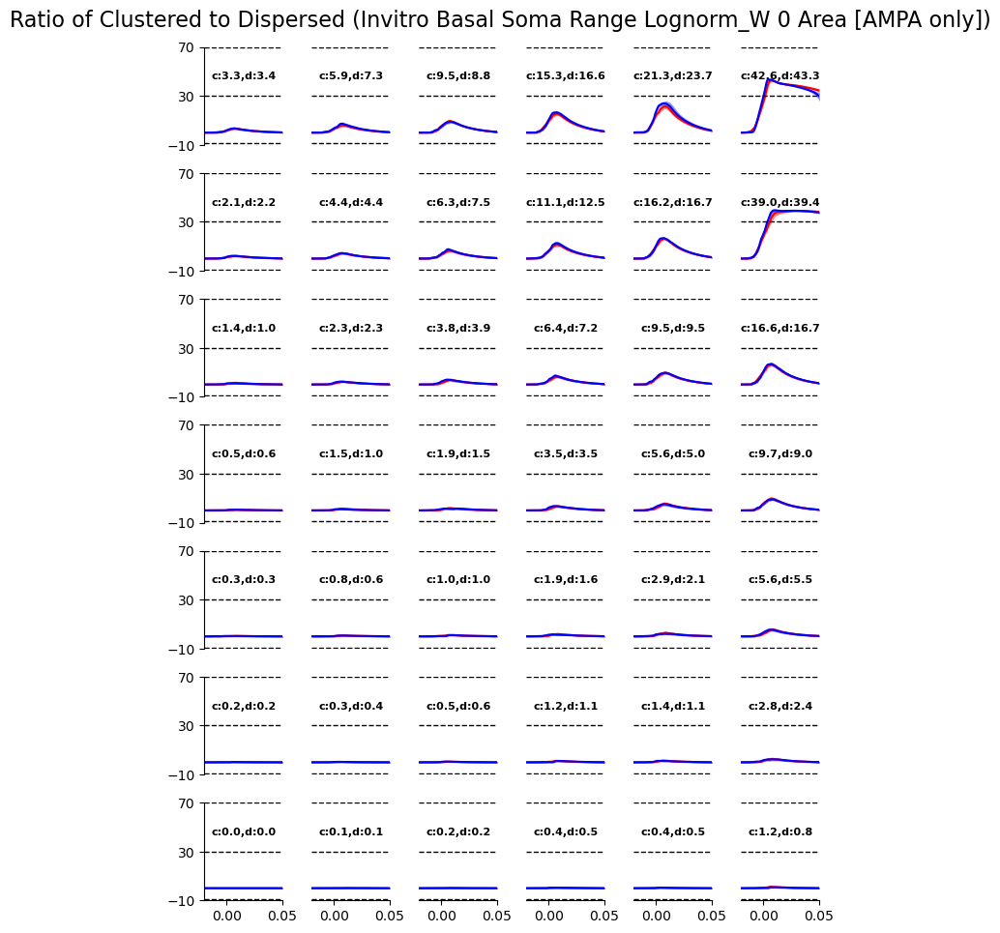

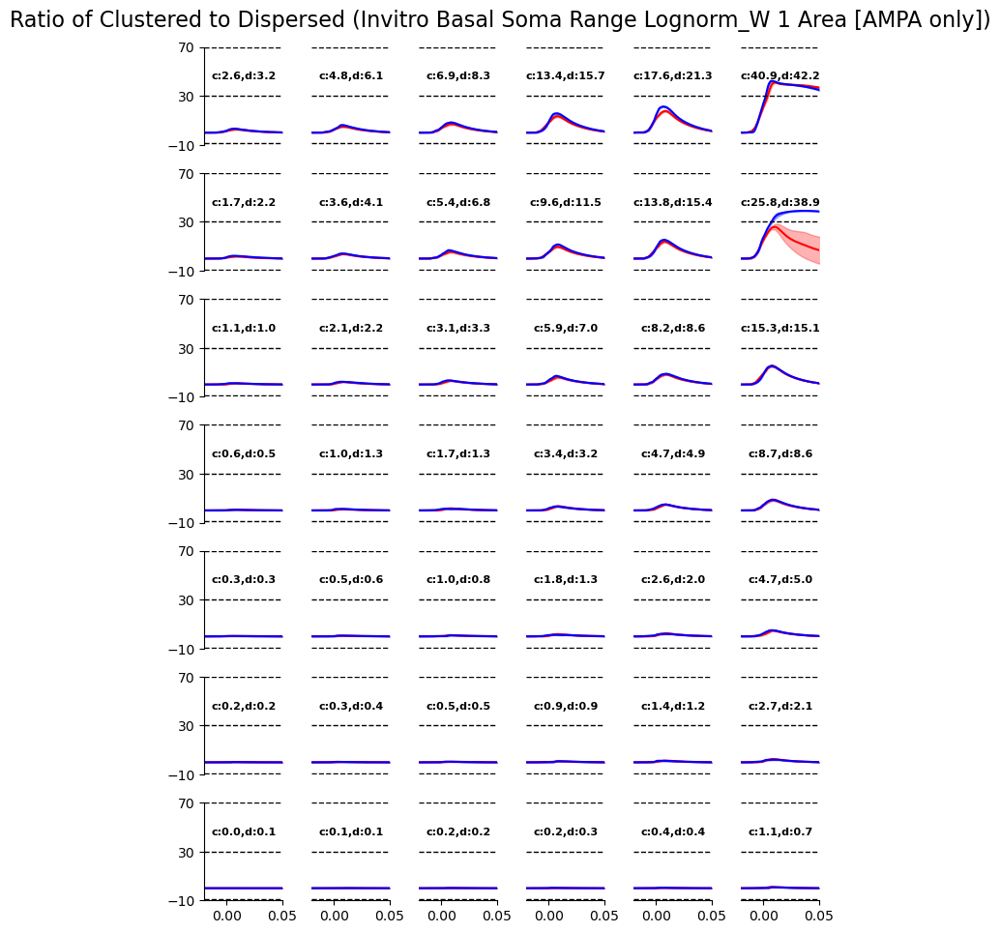

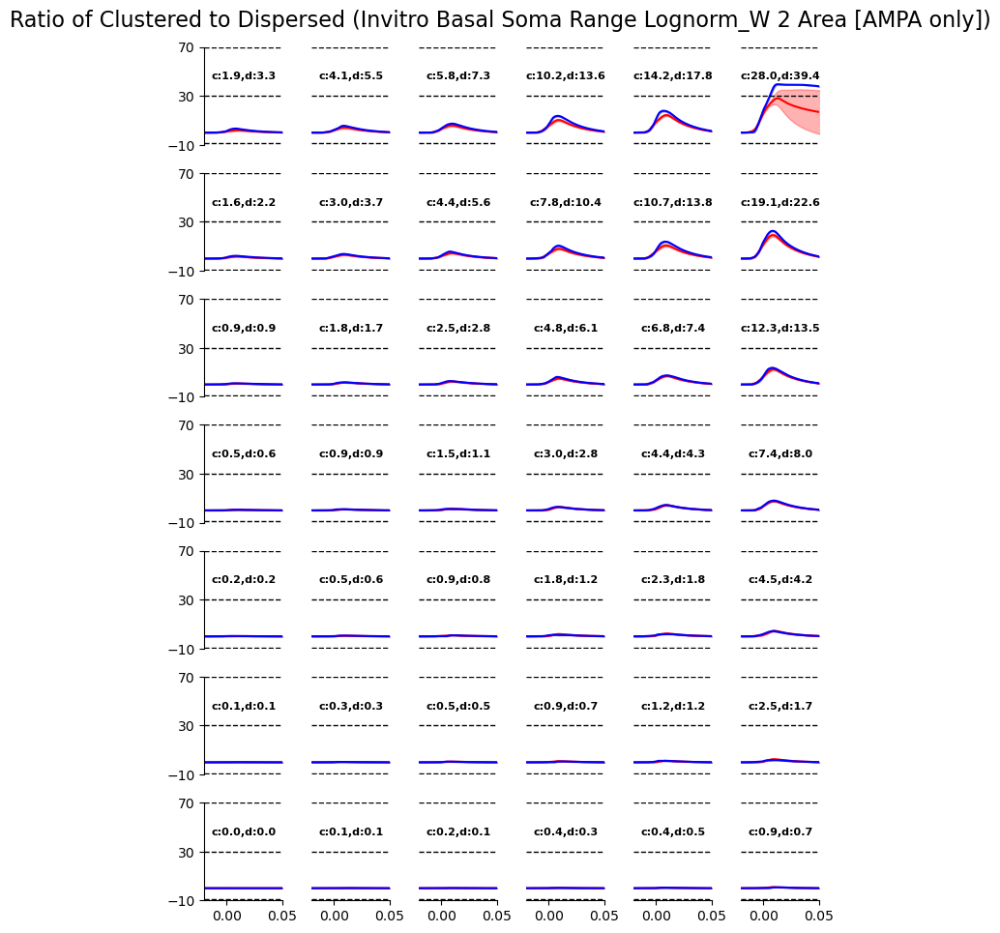

In [20]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_AMPAonly', 'distr_invitro_variedW_AMPAonly', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Soma Range Lognorm_W {range_idx} Area [AMPA only])')

1.97e-03 3.54e+00
6.60e-03 3.37e+00
1.72e-02 2.42e+00
1.85e-03 3.34e+00
1.01e-02 3.59e+00
9.40e-03 3.59e+00


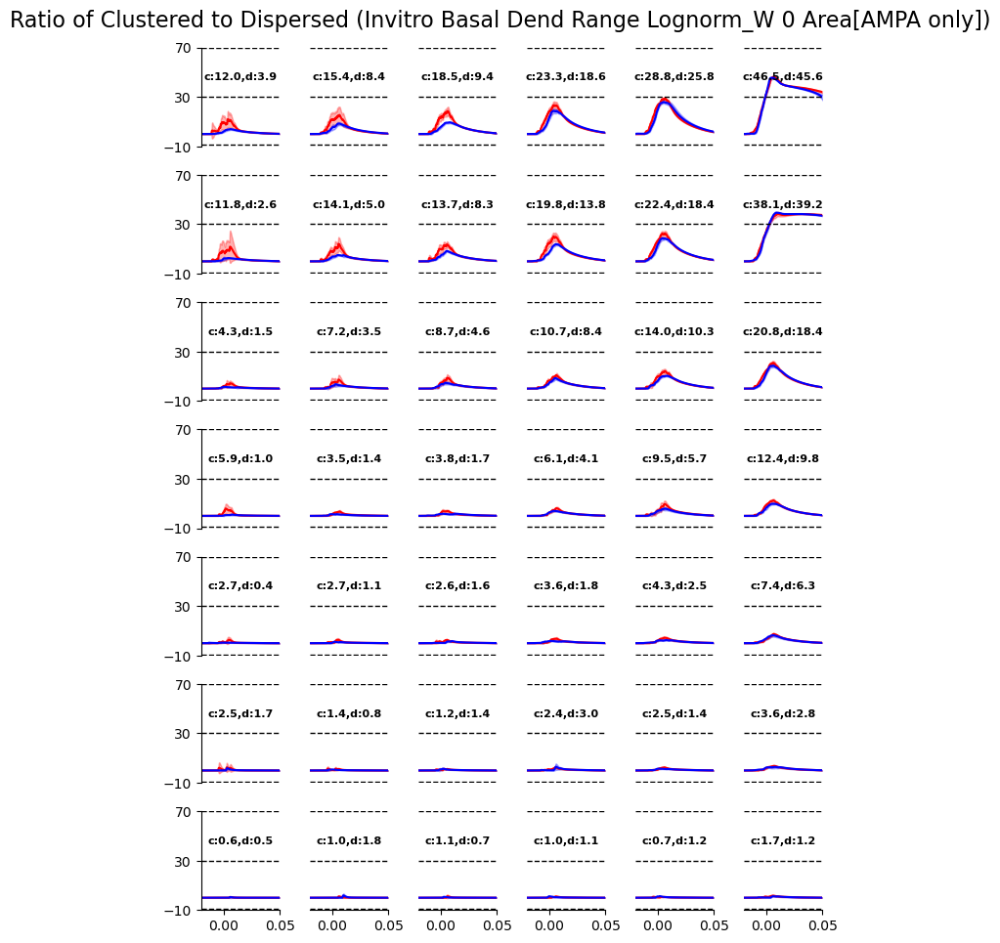

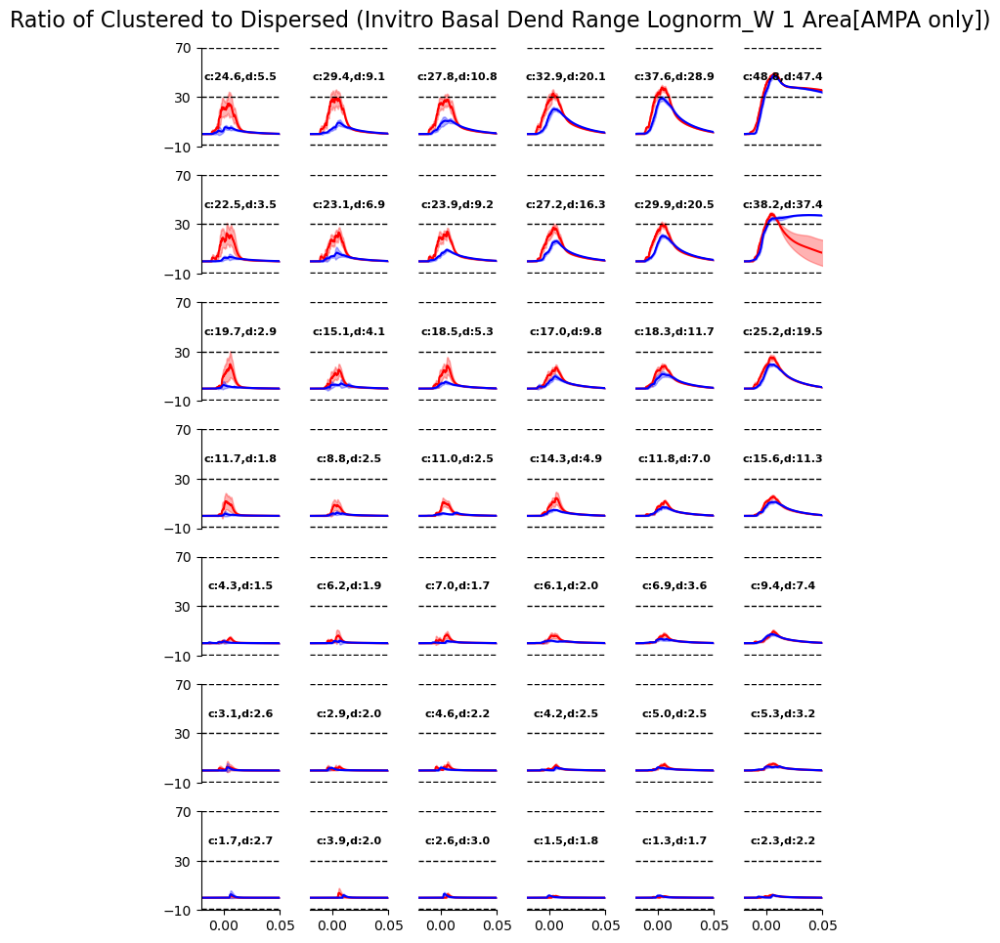

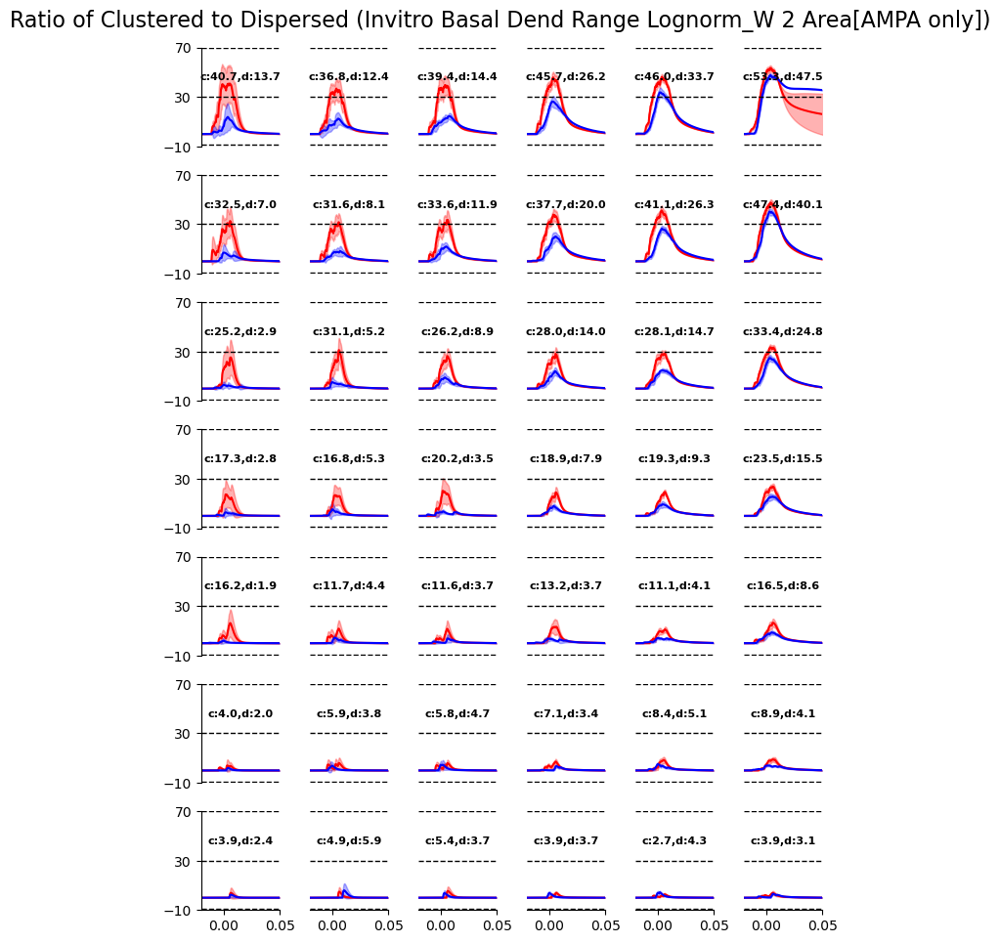

In [21]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_AMPAonly', 'distr_invitro_variedW_AMPAonly', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Dend Range Lognorm_W {range_idx} Area[AMPA only])')

1.06e-03 8.63e-01
7.42e-05 4.34e-01
5.21e-05 1.47e-01
9.48e-04 9.01e-01
1.61e-04 4.41e-01
1.49e-05 1.49e-01


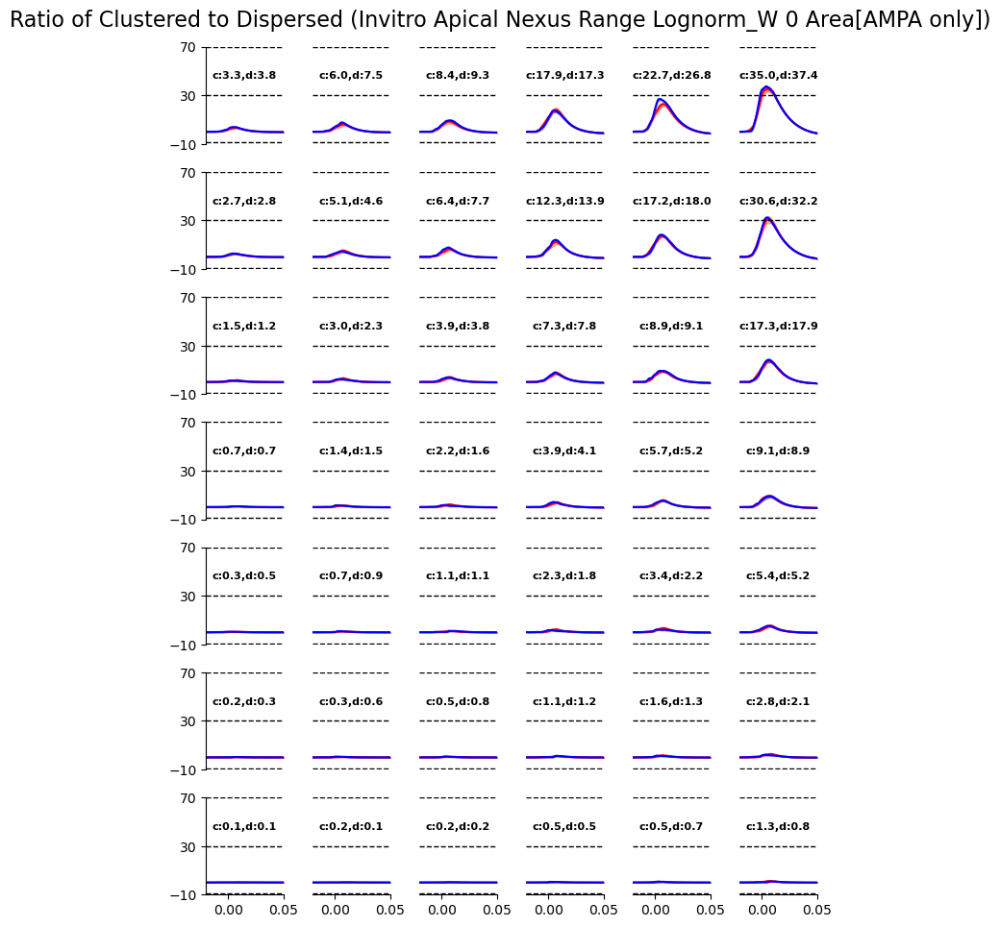

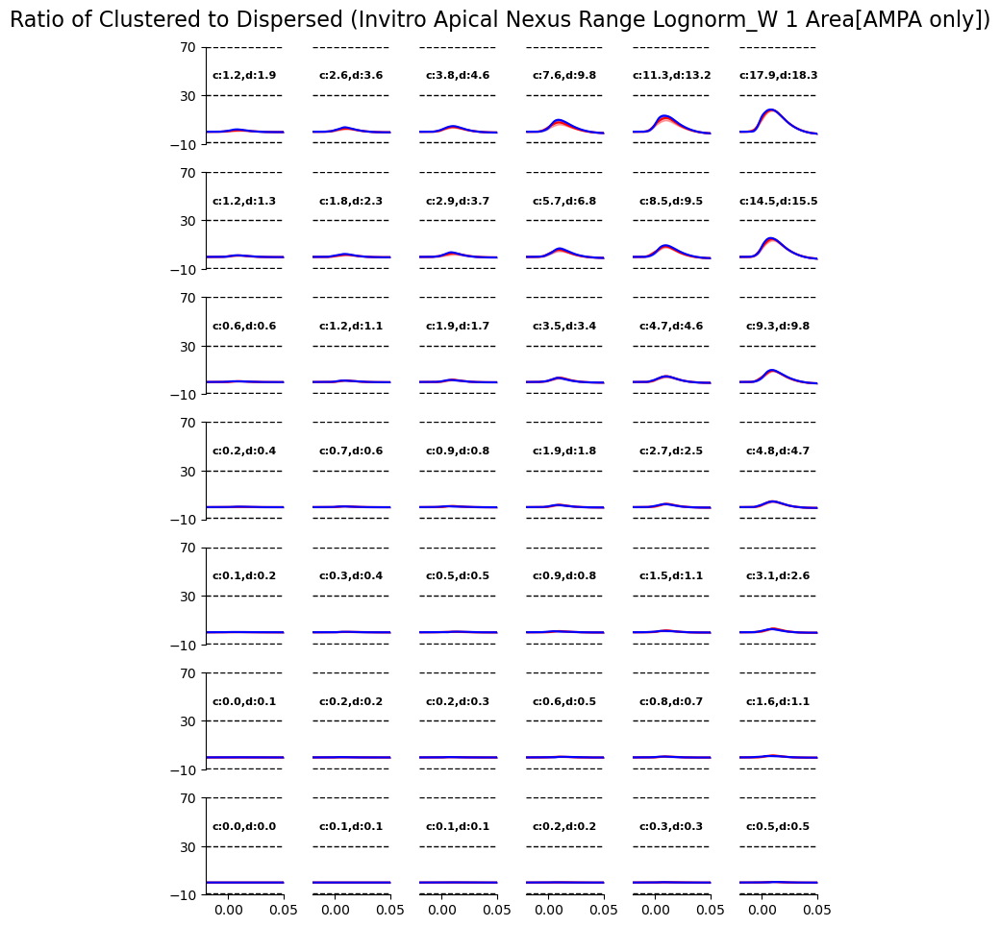

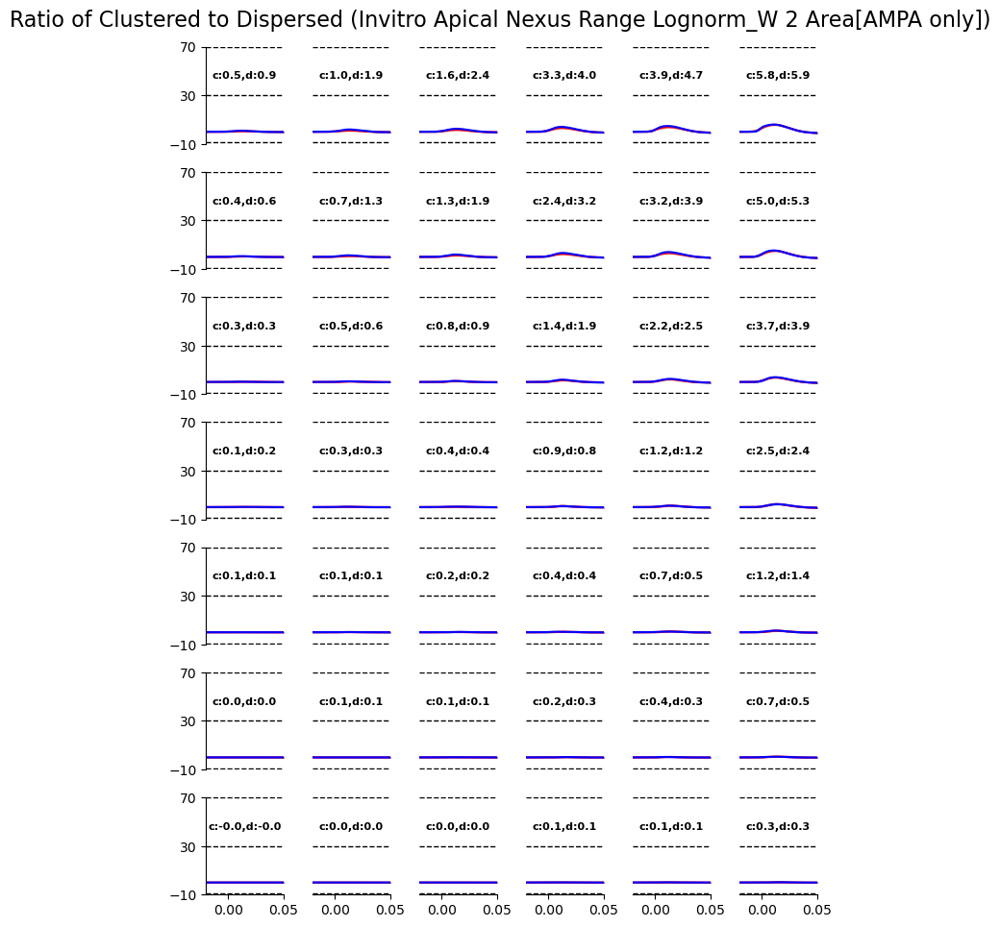

In [22]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_AMPAonly', 'distr_invitro_variedW_AMPAonly', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Nexus Range Lognorm_W {range_idx} Area[AMPA only])')

3.98e-03 1.14e+00
2.31e-03 1.18e+00
1.10e-02 1.35e+00
4.64e-03 1.12e+00
4.51e-03 1.15e+00
1.22e-02 1.25e+00


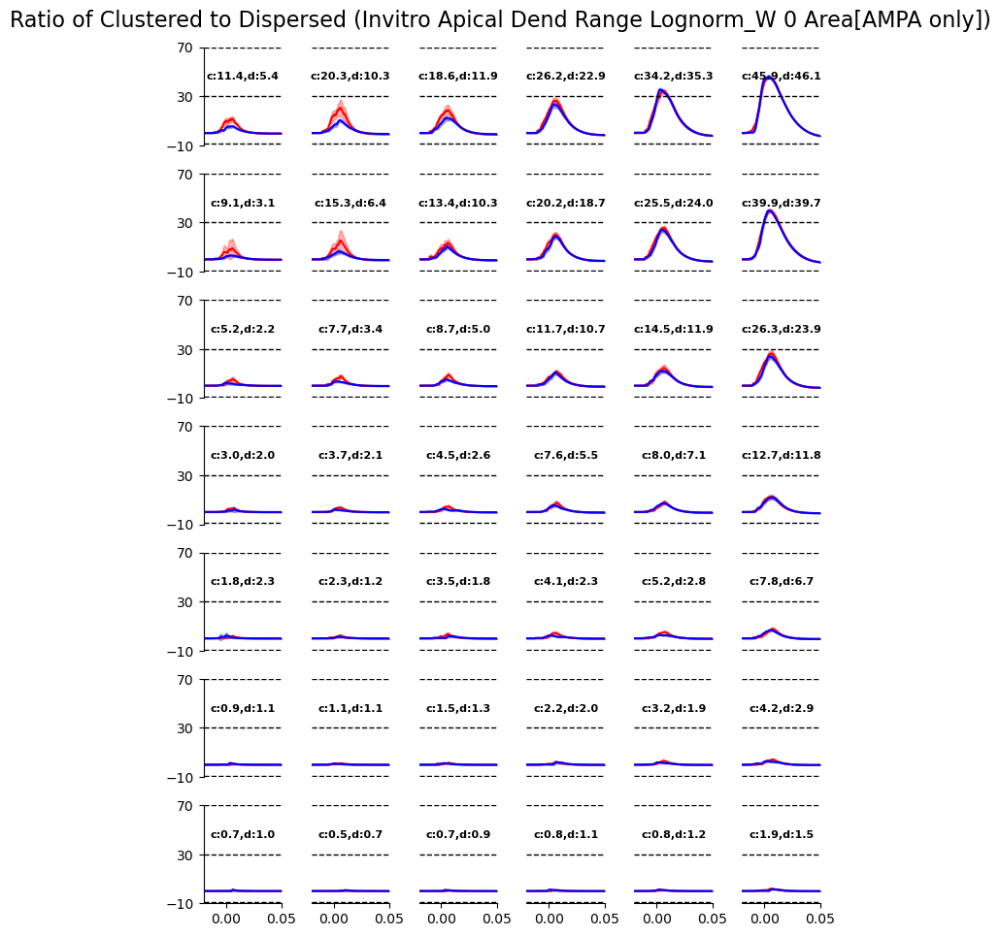

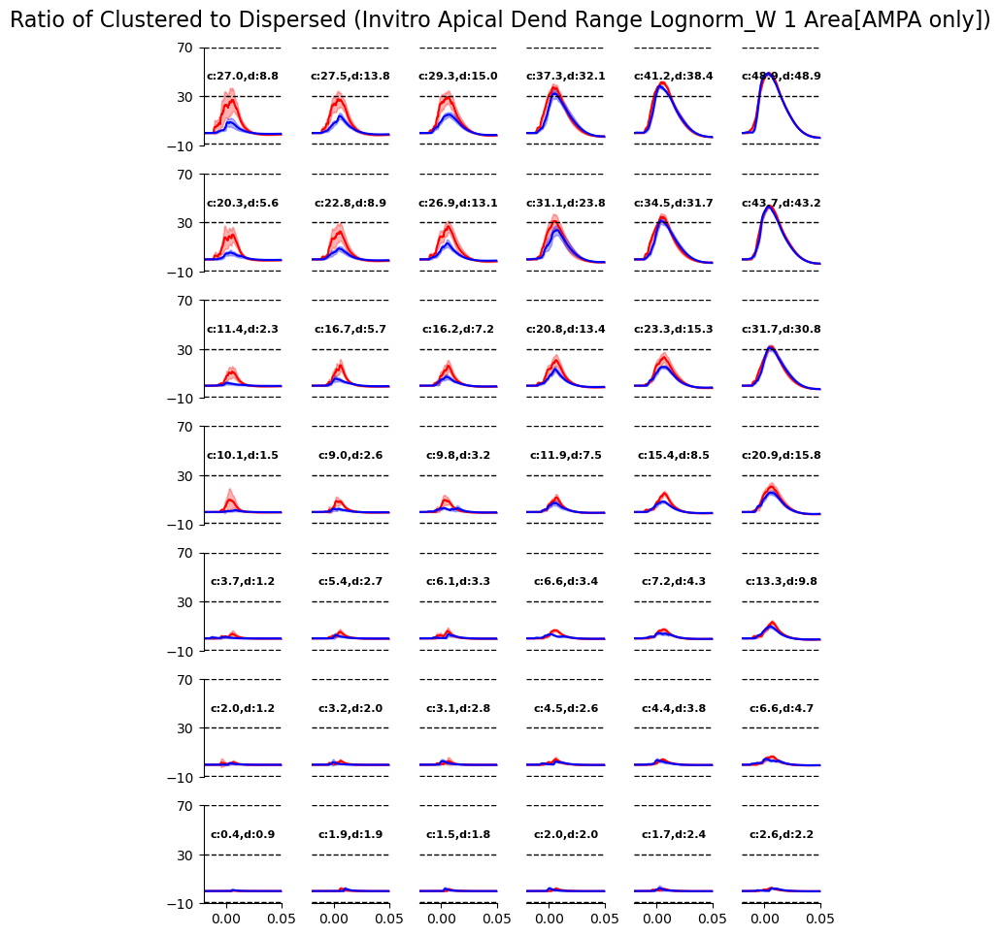

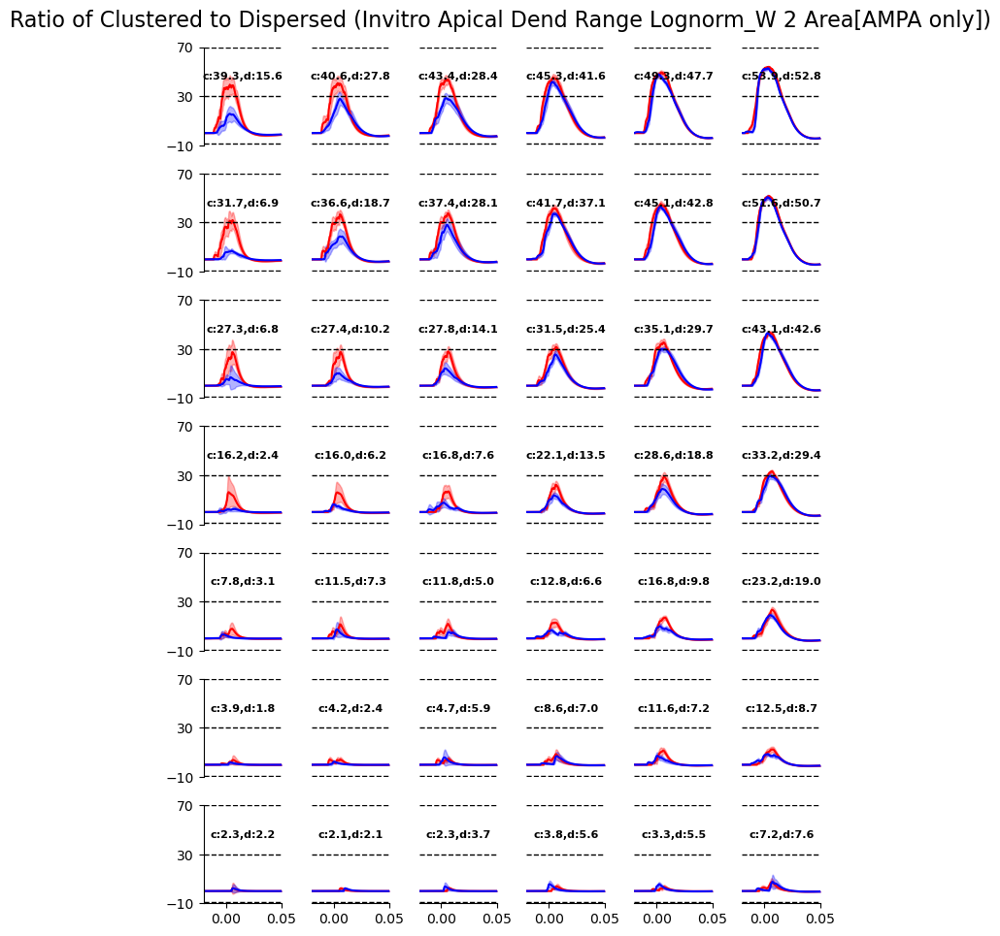

In [23]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_AMPAonly', 'distr_invitro_variedW_AMPAonly', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Dend Range Lognorm_W {range_idx} Area[AMPA only])')

##### Lognorm W_dis with AP

6.94e-05 6.80e-01
1.69e-03 6.27e-01
1.40e-05 6.35e-01
2.58e-04 6.86e-01
1.01e-03 6.96e-01
7.81e-05 7.29e-01


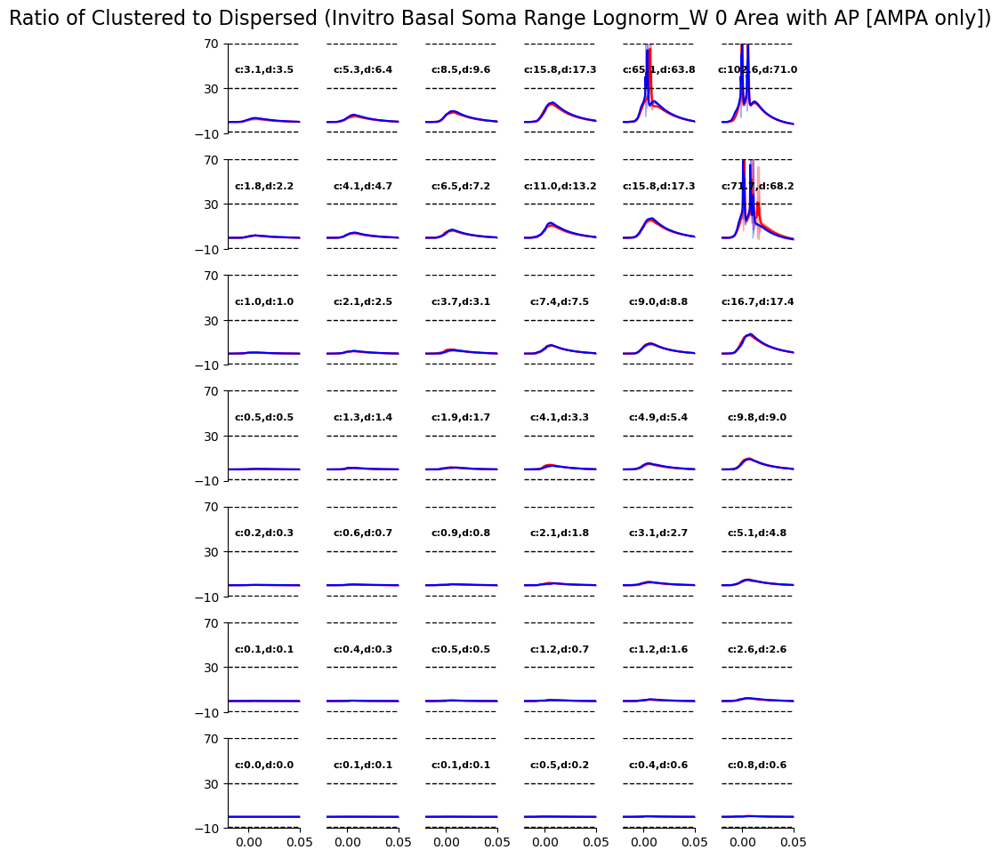

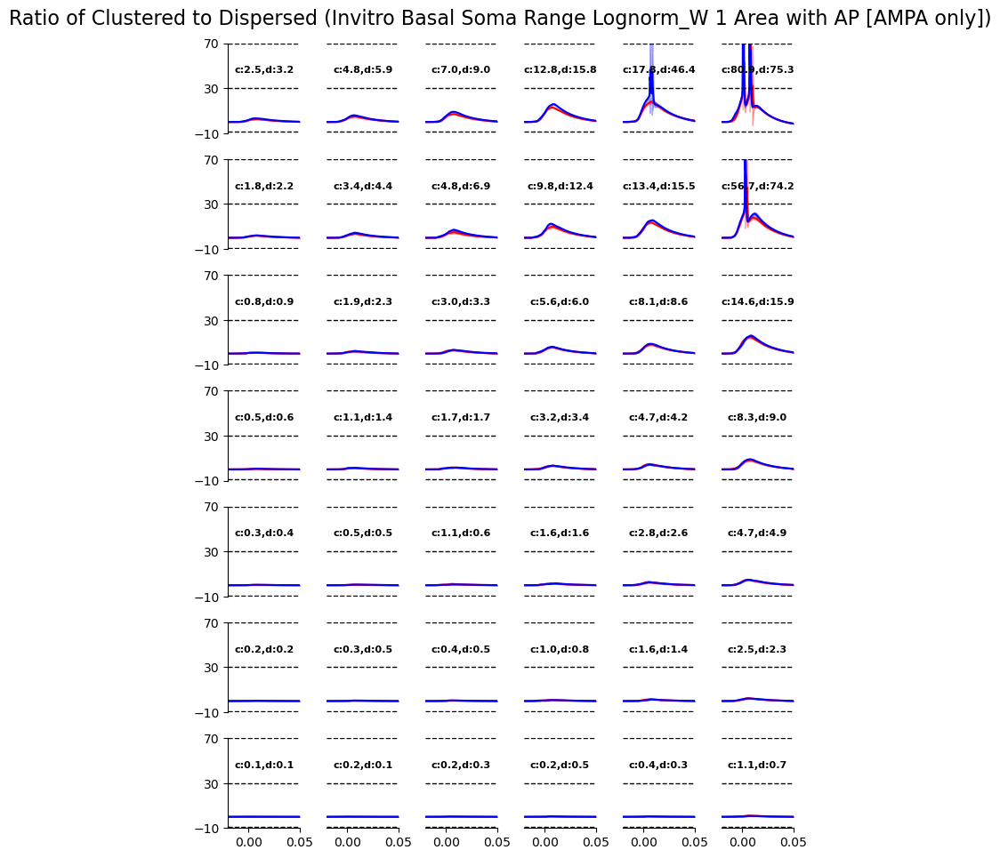

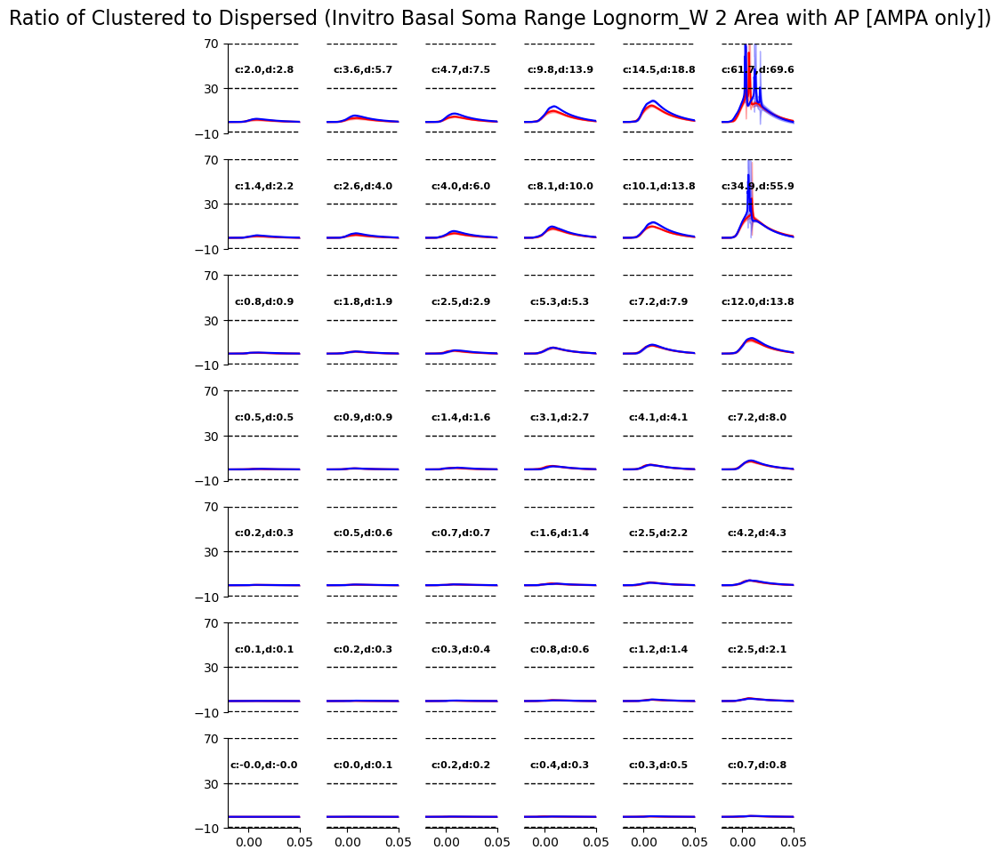

In [24]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_AMPAonly_withAP', 'distr_invitro_variedW_AMPAonly_withAP', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Soma Range Lognorm_W {range_idx} Area with AP [AMPA only])')

1.27e-03 7.98e-01
1.39e-02 9.49e-01
6.81e-03 1.30e+00
2.67e-03 7.70e-01
1.23e-02 8.76e-01
8.55e-03 1.18e+00


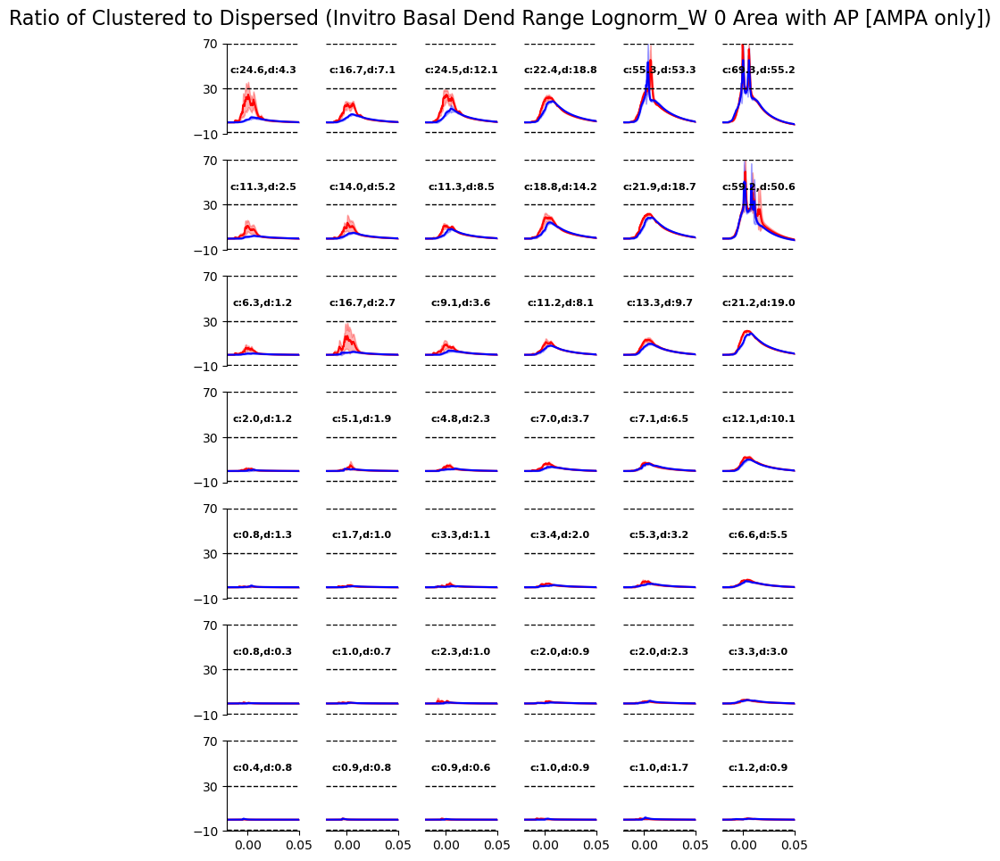

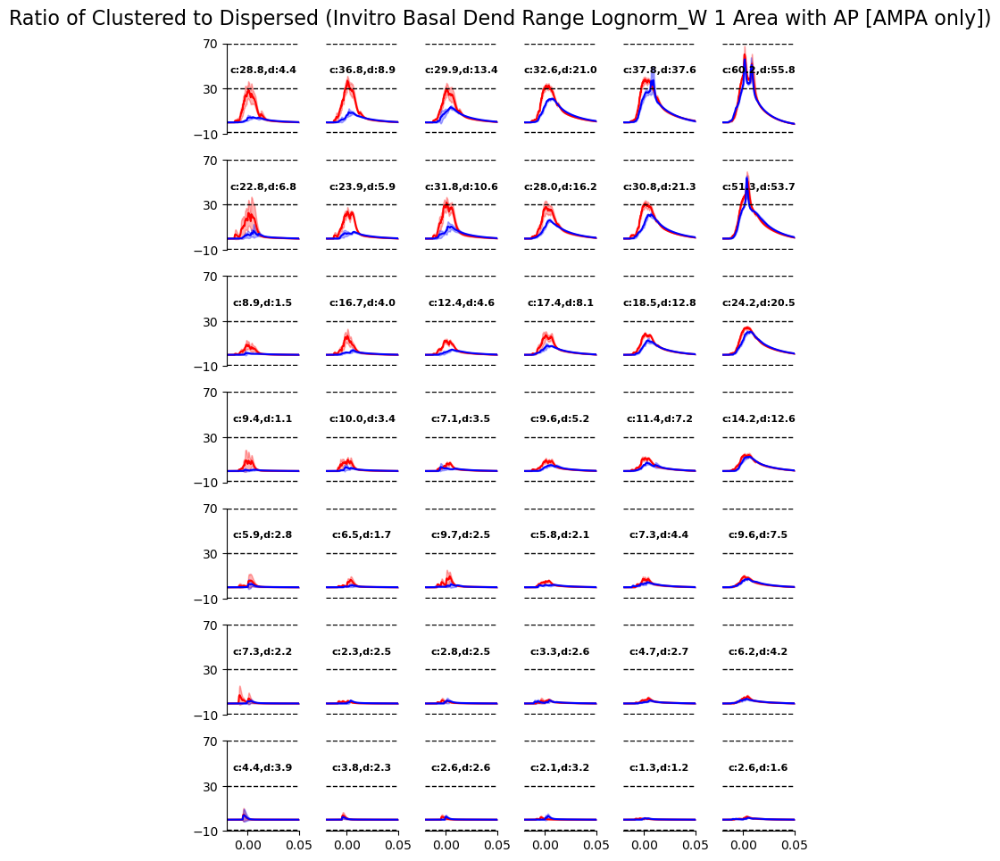

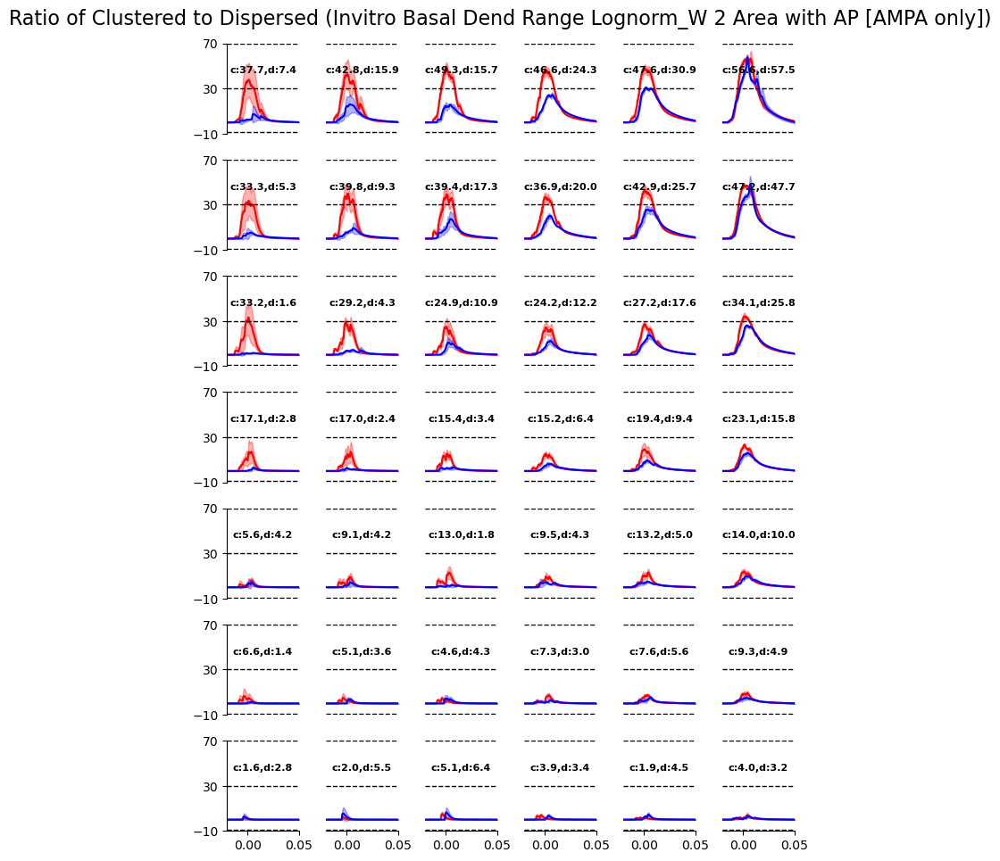

In [25]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_AMPAonly_withAP', 'distr_invitro_variedW_AMPAonly_withAP', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Basal Dend Range Lognorm_W {range_idx} Area with AP [AMPA only])')

3.81e-04 1.82e+00
2.32e-04 1.25e+00
9.93e-05 1.69e-01
4.18e-04 1.87e+00
8.83e-05 1.86e+00
4.11e-05 1.87e-01


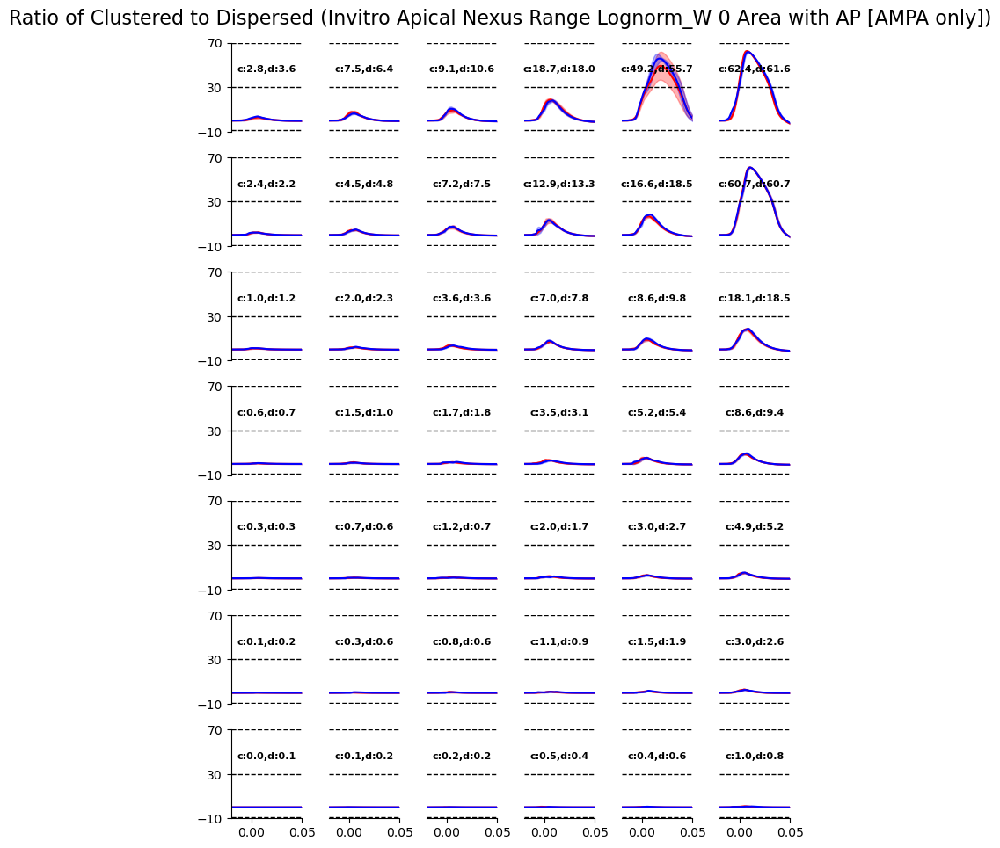

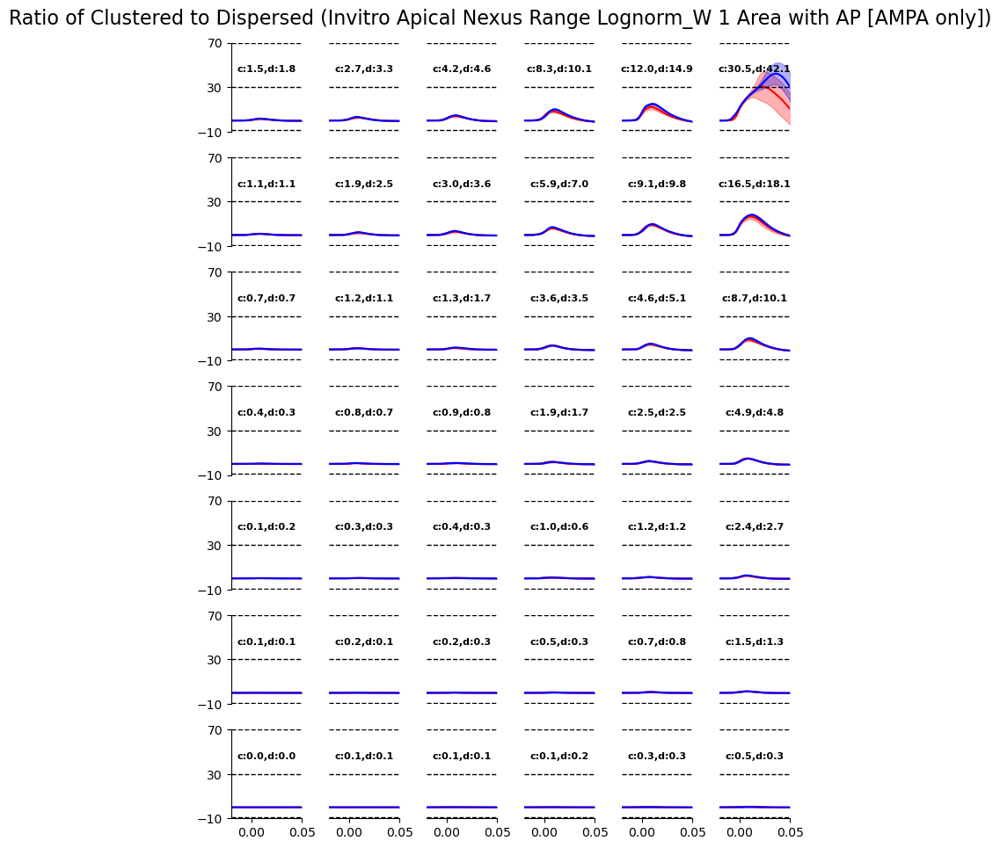

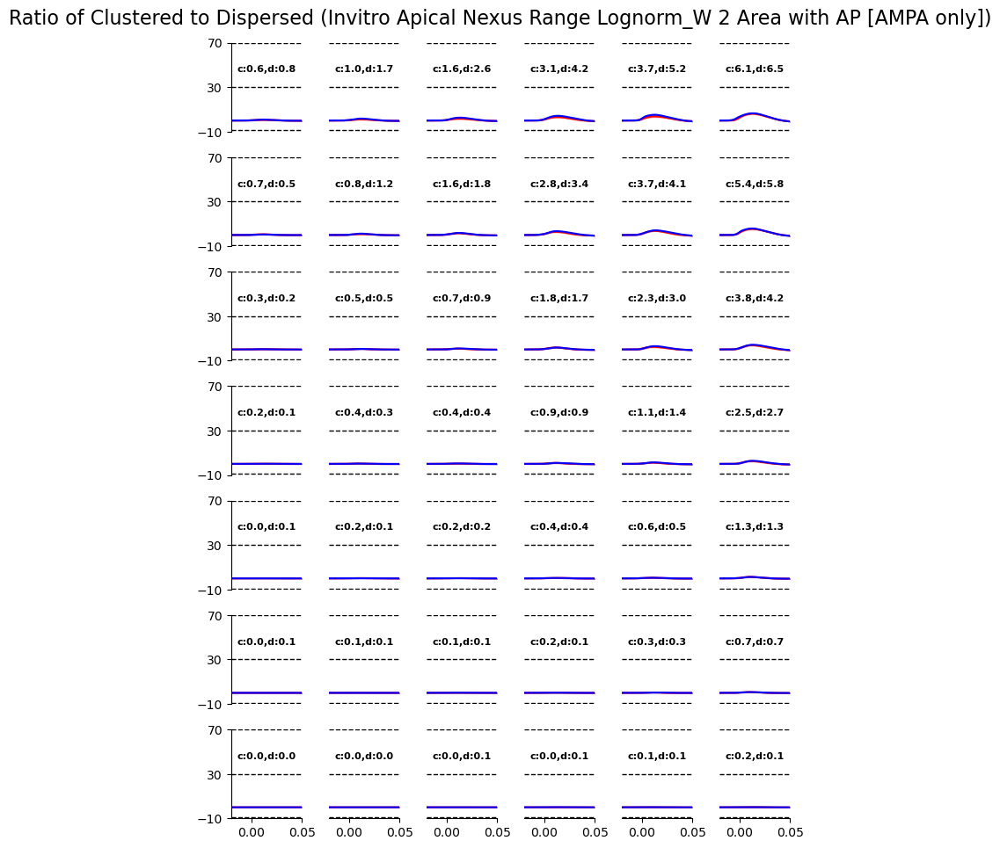

In [26]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_AMPAonly_withAP', 'distr_invitro_variedW_AMPAonly_withAP', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Nexus Range Lognorm_W {range_idx} Area with AP [AMPA only])')

1.19e-03 2.11e+00
7.02e-03 2.09e+00
1.14e-02 1.53e+00
8.78e-04 2.19e+00
3.83e-03 2.64e+00
1.58e-02 1.61e+00


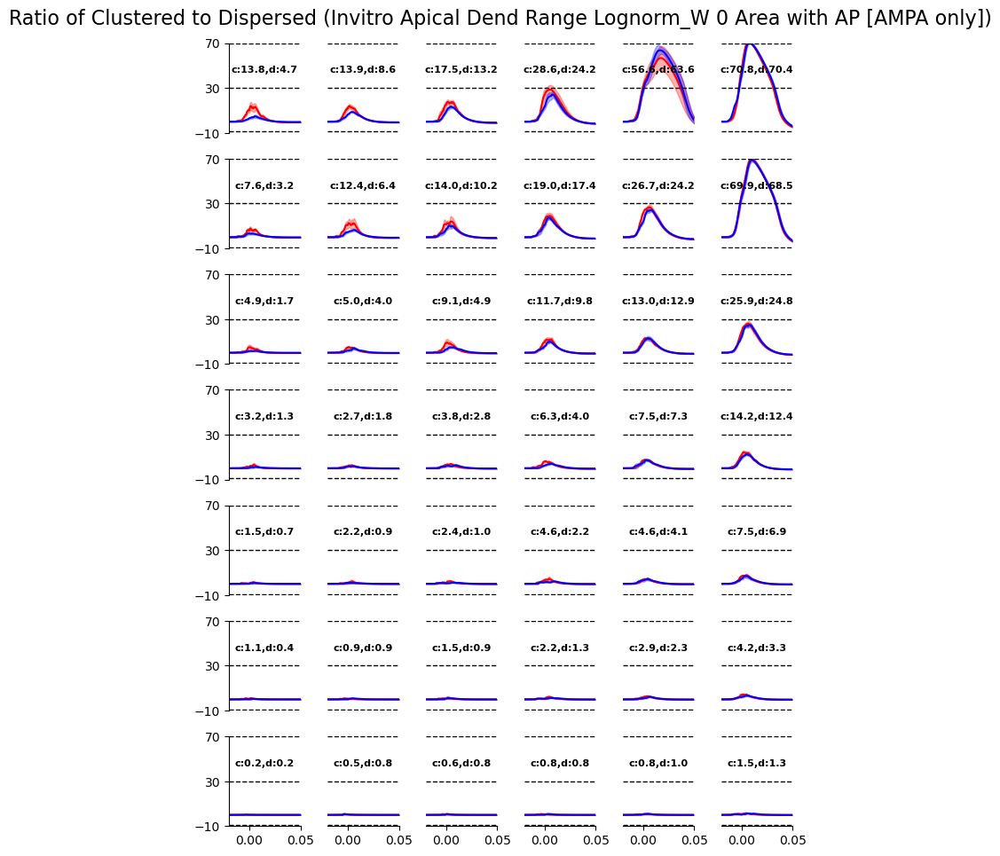

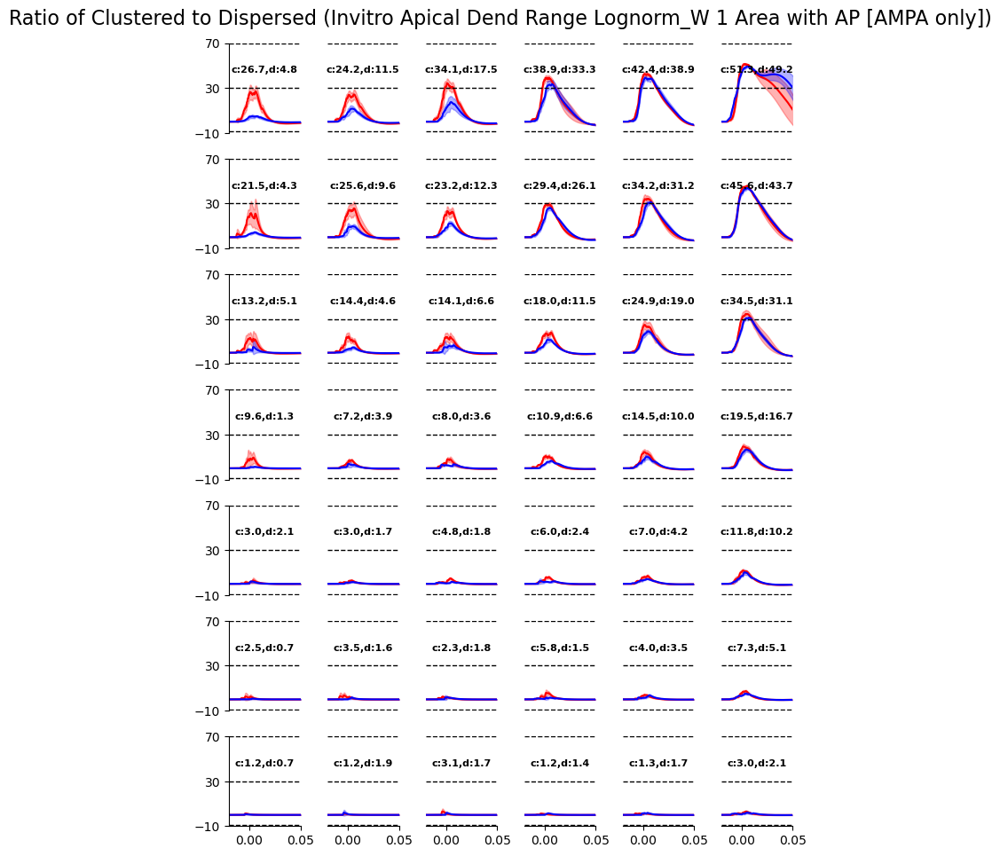

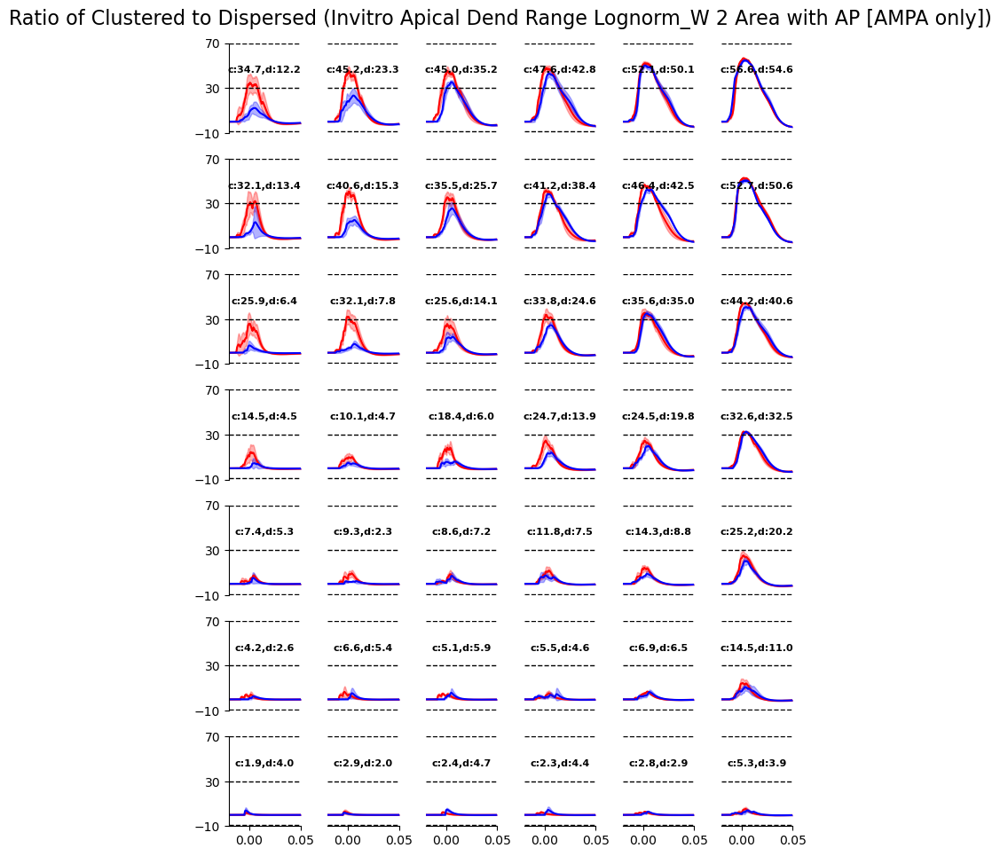

In [27]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invitro_variedW_AMPAonly_withAP', 'distr_invitro_variedW_AMPAonly_withAP', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invitro Apical Dend Range Lognorm_W {range_idx} Area with AP [AMPA only])')

### In vivo

#### NMDA and AMPA

##### Fixed W_dis

9.25e-02 6.24e-01
3.53e-02 4.20e-01
4.90e-02 2.74e-01
1.02e-01 5.78e-01
9.29e-02 4.28e-01
6.75e-02 2.39e-01


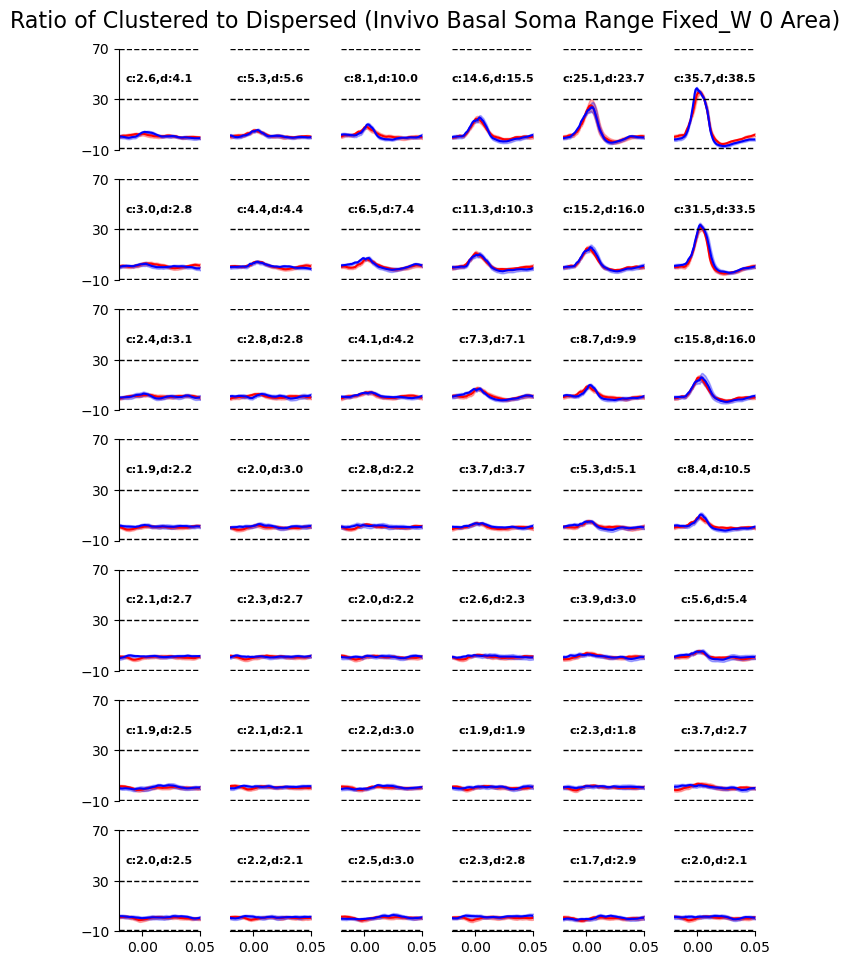

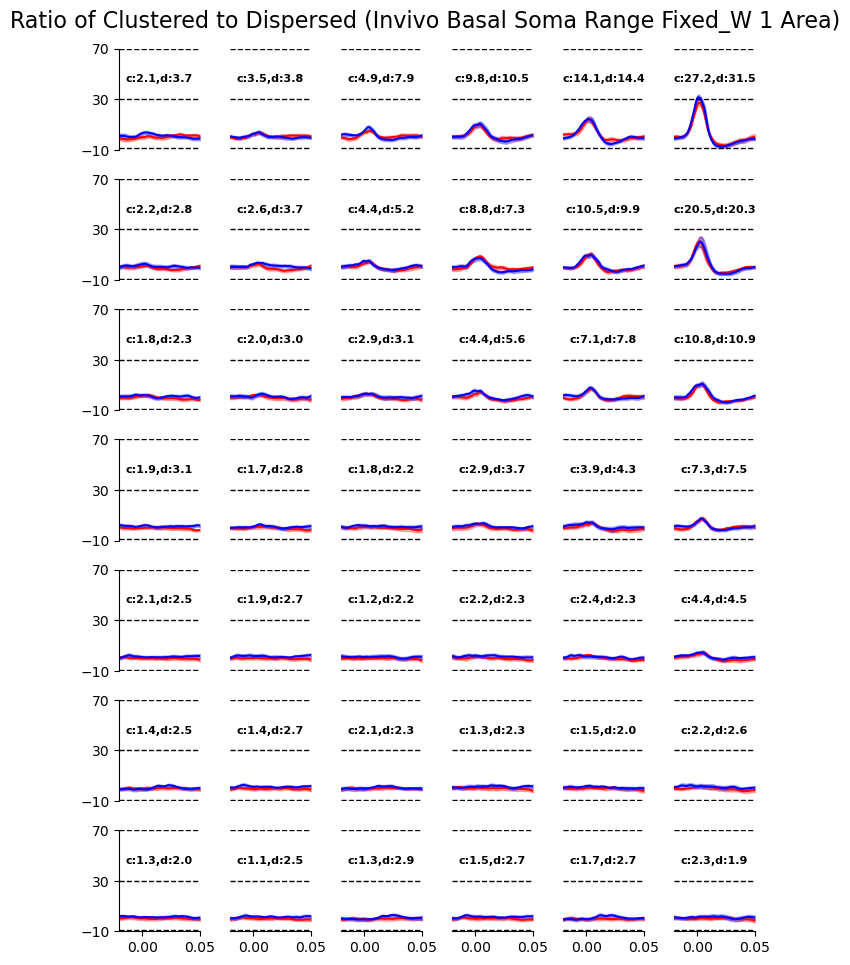

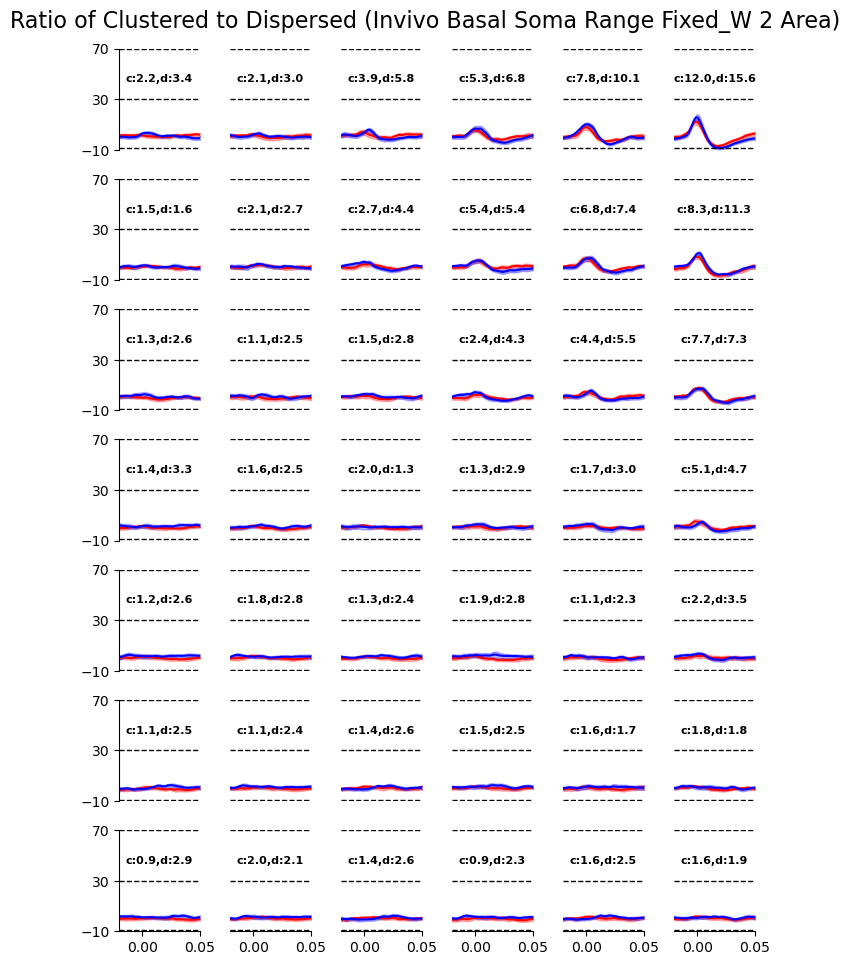

In [28]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invivo', 'distr_invivo', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Soma Range Fixed_W {range_idx} Area)')

1.12e-01 7.96e-01
1.25e-01 1.26e+00
1.99e-01 2.58e+00
1.32e-01 5.93e-01
1.62e-01 6.43e-01
2.20e-01 8.69e-01


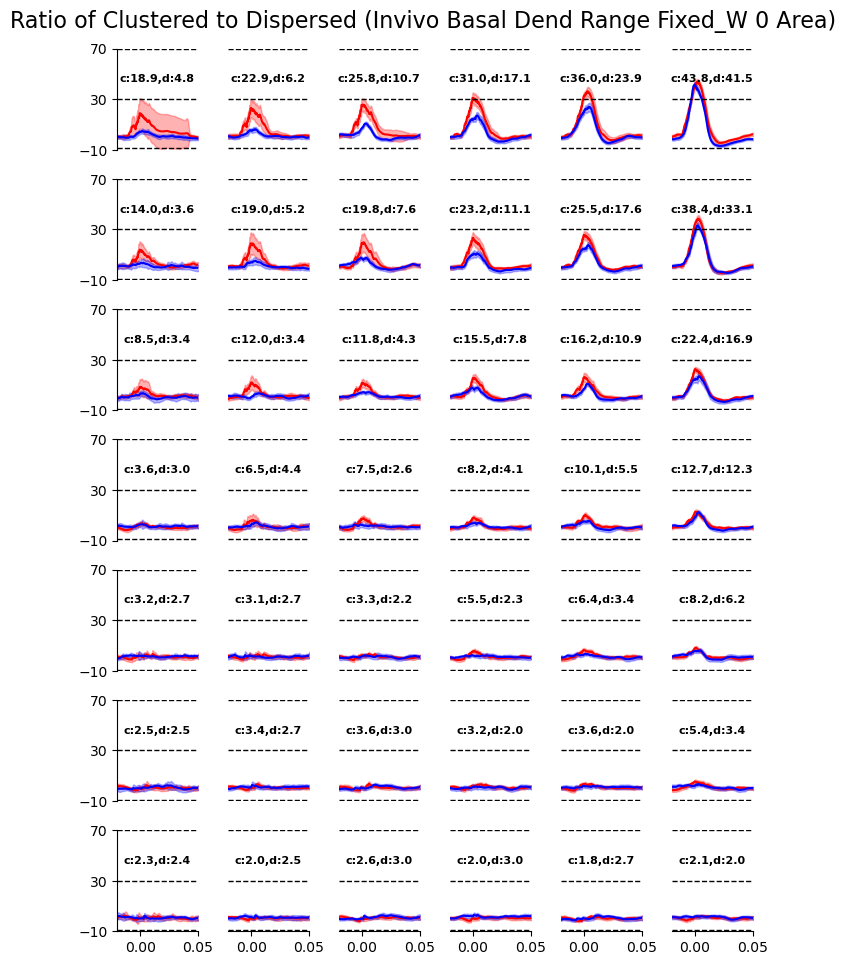

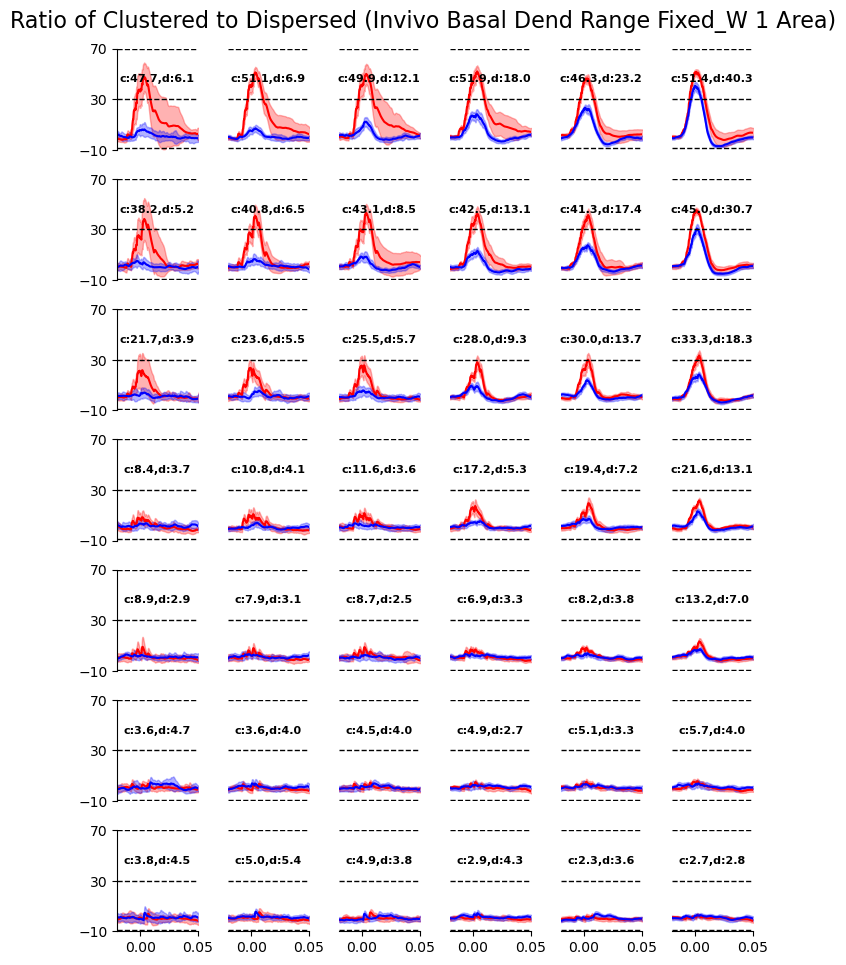

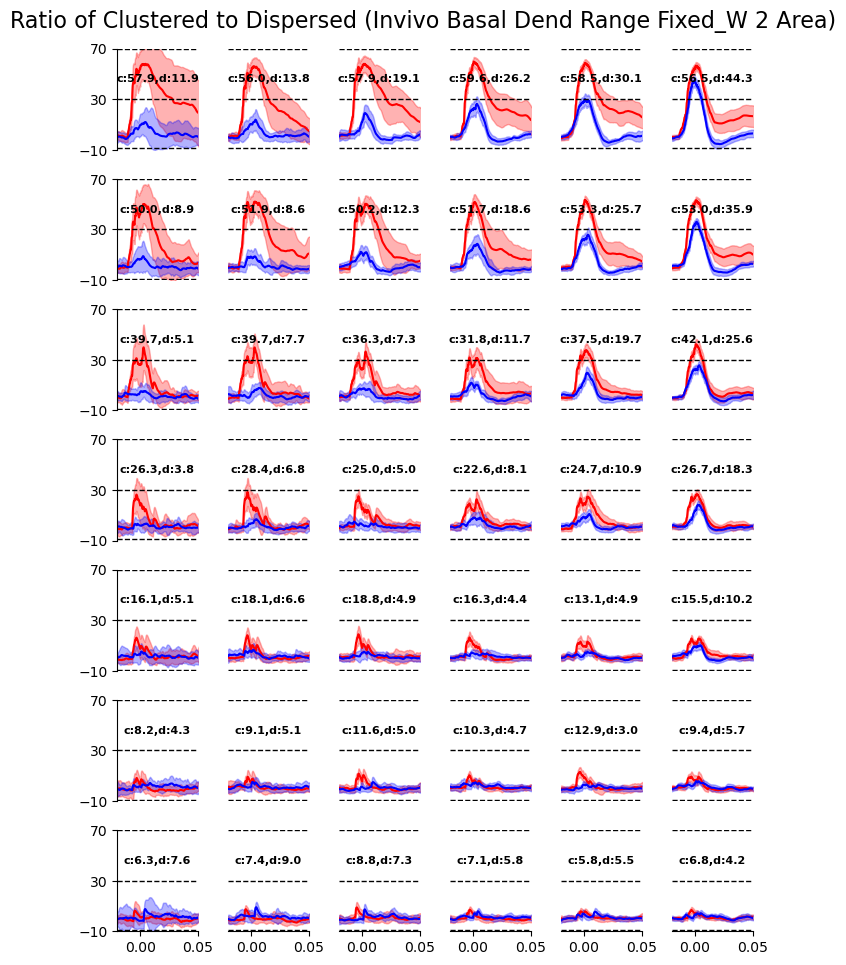

In [29]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo', 'distr_invivo', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Dend Range Fixed_W {range_idx} Area)')

9.78e-02 3.72e+00
1.28e-01 2.02e+00
1.36e-01 9.43e-01
3.77e-02 3.72e+00
2.10e-02 1.85e+00
1.08e-01 1.25e+00


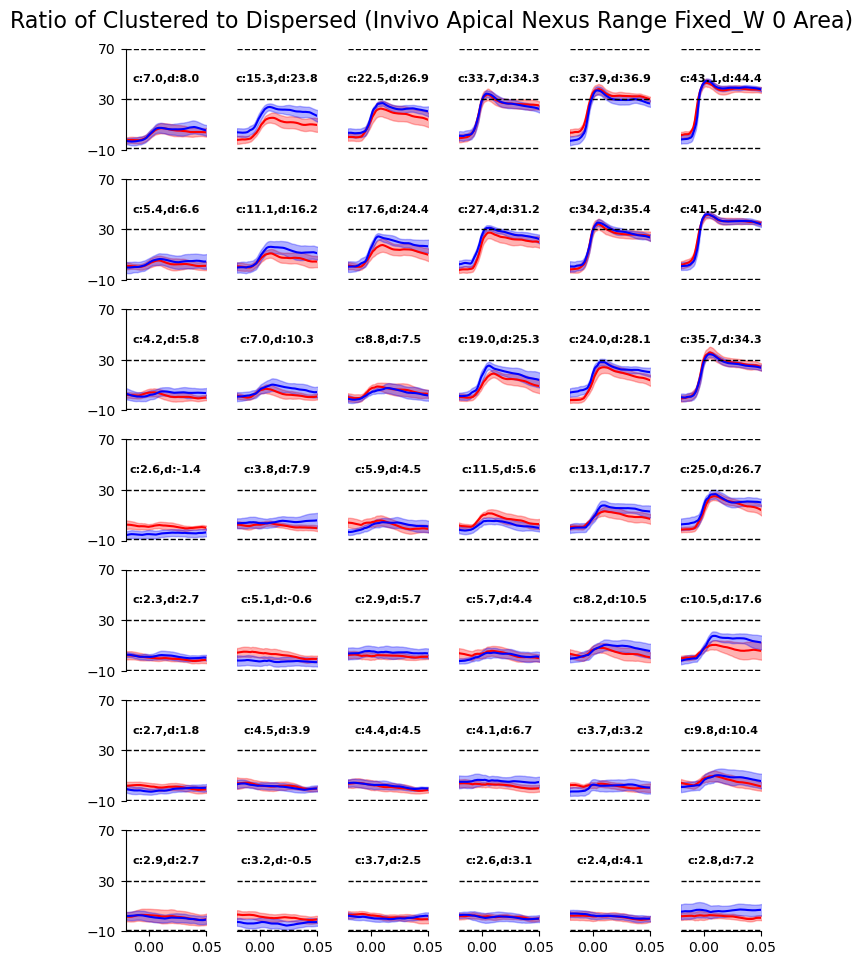

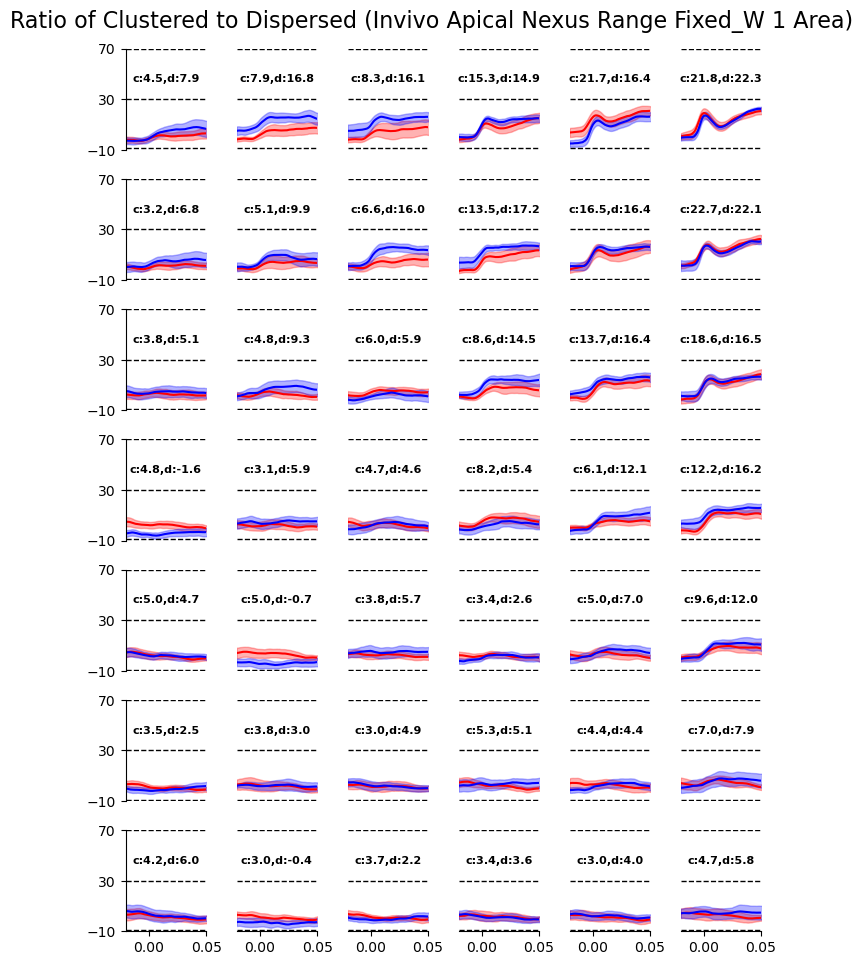

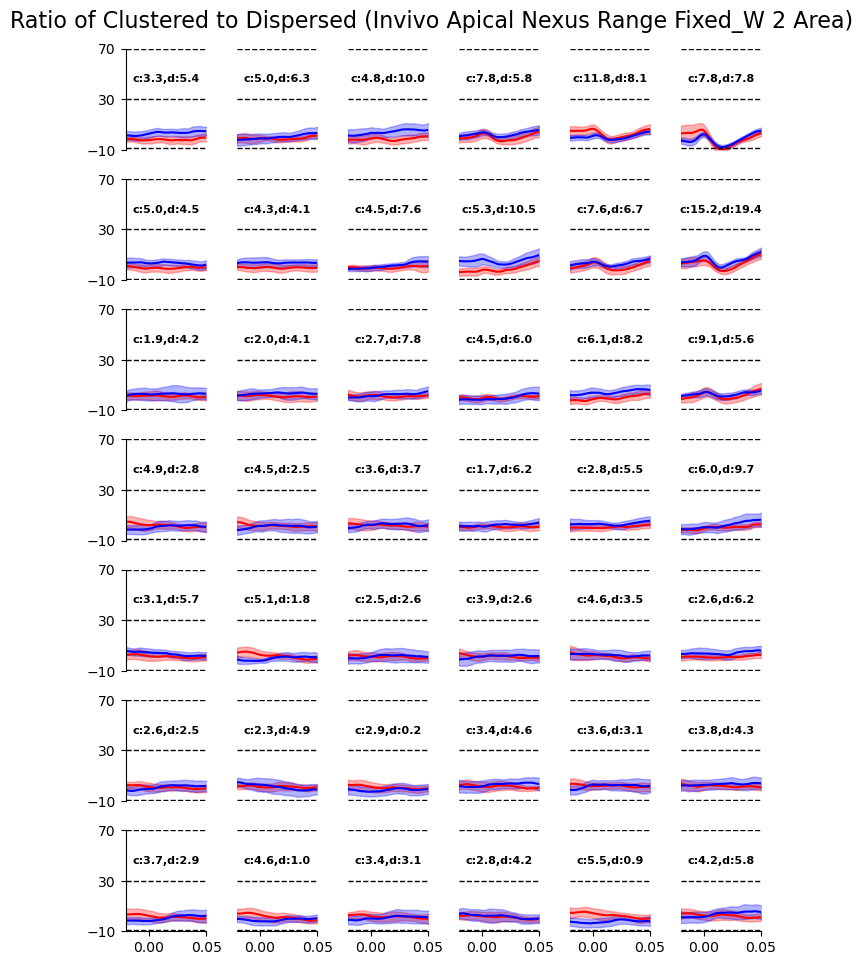

In [30]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invivo', 'distr_invivo', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Nexus Range Fixed_W {range_idx} Area)')

1.77e-01 4.36e+00
4.09e-01 4.09e+00
7.21e-01 4.05e+00
9.13e-02 4.29e+00
2.27e-01 4.11e+00
5.71e-01 4.12e+00


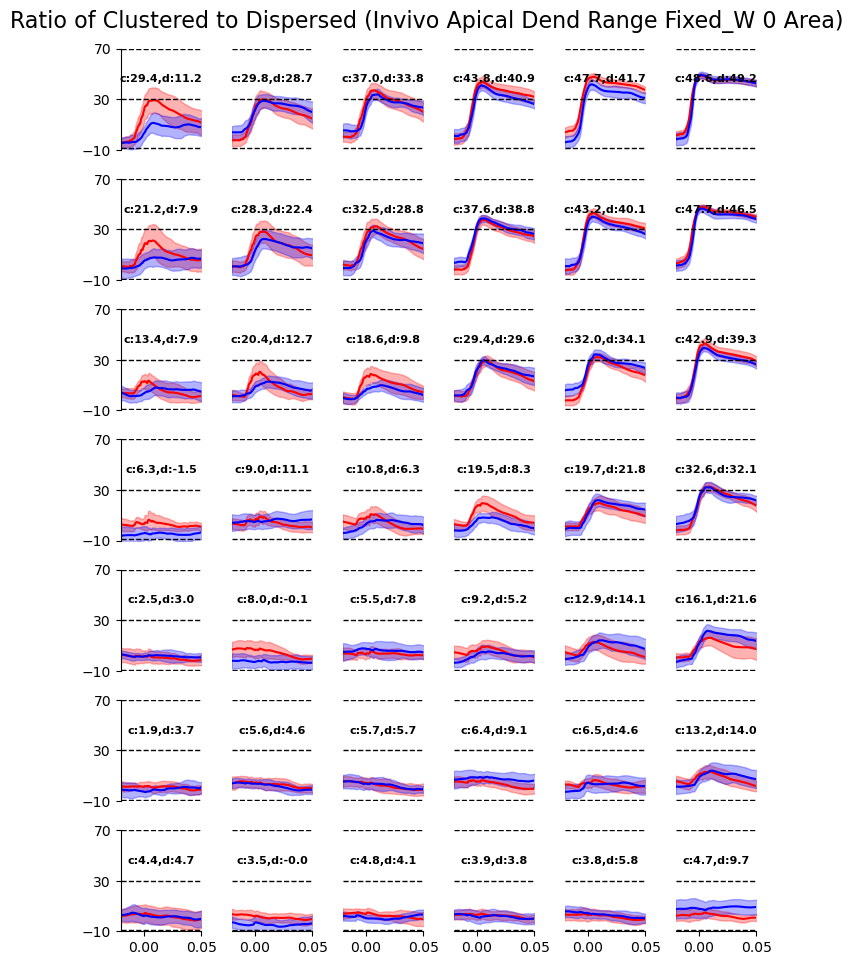

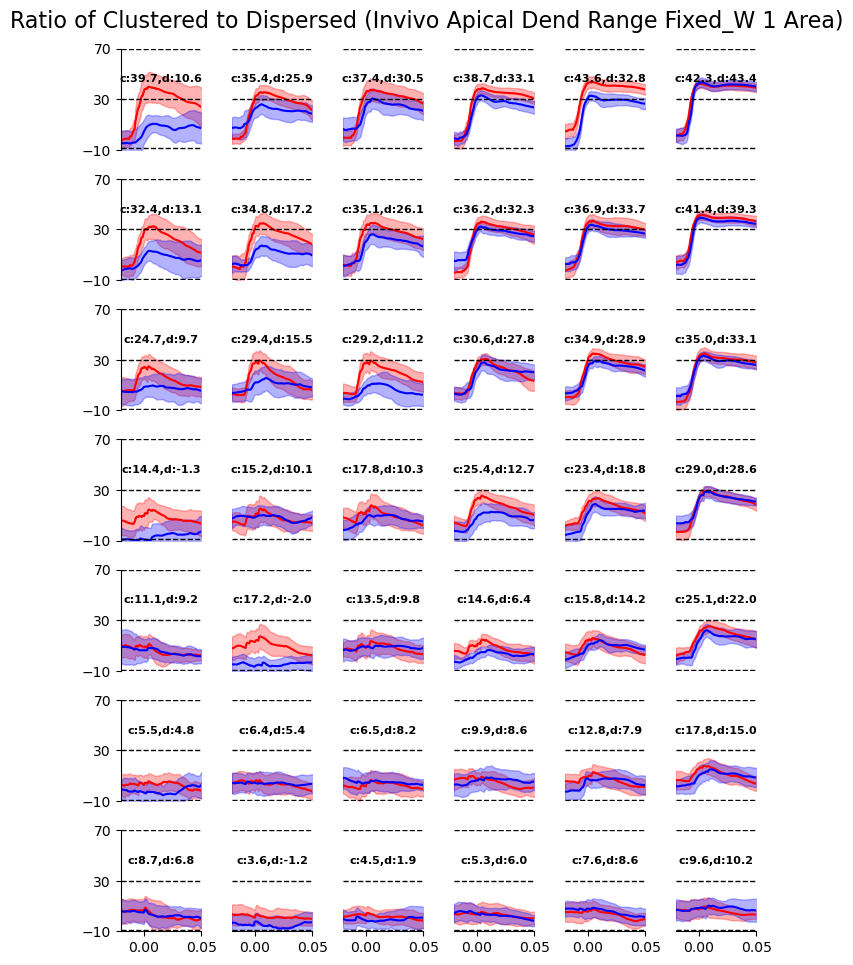

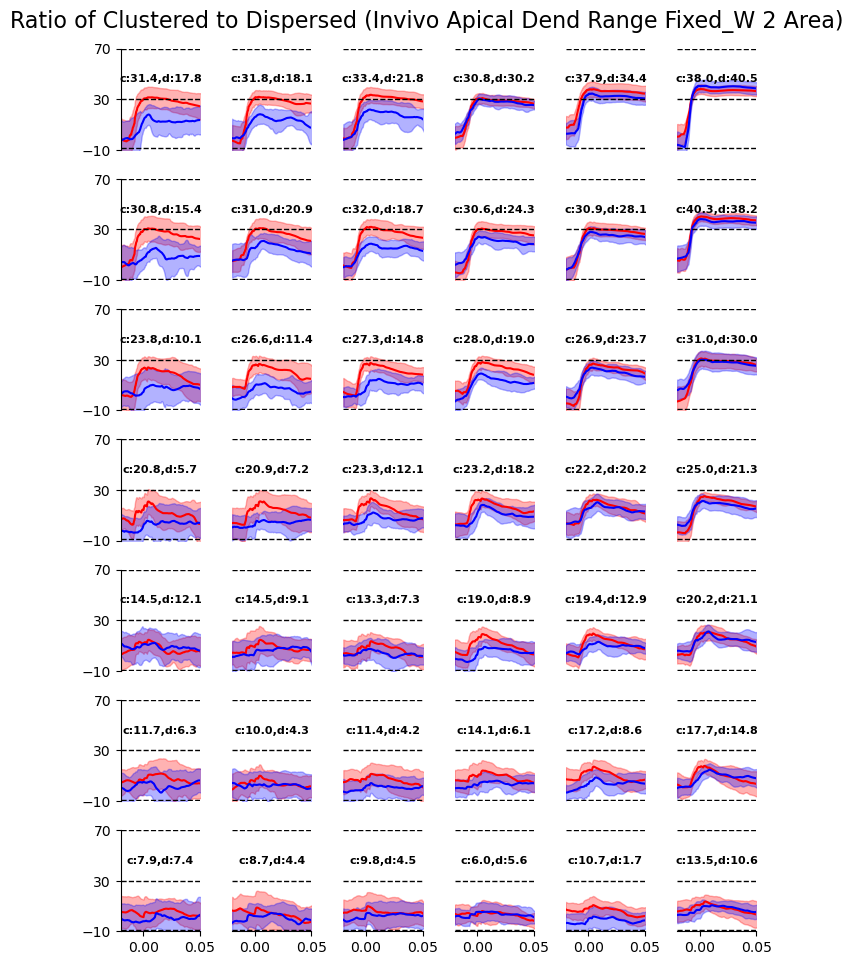

In [31]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo', 'distr_invivo', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Dend Range Fixed_W {range_idx} Area)')

##### Lognorm W_dis

3.32e-02 2.37e-01
3.39e-02 1.71e-01
2.09e-02 9.97e-02
2.89e-02 2.70e-01
2.33e-02 1.74e-01
3.04e-02 1.28e-01


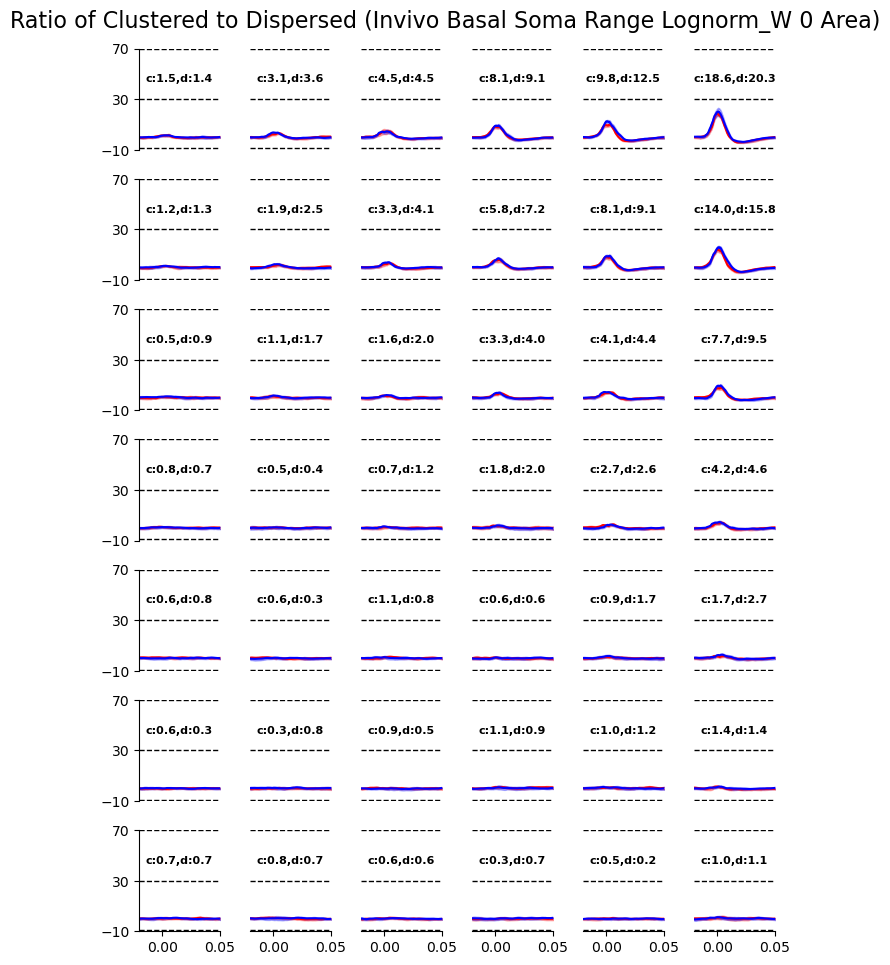

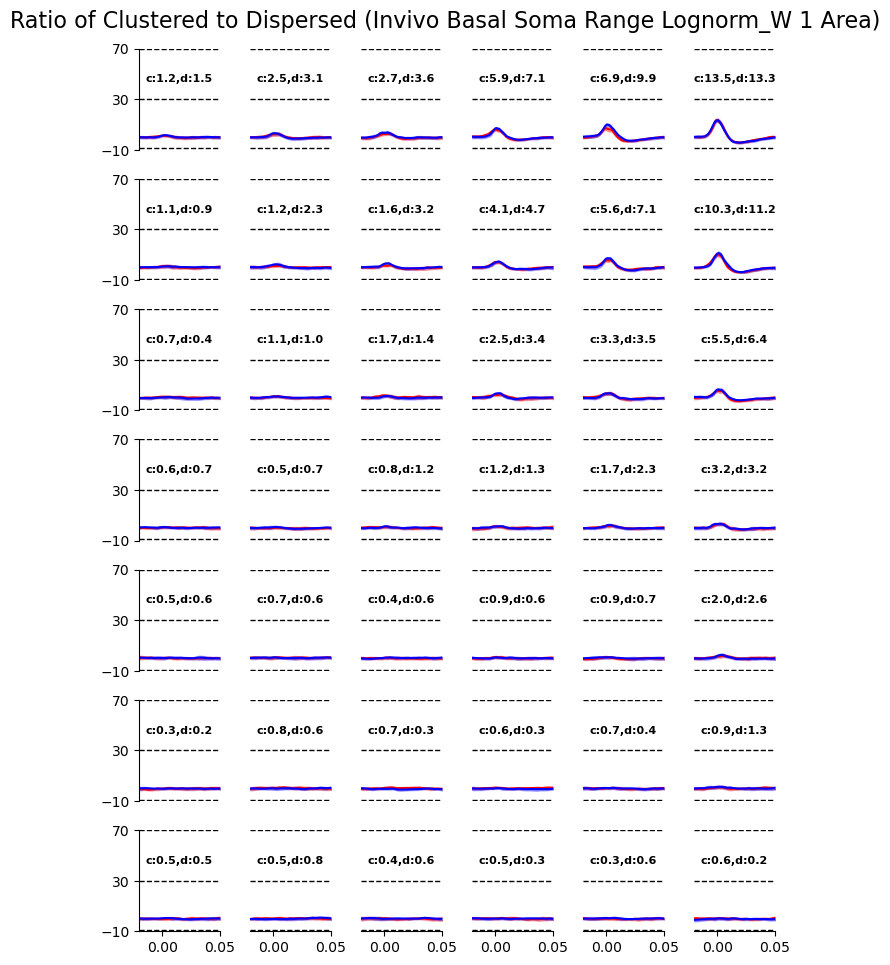

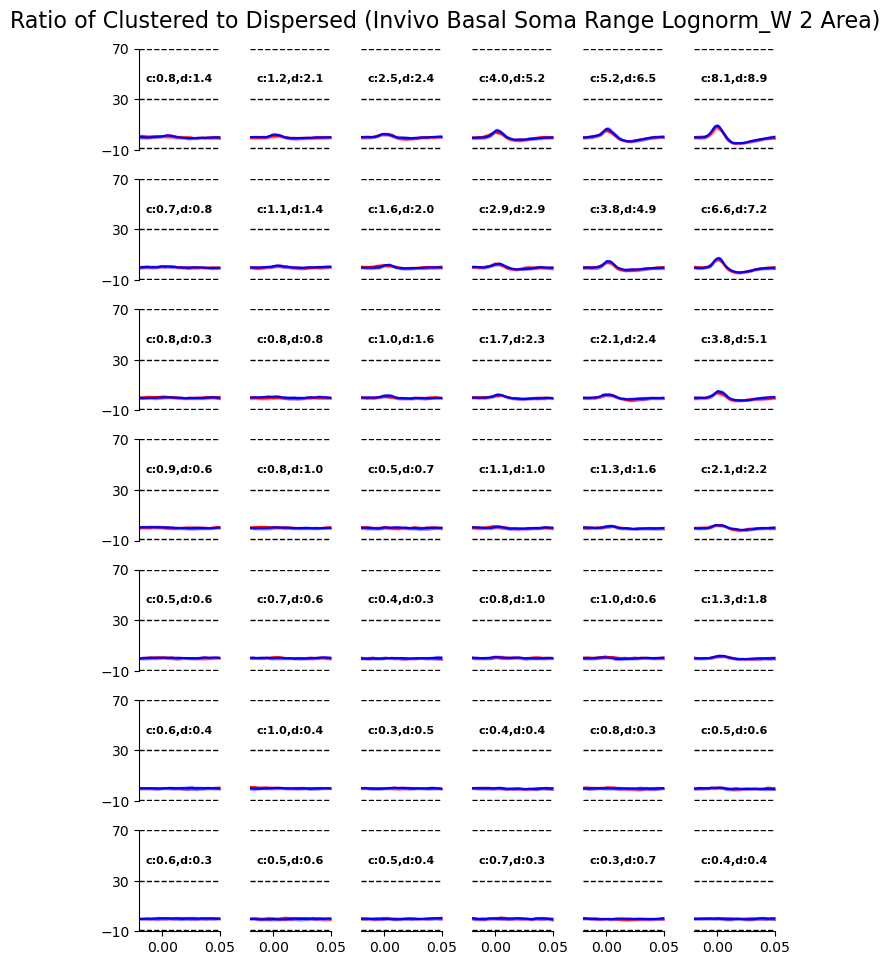

In [32]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invivo_variedW', 'distr_invivo_variedW', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Soma Range Lognorm_W {range_idx} Area)')

4.83e-02 3.37e-01
6.43e-02 5.03e-01
1.01e-01 8.94e-01
4.20e-02 3.02e-01
6.15e-02 3.16e-01
8.04e-02 4.69e-01


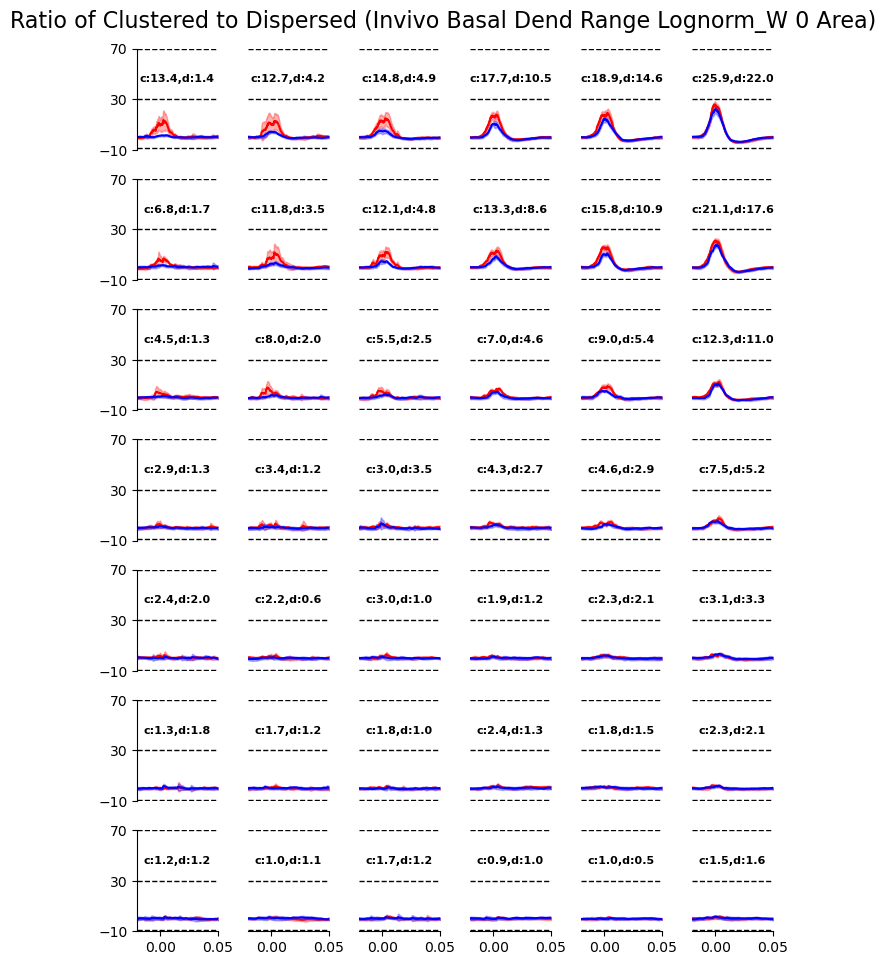

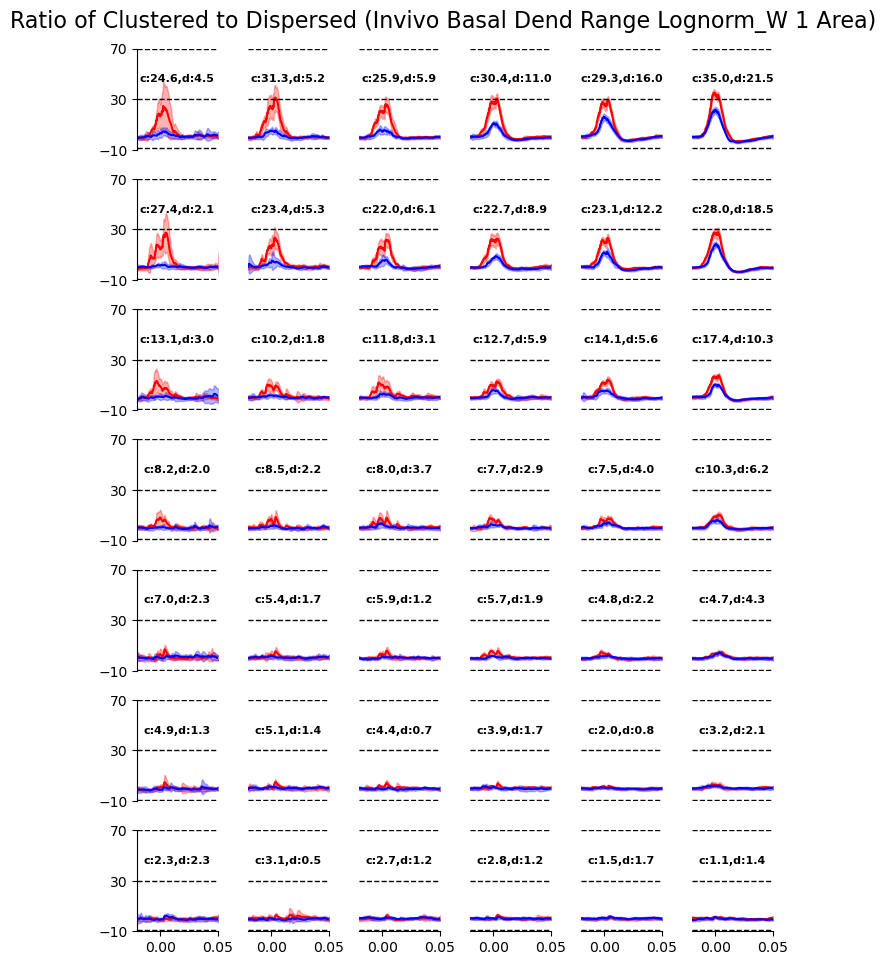

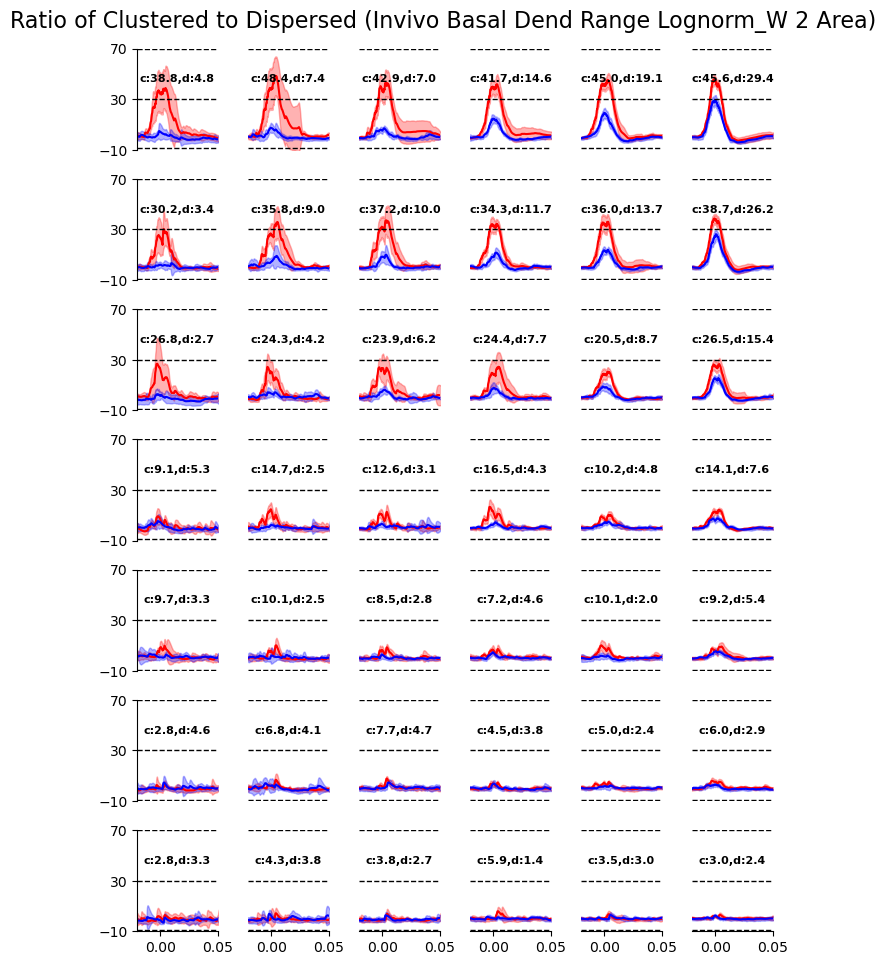

In [33]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_variedW', 'distr_invivo_variedW', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Dend Range Lognorm_W {range_idx} Area)')

2.23e-02 1.98e+00
3.16e-02 1.07e+00
2.57e-02 3.23e-01
3.10e-02 2.24e+00
3.05e-02 1.24e+00
3.24e-02 3.14e-01


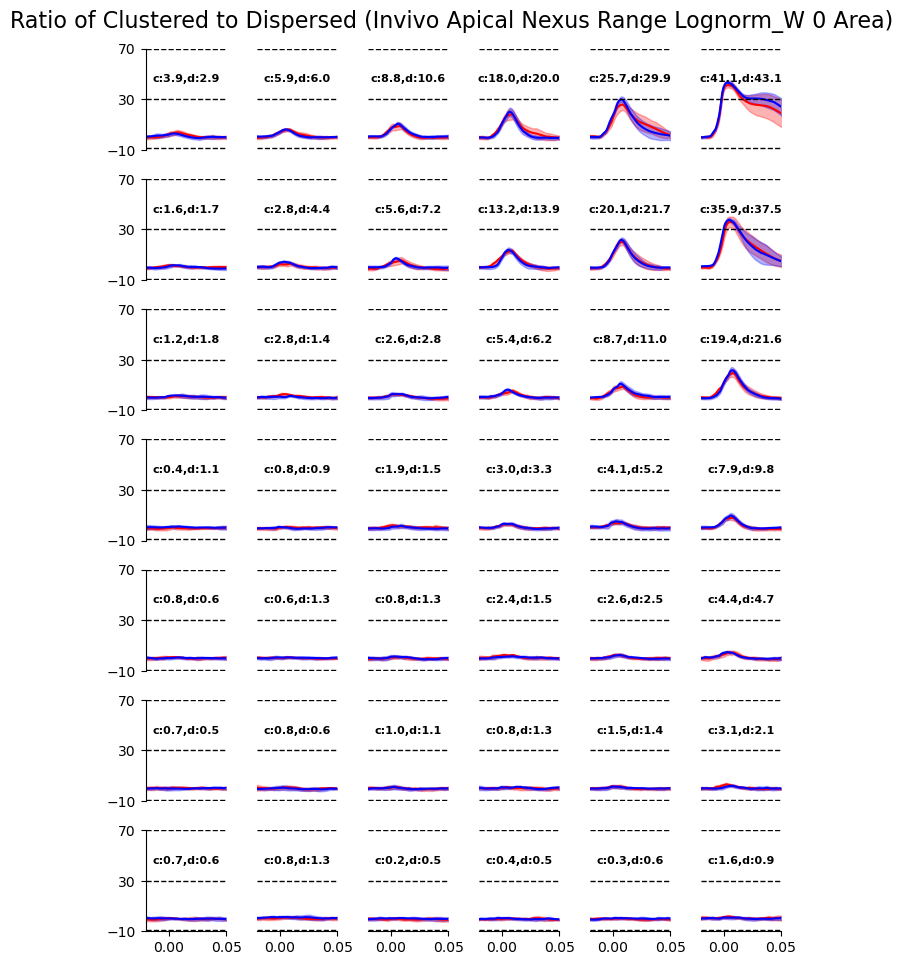

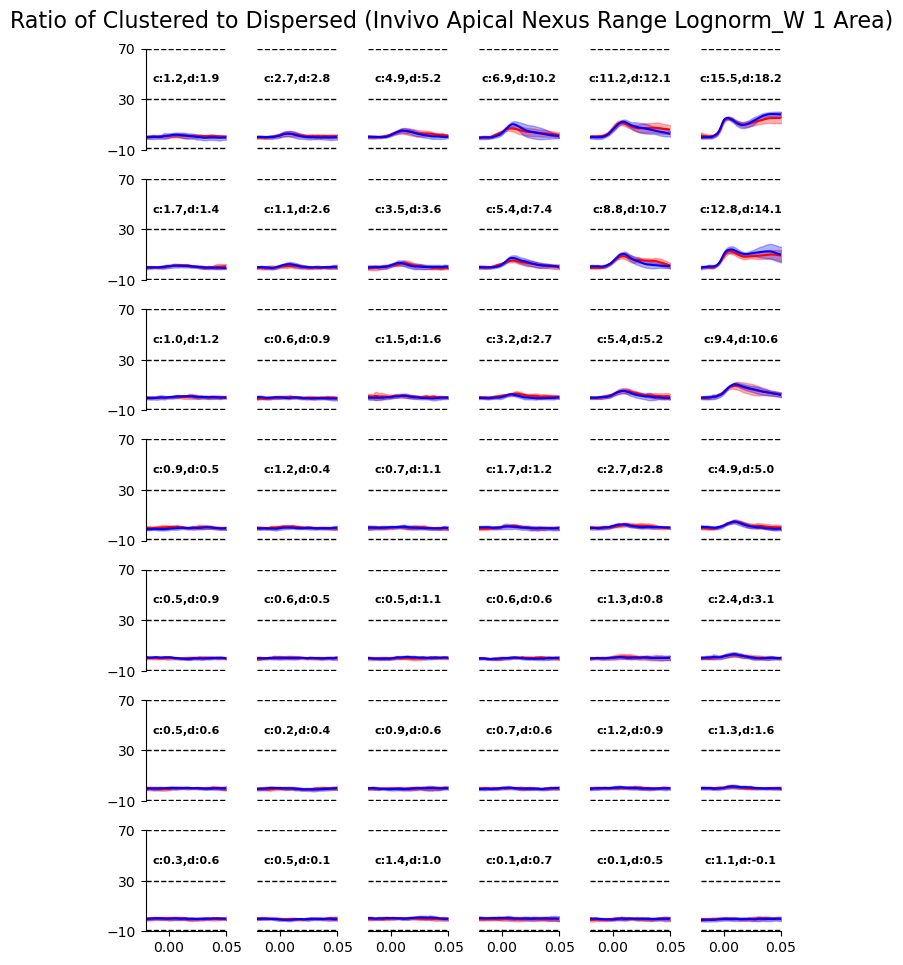

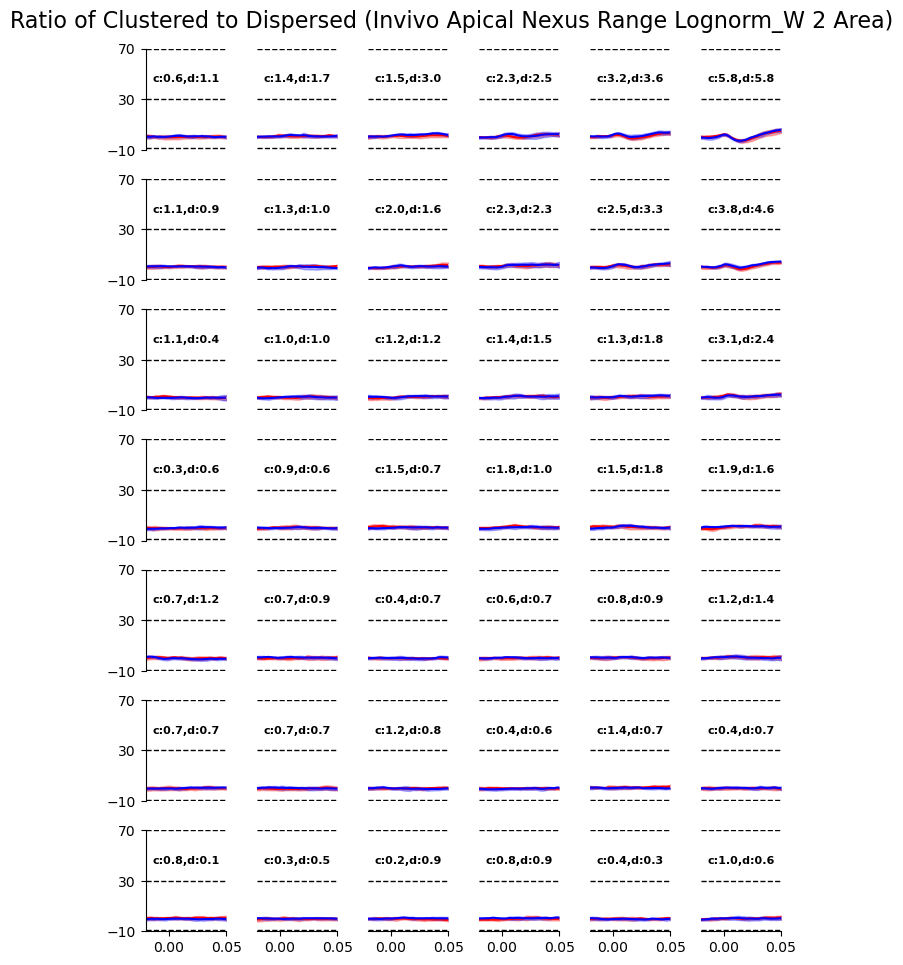

In [34]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invivo_variedW', 'distr_invivo_variedW', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Nexus Range Lognorm_W {range_idx} Area)')

8.52e-02 2.73e+00
1.29e-01 3.63e+00
3.00e-01 5.13e+00
6.94e-02 2.87e+00
9.57e-02 3.82e+00
2.59e-01 5.05e+00


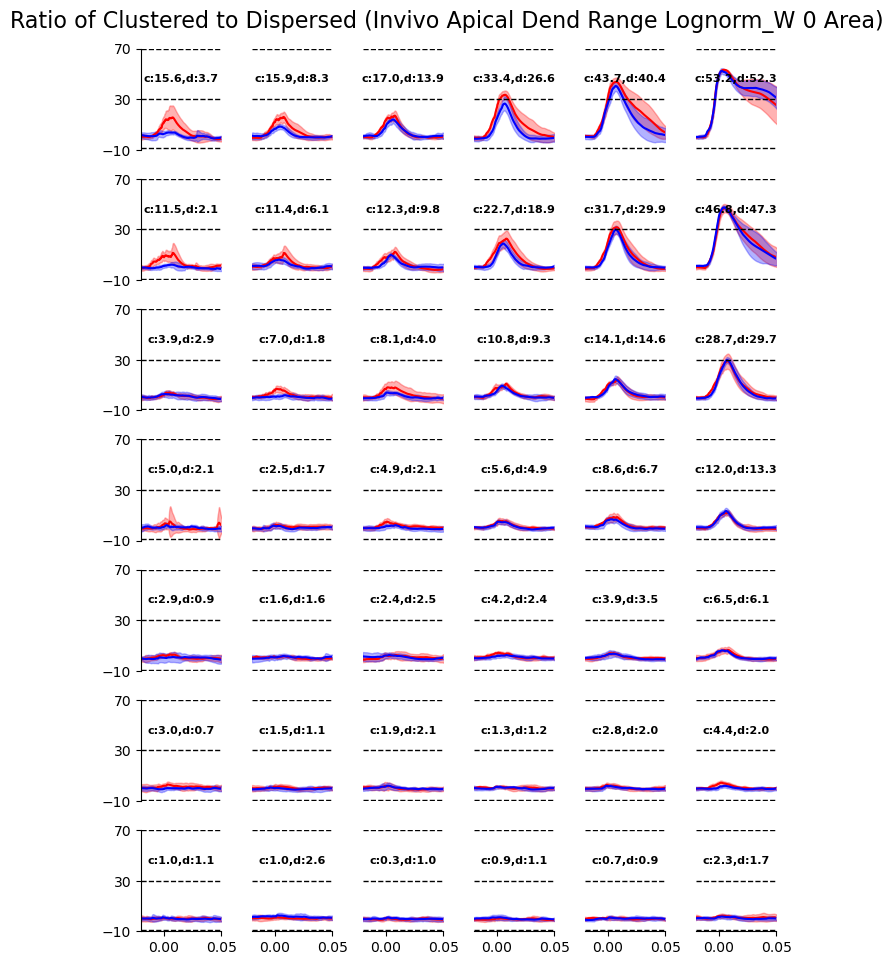

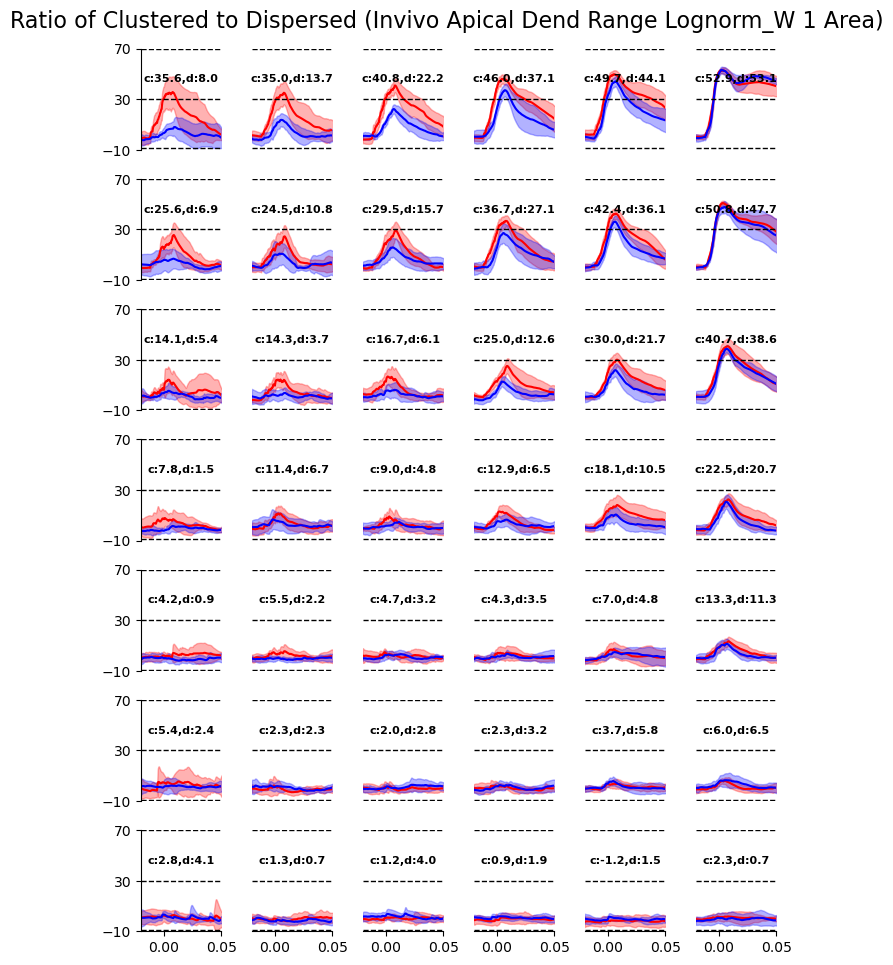

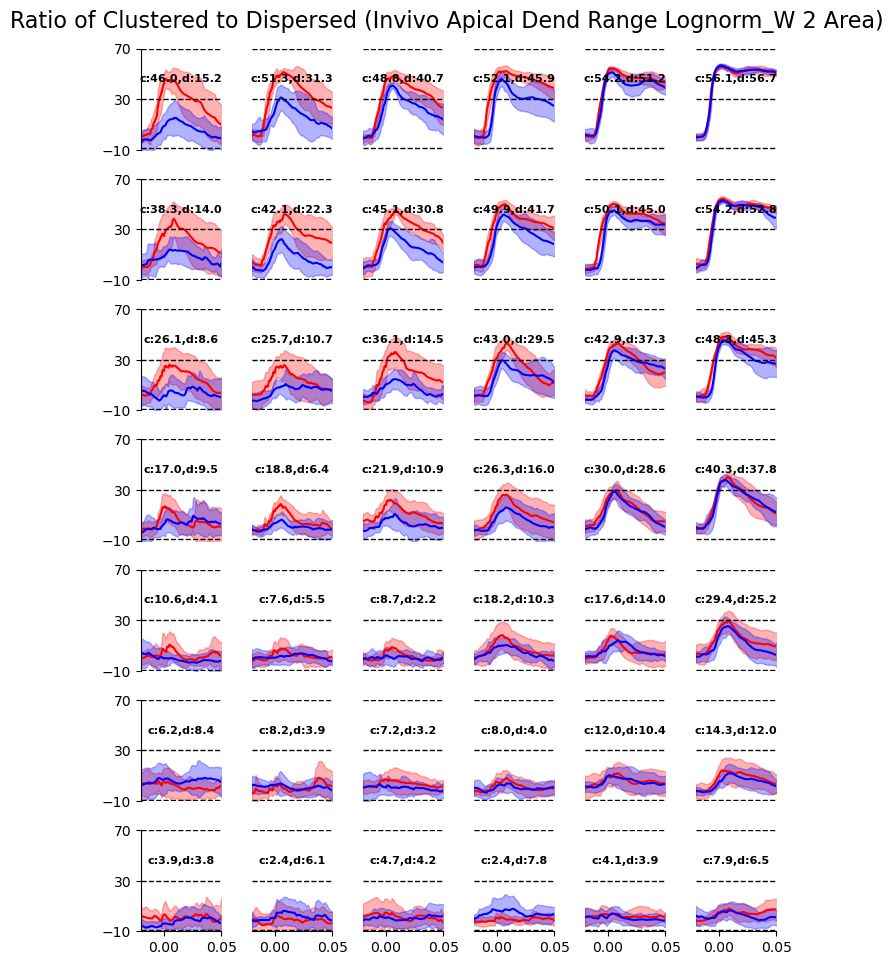

In [35]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_variedW', 'distr_invivo_variedW', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Dend Range Lognorm_W {range_idx} Area)')

##### Lognorm W_dis with AP

1.71e-02 2.47e-01
2.27e-02 1.63e-01
2.17e-02 1.32e-01
2.11e-02 2.80e-01
2.01e-02 1.83e-01
1.67e-02 1.36e-01


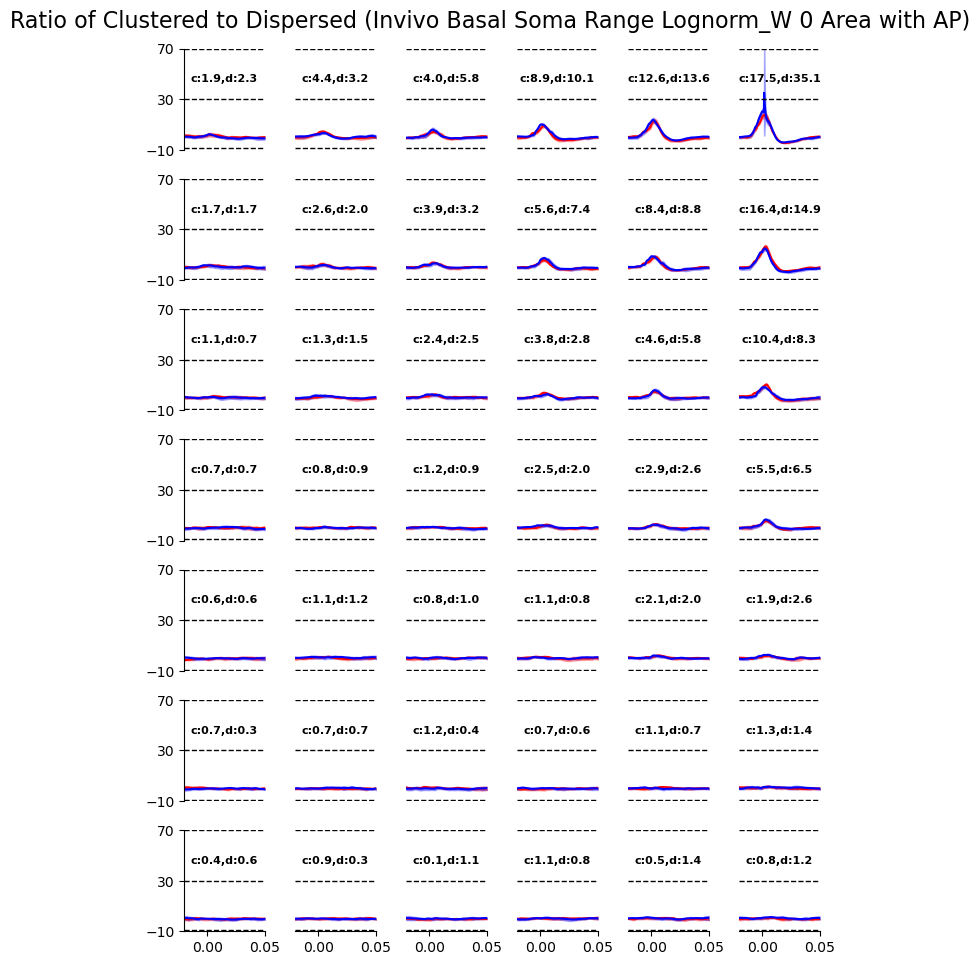

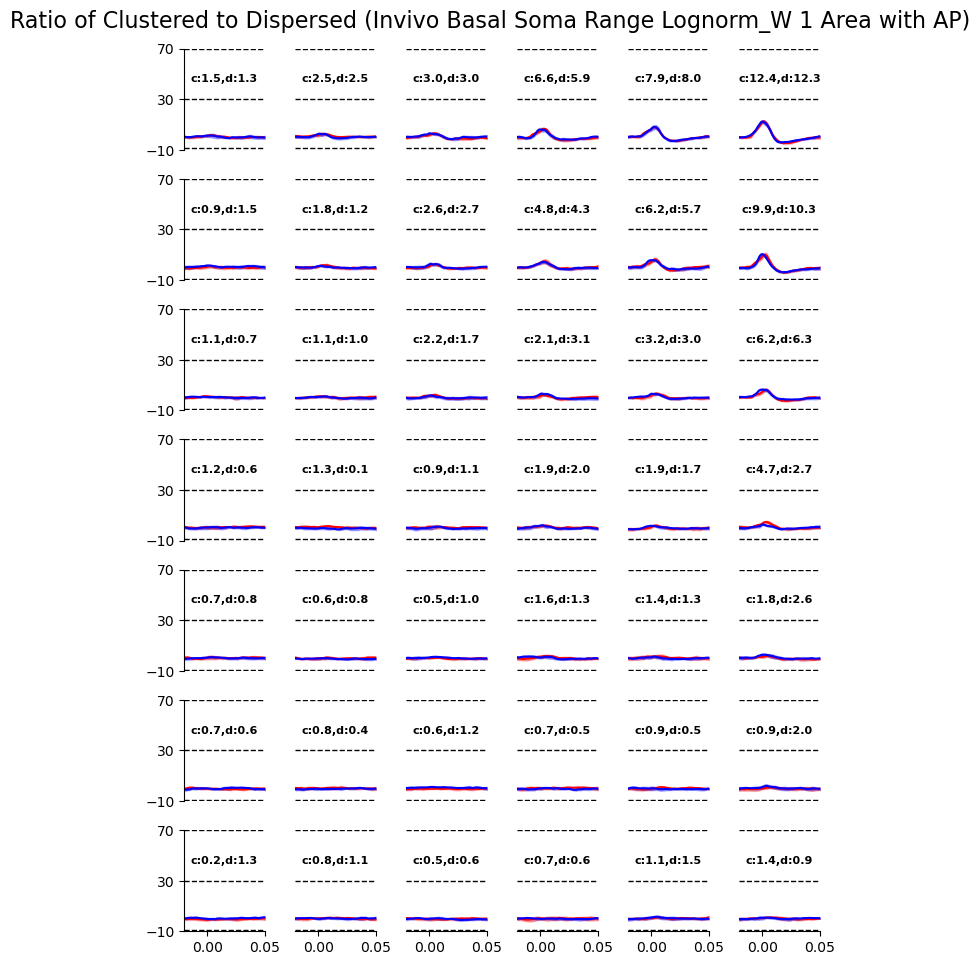

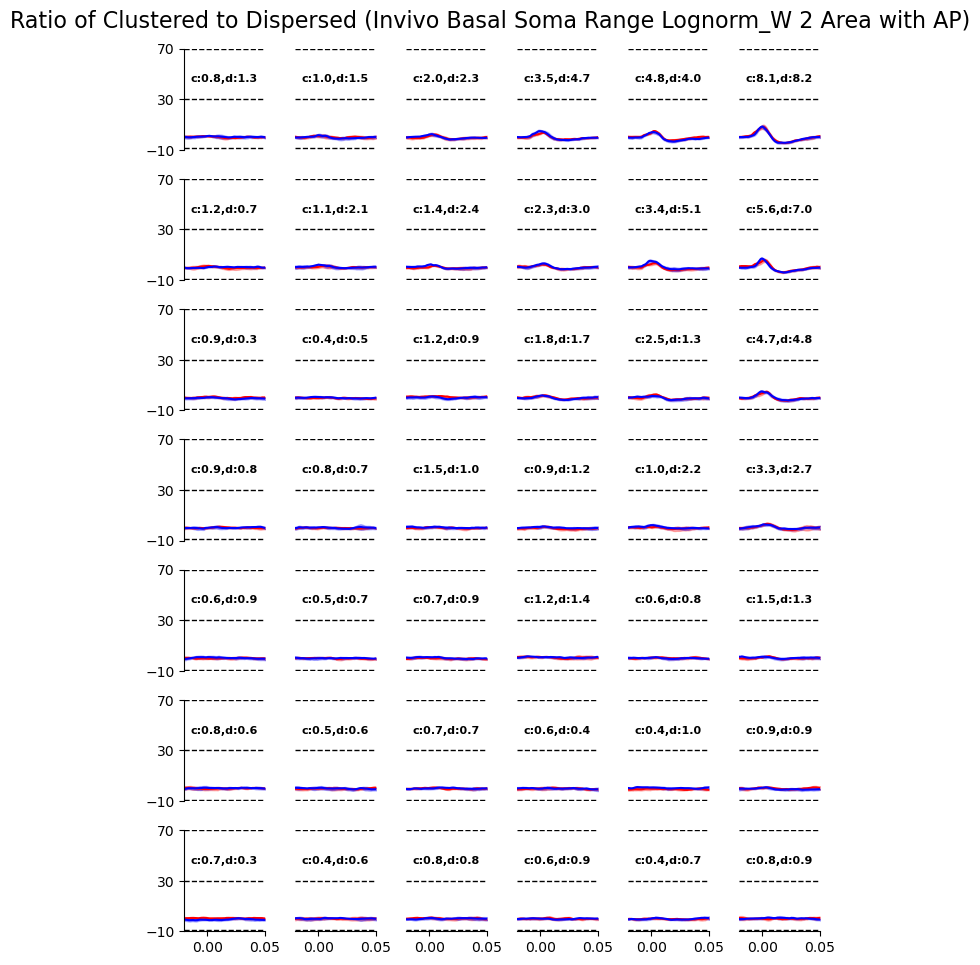

In [36]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_withAP', 'distr_invivo_variedW_withAP', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Soma Range Lognorm_W {range_idx} Area with AP)')

3.10e-02 3.49e-01
6.46e-02 4.86e-01
1.06e-01 9.62e-01
3.41e-02 3.20e-01
6.66e-02 3.33e-01
7.22e-02 4.35e-01


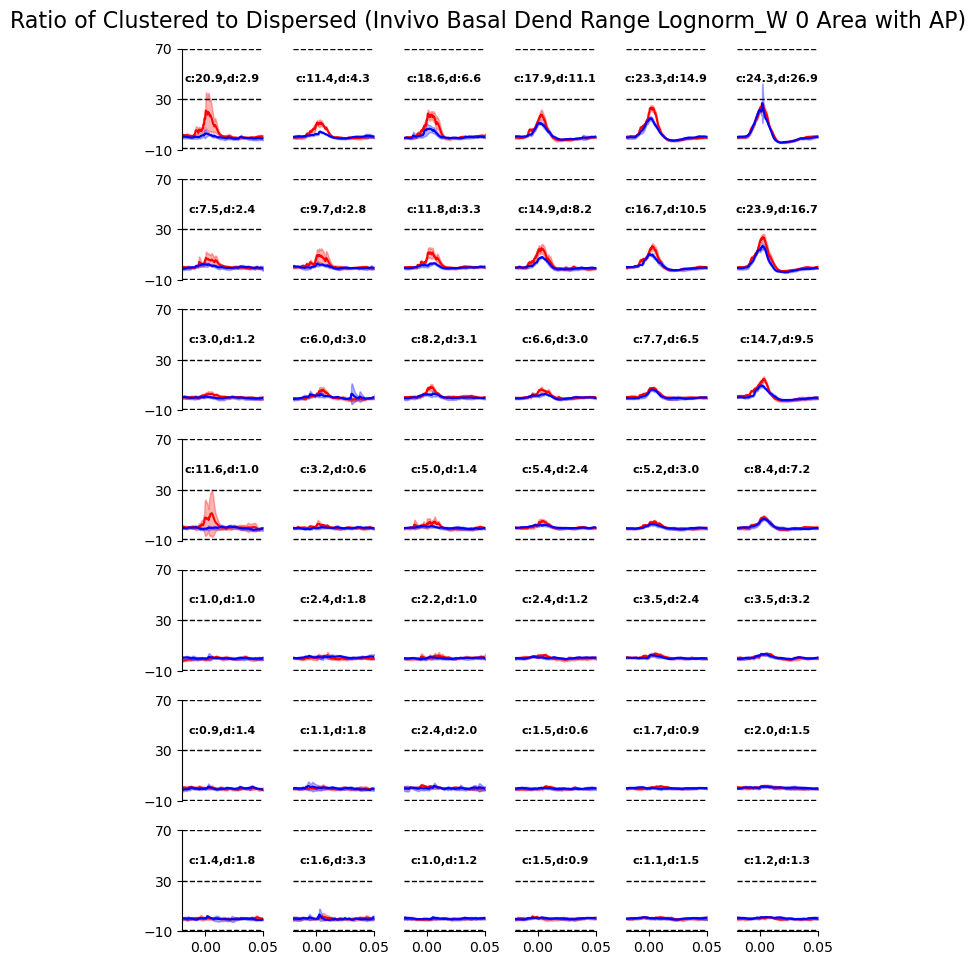

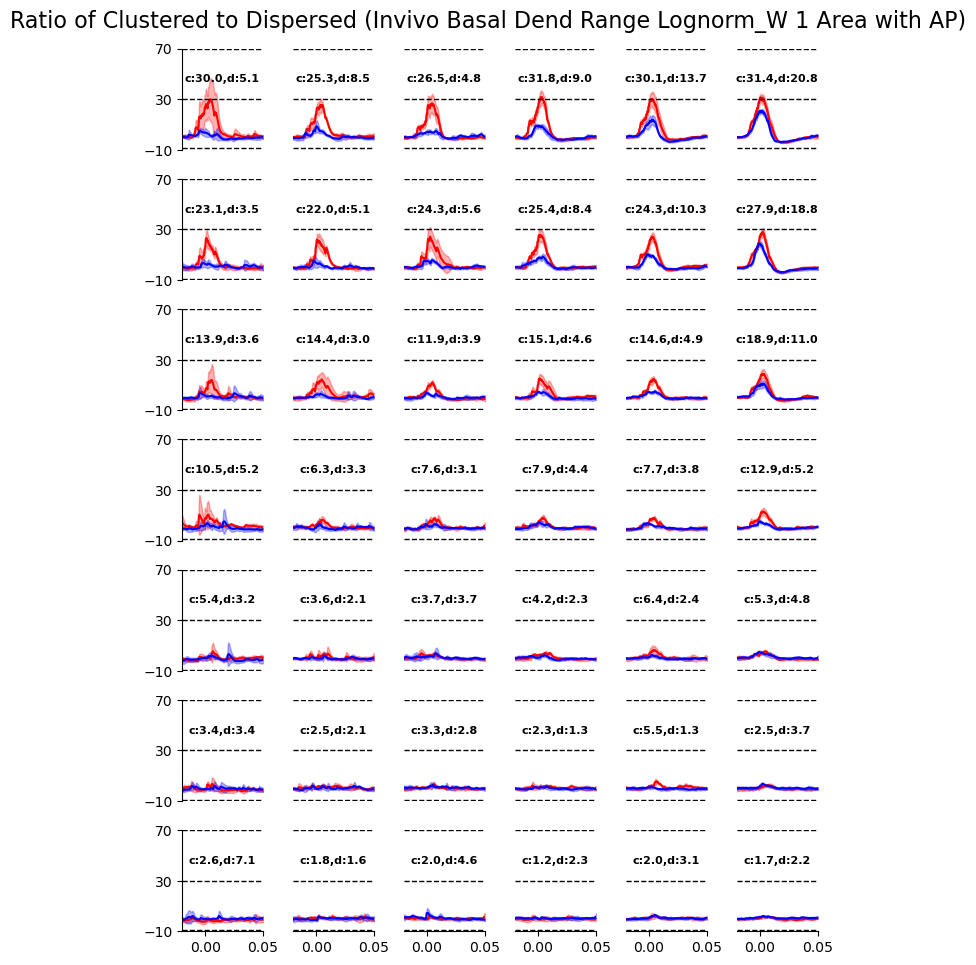

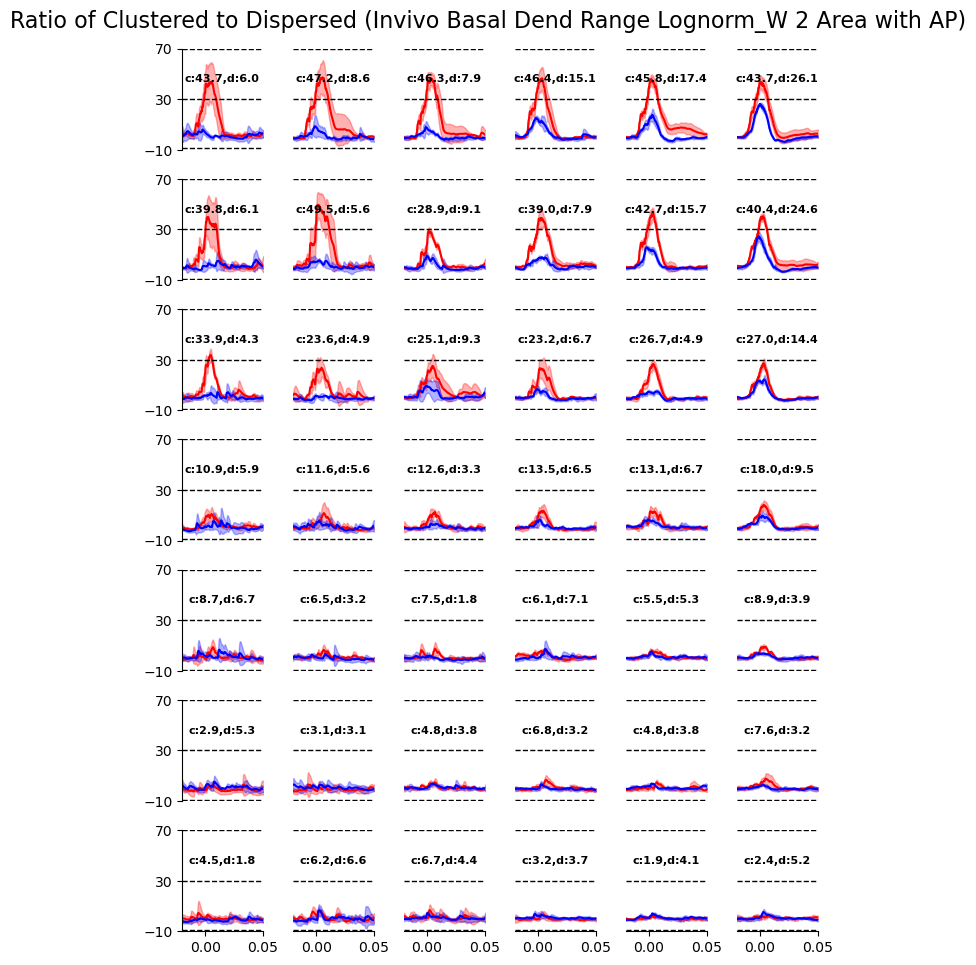

In [37]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_withAP', 'distr_invivo_variedW_withAP', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Dend Range Lognorm_W {range_idx} Area with AP)')

1.99e-02 1.89e+00
2.84e-02 1.86e+00
3.73e-02 3.74e-01
1.50e-02 1.97e+00
3.76e-02 1.97e+00
2.95e-02 3.99e-01


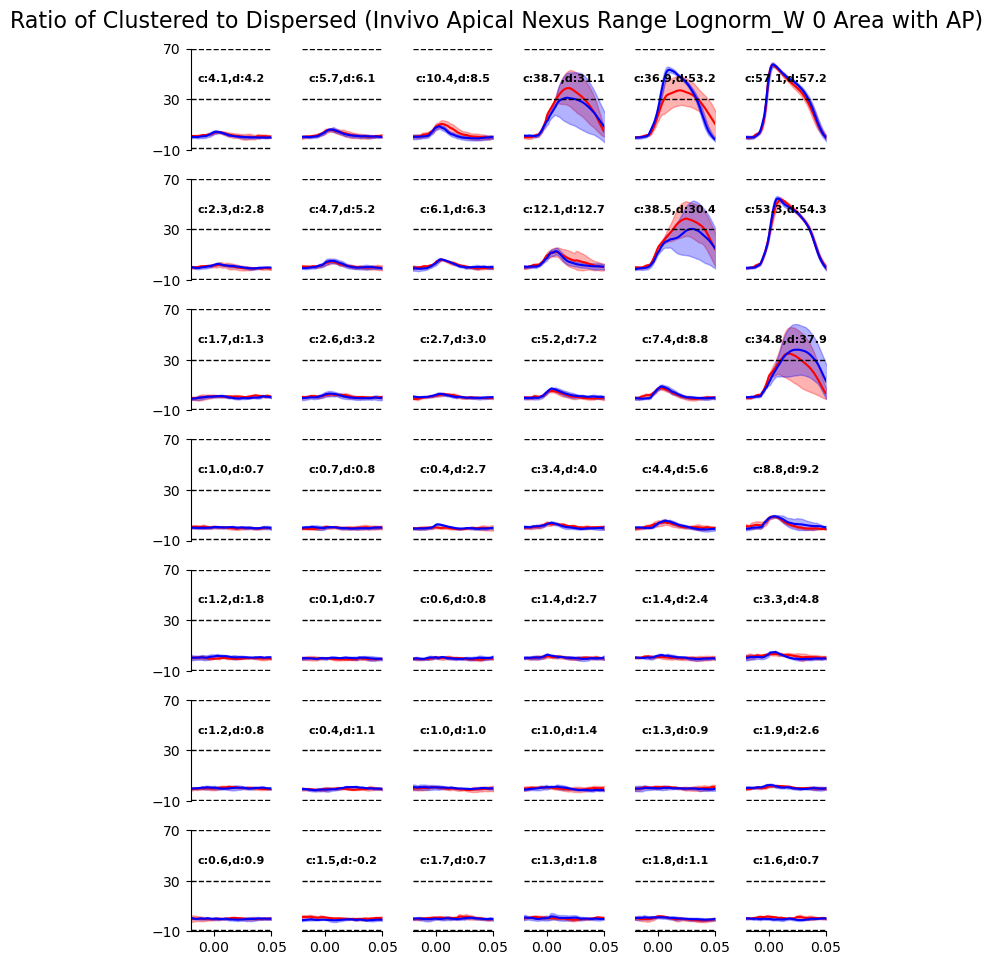

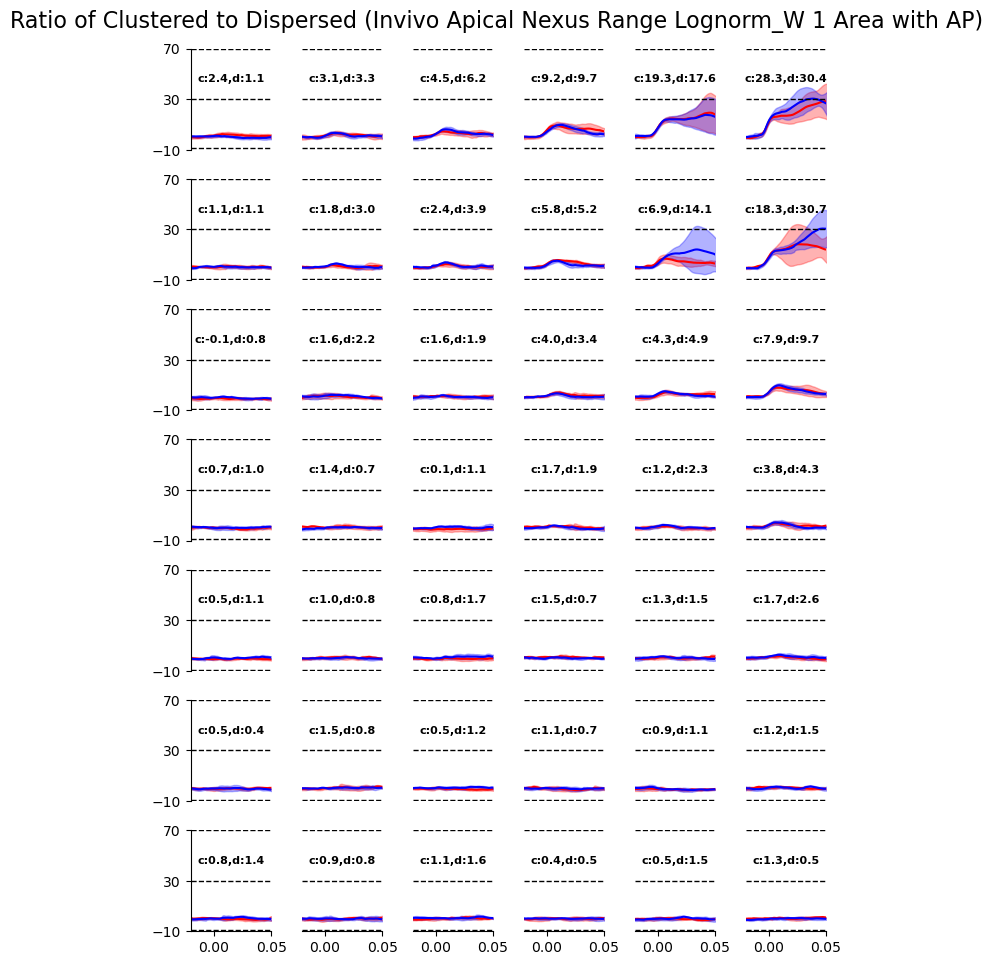

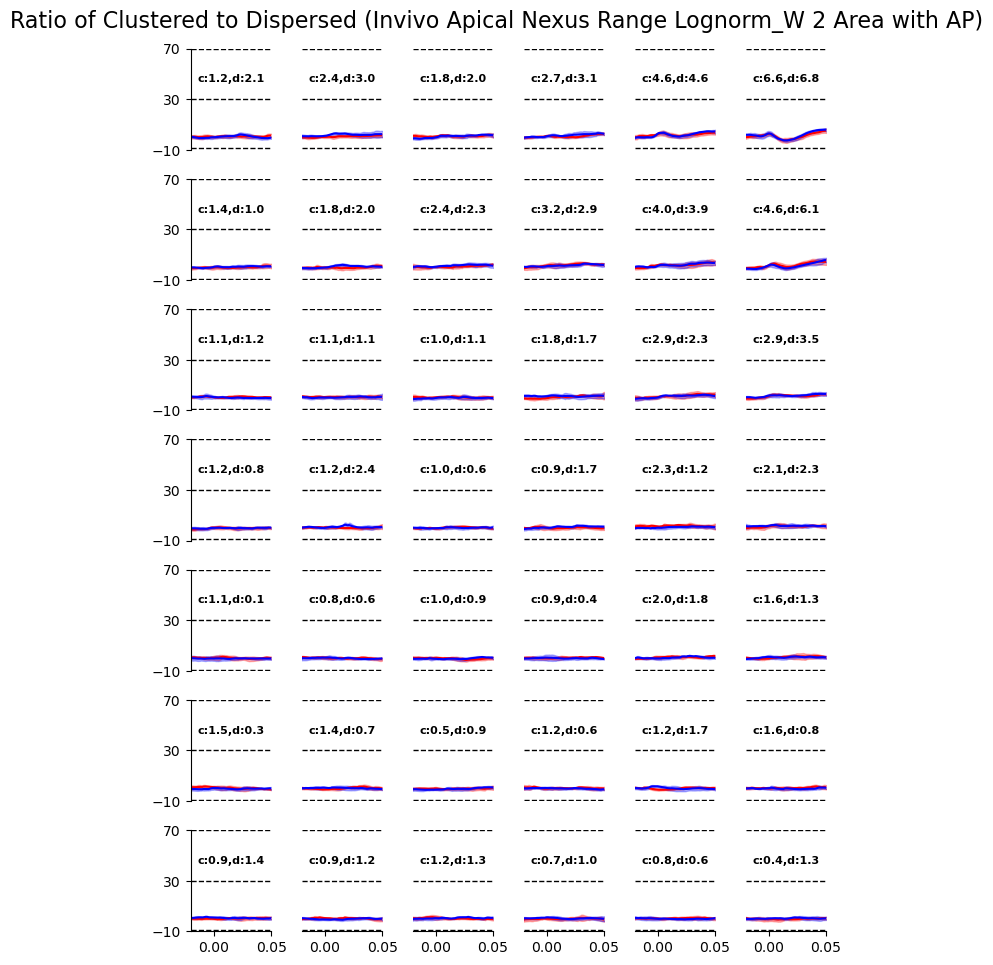

In [38]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_withAP', 'distr_invivo_variedW_withAP', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Nexus Range Lognorm_W {range_idx} Area with AP)')

6.90e-02 2.52e+00
1.19e-01 4.45e+00
2.85e-01 5.42e+00
3.66e-02 2.52e+00
1.10e-01 4.25e+00
2.39e-01 5.10e+00


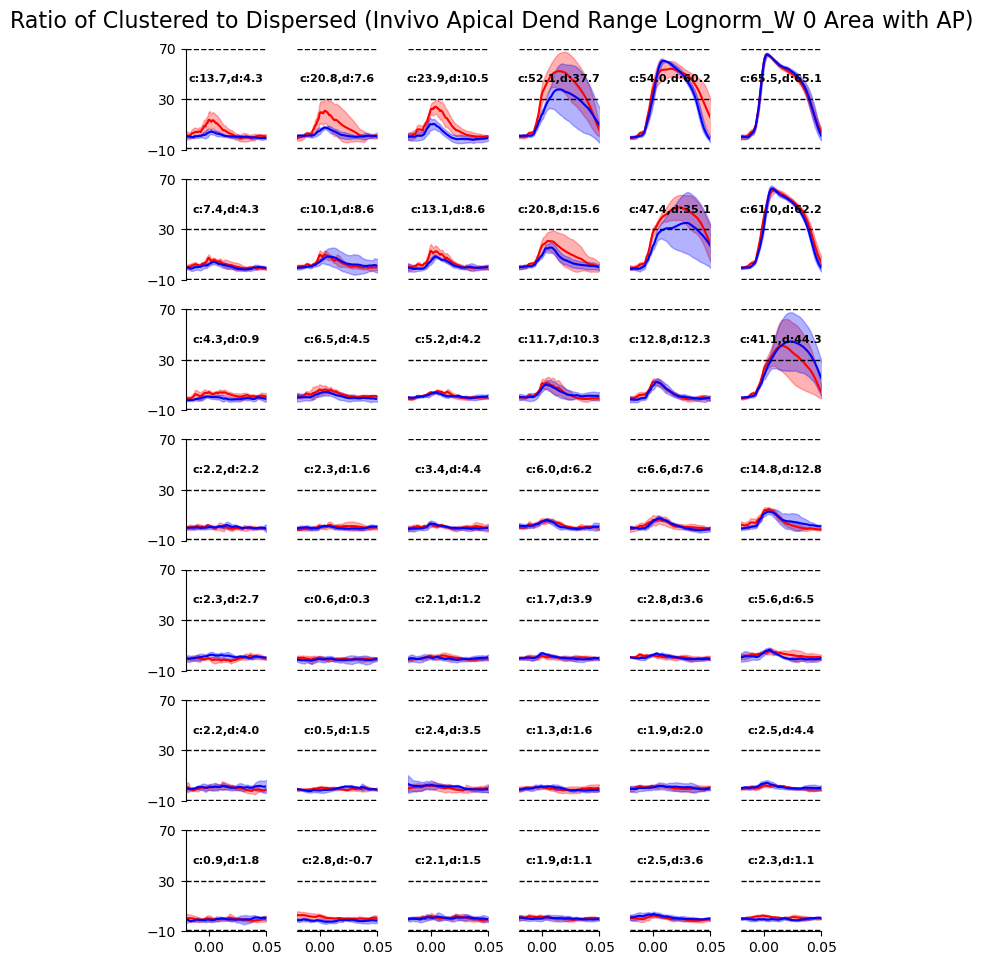

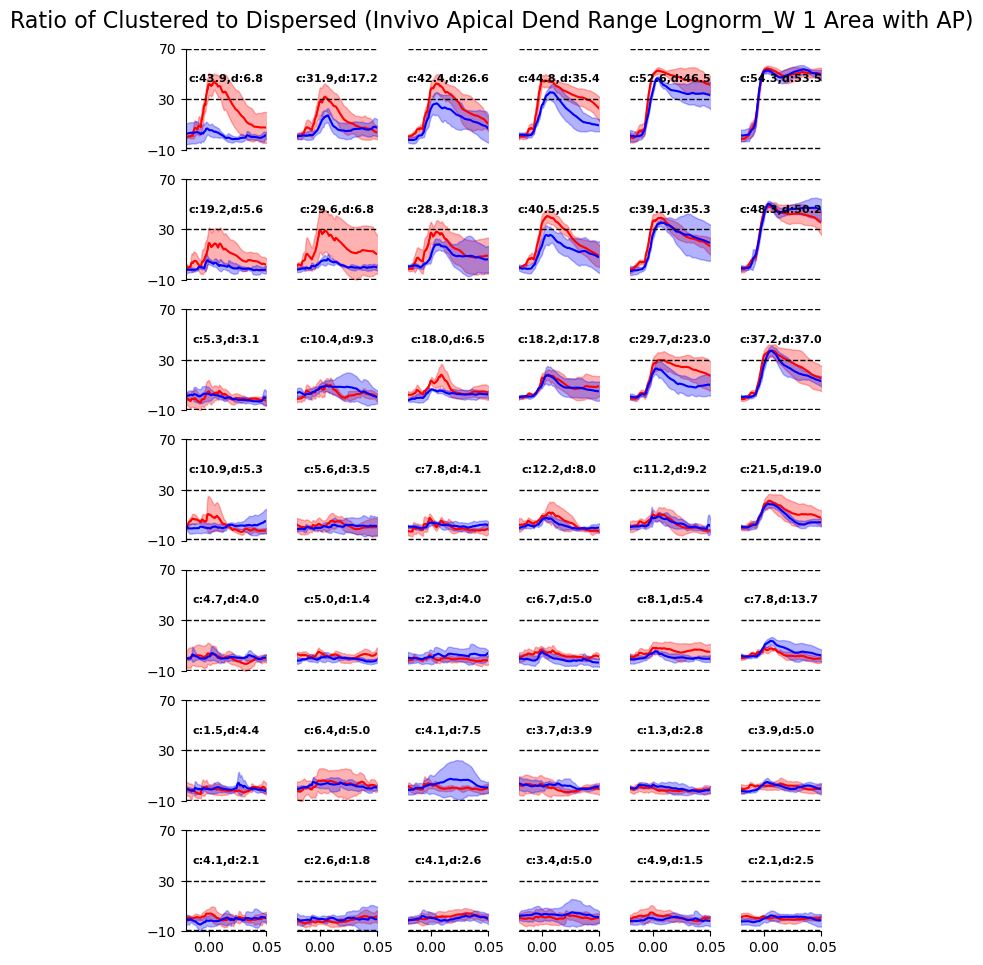

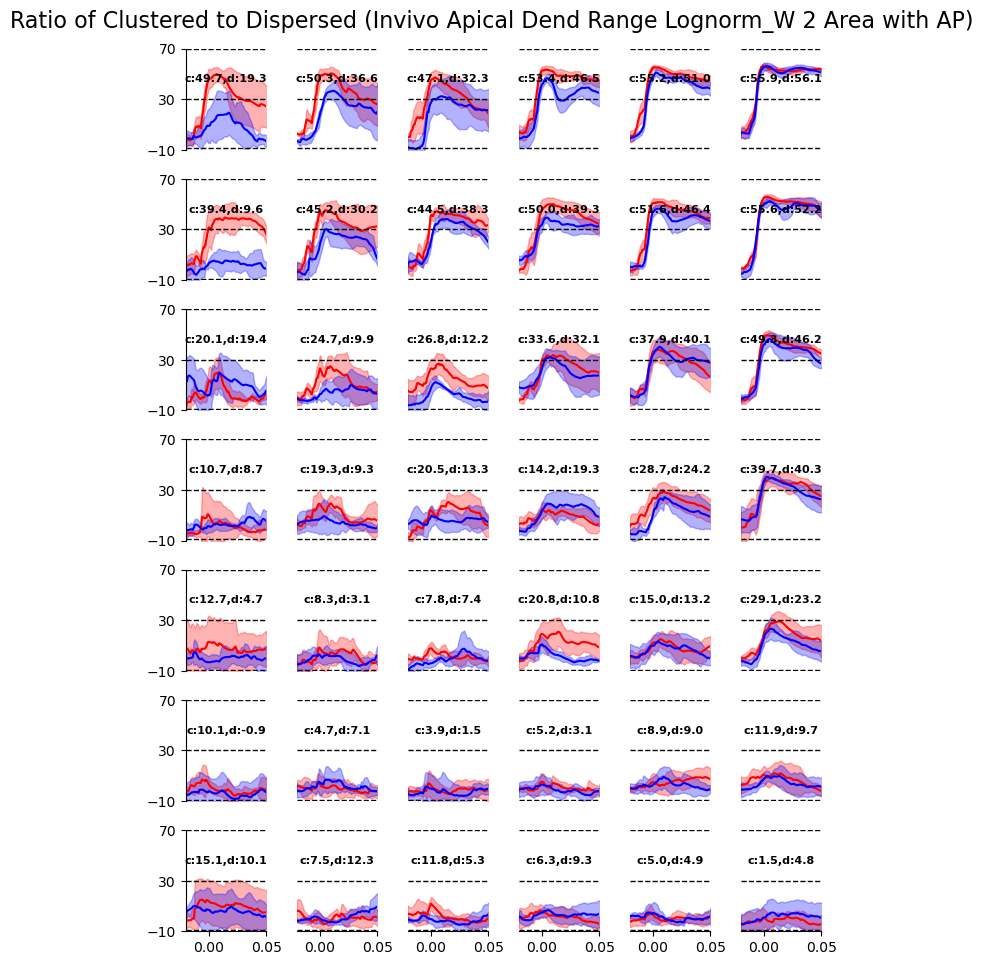

In [39]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_withAP', 'distr_invivo_variedW_withAP', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Dend Range Lognorm_W {range_idx} Area with AP)')

#### AMPA only

##### Fixed W_dis

3.54e-02 3.42e-01
3.14e-02 2.23e-01
2.99e-02 1.32e-01
3.40e-02 4.36e-01
2.88e-02 2.44e-01
2.68e-02 1.53e-01


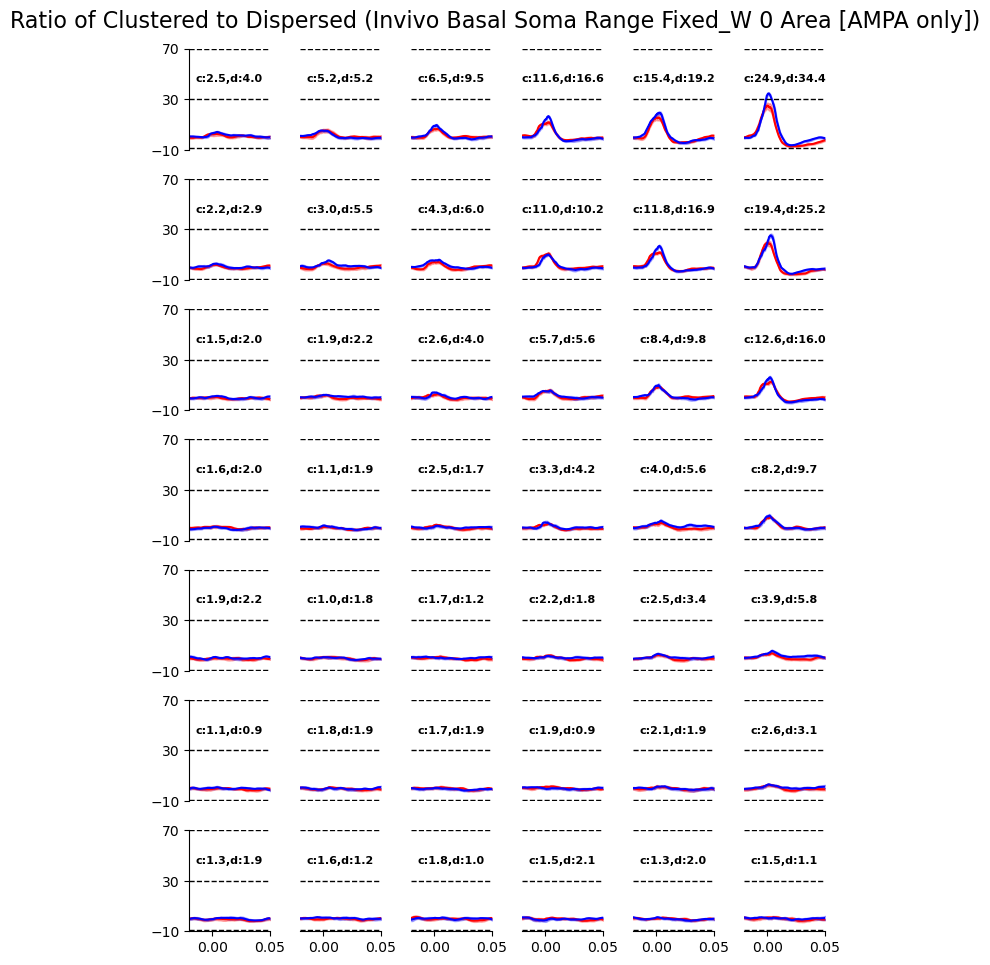

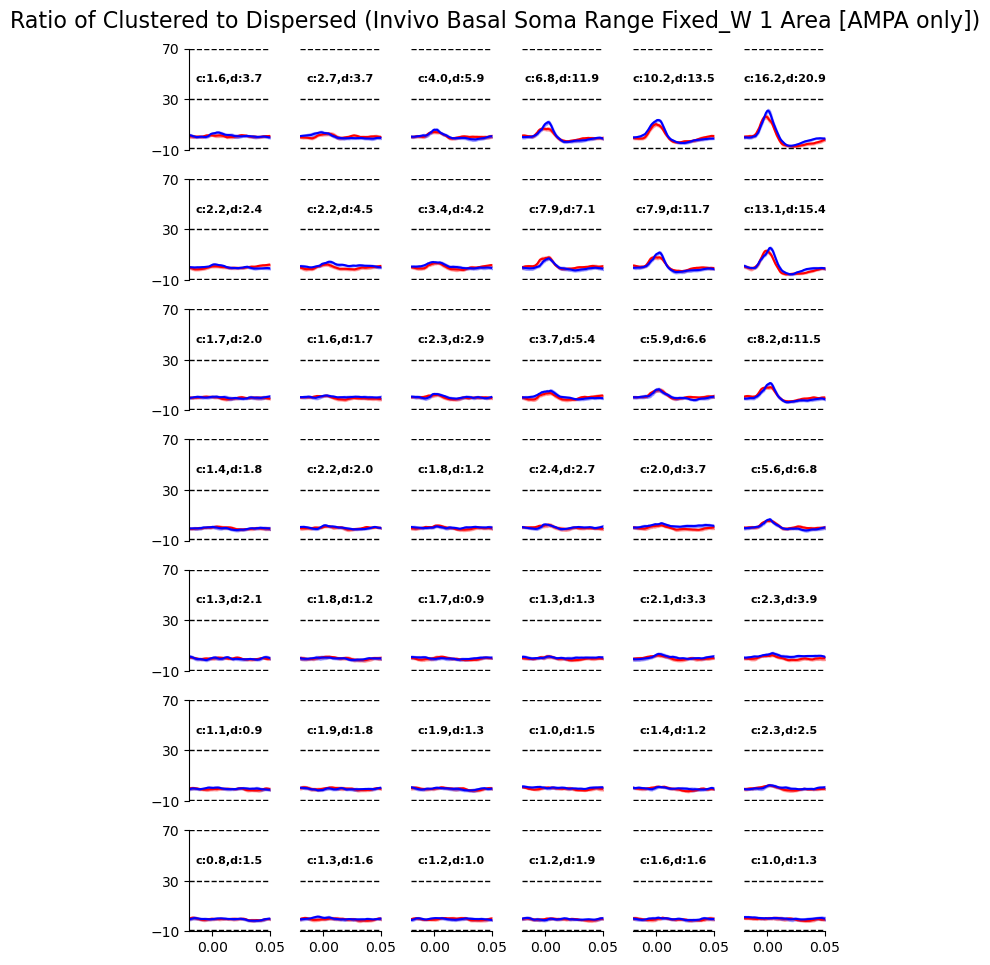

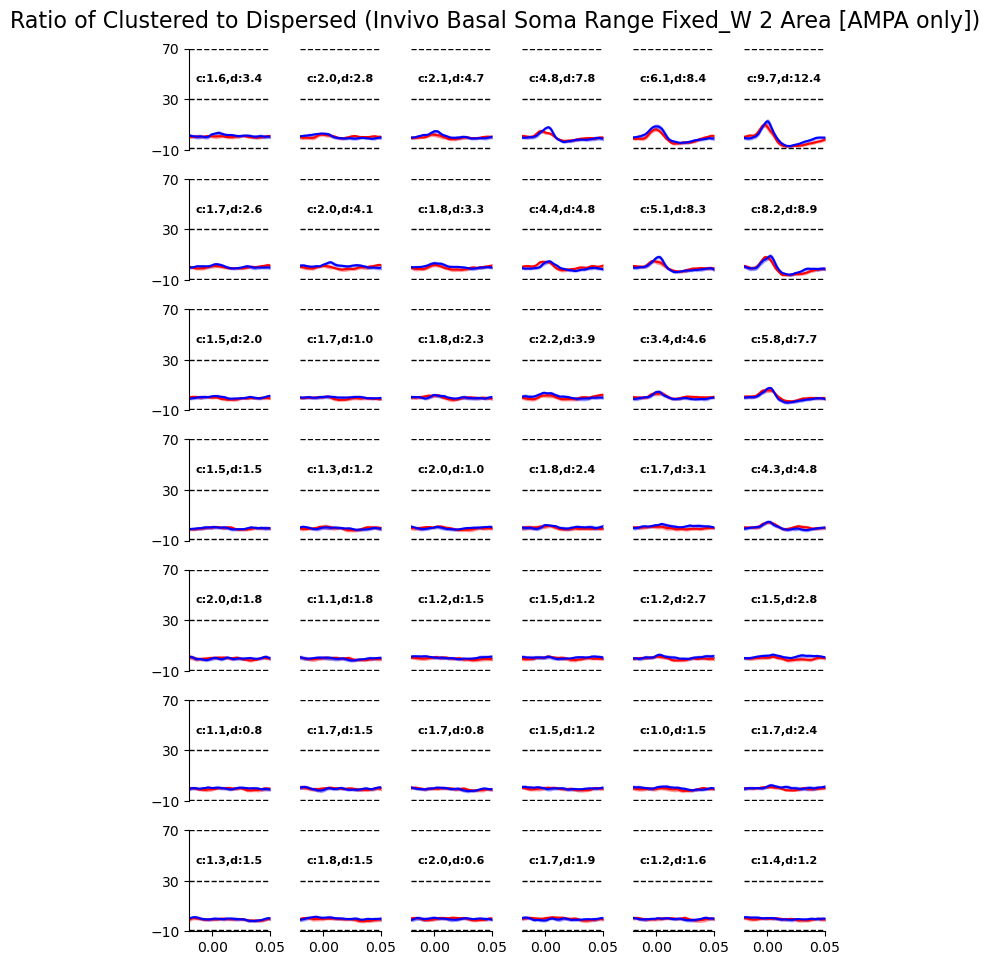

In [40]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invivo_AMPAonly', 'distr_invivo_AMPAonly', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Soma Range Fixed_W {range_idx} Area [AMPA only])')

5.55e-02 4.73e-01
9.35e-02 6.98e-01
1.65e-01 9.80e-01
5.58e-02 4.77e-01
1.01e-01 4.37e-01
1.51e-01 6.22e-01


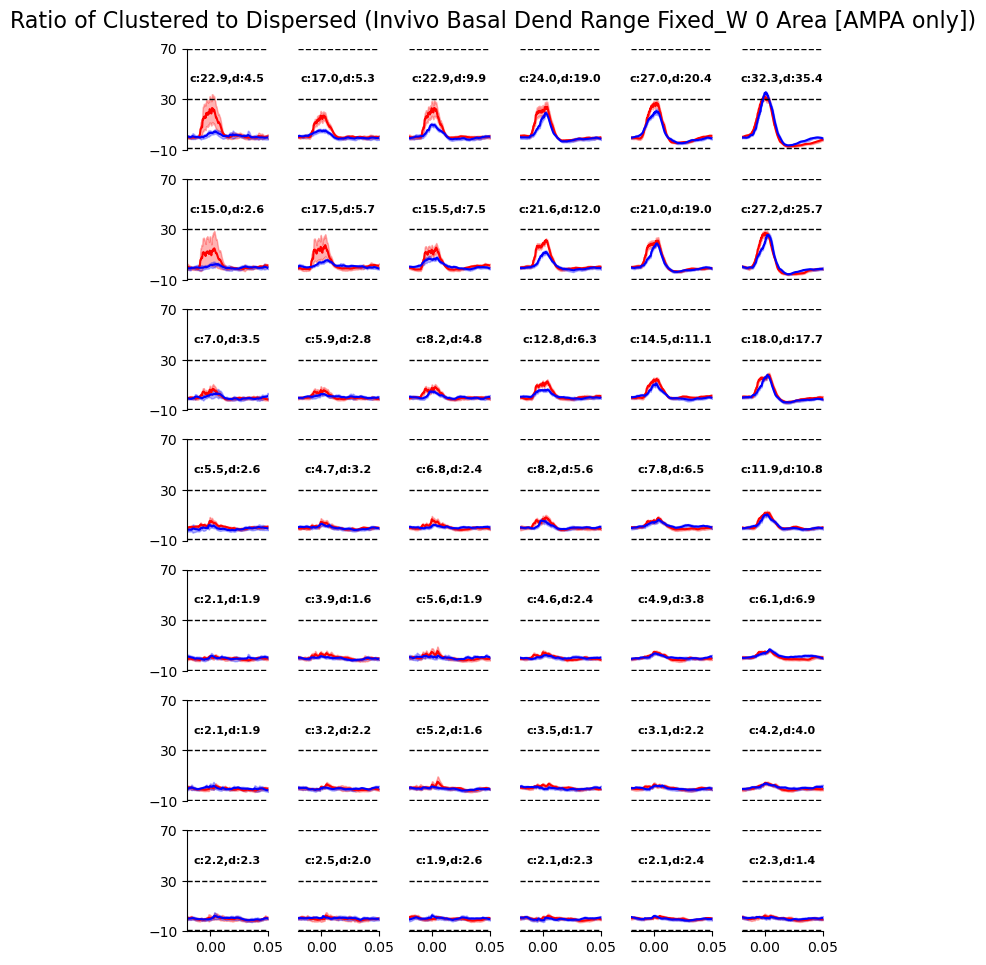

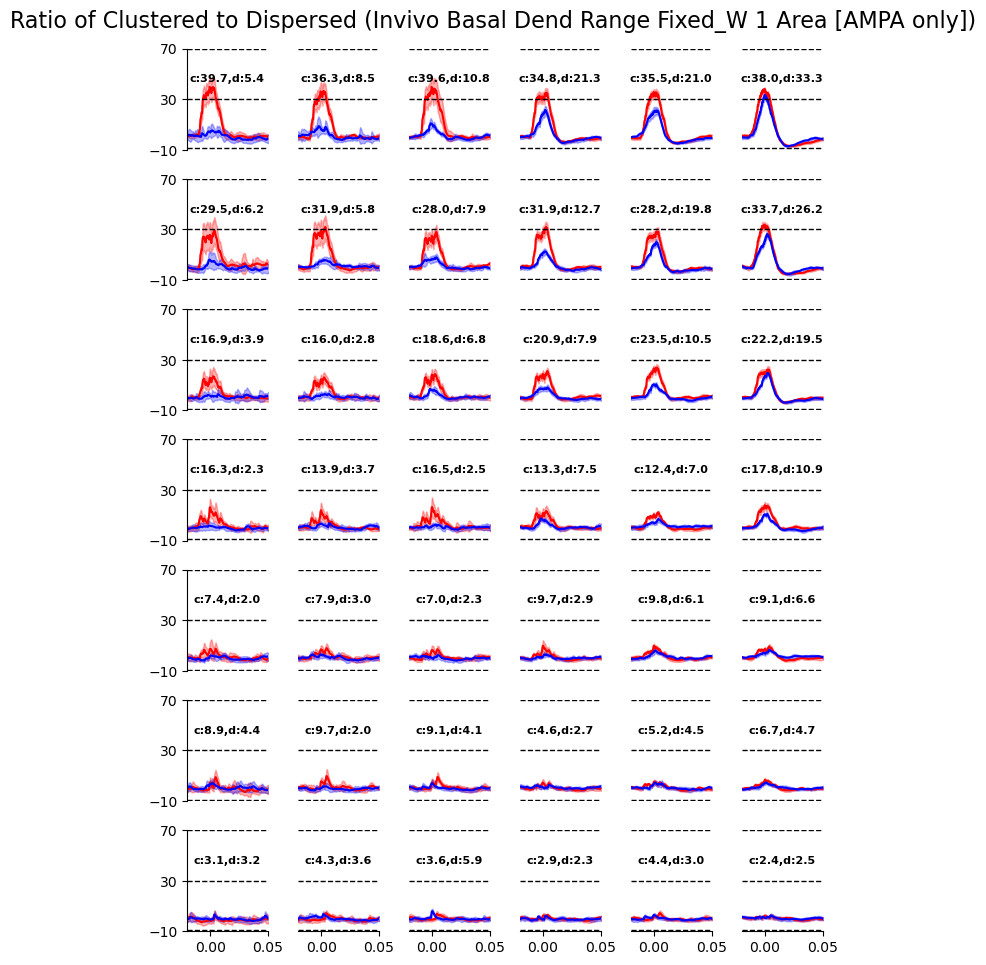

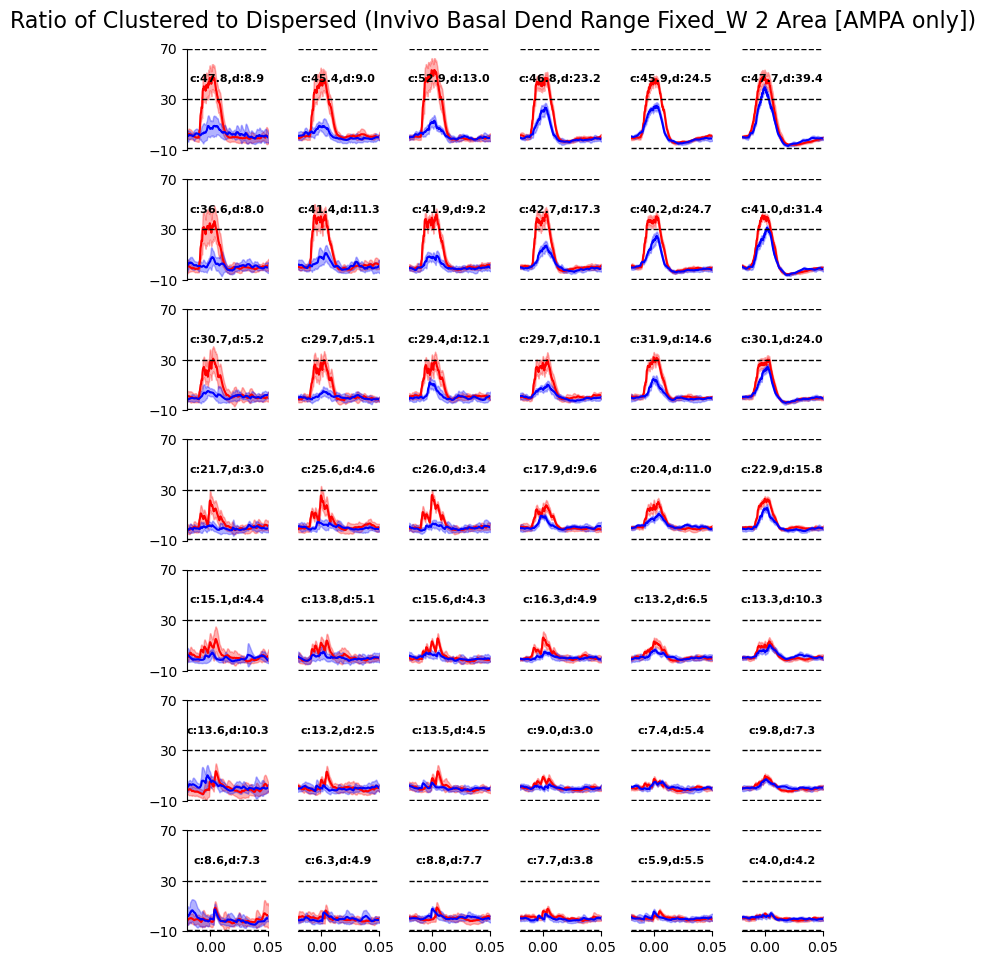

In [41]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_AMPAonly', 'distr_invivo_AMPAonly', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Dend Range Fixed_W {range_idx} Area [AMPA only])')

1.59e-02 6.51e-01
1.11e-02 2.10e-01
1.24e-02 1.56e-01
1.15e-02 6.76e-01
1.18e-02 2.88e-01
1.52e-02 2.63e-01


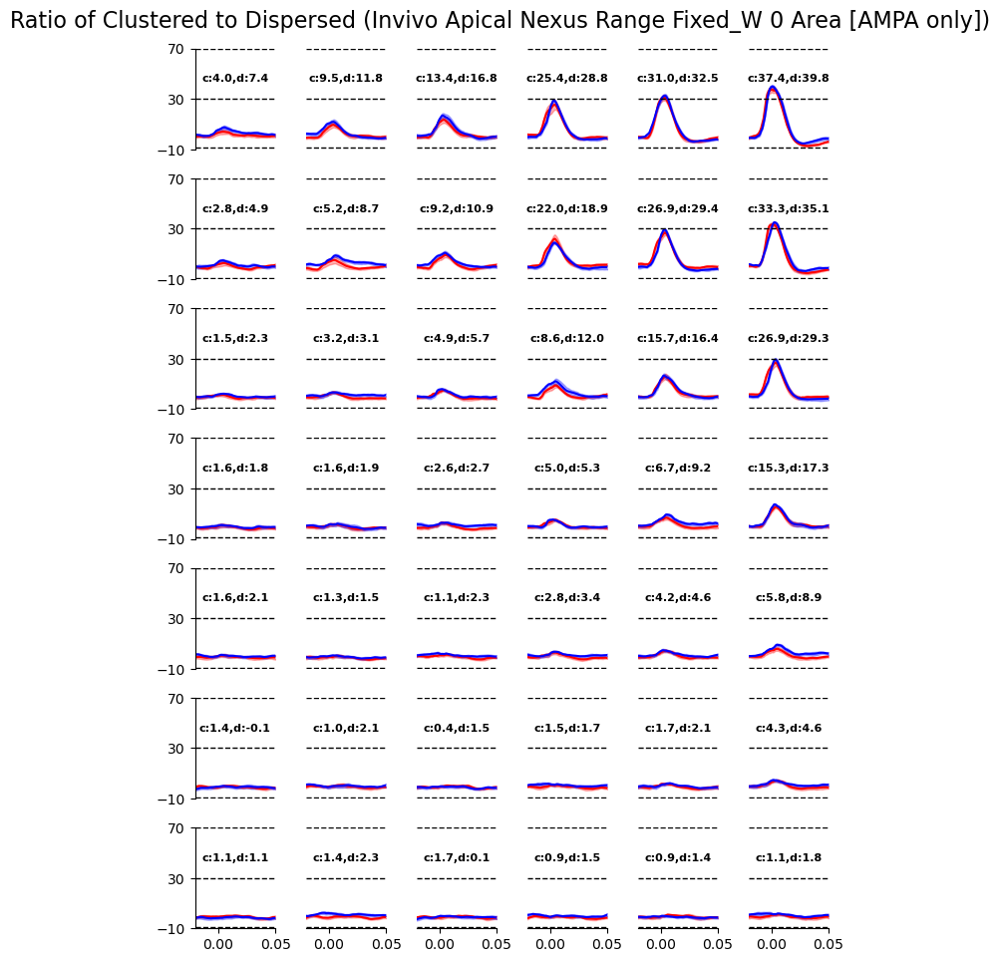

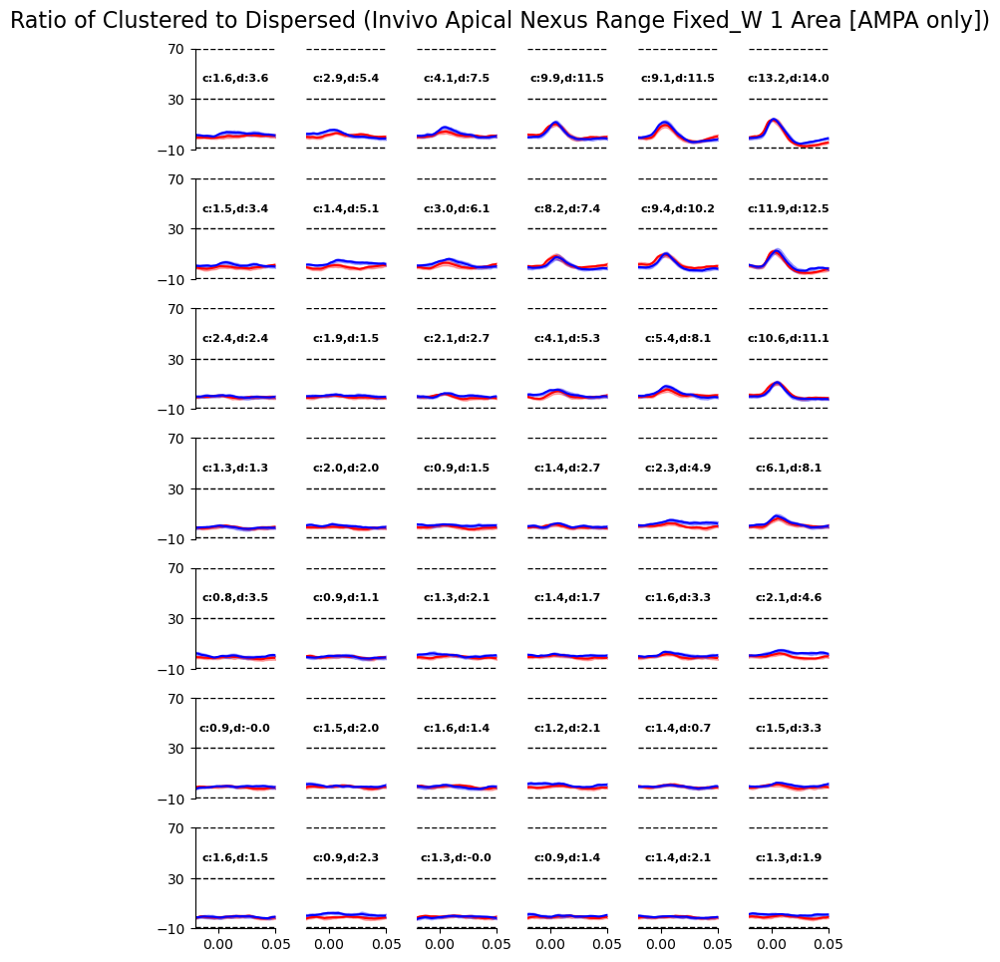

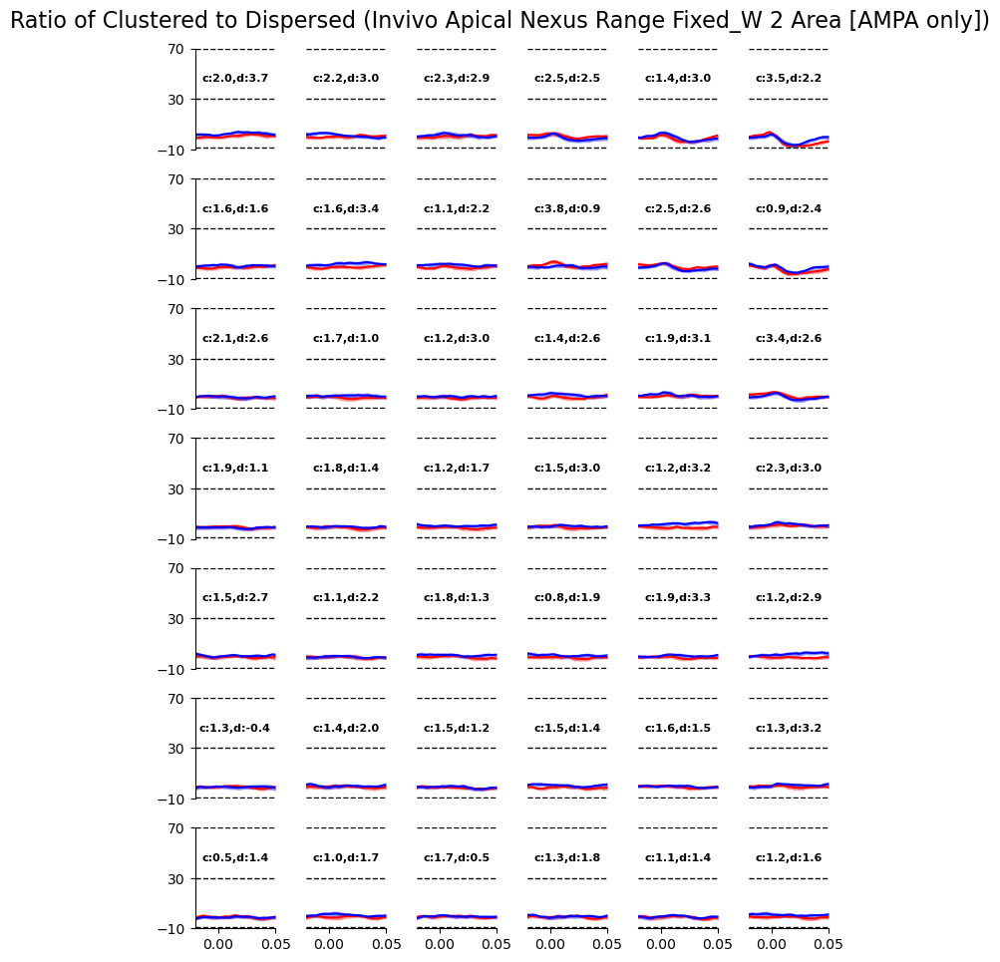

In [42]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invivo_AMPAonly', 'distr_invivo_AMPAonly','apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Nexus Range Fixed_W {range_idx} Area [AMPA only])')

5.37e-02 8.65e-01
9.60e-02 9.48e-01
2.31e-01 1.14e+00
2.97e-02 8.69e-01
1.24e-01 9.33e-01
1.71e-01 1.13e+00


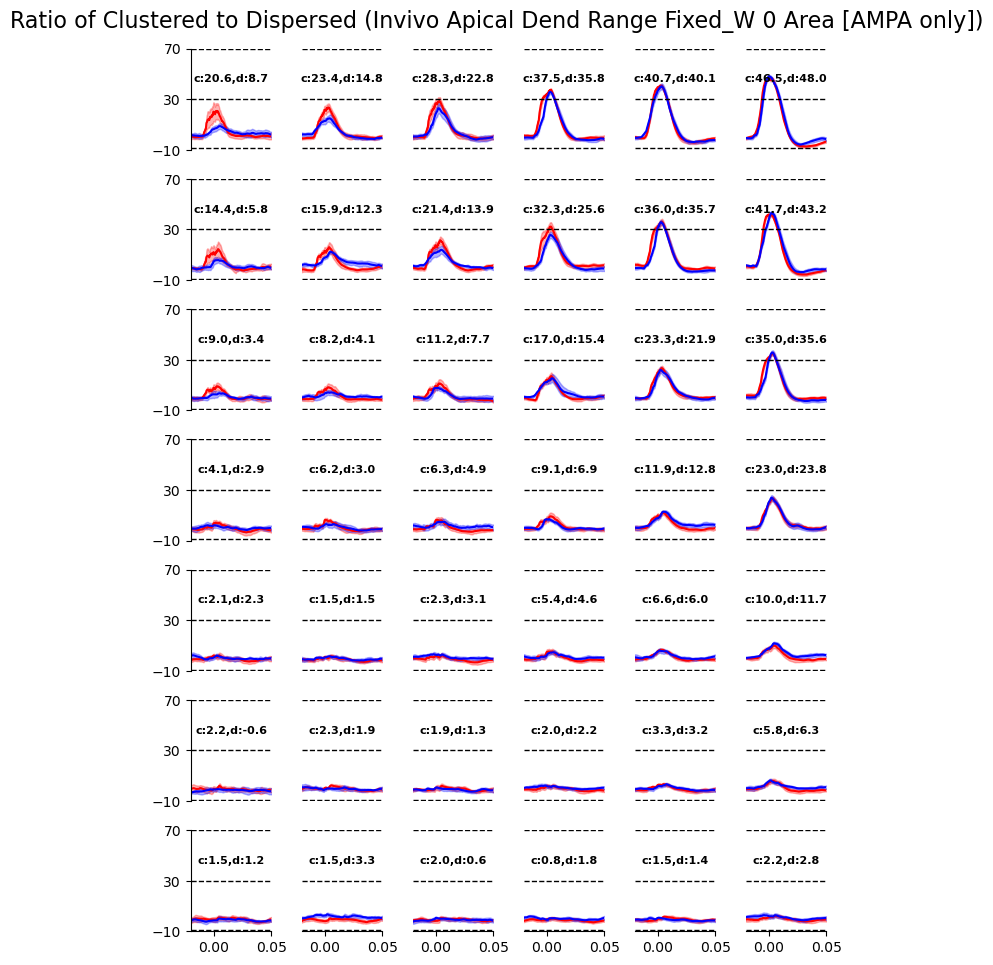

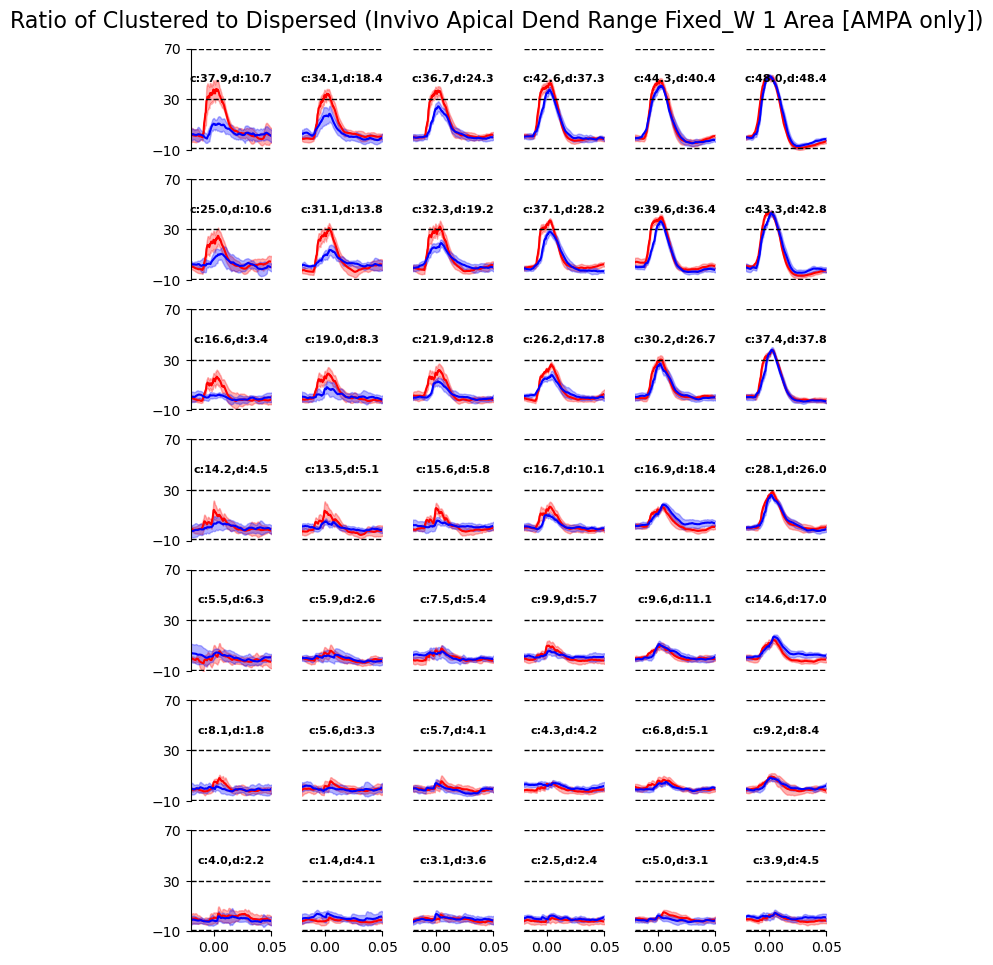

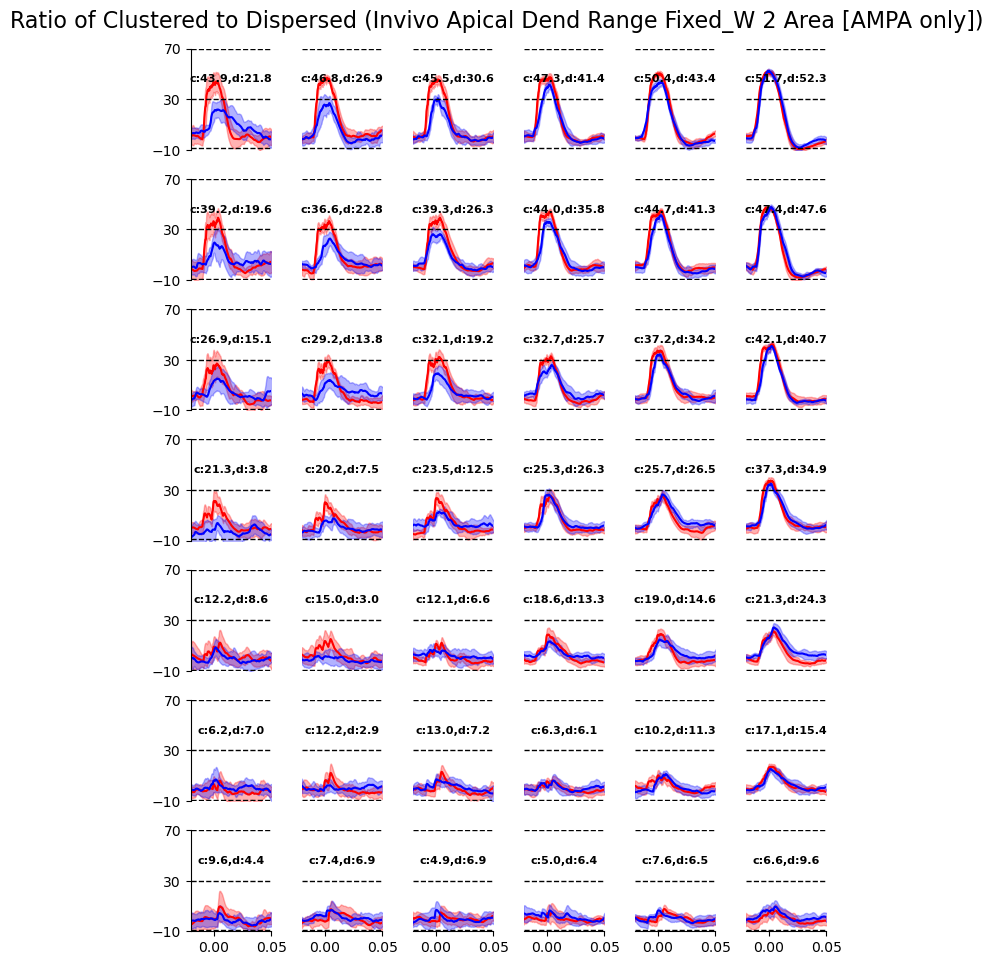

In [43]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_AMPAonly', 'distr_invivo_AMPAonly', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Dend Range Fixed_W {range_idx} Area [AMPA only])')

##### Lognorm W_dis

2.94e-02 2.12e-01
2.92e-02 1.43e-01
2.27e-02 8.57e-02
3.13e-02 2.37e-01
2.12e-02 1.64e-01
2.51e-02 1.13e-01


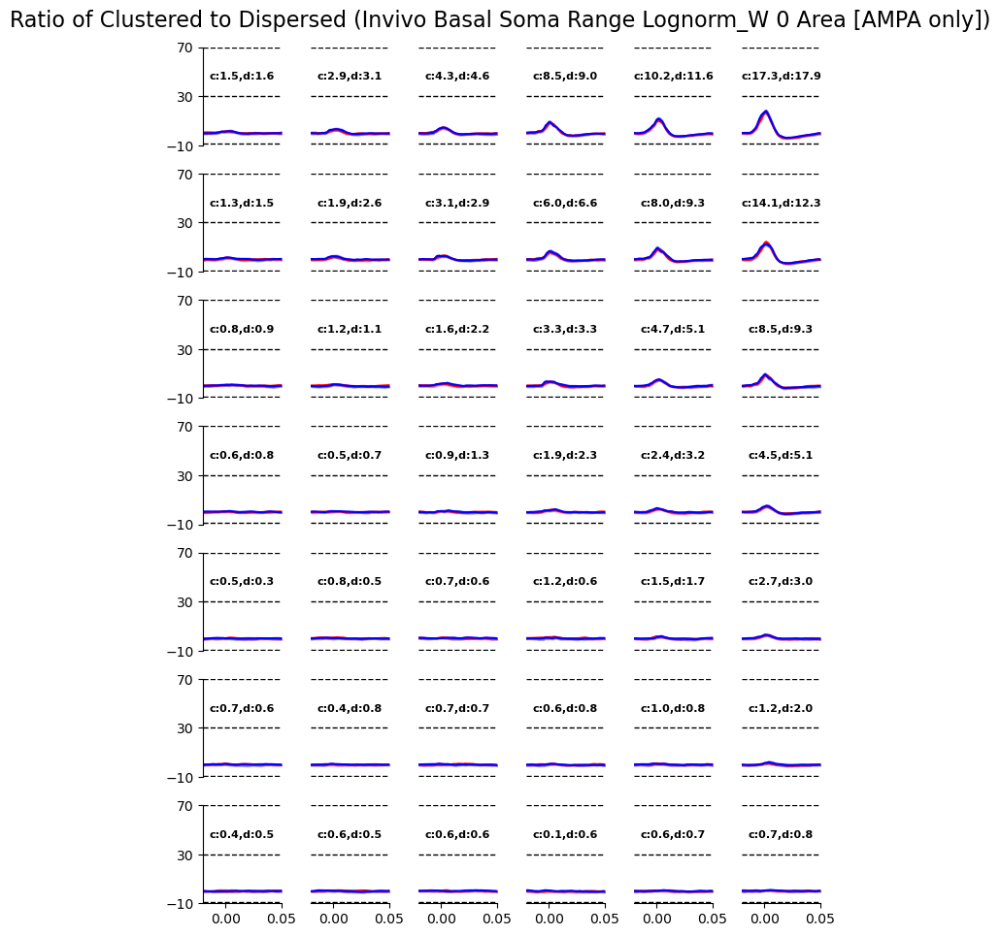

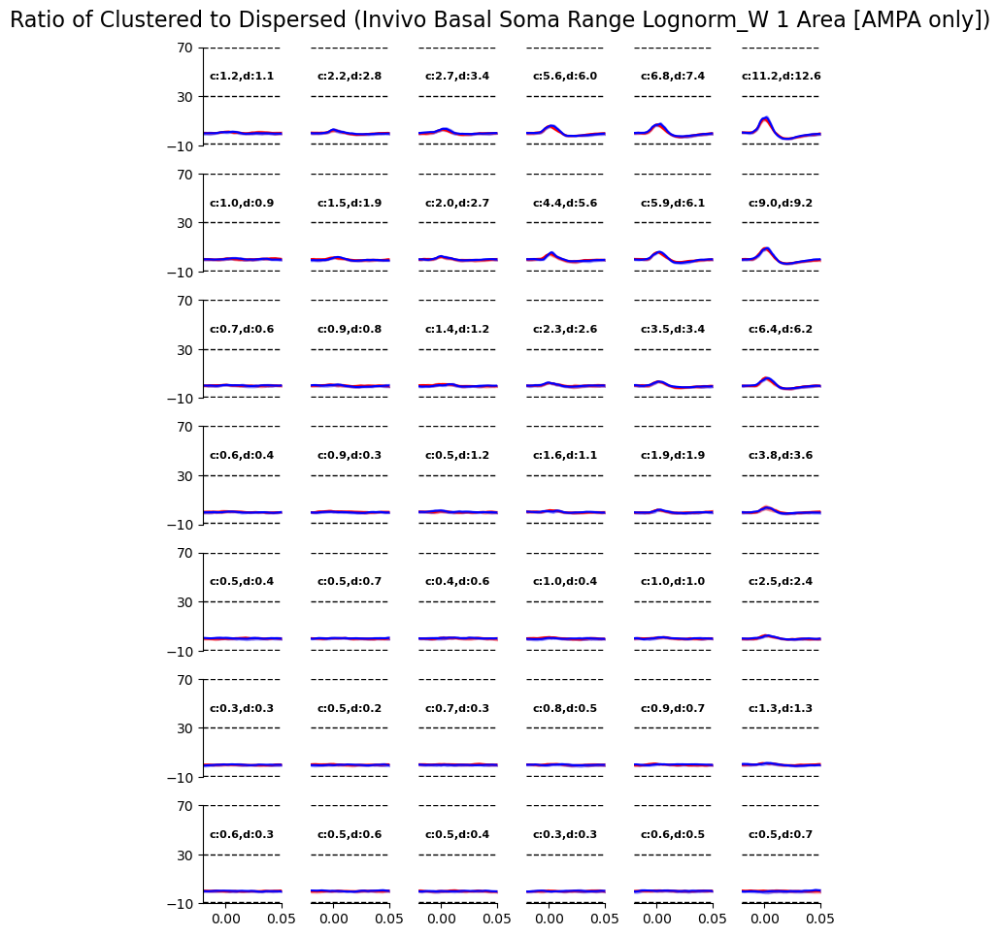

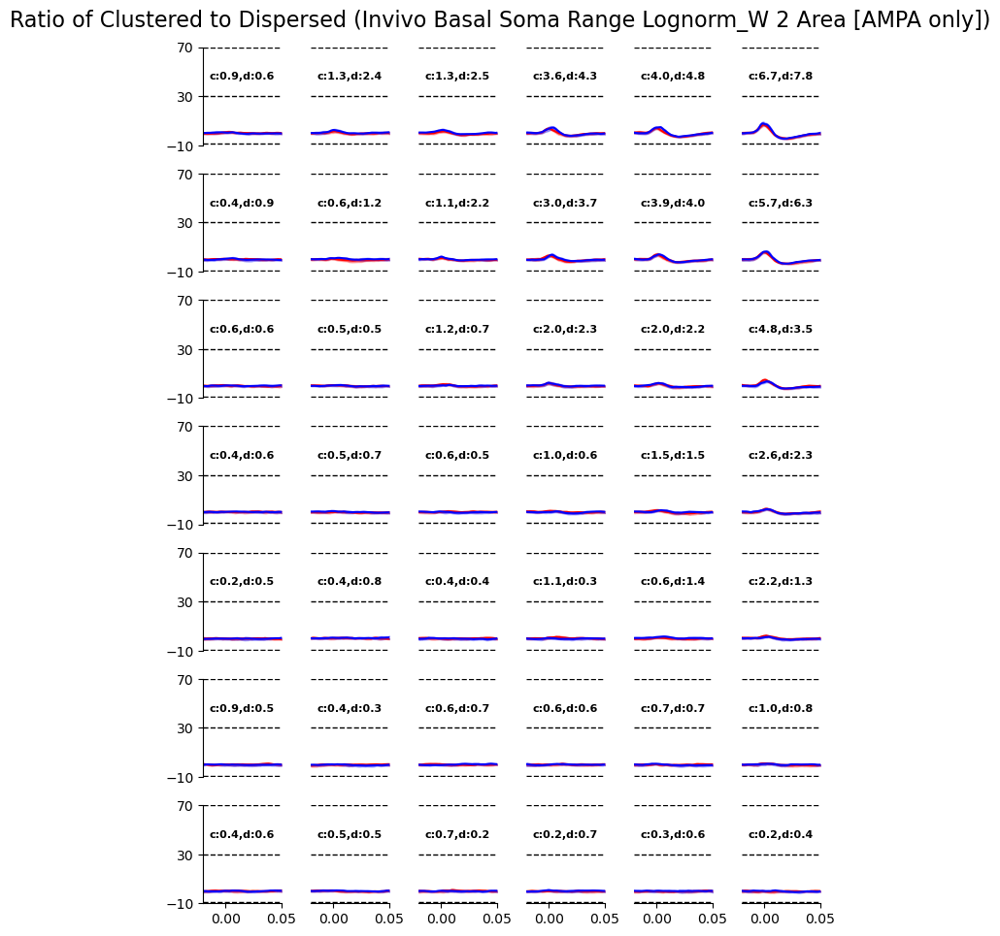

In [44]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_AMPAonly', 'distr_invivo_variedW_AMPAonly', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Soma Range Lognorm_W {range_idx} Area [AMPA only])')

4.00e-02 2.94e-01
7.00e-02 4.73e-01
1.06e-01 6.11e-01
3.63e-02 2.70e-01
6.44e-02 2.79e-01
9.65e-02 3.95e-01


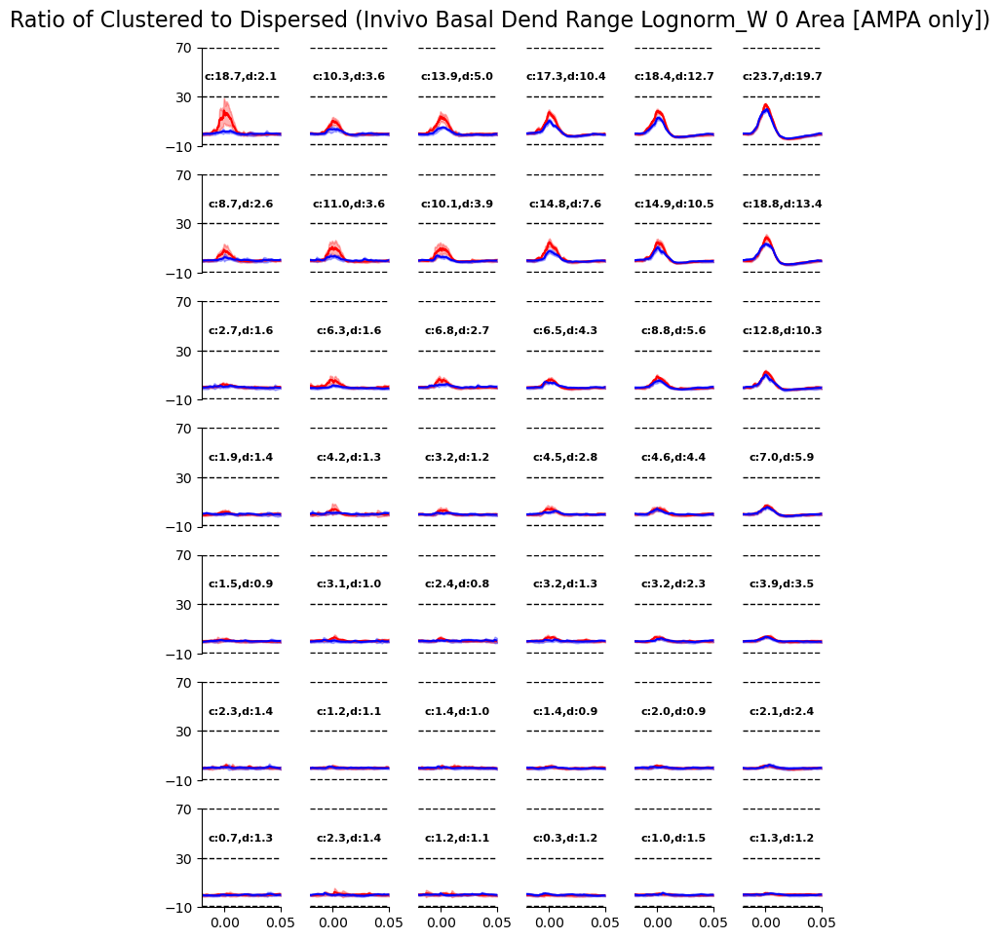

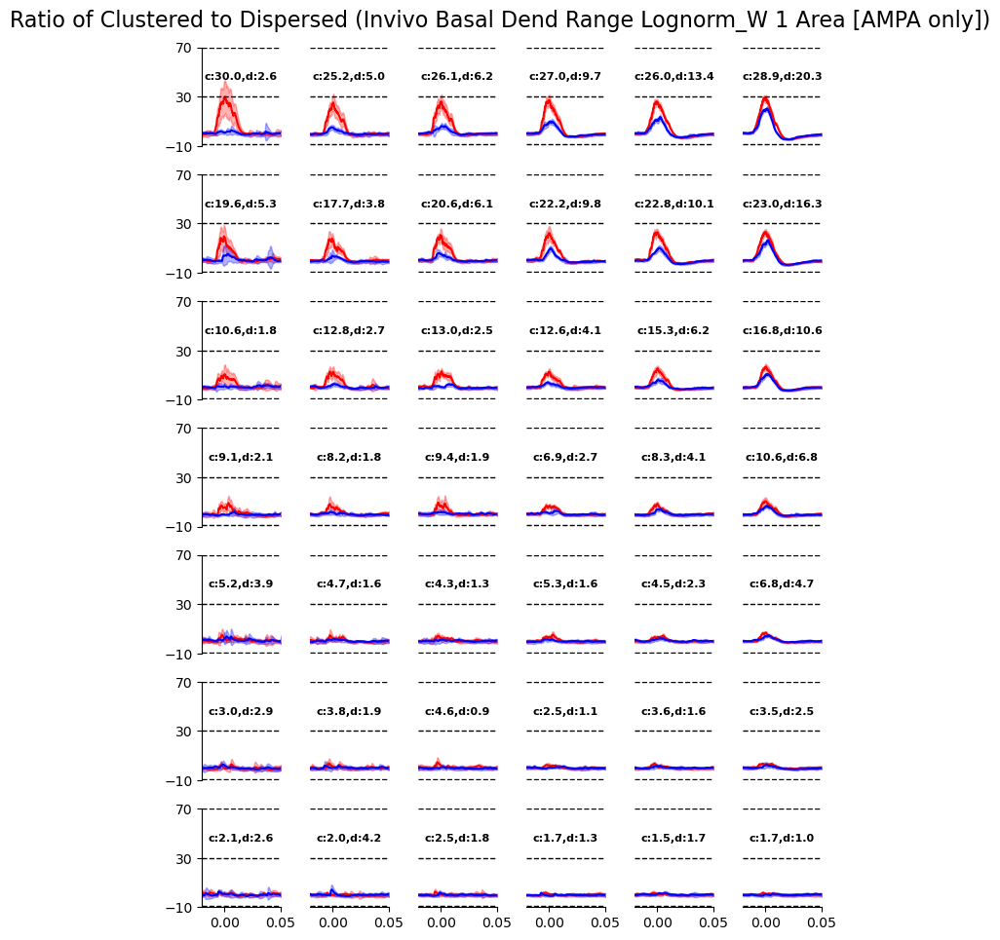

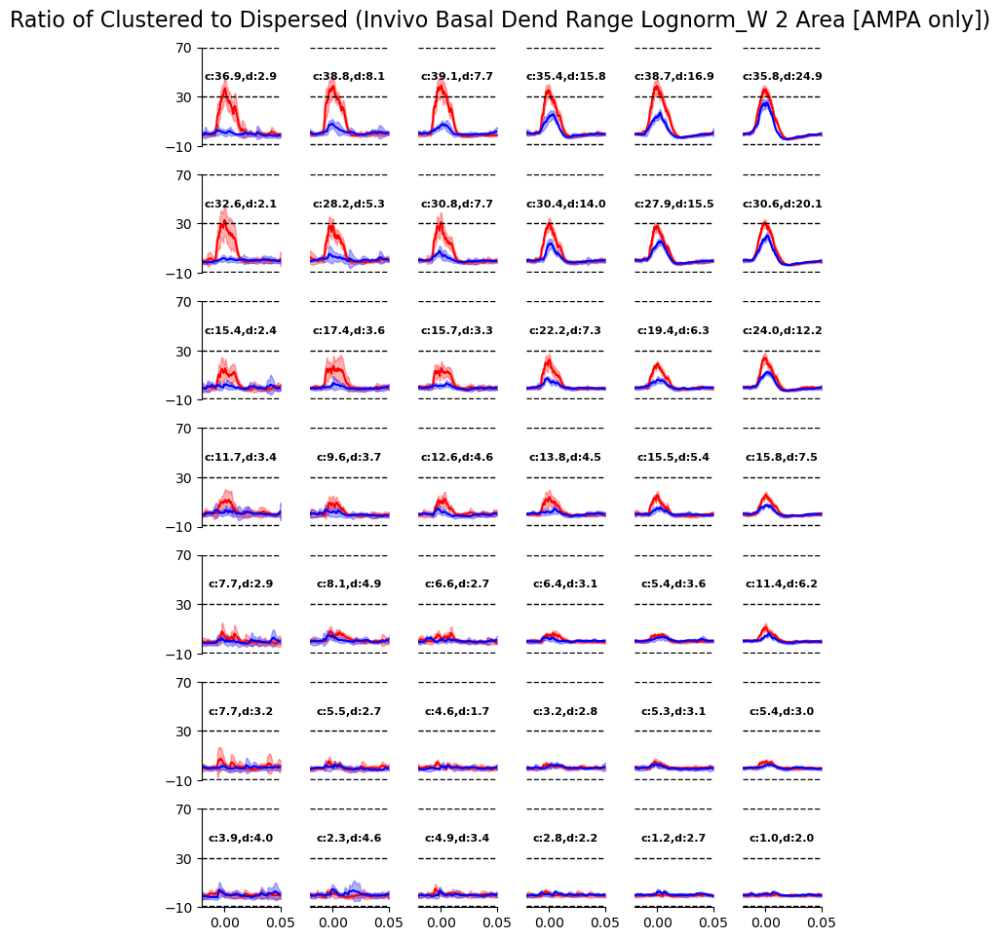

In [45]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_AMPAonly', 'distr_invivo_variedW_AMPAonly', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Dend Range Lognorm_W {range_idx} Area [AMPA only])')

3.71e-02 4.89e-01
2.95e-02 1.65e-01
1.89e-02 6.51e-02
3.56e-02 5.07e-01
2.90e-02 1.55e-01
2.86e-02 6.37e-02


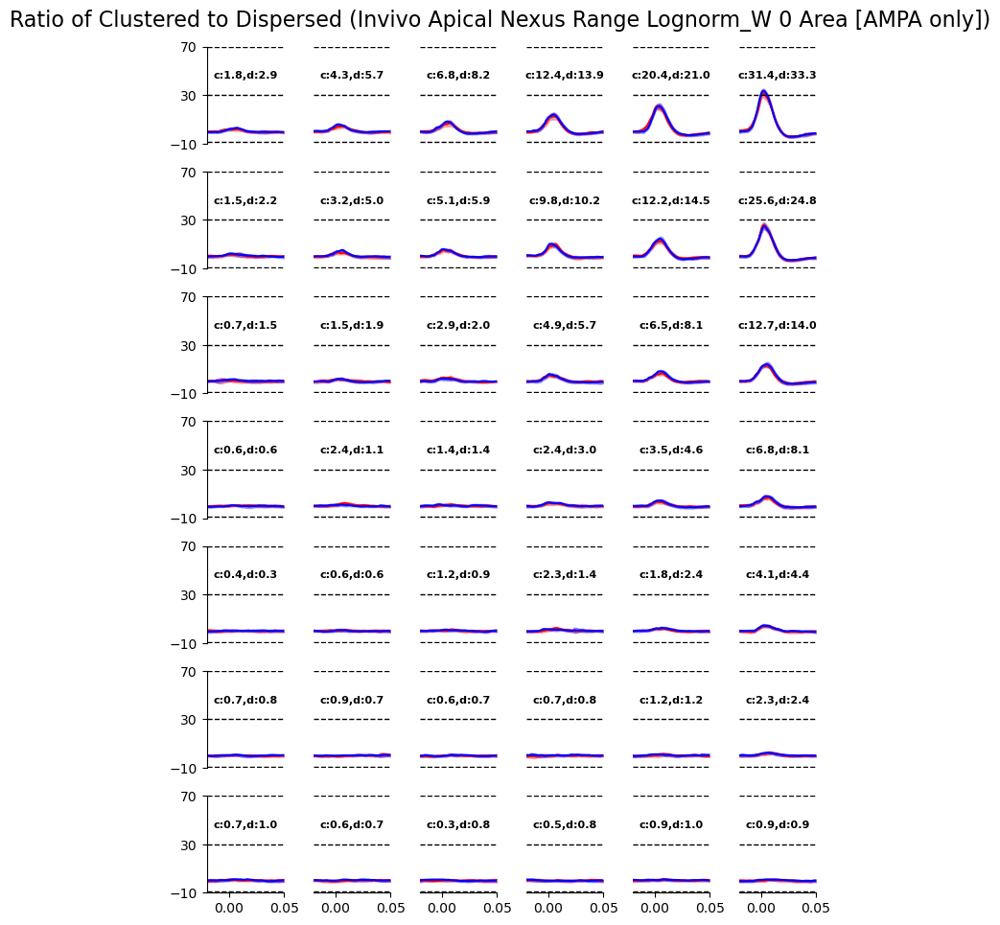

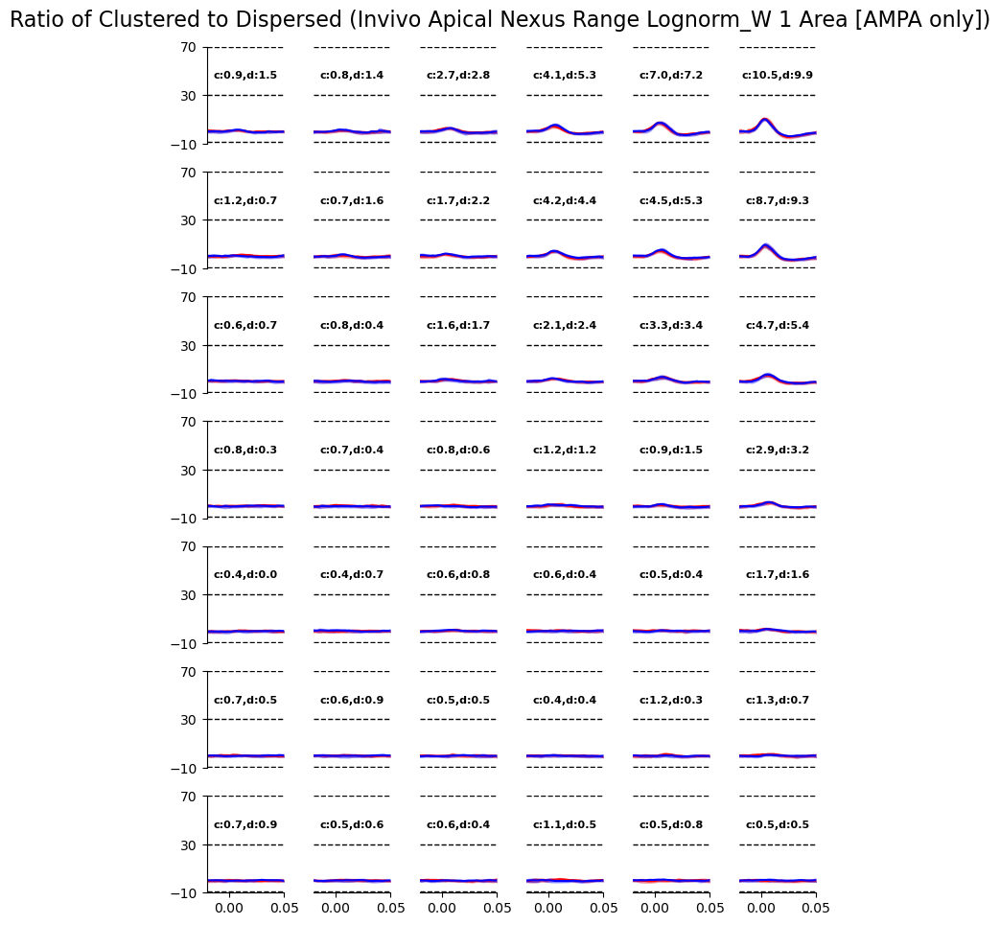

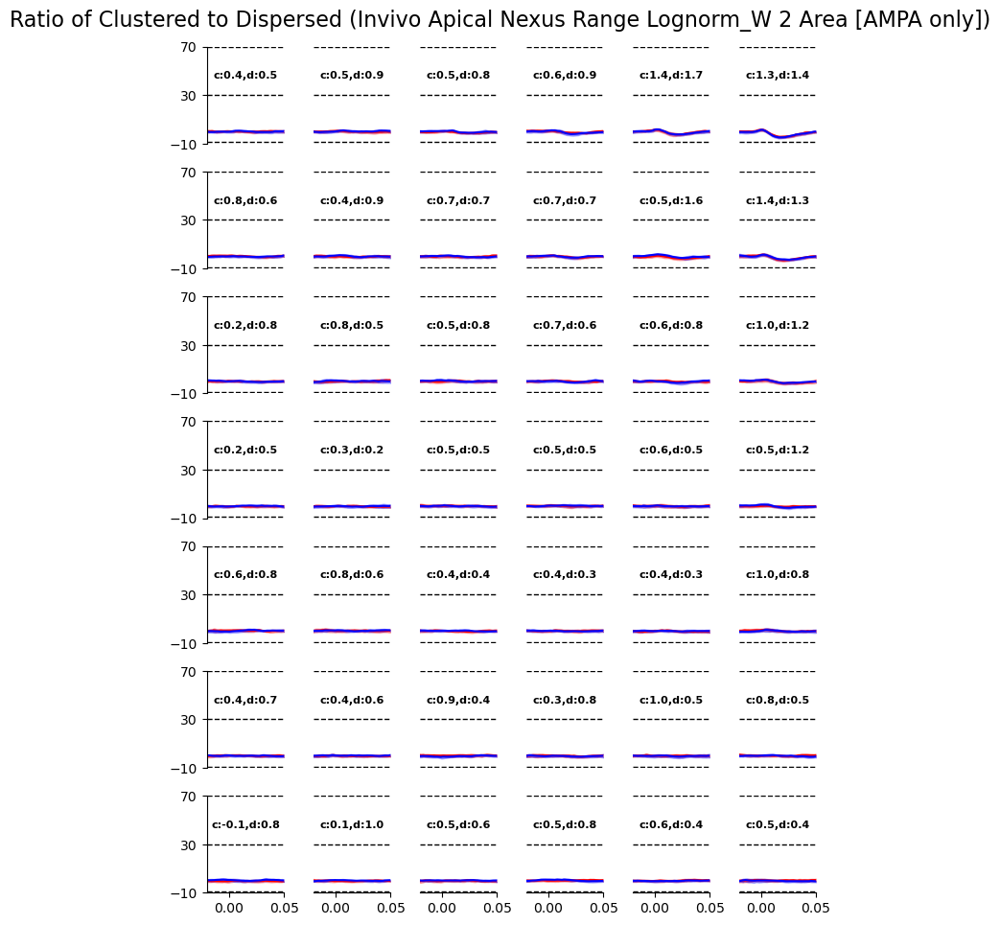

In [46]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_AMPAonly', 'distr_invivo_variedW_AMPAonly', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Nexus Range Lognorm_W {range_idx} Area [AMPA only])')

5.20e-02 6.76e-01
1.06e-01 7.27e-01
1.68e-01 9.37e-01
5.17e-02 6.47e-01
8.83e-02 6.47e-01
1.55e-01 8.37e-01


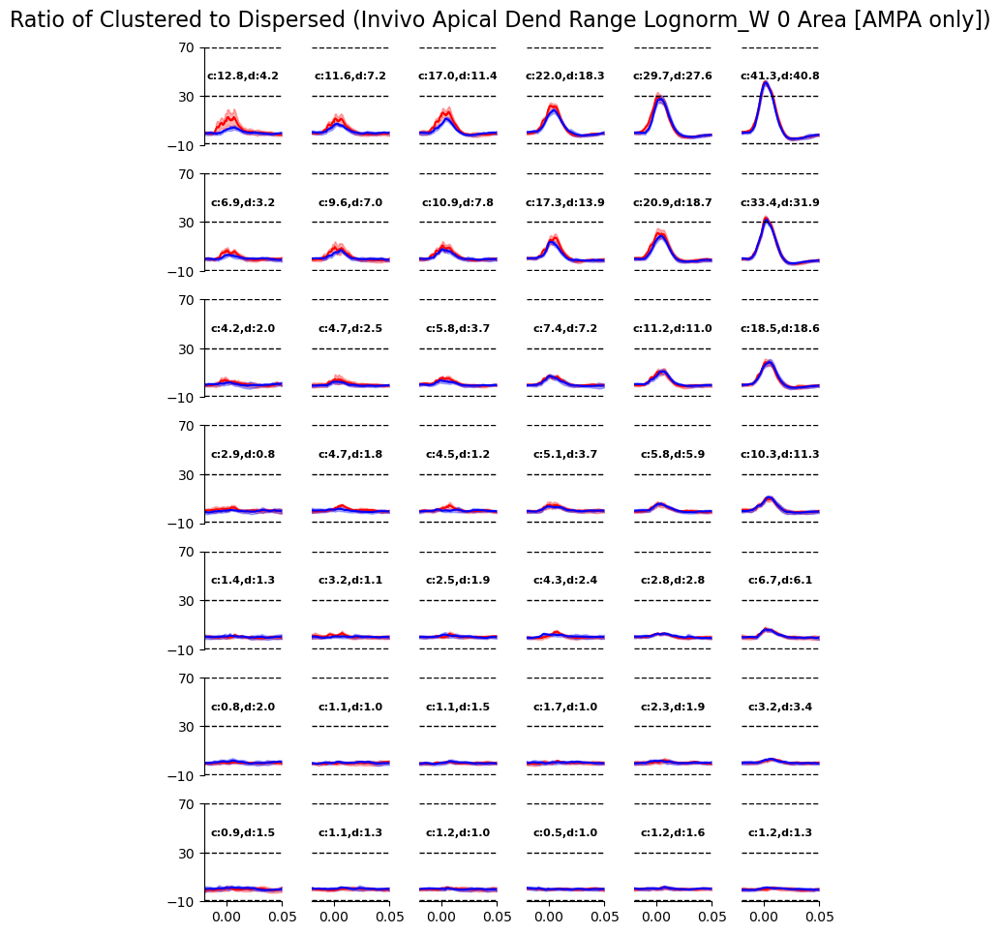

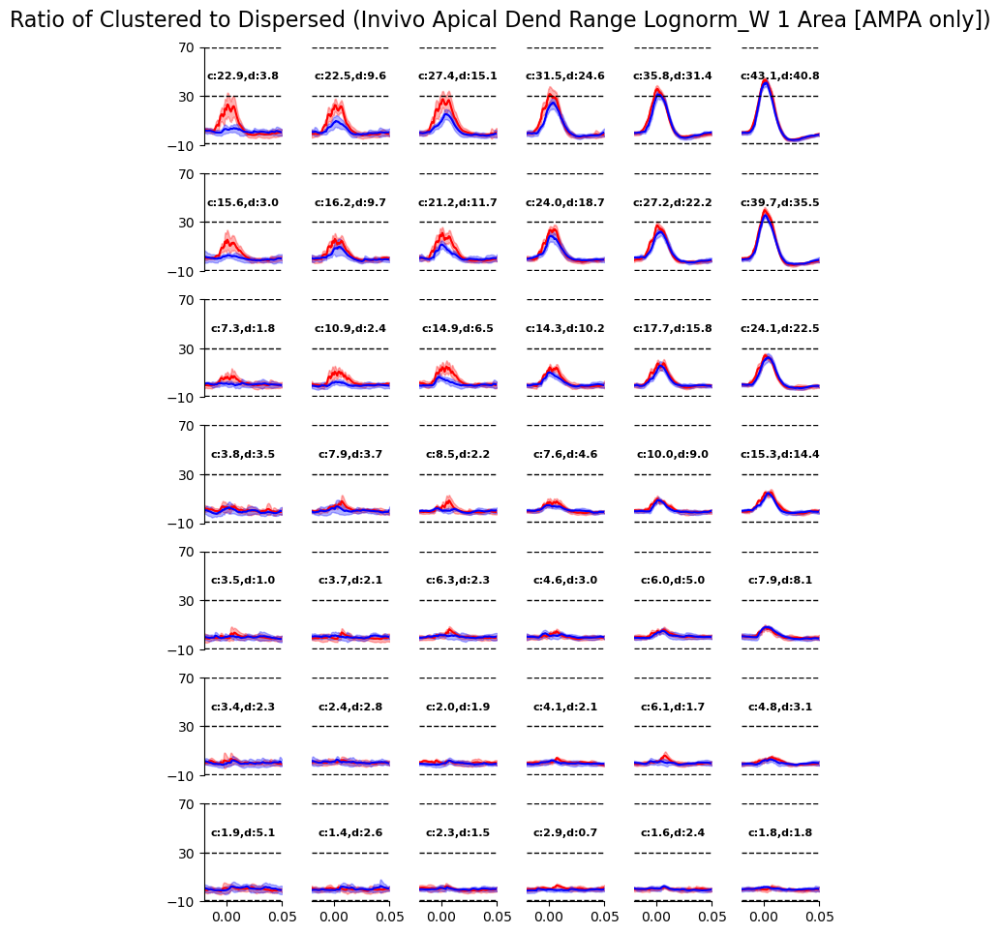

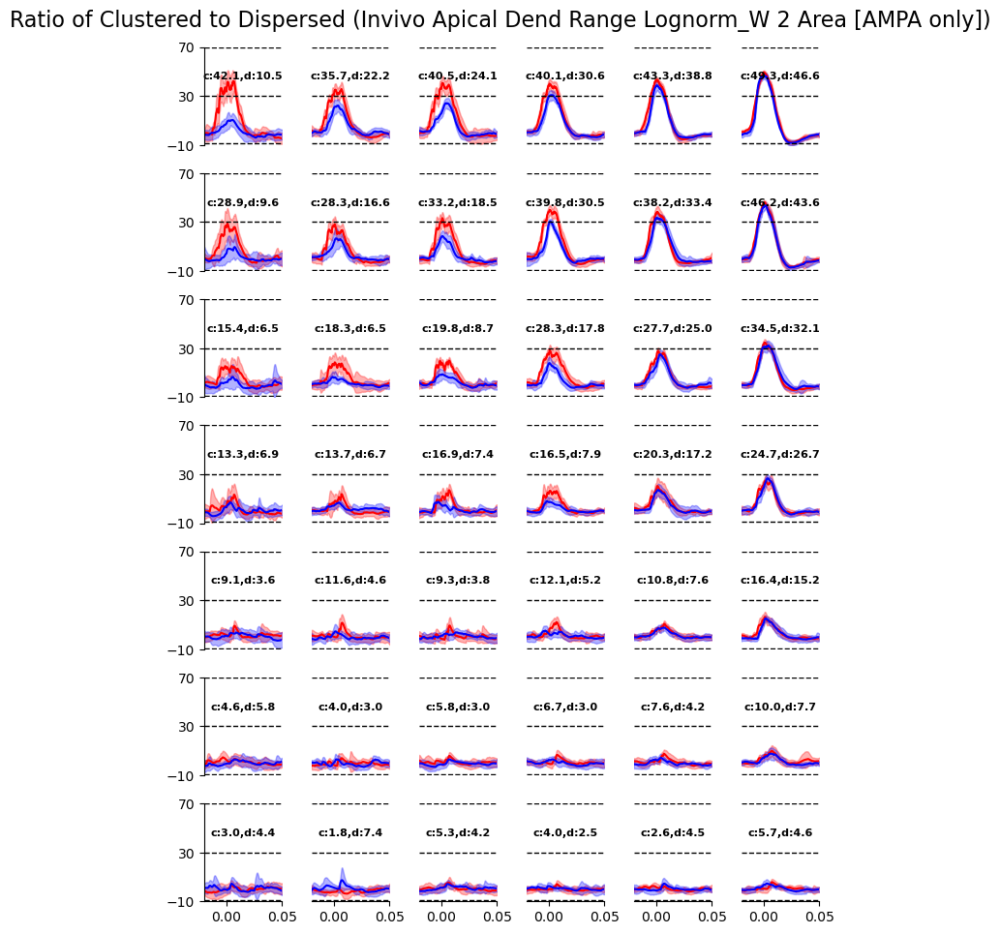

In [47]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_AMPAonly', 'distr_invivo_variedW_AMPAonly', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Dend Range Lognorm_W {range_idx} Area [AMPA only])')

##### Lognorm W_dis with AP

2.81e-02 1.91e-01
2.06e-02 1.54e-01
2.12e-02 8.88e-02
1.98e-02 2.27e-01
1.86e-02 1.44e-01
2.52e-02 1.09e-01


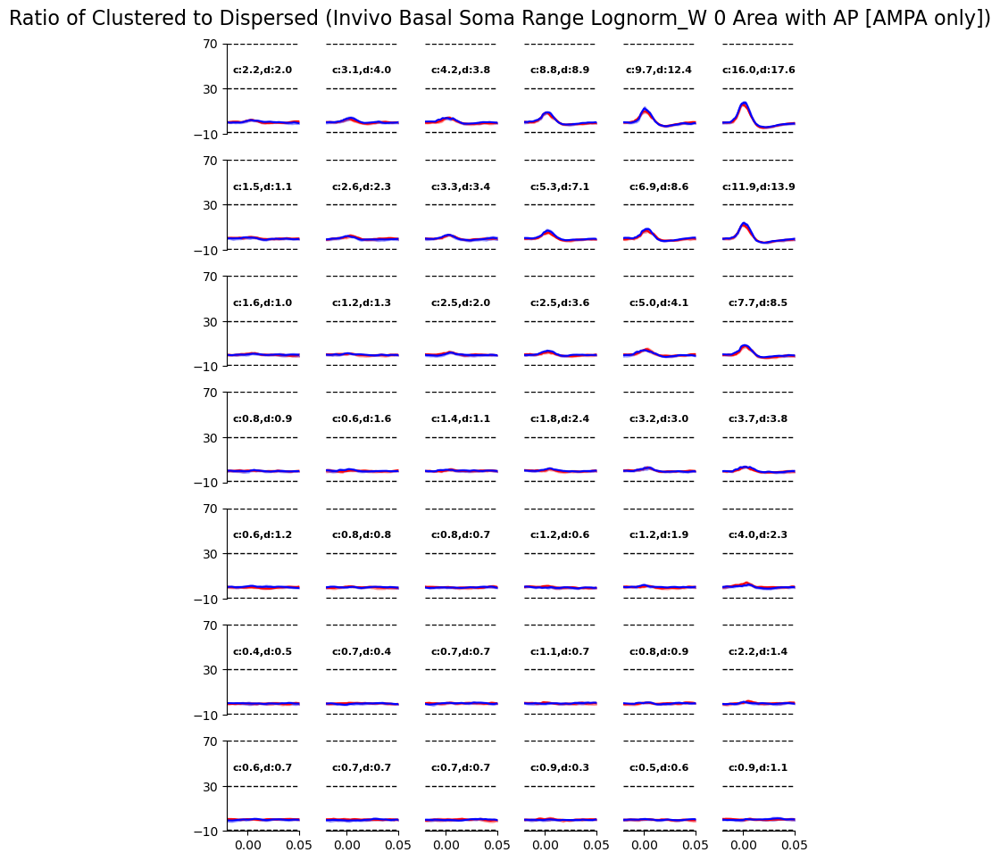

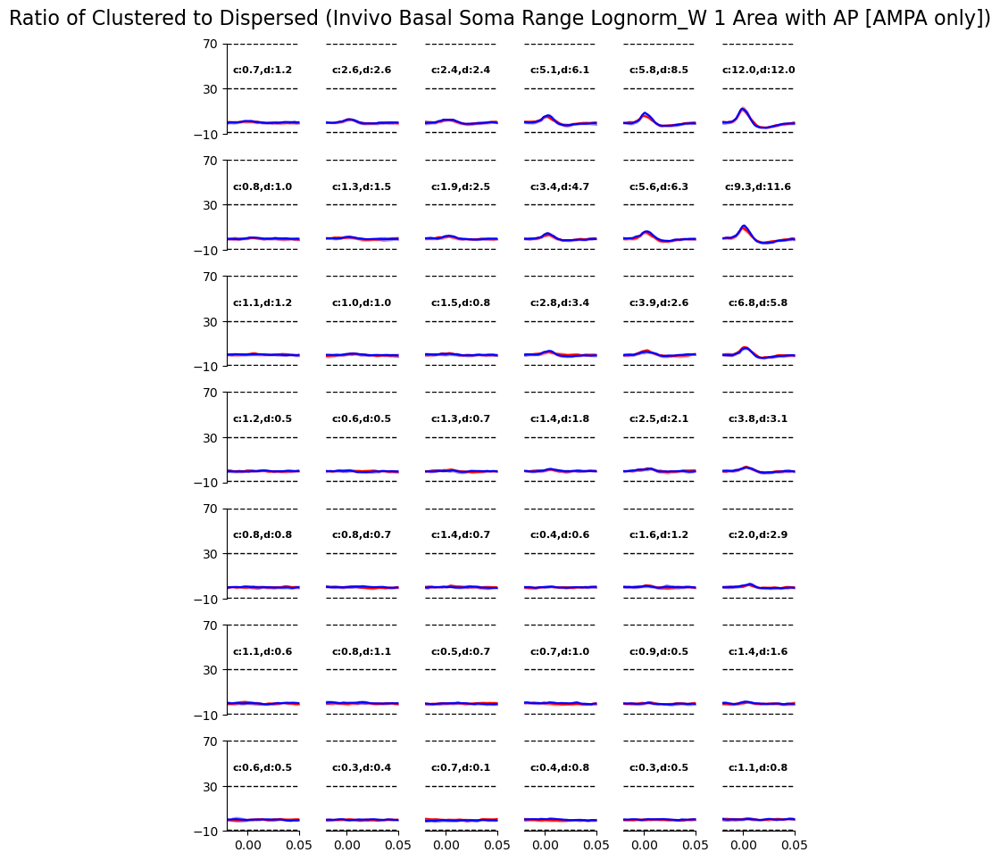

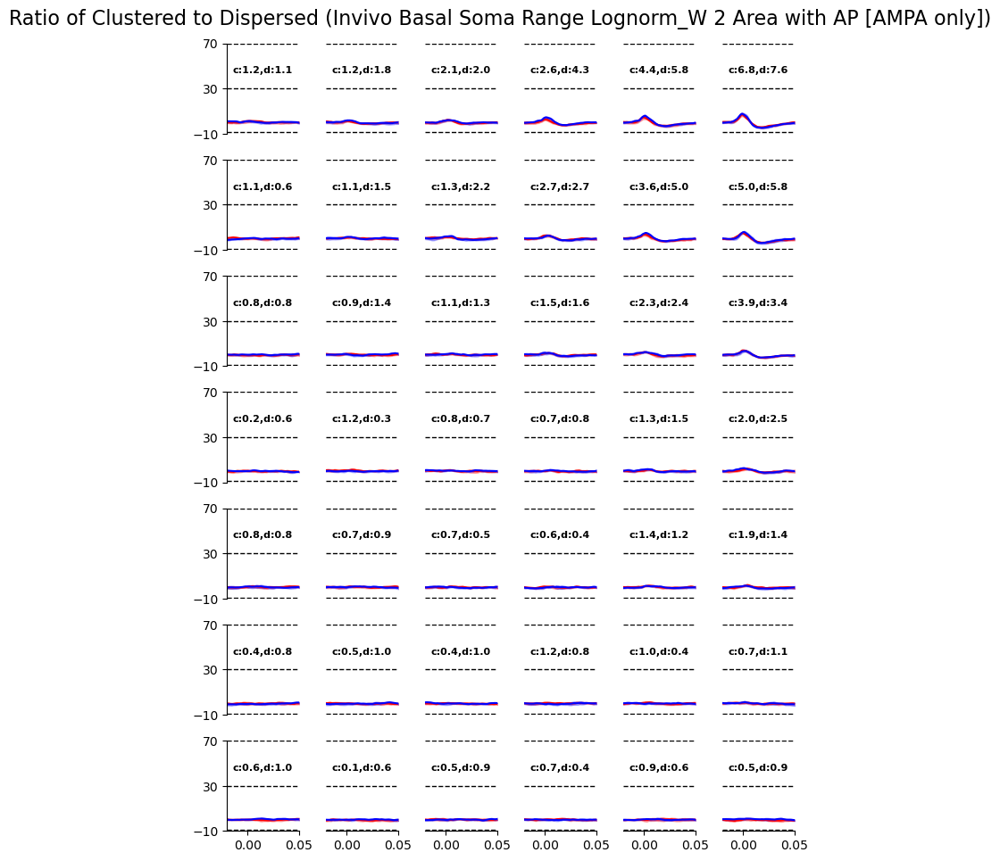

In [48]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_AMPAonly_withAP', 'distr_invivo_variedW_AMPAonly_withAP', 'basal', 'Soma', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_soma_root_v_0_area.flatten(), clus_soma_root_v_1_area.flatten(), clus_soma_root_v_2_area.flatten(), 
                                             distr_soma_root_v_0_area.flatten(), distr_soma_root_v_1_area.flatten(), distr_soma_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Soma Range Lognorm_W {range_idx} Area with AP [AMPA only])')

4.65e-02 3.01e-01
5.66e-02 5.08e-01
7.28e-02 7.28e-01
3.72e-02 2.51e-01
5.98e-02 2.78e-01
6.93e-02 3.92e-01


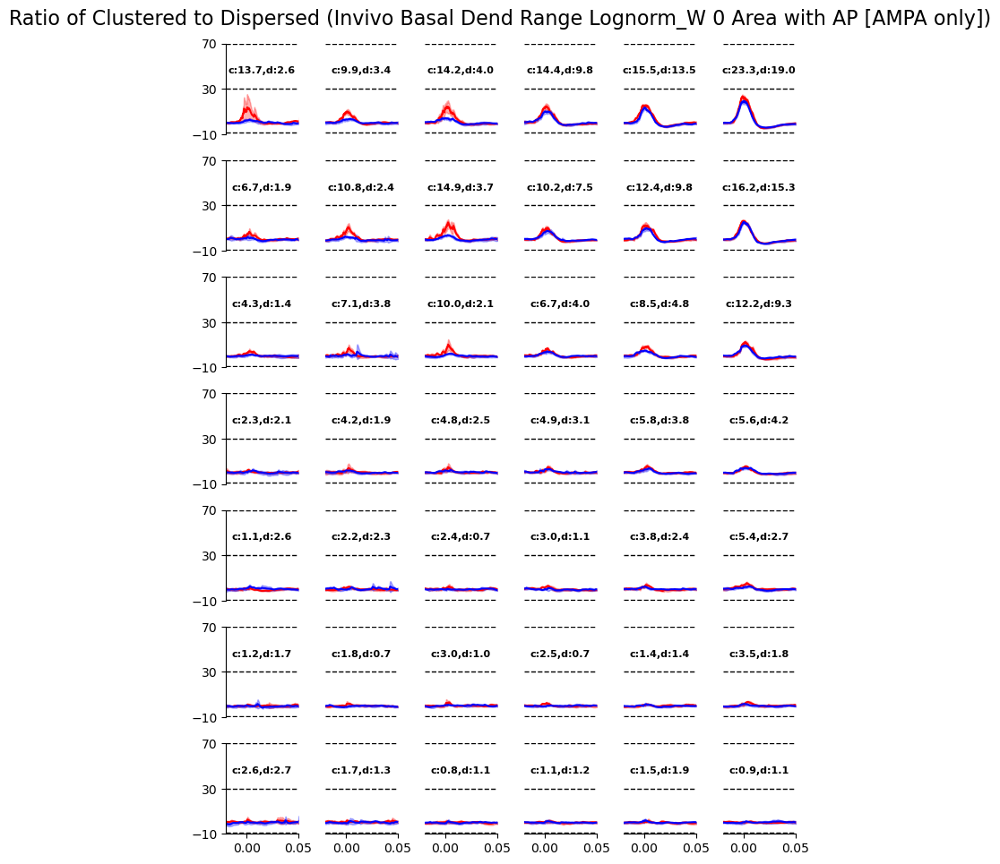

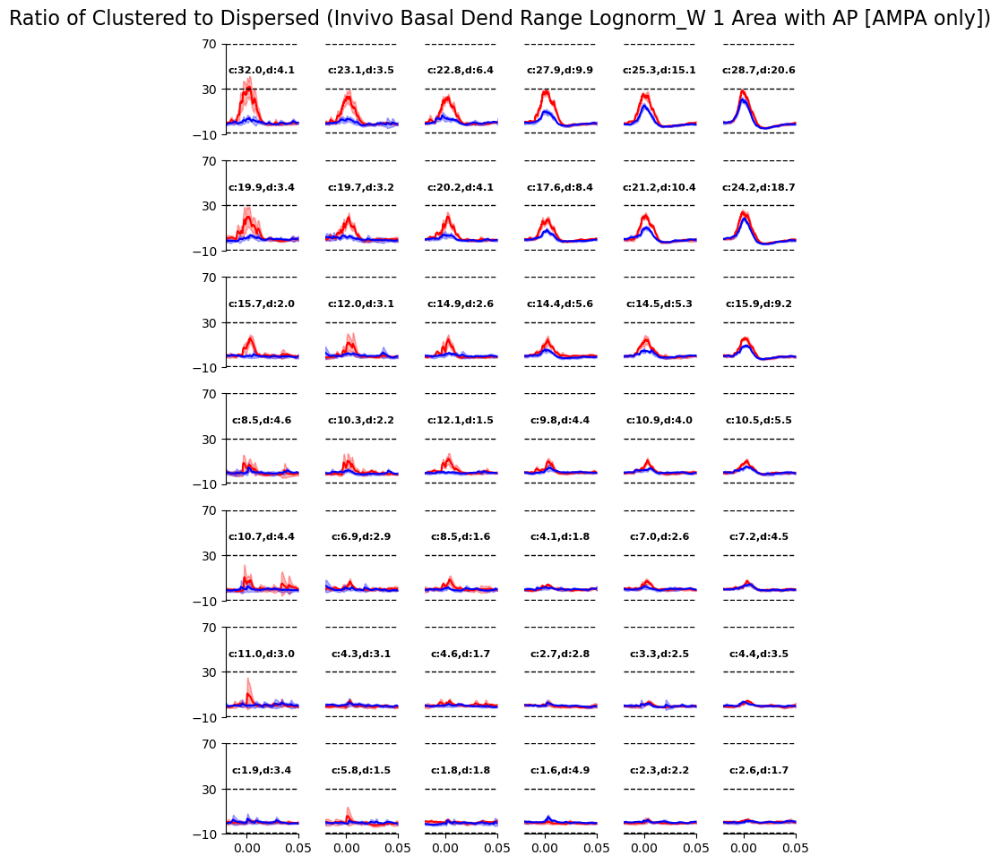

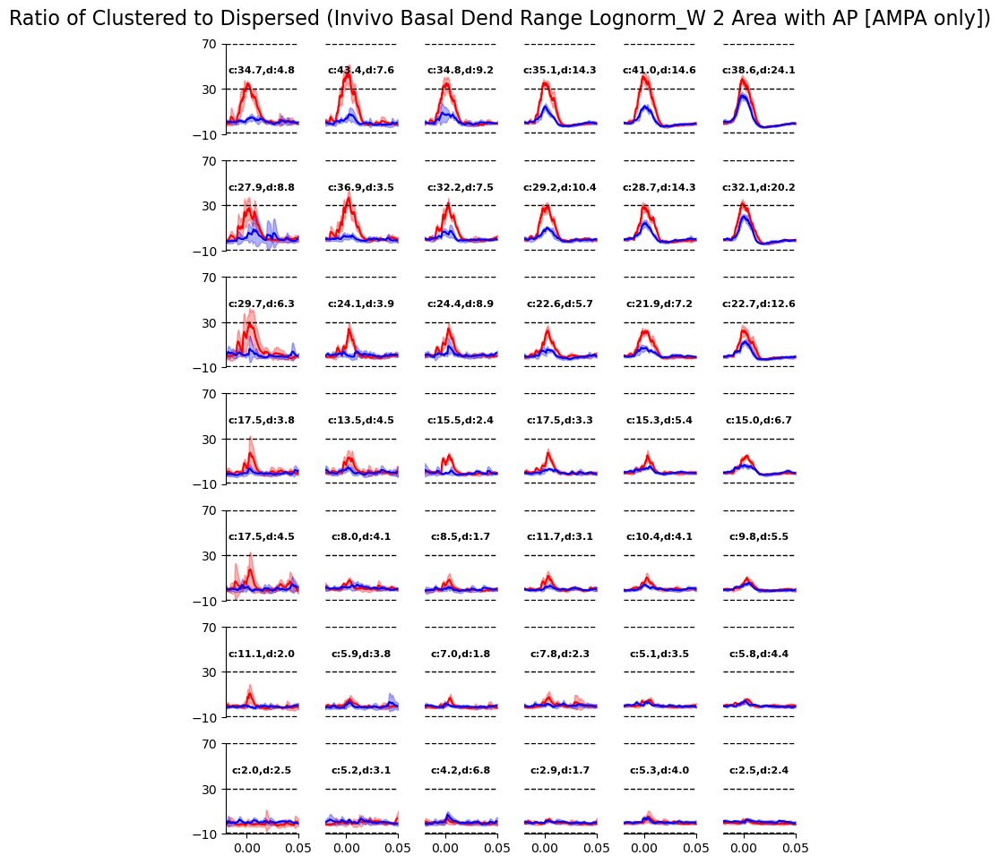

In [49]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_AMPAonly_withAP', 'distr_invivo_variedW_AMPAonly_withAP', 'basal', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Basal Dend Range Lognorm_W {range_idx} Area with AP [AMPA only])')

2.48e-02 1.05e+00
2.48e-02 1.35e-01
1.64e-02 6.73e-02
2.42e-02 1.03e+00
1.86e-02 1.90e-01
1.98e-02 7.35e-02


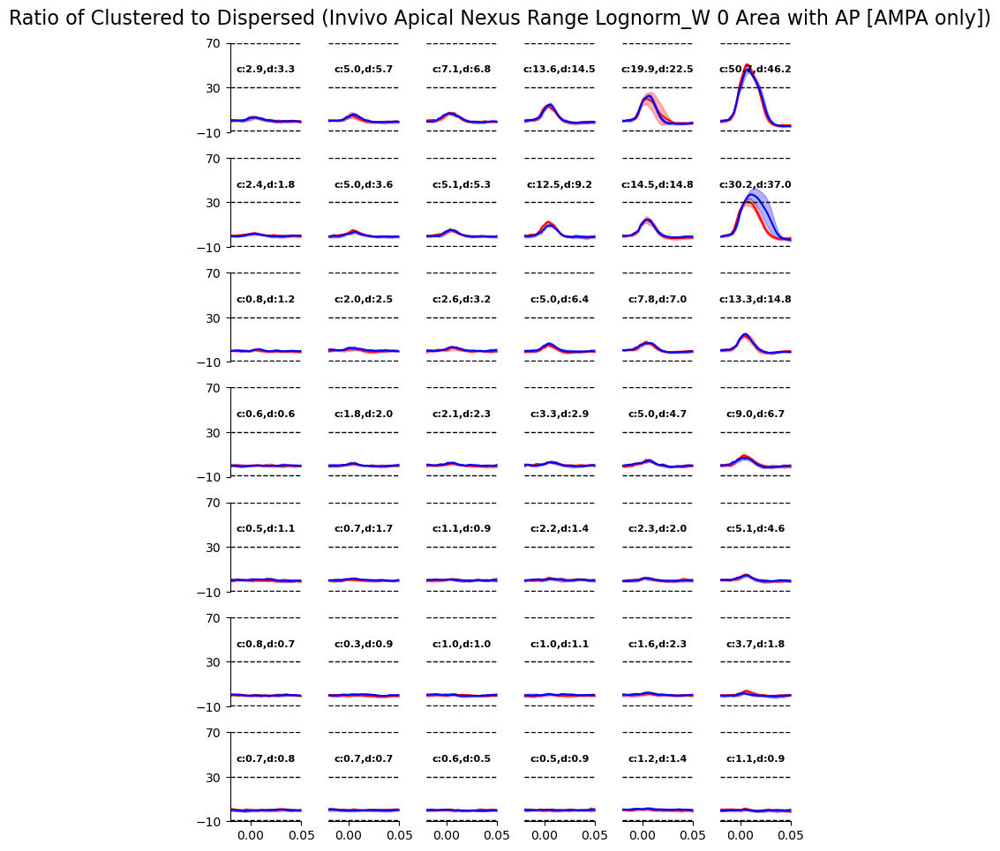

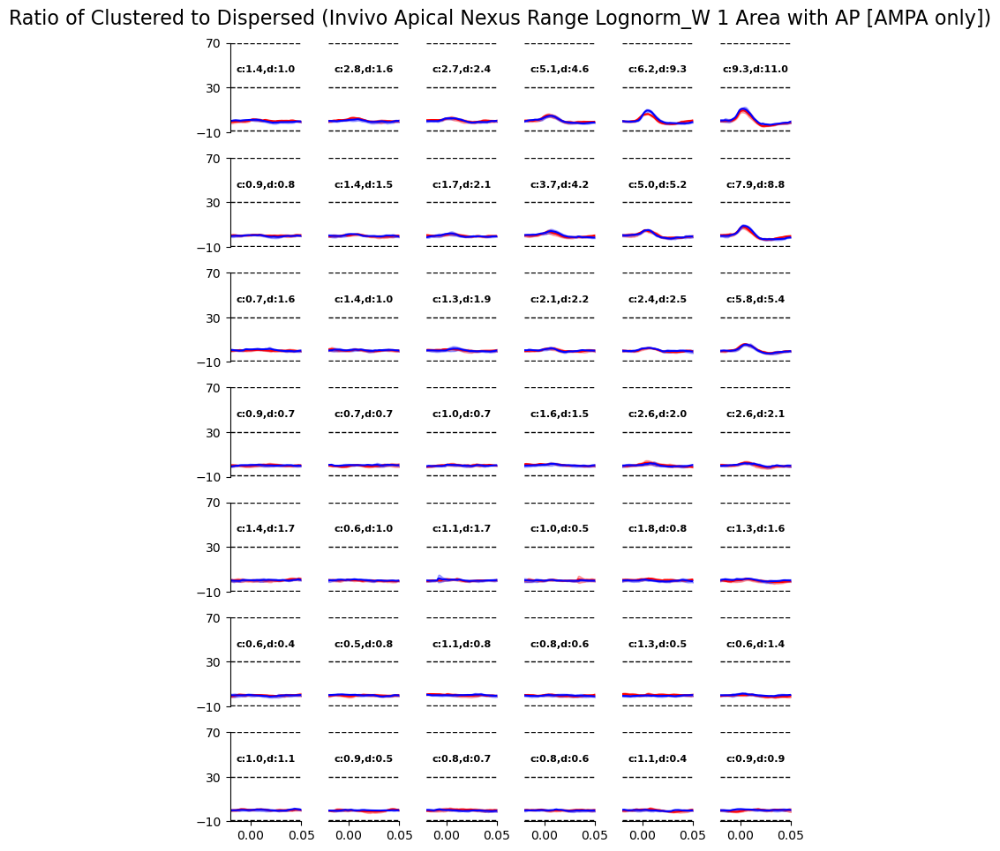

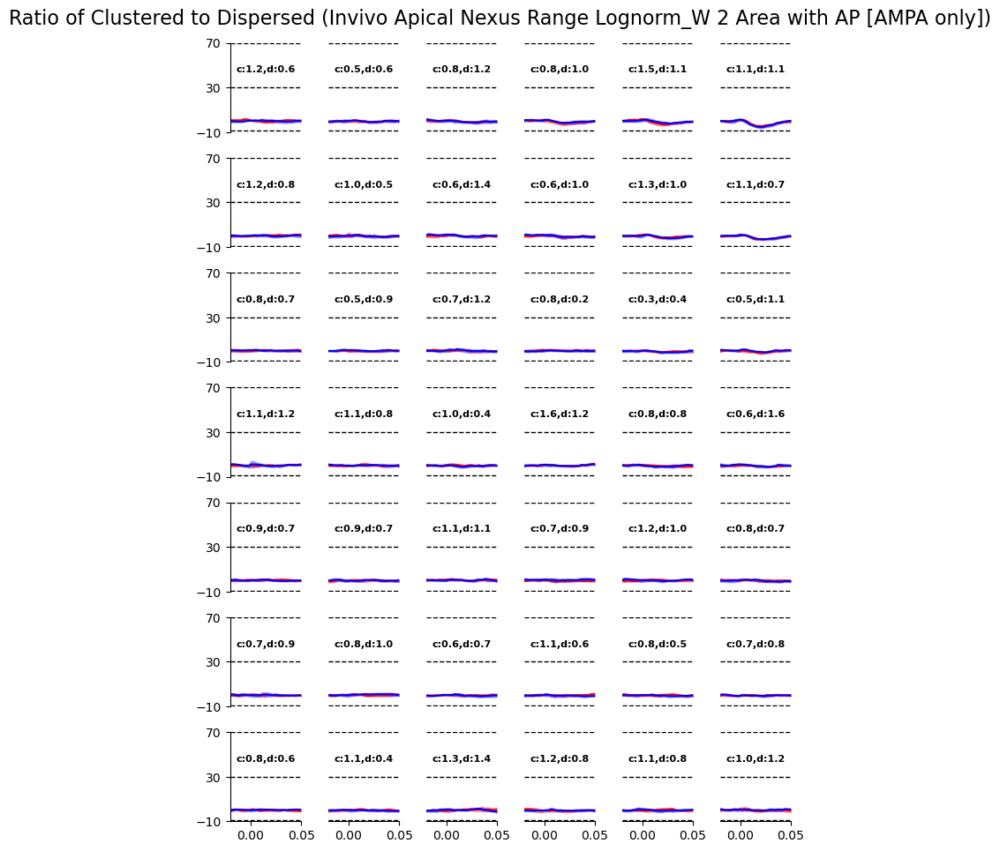

In [50]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_AMPAonly_withAP', 'distr_invivo_variedW_AMPAonly_withAP', 'apical', 'Nexus', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_nexus_root_v_0_area.flatten(), clus_nexus_root_v_1_area.flatten(), clus_nexus_root_v_2_area.flatten(), 
                                             distr_nexus_root_v_0_area.flatten(), distr_nexus_root_v_1_area.flatten(), distr_nexus_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Nexus Range Lognorm_W {range_idx} Area with AP [AMPA only])')

4.88e-02 1.22e+00
1.13e-01 7.62e-01
2.00e-01 9.05e-01
3.85e-02 1.26e+00
7.49e-02 7.75e-01
1.58e-01 9.44e-01


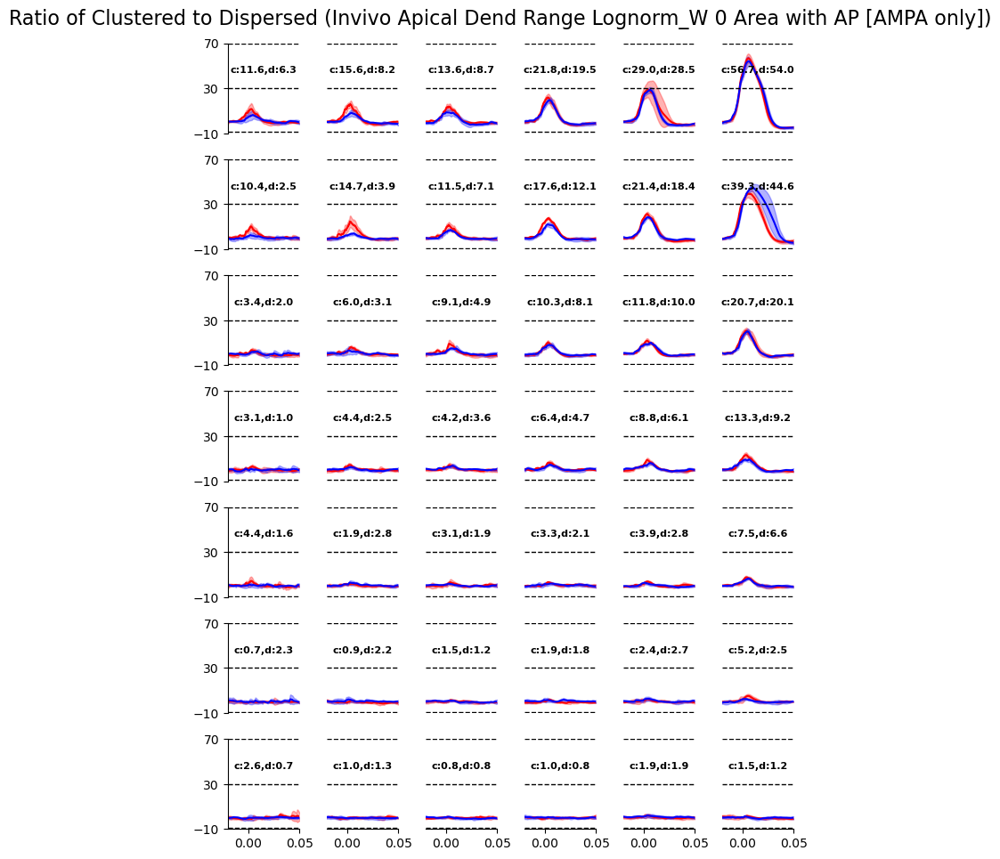

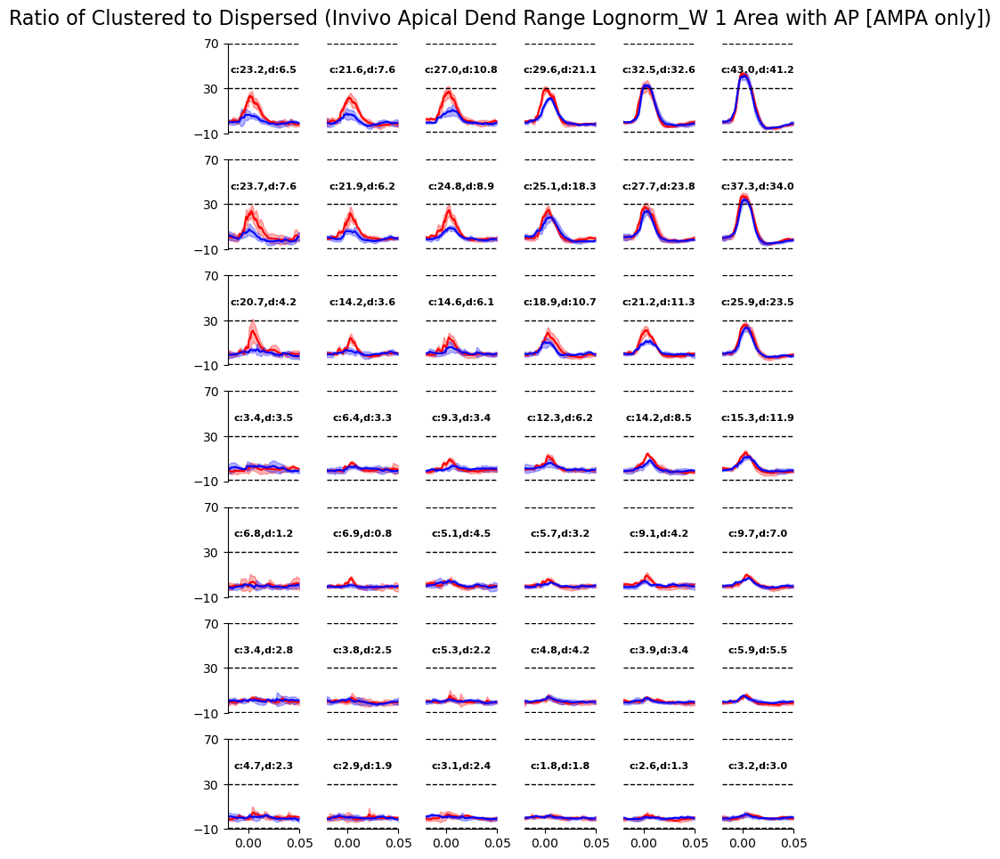

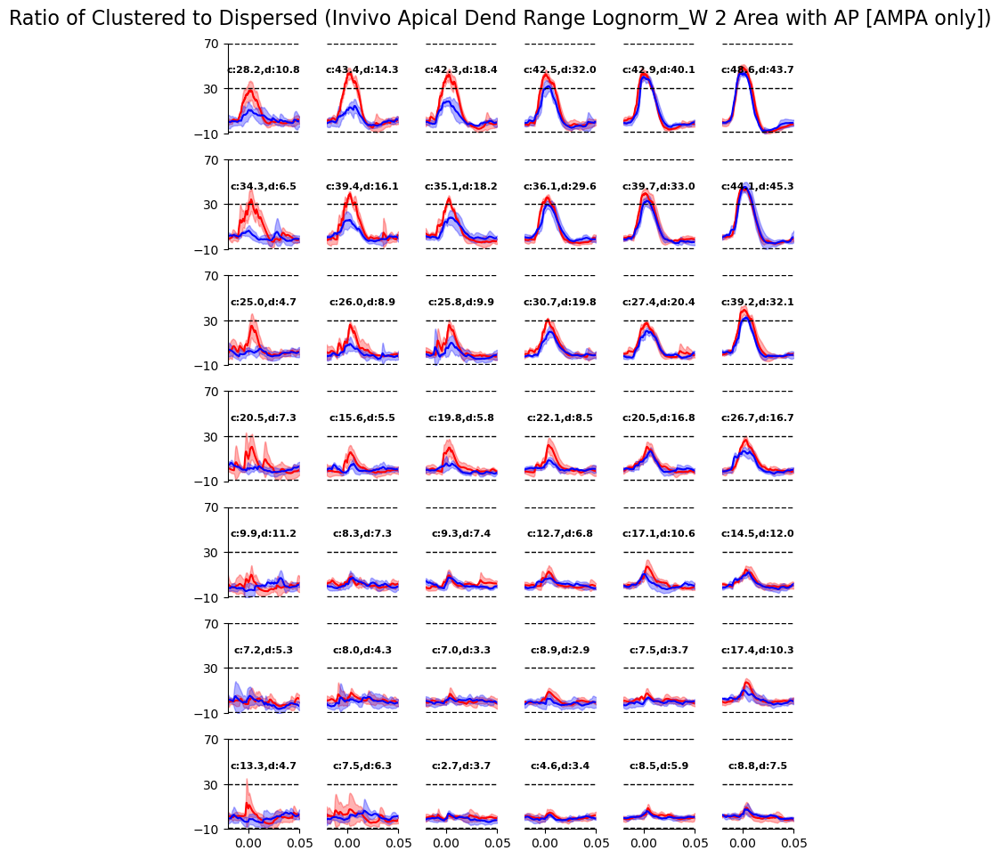

In [51]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo_variedW_AMPAonly_withAP', 'distr_invivo_variedW_AMPAonly_withAP', 'apical', 'Dend', 'Area')

all_root_v = [arr for arr in np.concatenate((clus_dend_root_v_0_area.flatten(), clus_dend_root_v_1_area.flatten(), clus_dend_root_v_2_area.flatten(), 
                                             distr_dend_root_v_0_area.flatten(), distr_dend_root_v_1_area.flatten(), distr_dend_root_v_2_area.flatten())) 
                                             if arr is not None]

root_v1_min = root_v2_min = min(np.min(arr) for arr in all_root_v)
root_v1_max = root_v2_max = max(np.max(arr) for arr in all_root_v)

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     root_v1_min, root_v1_max, root_v2_min, root_v2_max,
                                     f'(Invivo Apical Dend Range Lognorm_W {range_idx} Area with AP [AMPA only])')

#### NMDA vs non-NMDA

##### Clustered

0.09246996023883619 0.6236243154266193
0.03526772096591449 0.42049231984272606
0.0490234671962977 0.2738091565296412
0.035428436891718915 0.3417352077078929
0.03140945428852271 0.22256836978649988
0.029943112158661023 0.13226751694269998


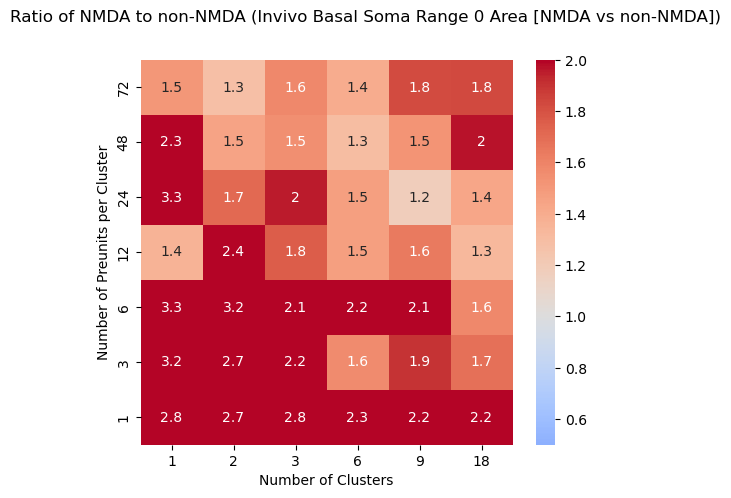

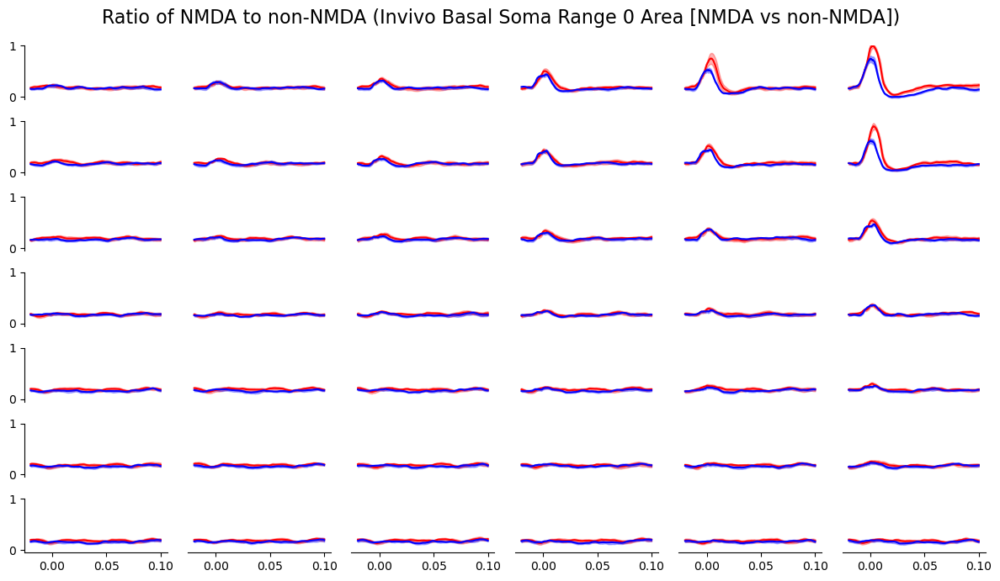

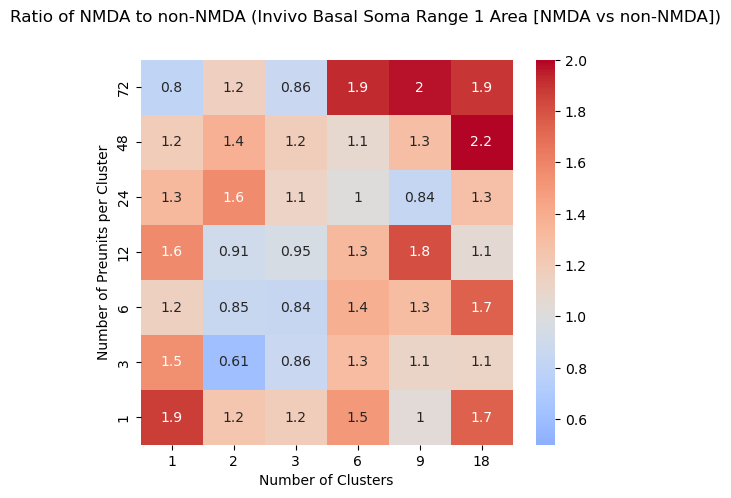

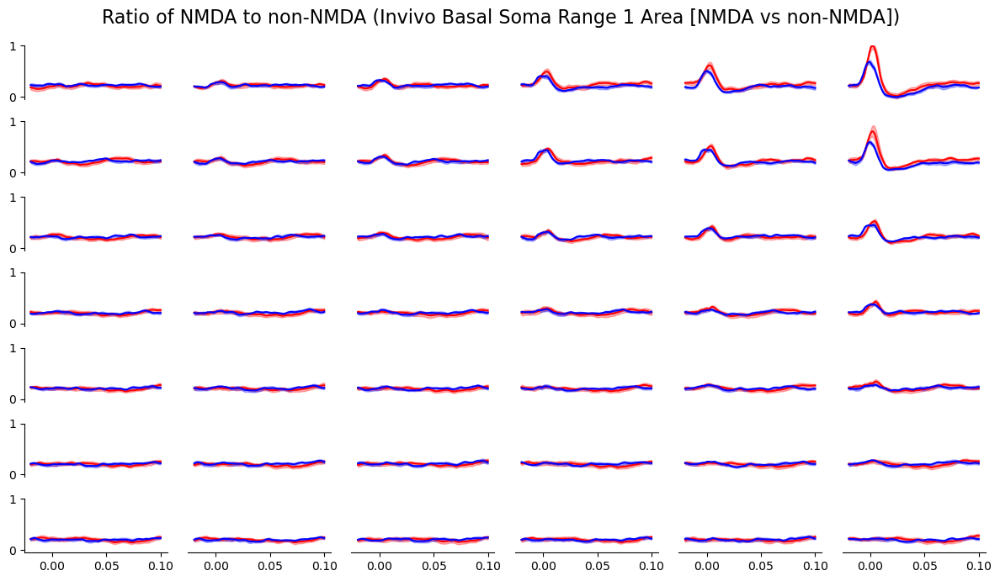

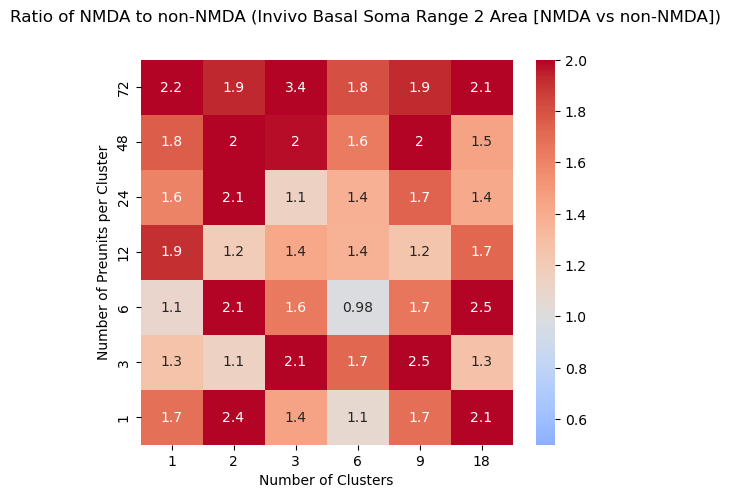

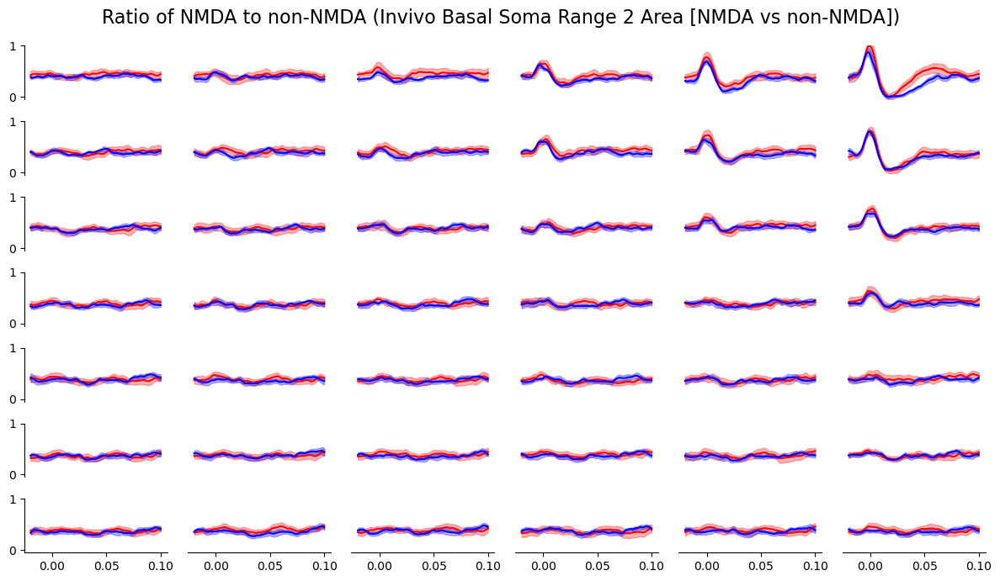

In [ ]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('clus_invivo', 'clus_invivo_AMPAonly', 'basal', 'Soma', 'Area')

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     f'(Invivo Clustered Basal Soma Range {range_idx} Area [NMDA vs non-NMDA])')

0.11190888940108079 0.7963783257703494
0.12479022836396422 1.2604762817318675
0.19863806855465702 2.5835094560727487
0.0554961517517885 0.47347234499990404
0.09345971710236338 0.698327549634795
0.16501528583789934 0.9796904776588115


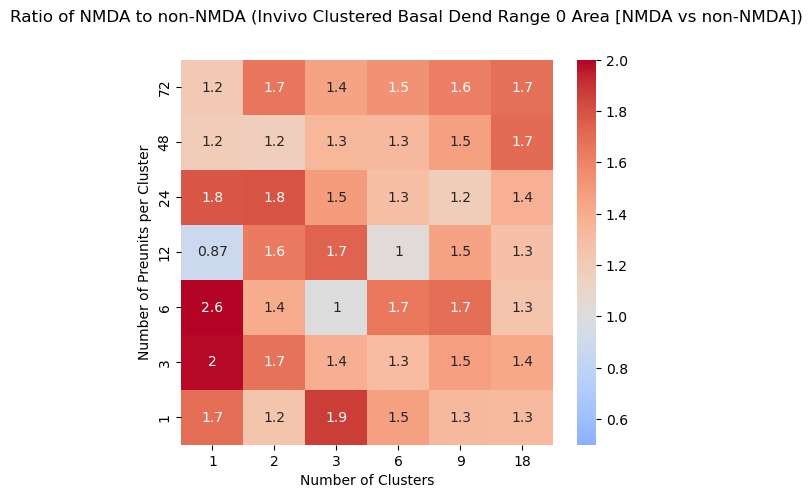

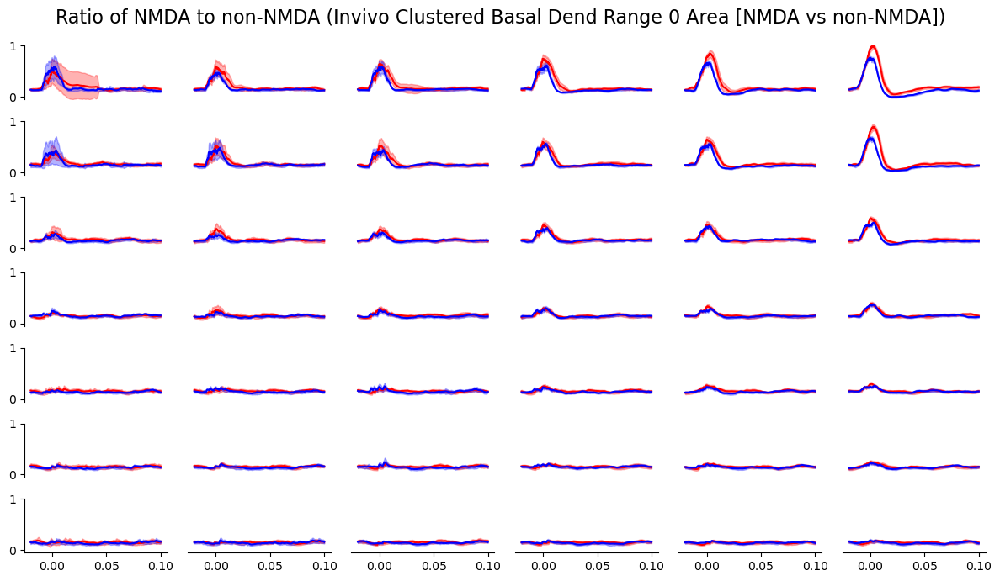

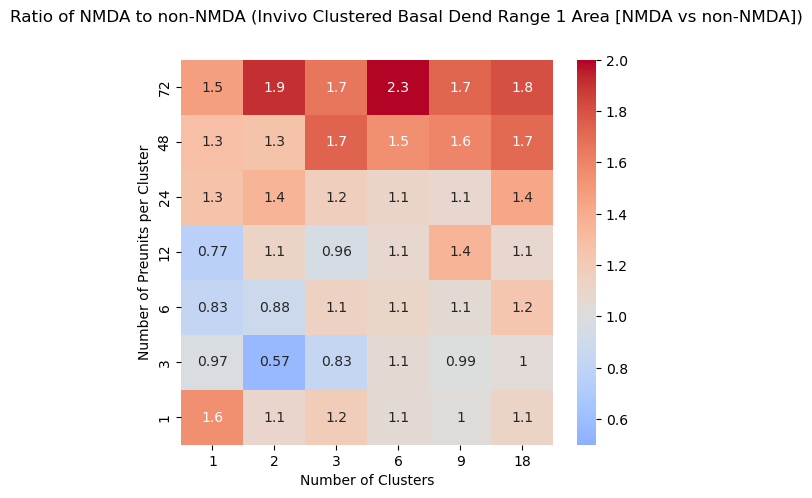

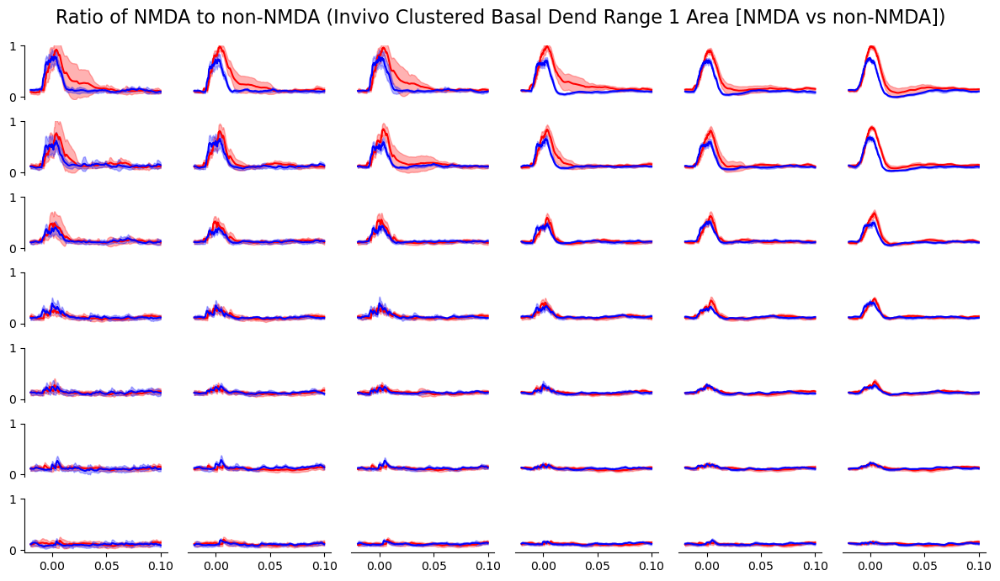

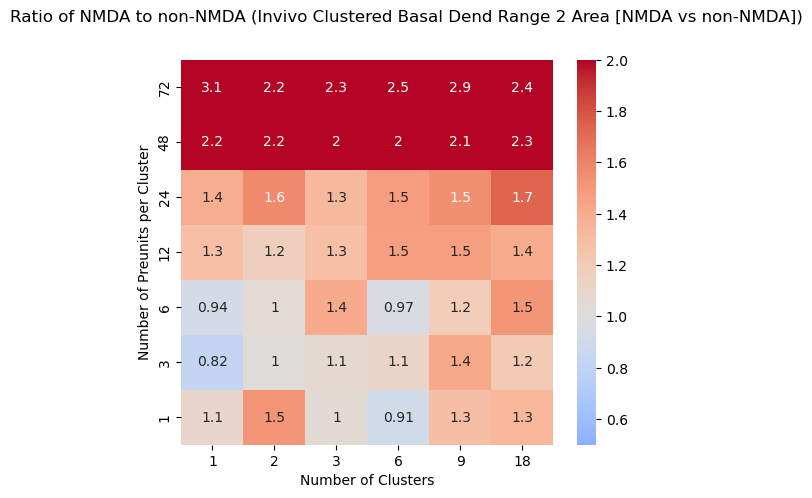

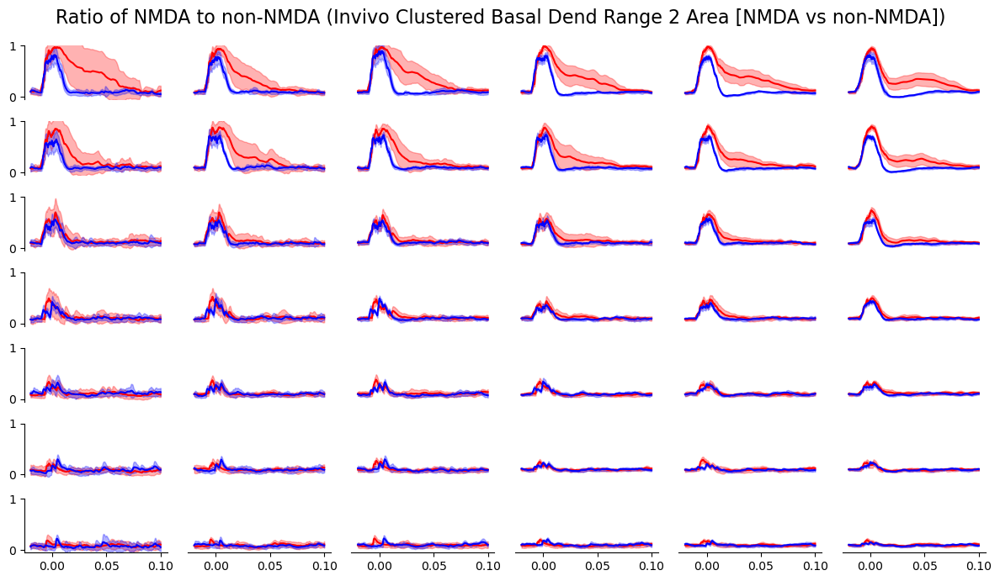

In [77]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo', 'clus_invivo_AMPAonly', 'basal', 'Dend', 'Area')

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     f'(Invivo Clustered Basal Dend Range {range_idx} Area [NMDA vs non-NMDA])')

0.09778510264402605 3.7177443184293155
0.1279658376301423 2.0247022713752942
0.13550694057359072 0.9432423629990101
0.015932802029808714 0.6511849772440589
0.011061046351025377 0.20981847397968006
0.012442197135623823 0.15595856089242727


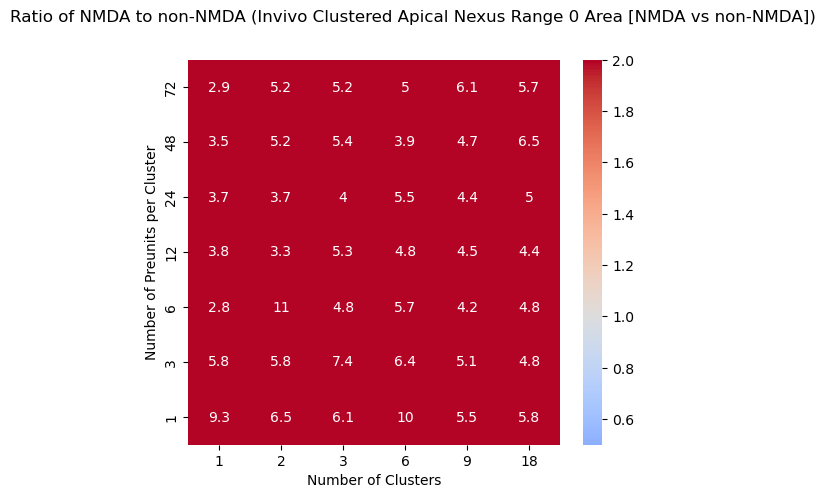

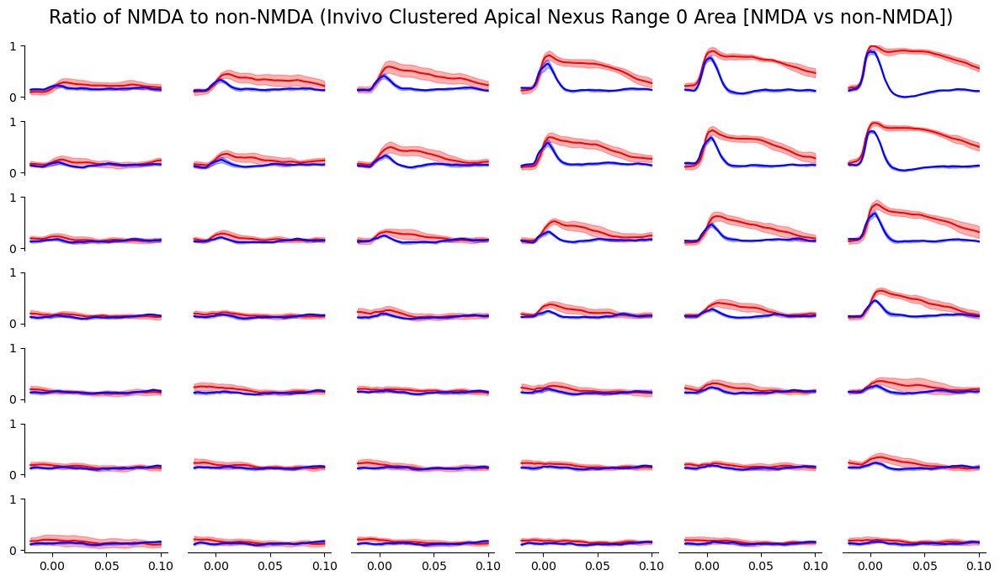

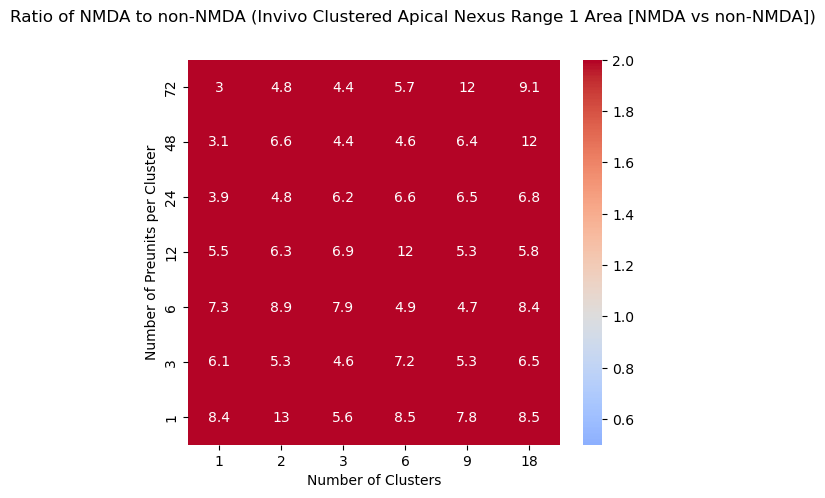

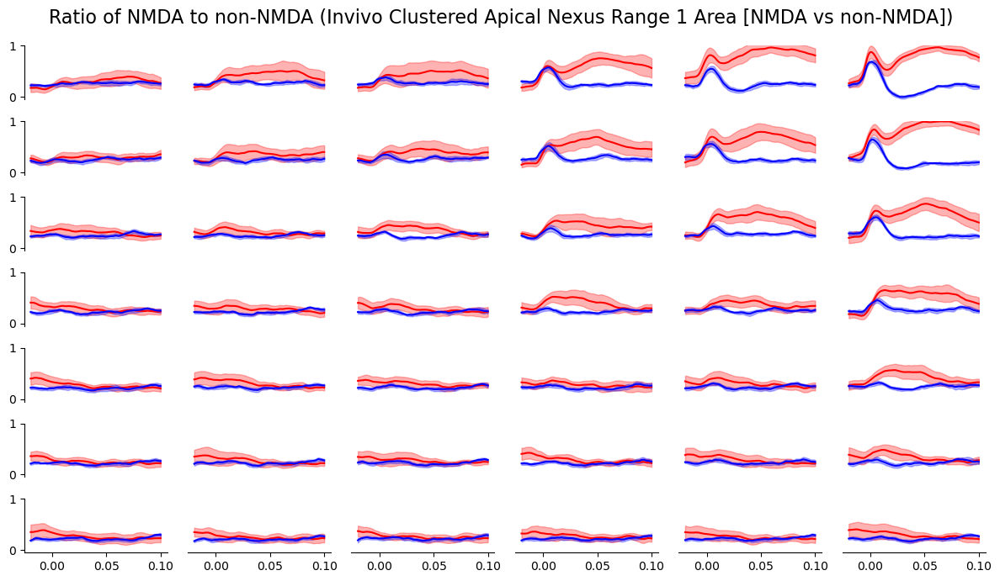

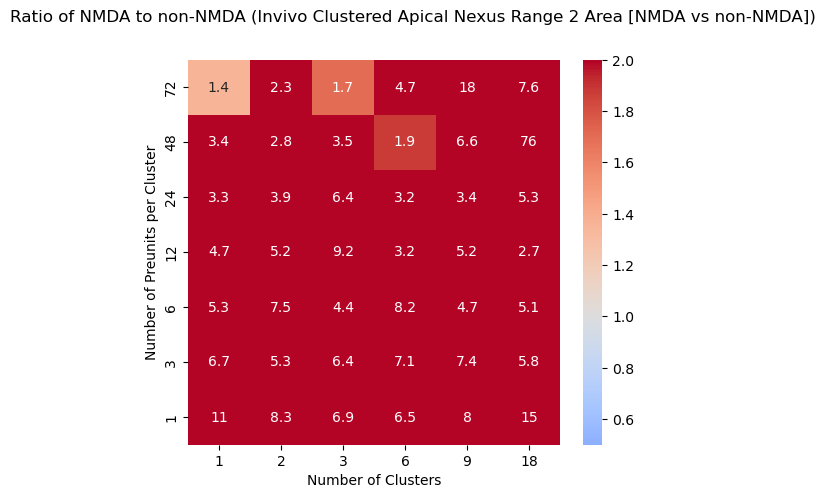

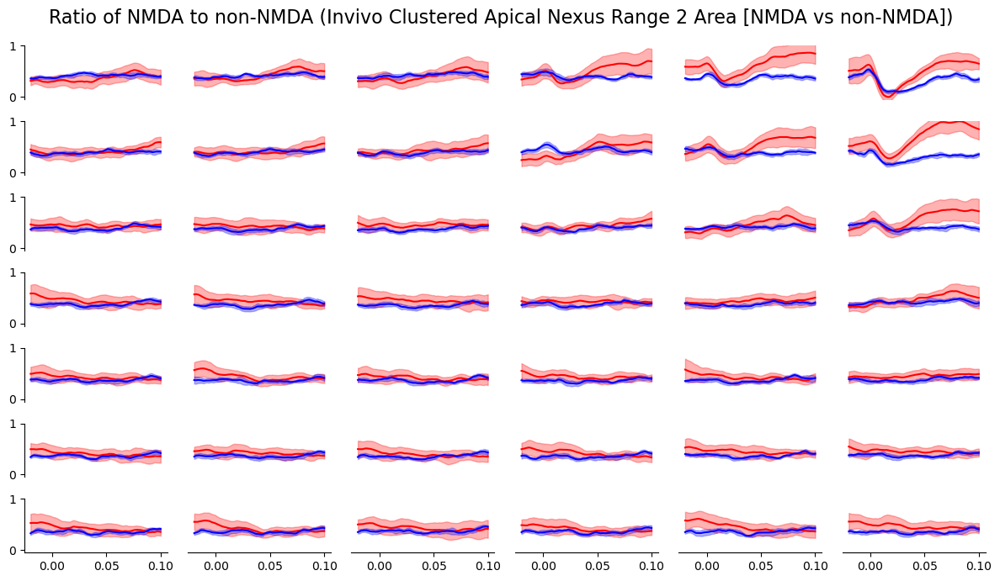

In [78]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('clus_invivo', 'clus_invivo_AMPAonly', 'apical', 'Nexus', 'Area')

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     f'(Invivo Clustered Apical Nexus Range {range_idx} Area [NMDA vs non-NMDA])')

0.17702584704319224 4.362497116561825
0.40948355058293745 4.087567584295189
0.7207453623478893 4.04556380443214
0.0537360540474124 0.8652191097813364
0.09598301076531451 0.9480531727931133
0.23136017845417714 1.1375278368506954


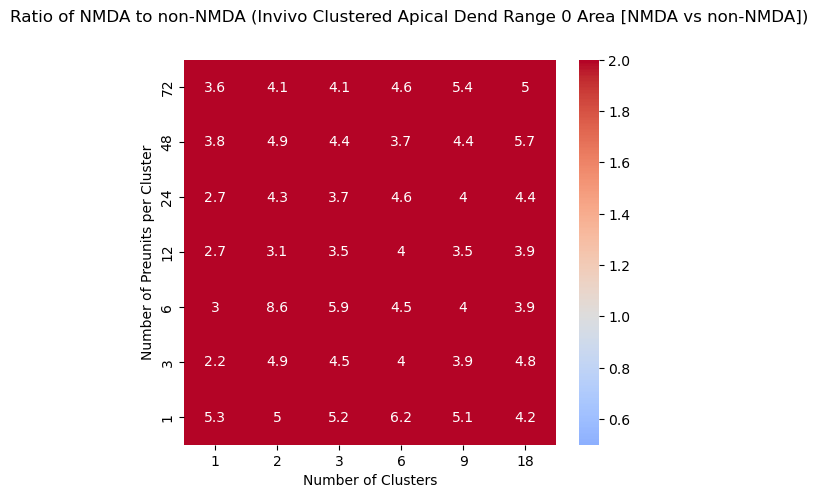

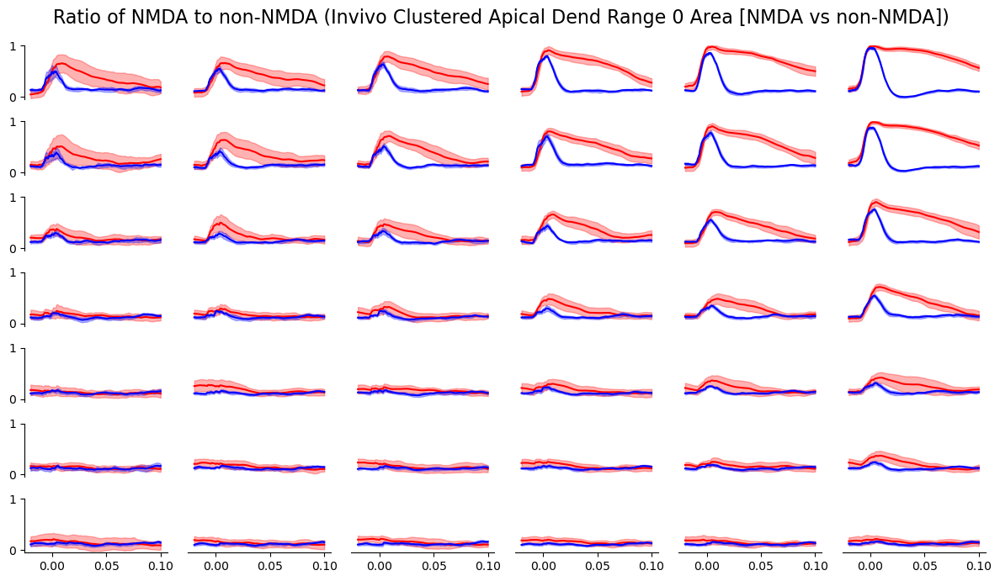

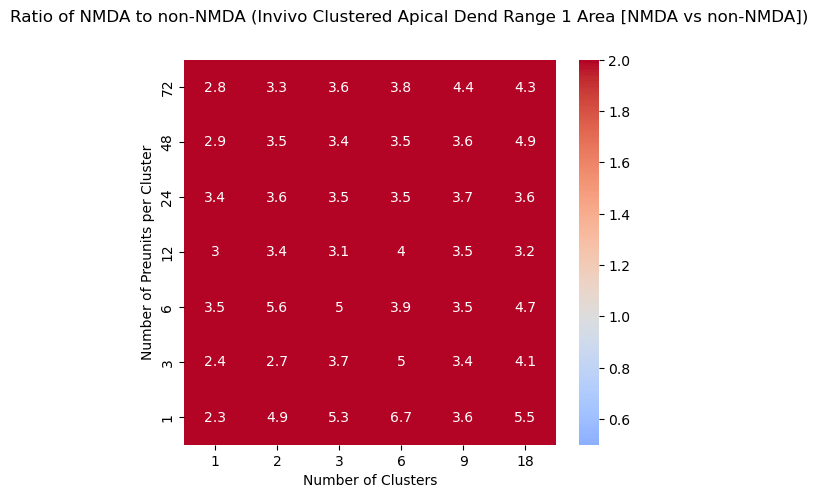

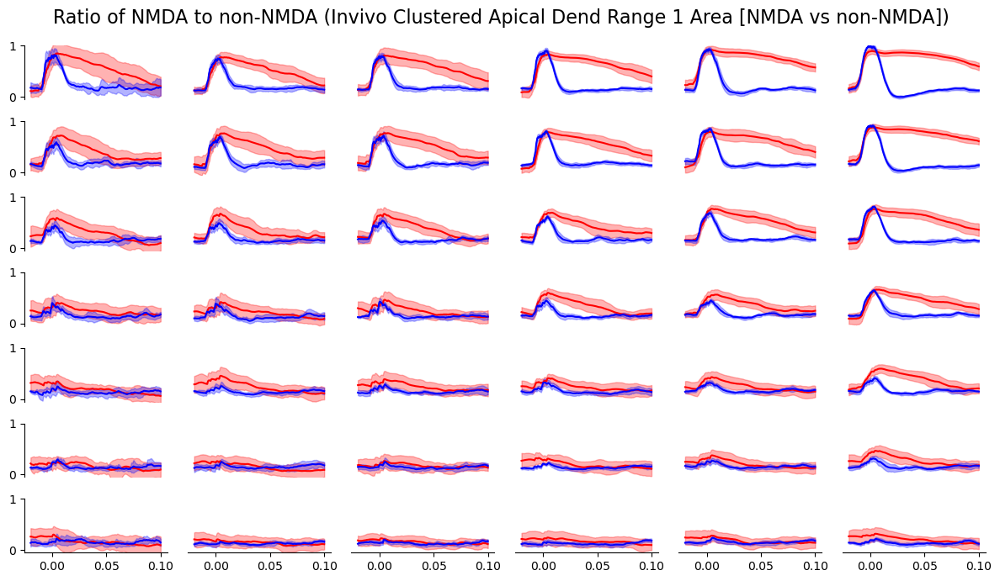

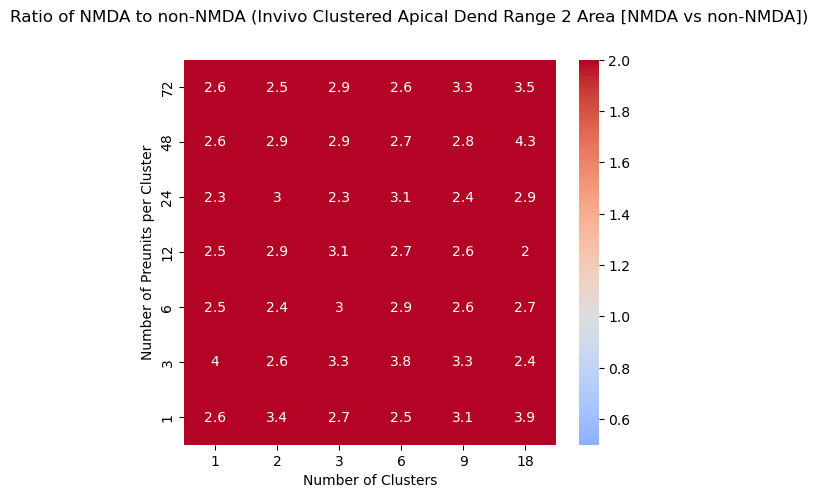

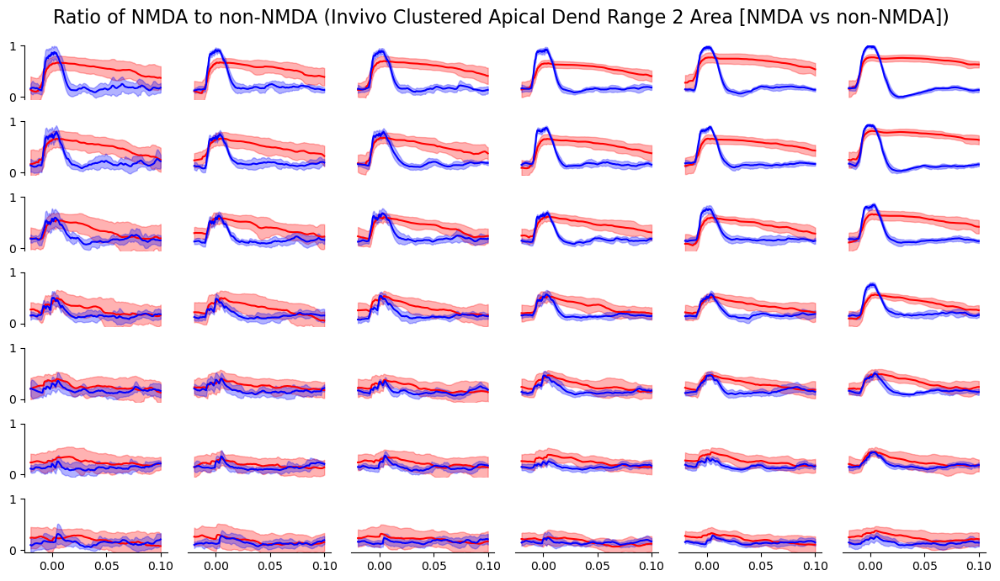

In [79]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('clus_invivo', 'clus_invivo_AMPAonly', 'apical', 'Dend', 'Area')

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     f'(Invivo Clustered Apical Dend Range {range_idx} Area [NMDA vs non-NMDA])')

##### Dispersed 

0.10155246956390362 0.5784696991640943
0.09285431681220024 0.42810435239368105
0.06753470731272751 0.23903113848449017
0.03400359373461532 0.4358699198426924
0.028763993800182845 0.2444687191305972
0.026785014591277034 0.1530643229784316


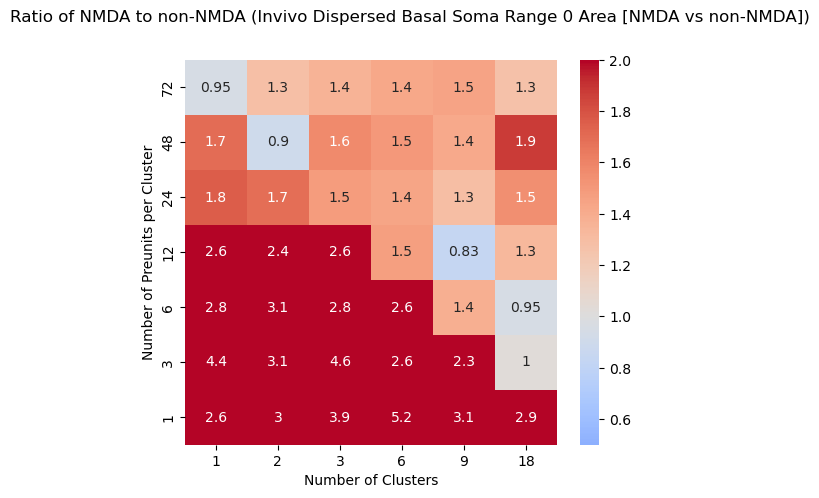

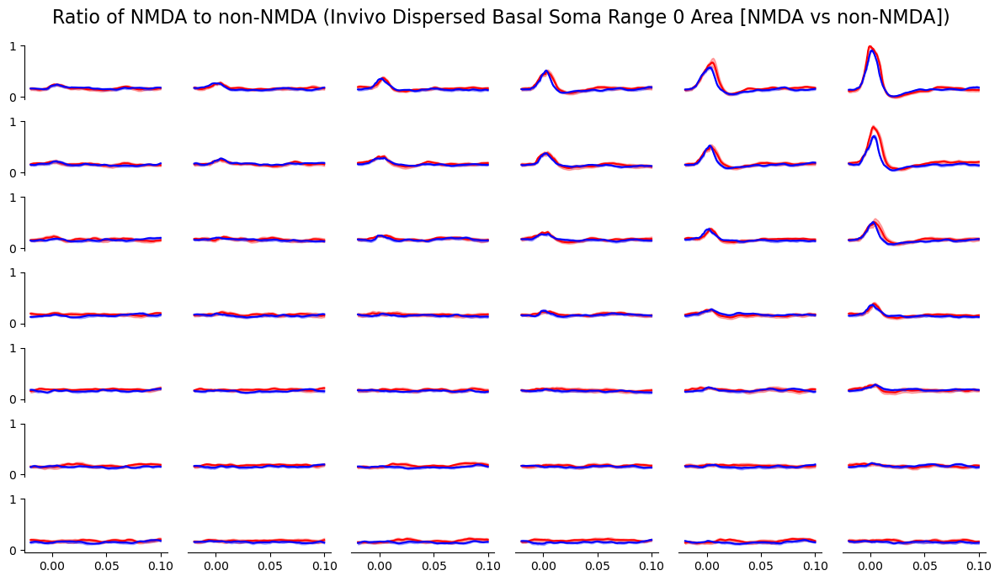

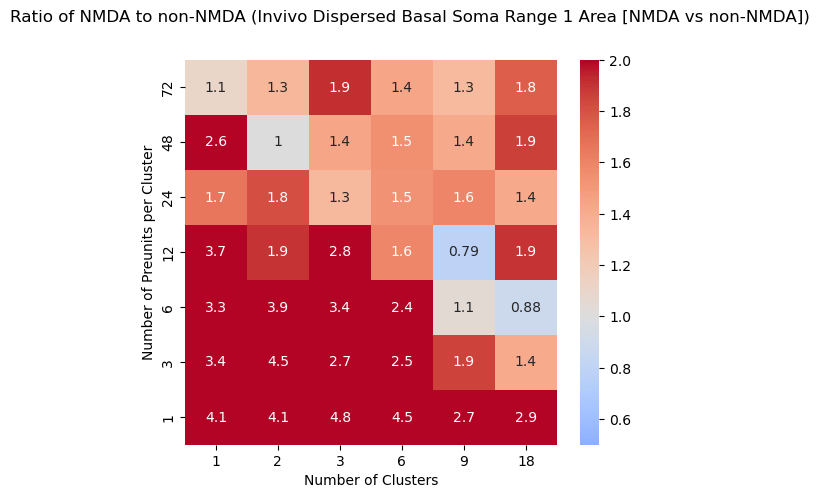

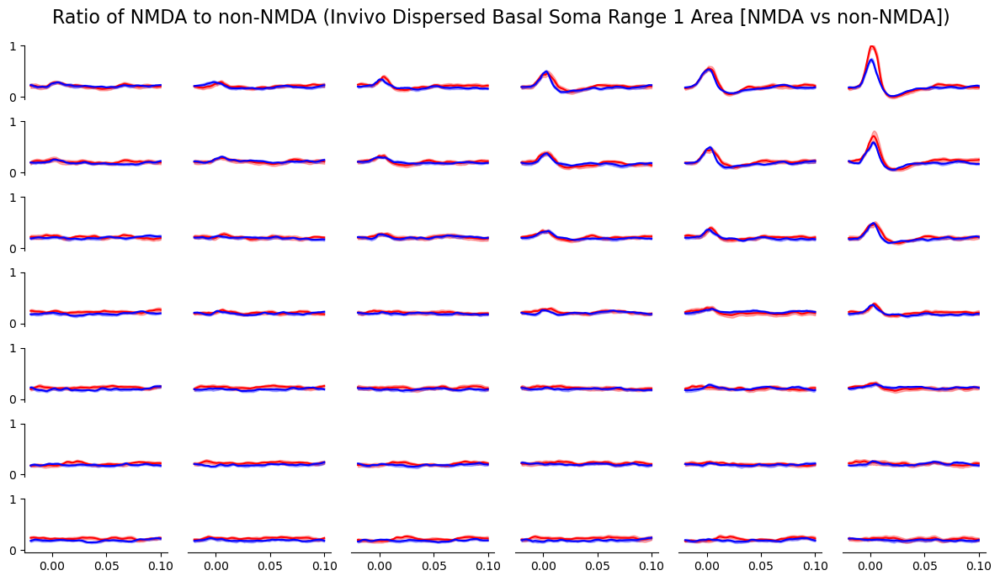

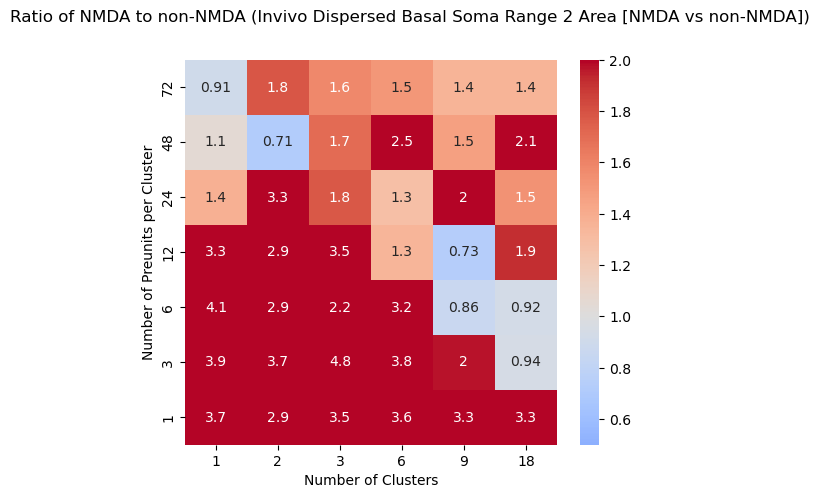

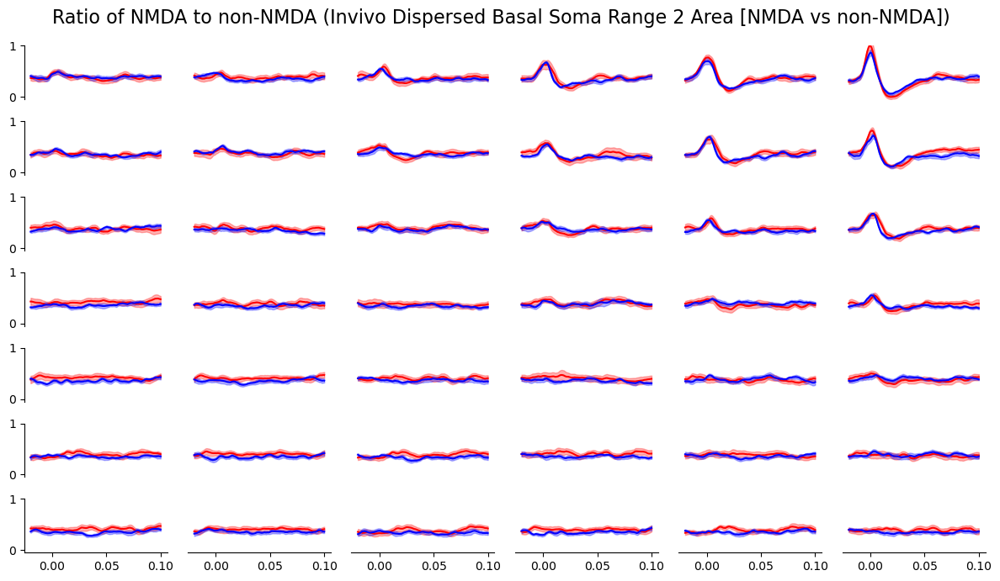

In [80]:
clus_soma_matrix_0_area, clus_soma_matrix_1_area, clus_soma_matrix_2_area, \
distr_soma_matrix_0_area, distr_soma_matrix_1_area, distr_soma_matrix_2_area, \
clus_soma_root_v_0_area, clus_soma_root_v_1_area, clus_soma_root_v_2_area, \
distr_soma_root_v_0_area, distr_soma_root_v_1_area, distr_soma_root_v_2_area, \
clus_soma_std_root_v_0_area, clus_soma_std_root_v_1_area, clus_soma_std_root_v_2_area, \
distr_soma_std_root_v_0_area, distr_soma_std_root_v_1_area, distr_soma_std_root_v_2_area = full_analyze_case('distr_invivo', 'distr_invivo_AMPAonly', 'basal', 'Soma', 'Area')

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_soma_matrix_{range_idx}_area'], globals()[f'distr_soma_matrix_{range_idx}_area'], 
                                     globals()[f'clus_soma_root_v_{range_idx}_area'], globals()[f'distr_soma_root_v_{range_idx}_area'], 
                                     globals()[f'clus_soma_std_root_v_{range_idx}_area'], globals()[f'distr_soma_std_root_v_{range_idx}_area'], 
                                     f'(Invivo Dispersed Basal Soma Range {range_idx} Area [NMDA vs non-NMDA])')

0.1315664700244881 0.5931508249193197
0.16199495499893773 0.6426793276513302
0.22032762042641202 0.8686759390551655
0.05581992407000086 0.4774346318557904
0.10052943832015271 0.4367576488643431
0.15099031354683376 0.6216571685541284


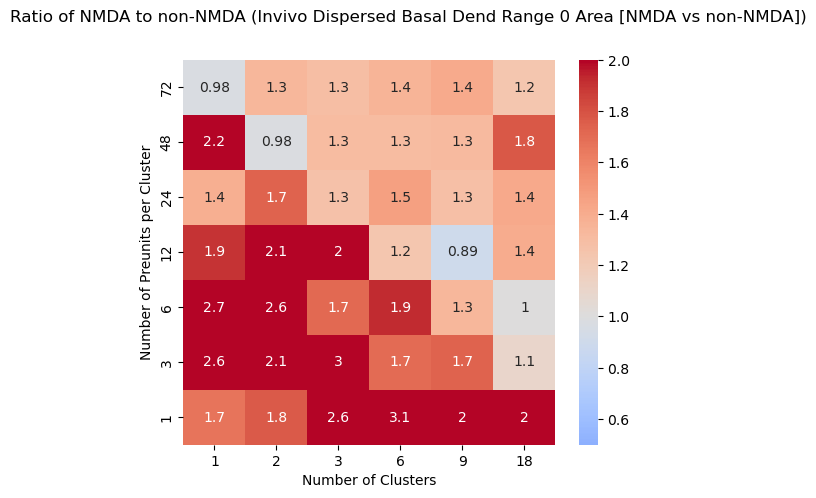

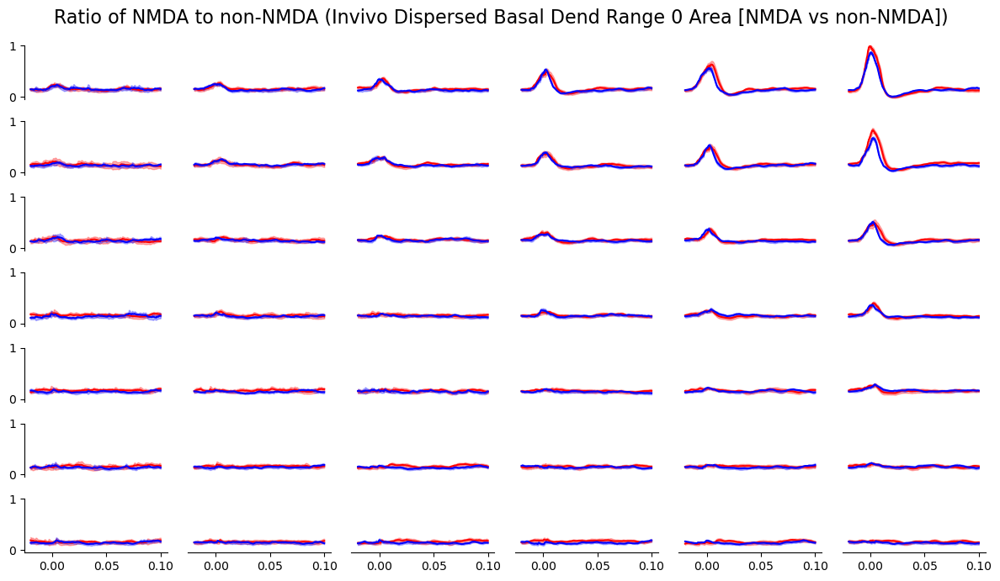

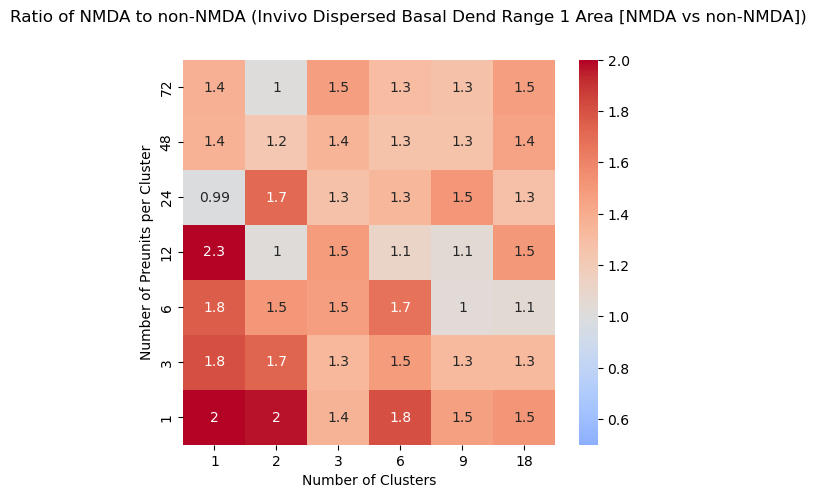

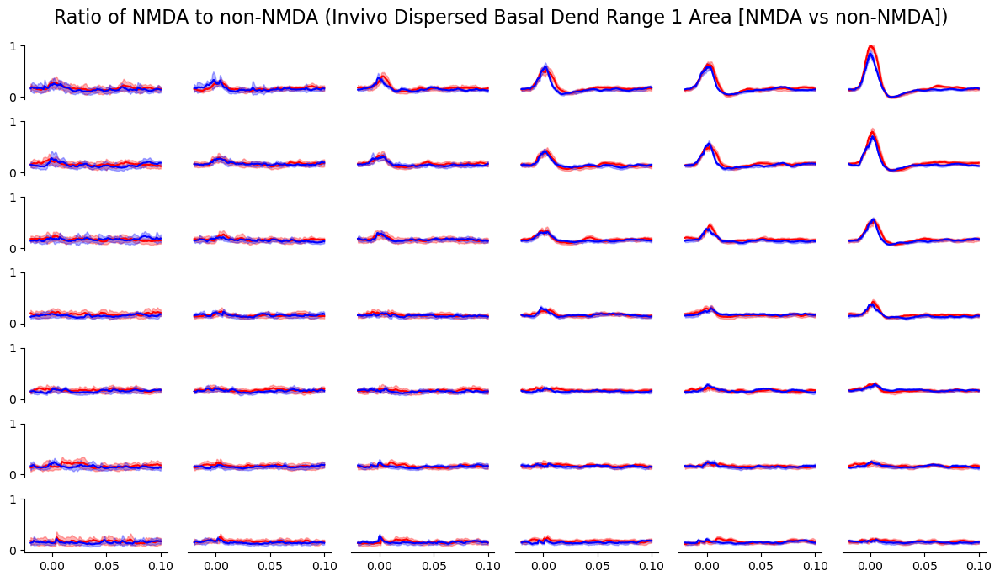

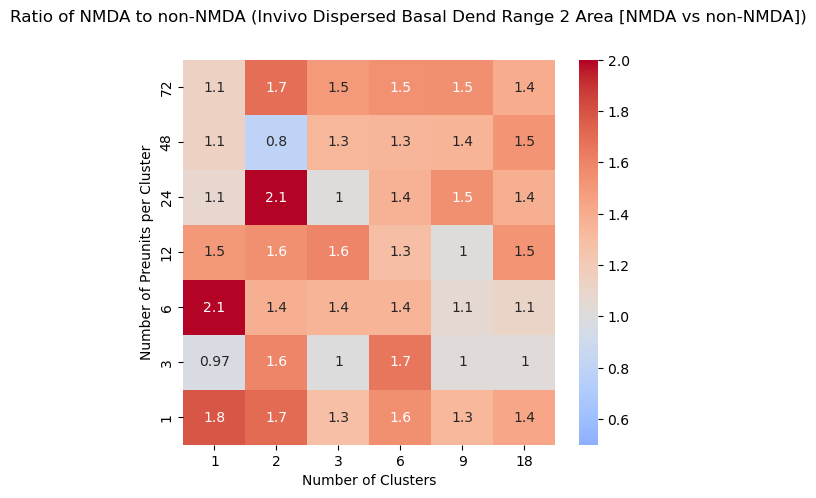

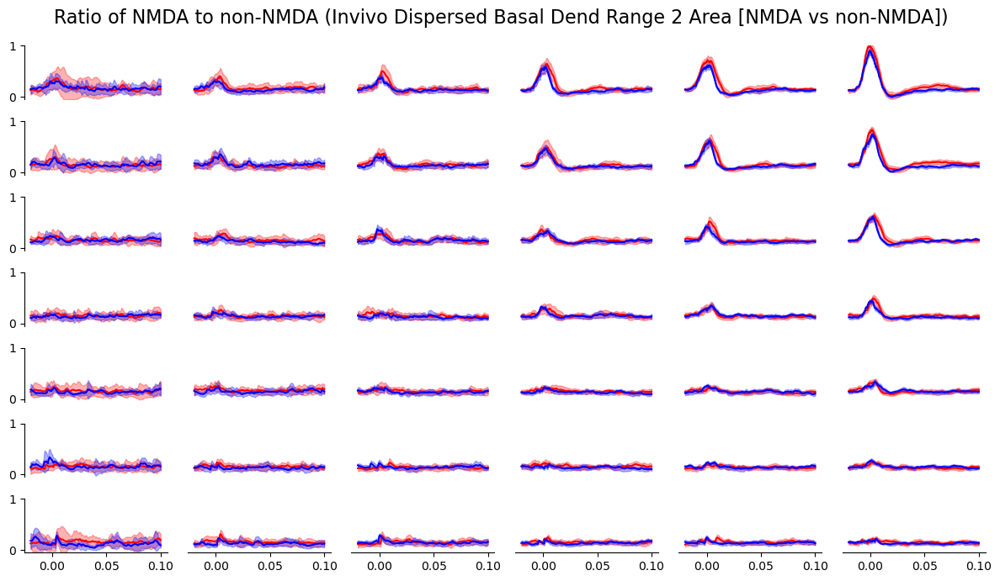

In [81]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('distr_invivo', 'distr_invivo_AMPAonly', 'basal', 'Dend', 'Area')

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     f'(Invivo Dispersed Basal Dend Range {range_idx} Area [NMDA vs non-NMDA])')

0.037696007132452684 3.7155364246120657
0.020952472753208974 1.8476503850592336
0.10818638344928524 1.2528967244250384
0.011507900916492501 0.6755684023362264
0.011830018243266596 0.2880781358818526
0.015242112482241166 0.26324942624425524


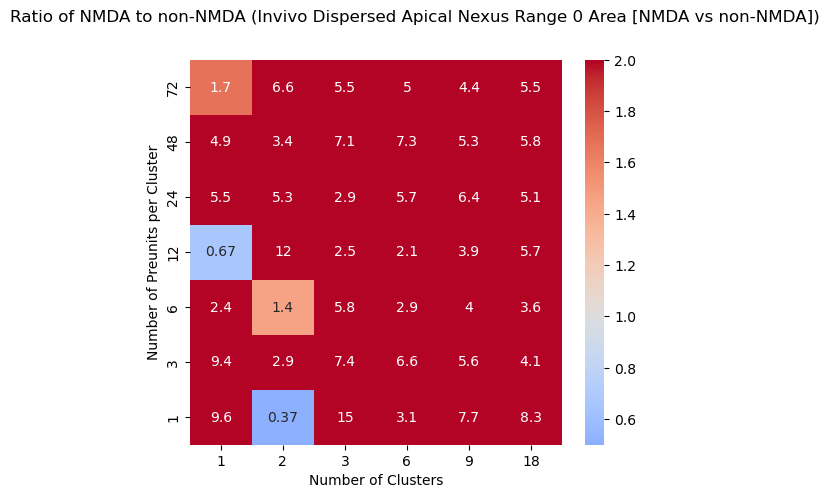

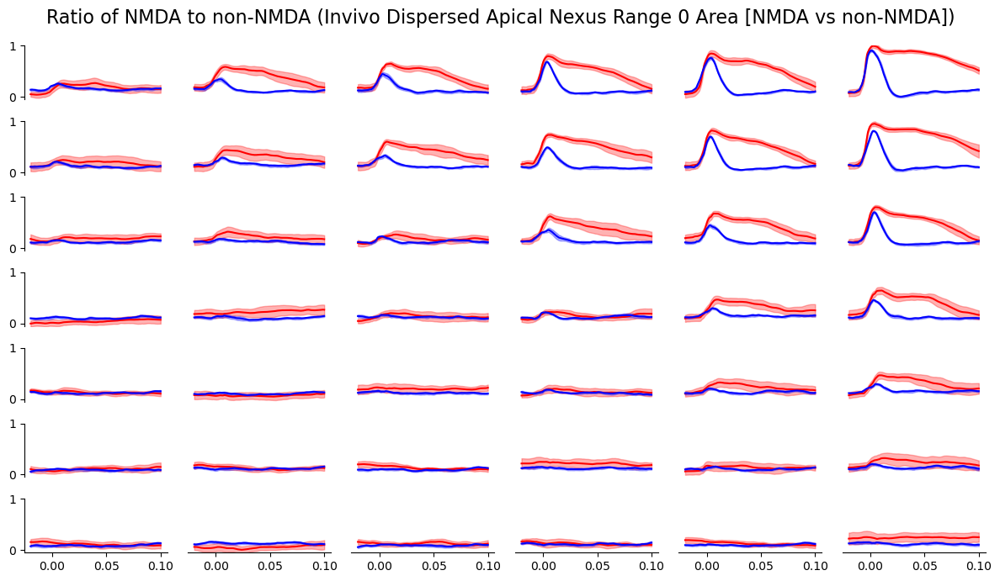

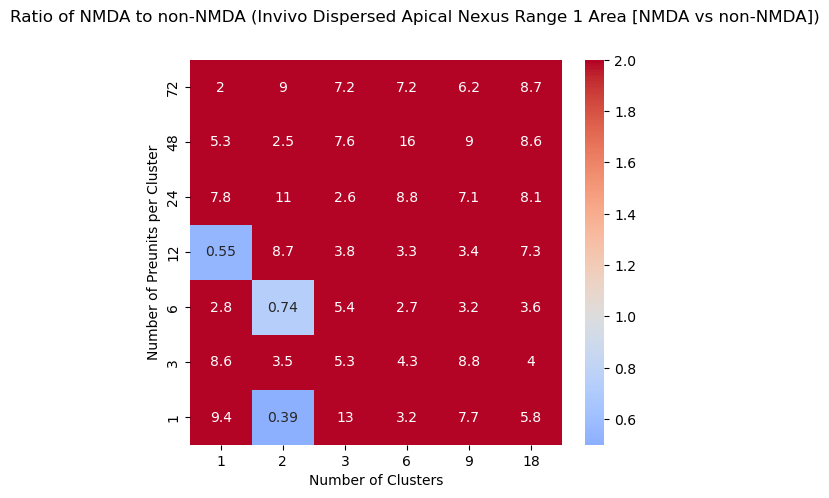

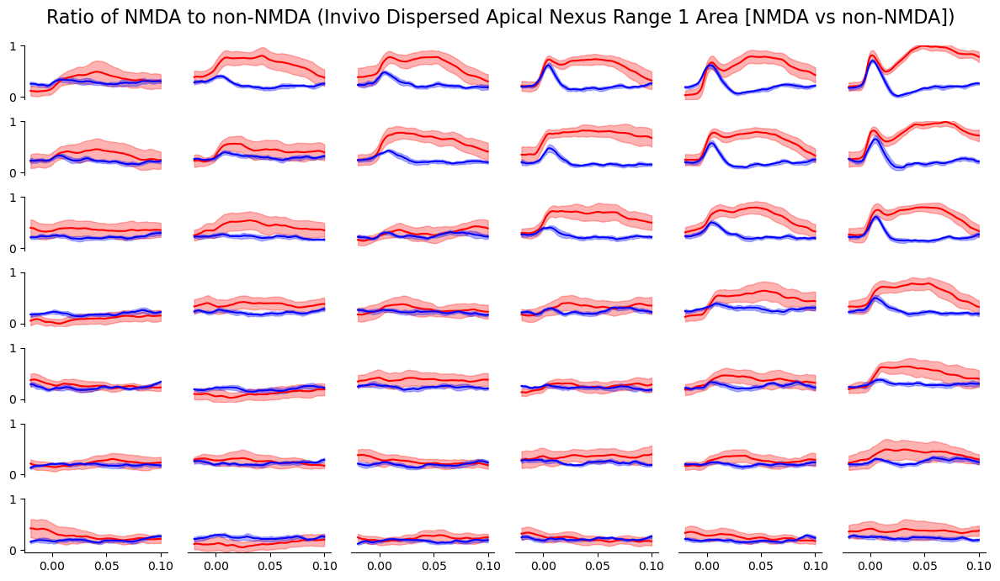

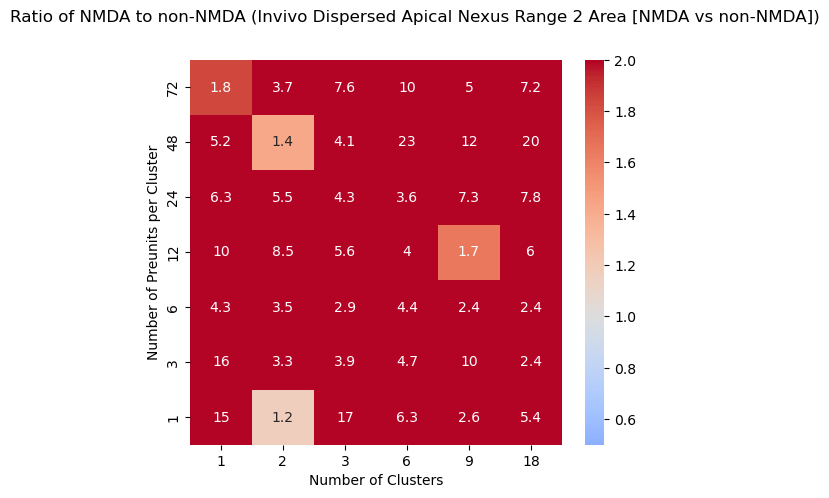

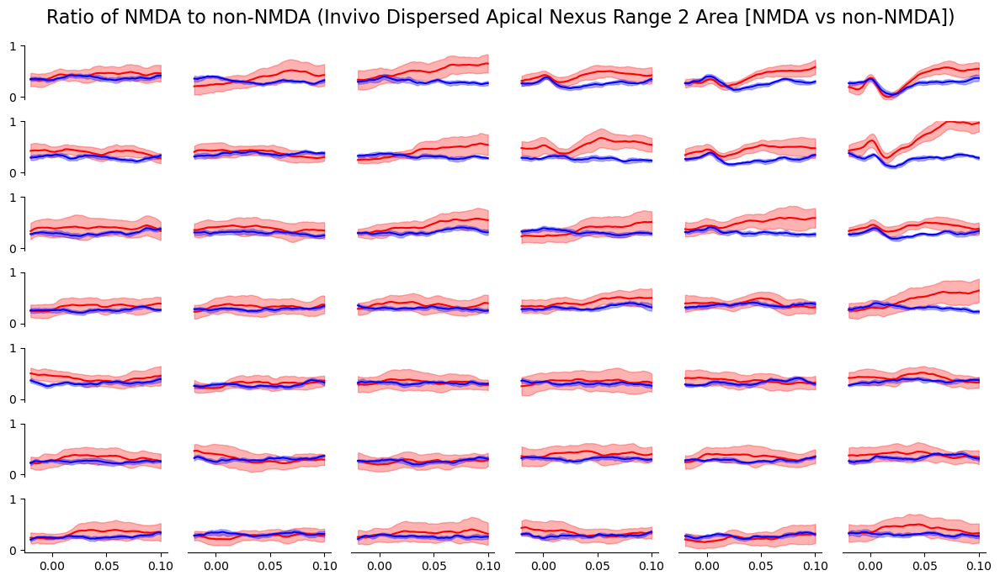

In [82]:
clus_nexus_matrix_0_area, clus_nexus_matrix_1_area, clus_nexus_matrix_2_area, \
distr_nexus_matrix_0_area, distr_nexus_matrix_1_area, distr_nexus_matrix_2_area, \
clus_nexus_root_v_0_area, clus_nexus_root_v_1_area, clus_nexus_root_v_2_area, \
distr_nexus_root_v_0_area, distr_nexus_root_v_1_area, distr_nexus_root_v_2_area, \
clus_nexus_std_root_v_0_area, clus_nexus_std_root_v_1_area, clus_nexus_std_root_v_2_area, \
distr_nexus_std_root_v_0_area, distr_nexus_std_root_v_1_area, distr_nexus_std_root_v_2_area = full_analyze_case('distr_invivo', 'distr_invivo_AMPAonly', 'apical', 'Nexus', 'Area')

for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_nexus_matrix_{range_idx}_area'], globals()[f'distr_nexus_matrix_{range_idx}_area'], 
                                     globals()[f'clus_nexus_root_v_{range_idx}_area'], globals()[f'distr_nexus_root_v_{range_idx}_area'], 
                                     globals()[f'clus_nexus_std_root_v_{range_idx}_area'], globals()[f'distr_nexus_std_root_v_{range_idx}_area'], 
                                     f'(Invivo Dispersed Apical Nexus Range {range_idx} Area [NMDA vs non-NMDA])')

0.09130773089230432 4.291576339052001
0.22684138012423366 4.1089605878189275
0.5707813440881566 4.122860033560317
0.0296610352289177 0.8689620571049609
0.12436392448605668 0.9329802328310572
0.17119983609001505 1.1298267487943545


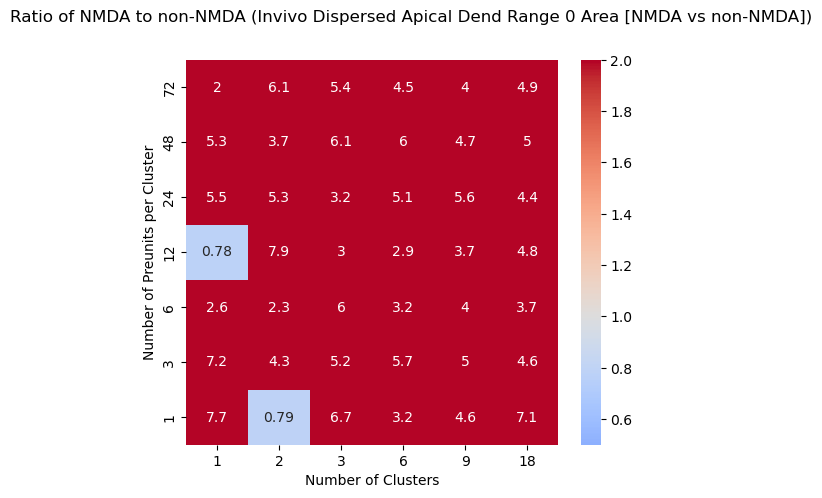

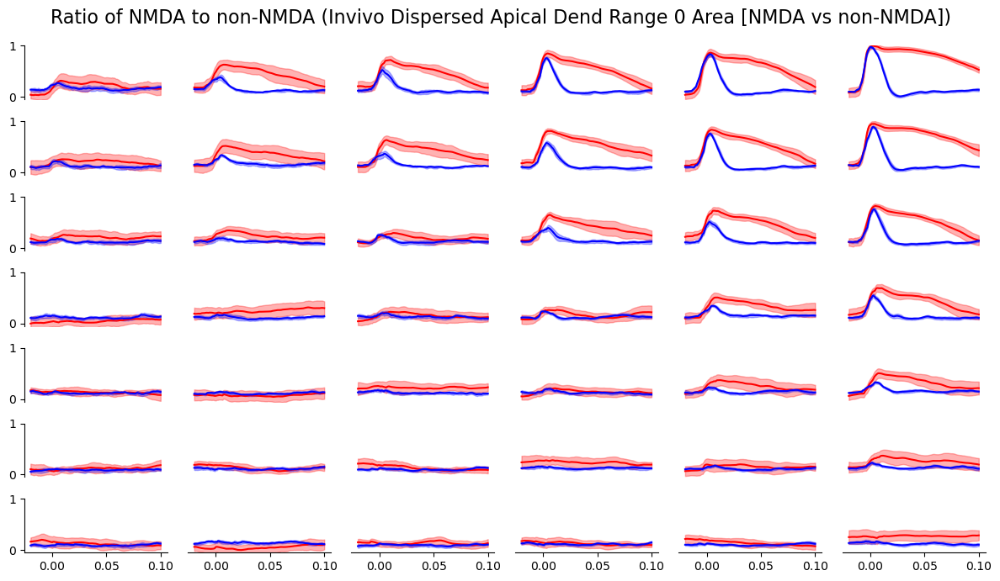

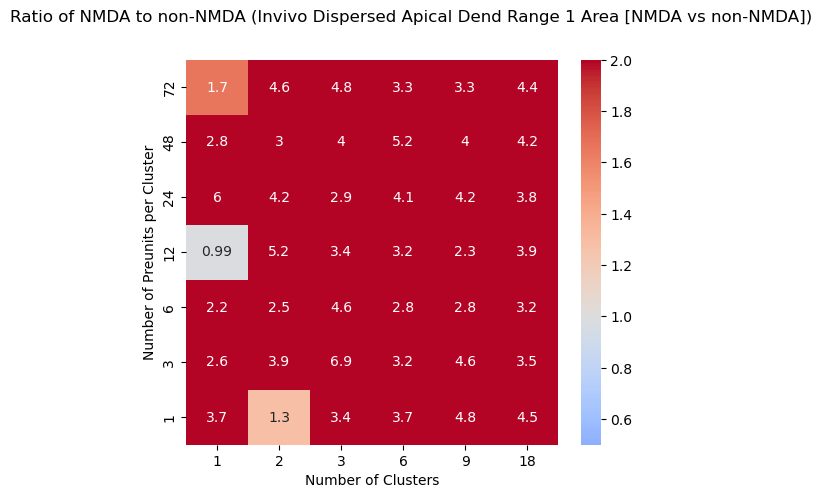

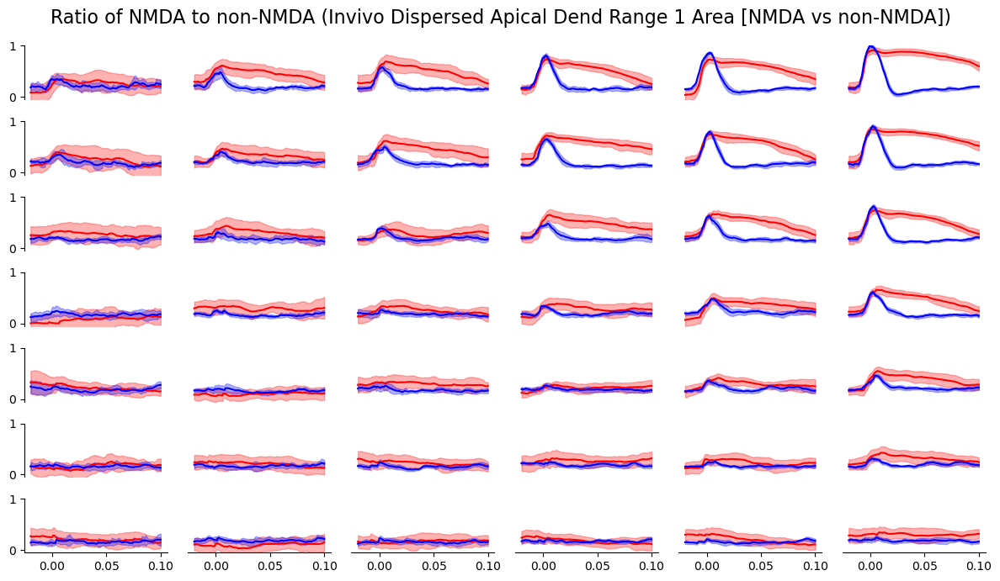

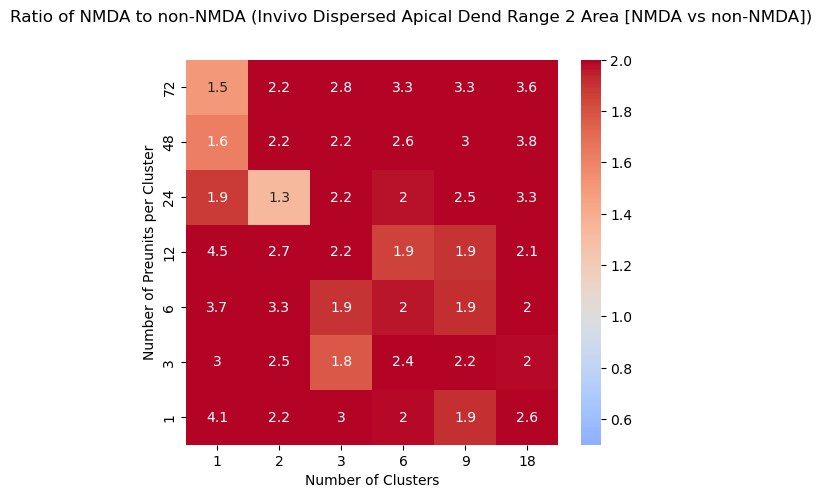

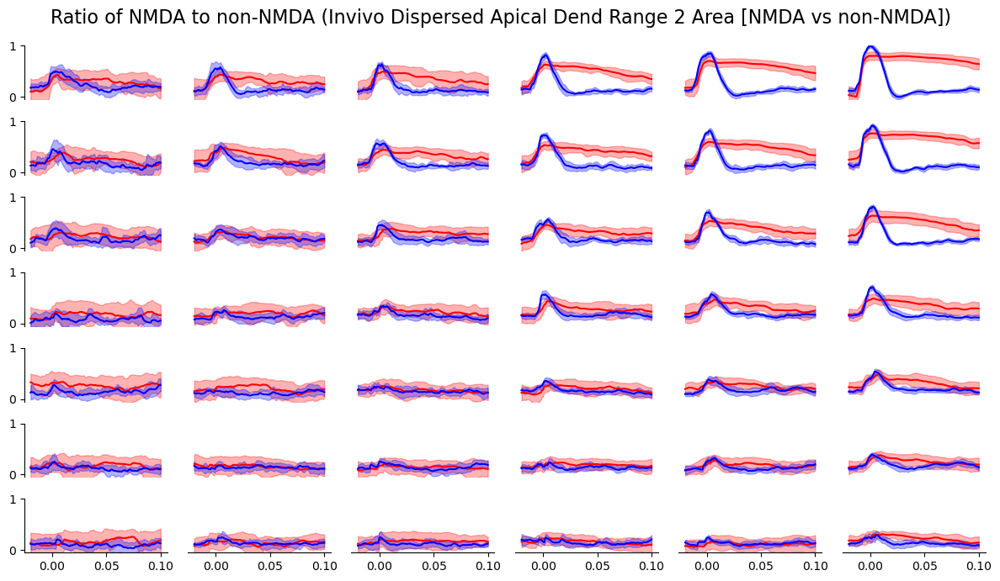

In [83]:
clus_dend_matrix_0_area, clus_dend_matrix_1_area, clus_dend_matrix_2_area, \
distr_dend_matrix_0_area, distr_dend_matrix_1_area, distr_dend_matrix_2_area, \
clus_dend_root_v_0_area, clus_dend_root_v_1_area, clus_dend_root_v_2_area, \
distr_dend_root_v_0_area, distr_dend_root_v_1_area, distr_dend_root_v_2_area, \
clus_dend_std_root_v_0_area, clus_dend_std_root_v_1_area, clus_dend_std_root_v_2_area, \
distr_dend_std_root_v_0_area, distr_dend_std_root_v_1_area, distr_dend_std_root_v_2_area = full_analyze_case('distr_invivo', 'distr_invivo_AMPAonly', 'apical', 'Dend', 'Area')

# Calculate ratio and draw heatmap
for range_idx in range(3):
    calculate_ratio_and_draw_heatmap(globals()[f'clus_dend_matrix_{range_idx}_area'], globals()[f'distr_dend_matrix_{range_idx}_area'], 
                                     globals()[f'clus_dend_root_v_{range_idx}_area'], globals()[f'distr_dend_root_v_{range_idx}_area'], 
                                     globals()[f'clus_dend_std_root_v_{range_idx}_area'], globals()[f'distr_dend_std_root_v_{range_idx}_area'], 
                                     f'(Invivo Dispersed Apical Dend Range {range_idx} Area [NMDA vs non-NMDA])')

### Concen test

2.33e-05 3.94e-02
2.33e-05 3.94e-02
9.11e-02 5.60e+00
9.11e-02 5.60e+00


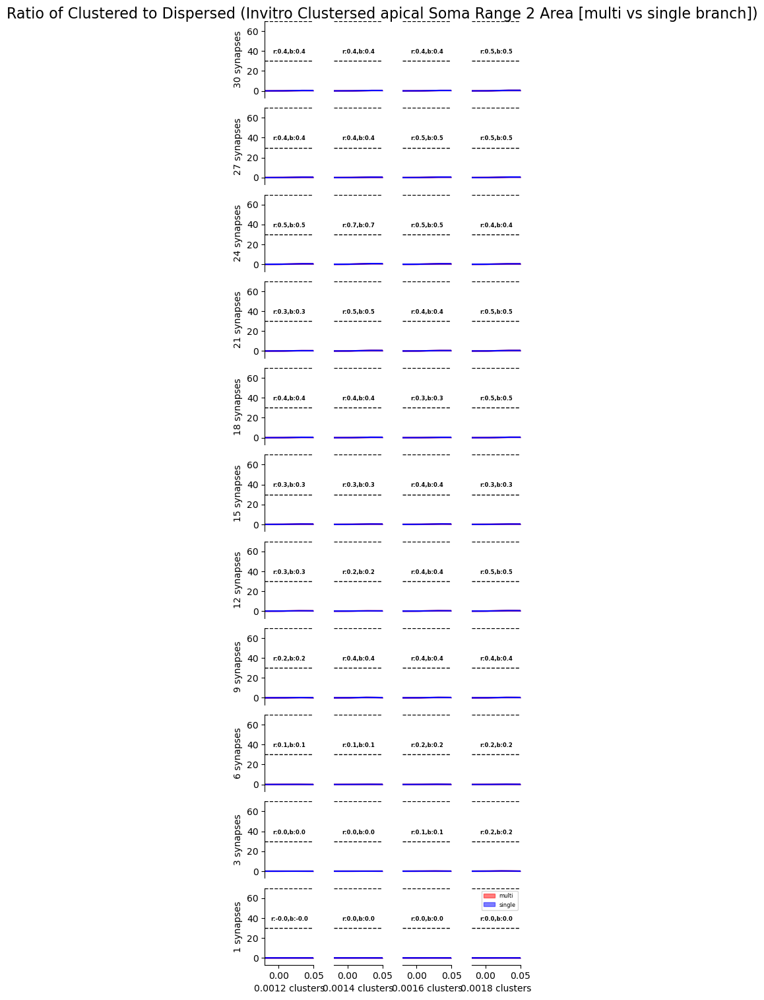

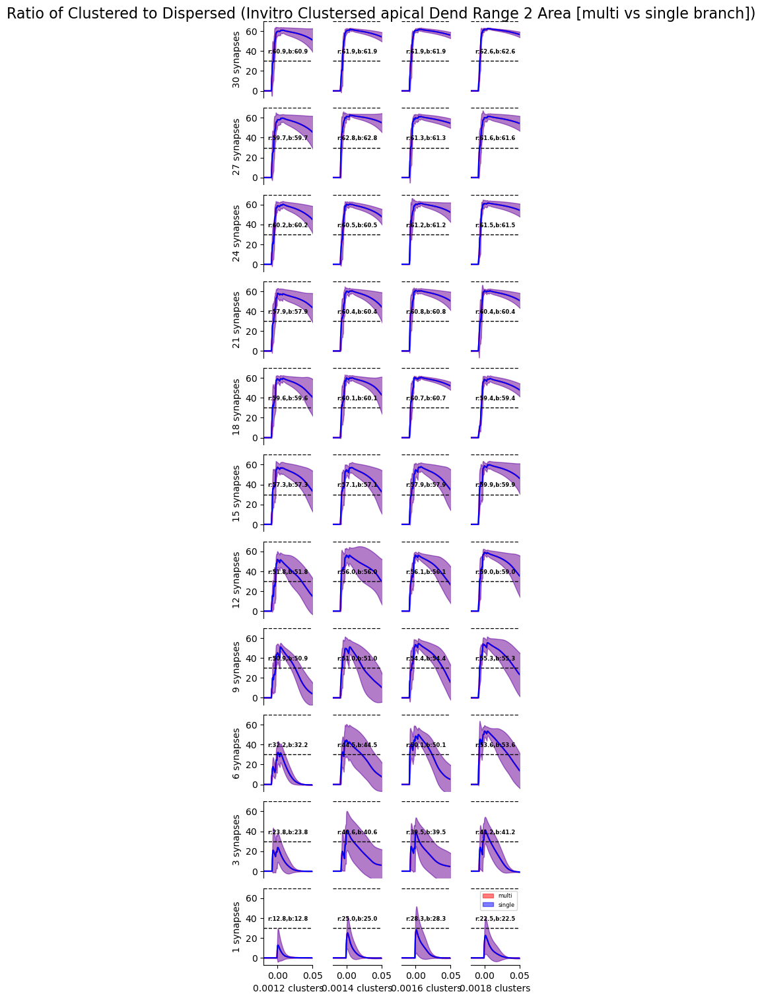

In [22]:
# Define parameters
num_clus = [0.0012, 0.0014, 0.0016, 0.0018] 
num_syn_per_clus = [1, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30]  

anal_loc, rec_loc, rec_attr = 'apical', 'Soma', 'Area'
attr1, attr2 = 'multi', 'single'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invitro_variedW_EPSPtest', 
                                                                                                                                    f'clus_invitro_variedW_EPSPtest', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=8)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro Clustersed {anal_loc} {rec_loc} Range {range_idx} {rec_attr} [{attr1} vs {attr2} branch])',
                                         attr1, attr2)
    

6.58e-03 4.49e-01
6.58e-03 4.49e-01
5.77e-03 4.56e-01
5.77e-03 4.56e-01
3.78e-02 1.88e+00
3.78e-02 1.88e+00
1.11e-01 5.10e+00
1.11e-01 5.10e+00


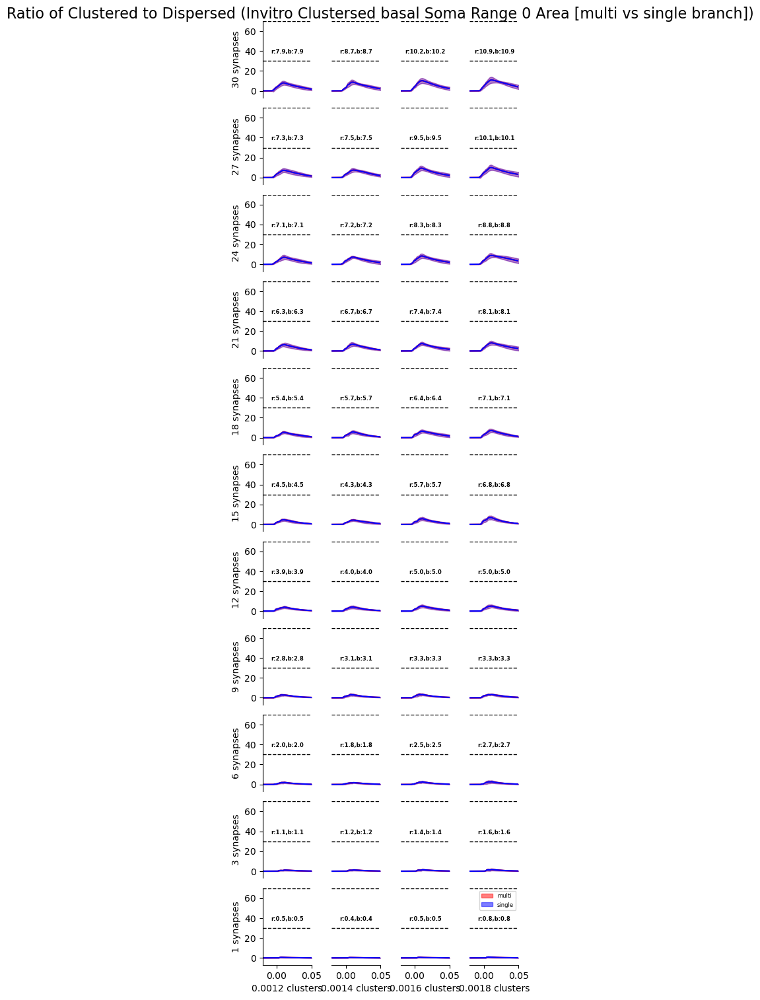

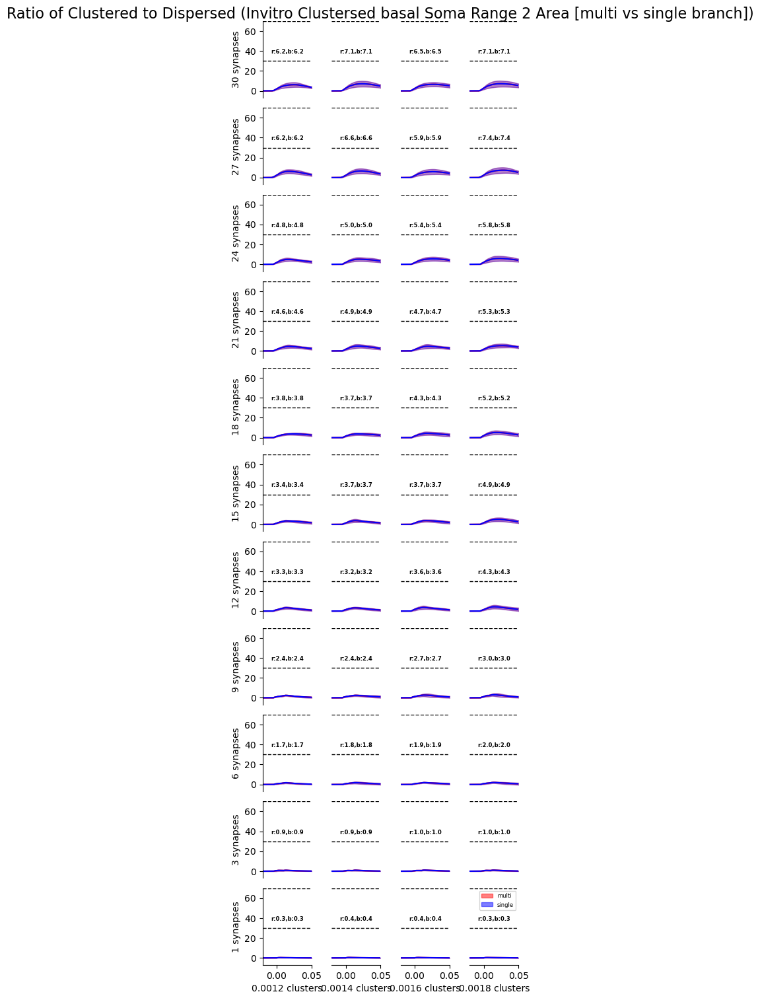

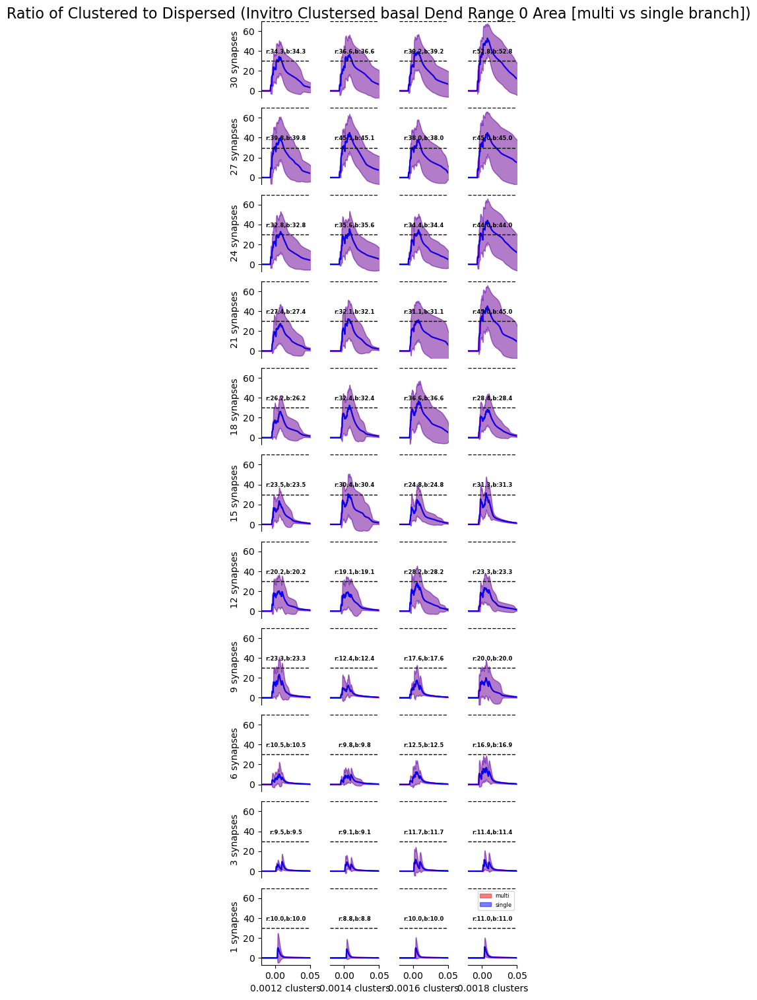

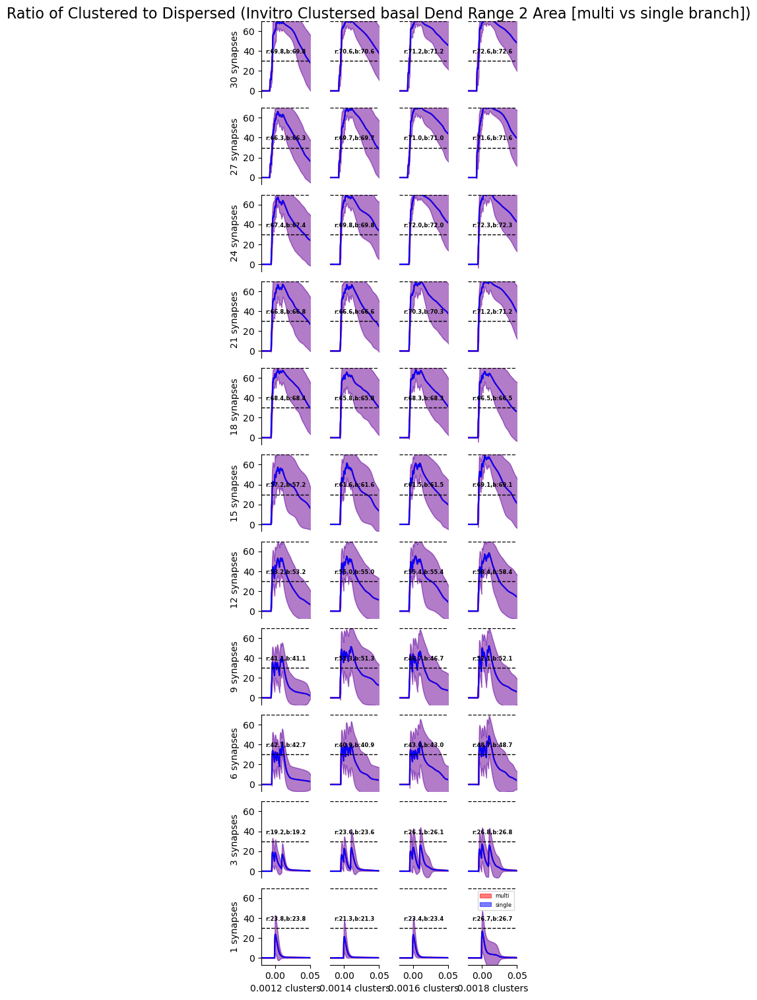

In [23]:
# Define parameters
num_clus = [0.0012, 0.0014, 0.0016, 0.0018] 
num_syn_per_clus = [1, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'multi', 'single'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0, 2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invitro_variedW_EPSPtest', 
                                                                                                                                    f'clus_invitro_variedW_EPSPtest', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=20)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0, 2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro Clustersed {anal_loc} {rec_loc} Range {range_idx} {rec_attr} [{attr1} vs {attr2} branch])',
                                         attr1, attr2)
    

6.85e-04 1.97e+00


4.99e-04 1.93e+00
6.54e-04 2.21e+00
1.32e-03 1.99e+00
5.25e-04 2.56e+00
5.04e-04 2.18e+00
3.16e-03 2.38e+00
2.51e-03 2.06e+00
9.65e-03 3.54e+00
1.56e-02 2.36e+00
1.87e-02 4.97e+00
1.61e-02 3.19e+00


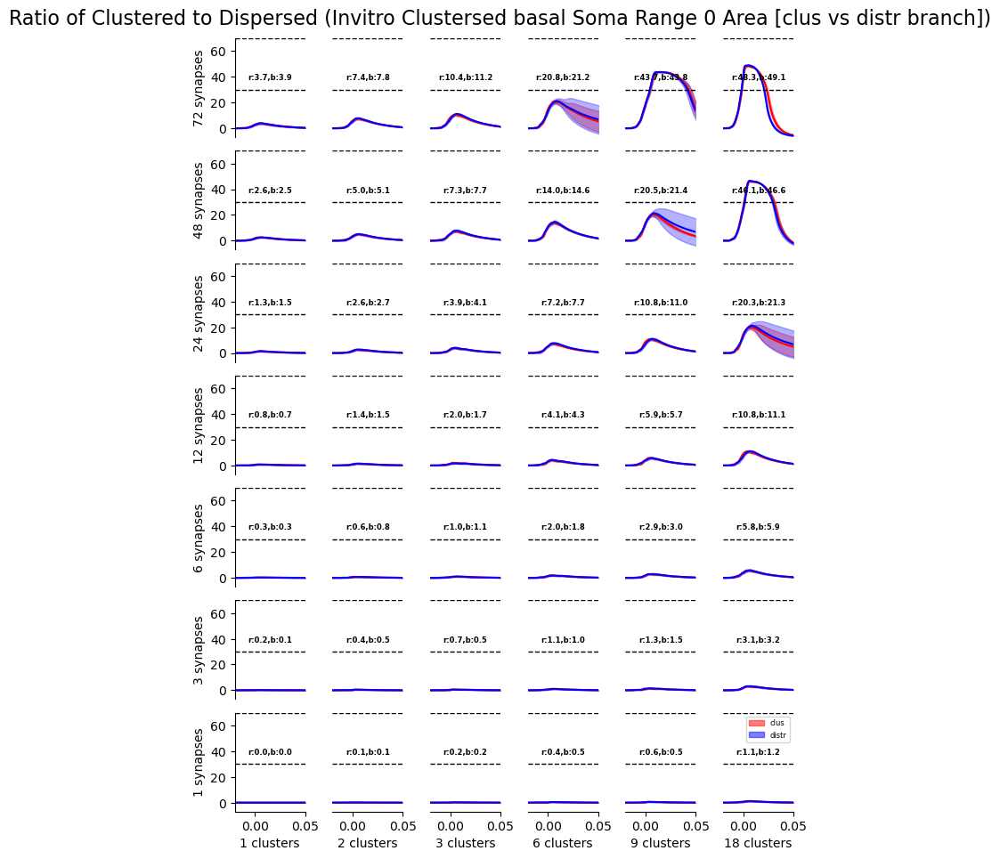

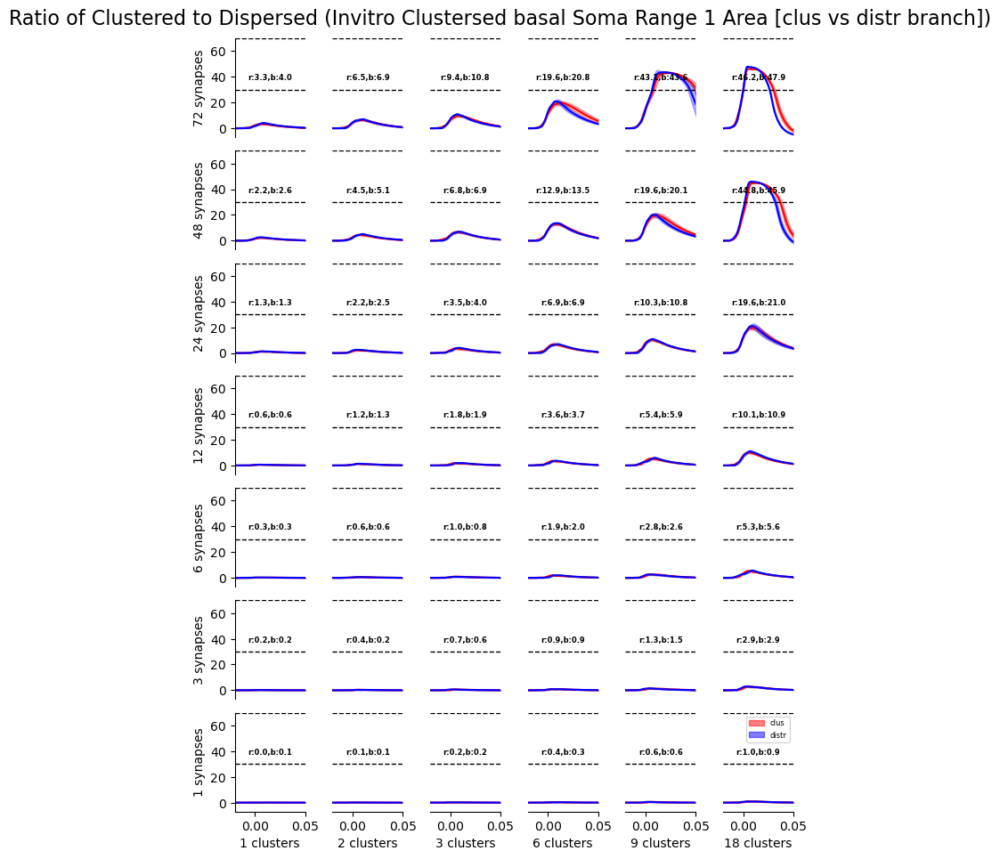

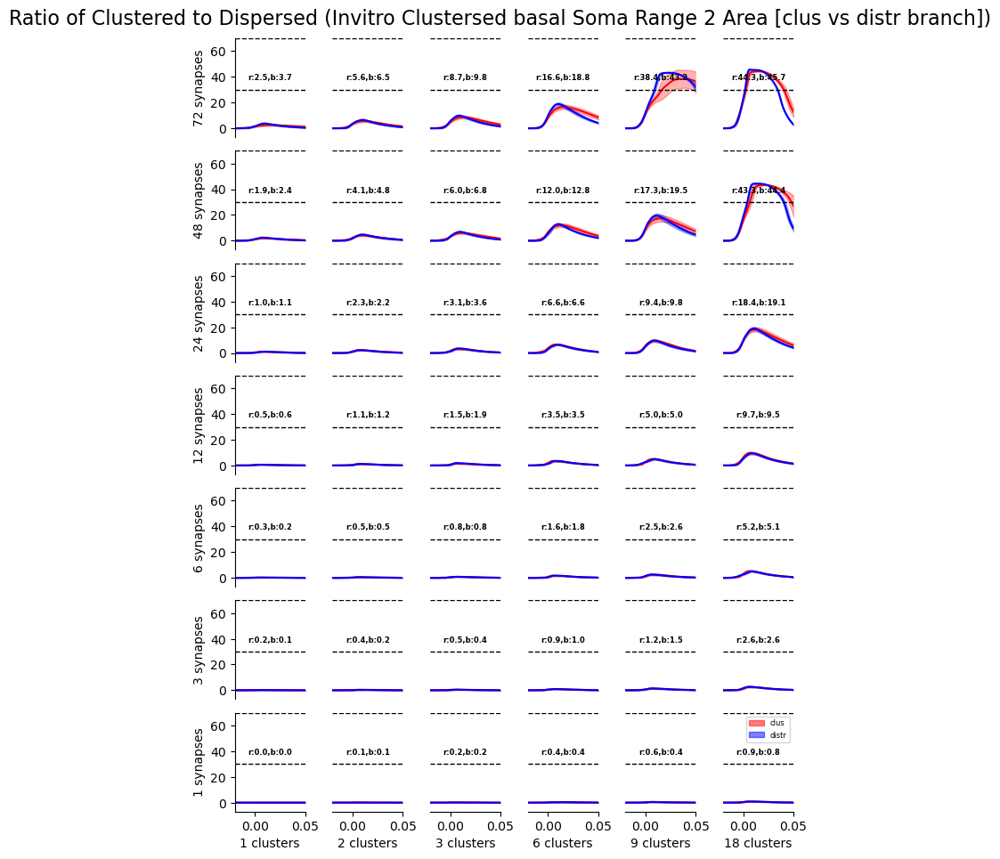

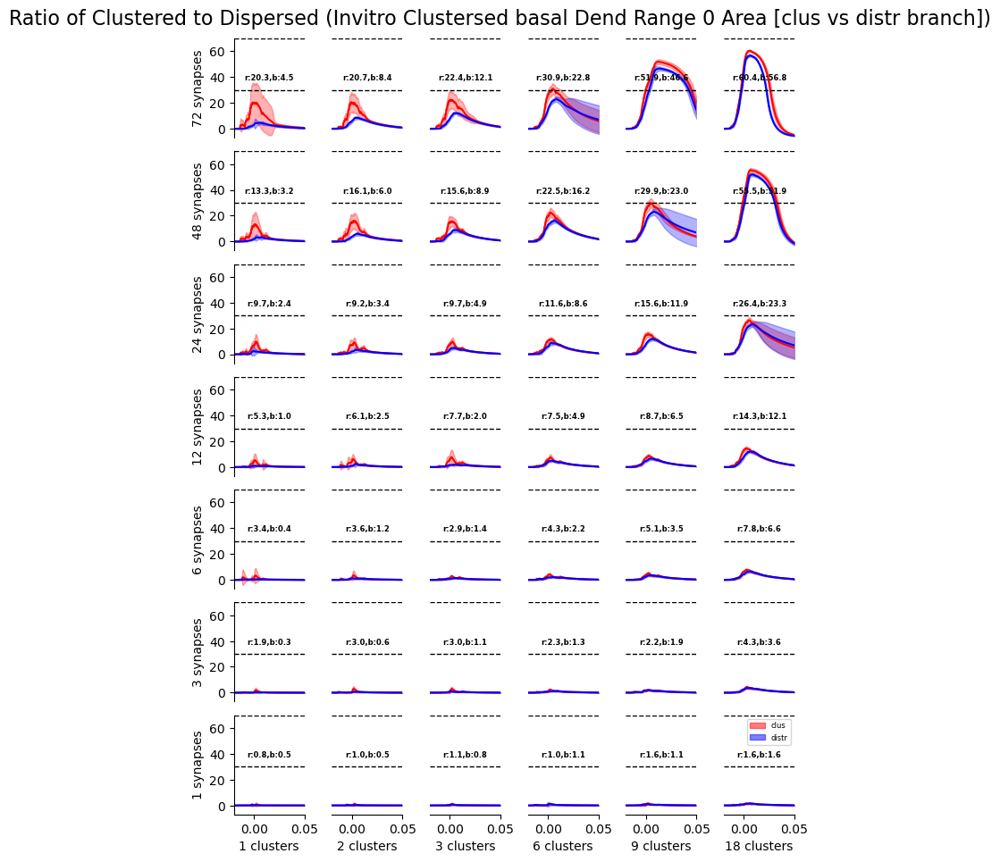

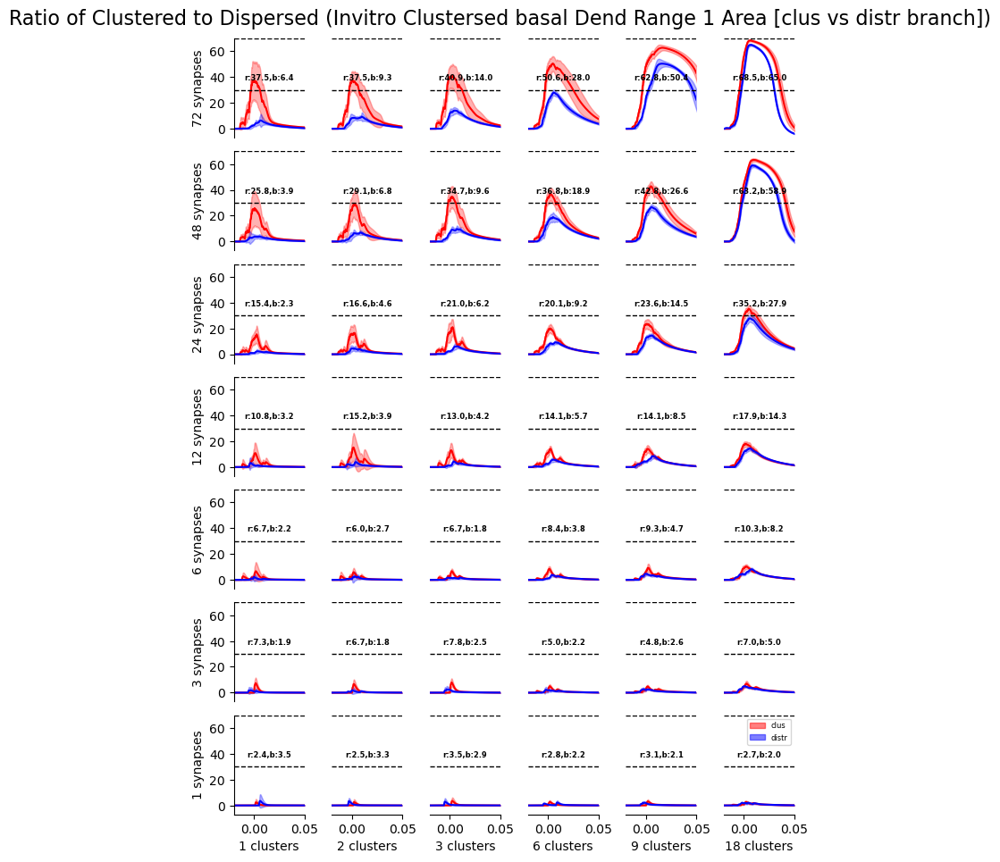

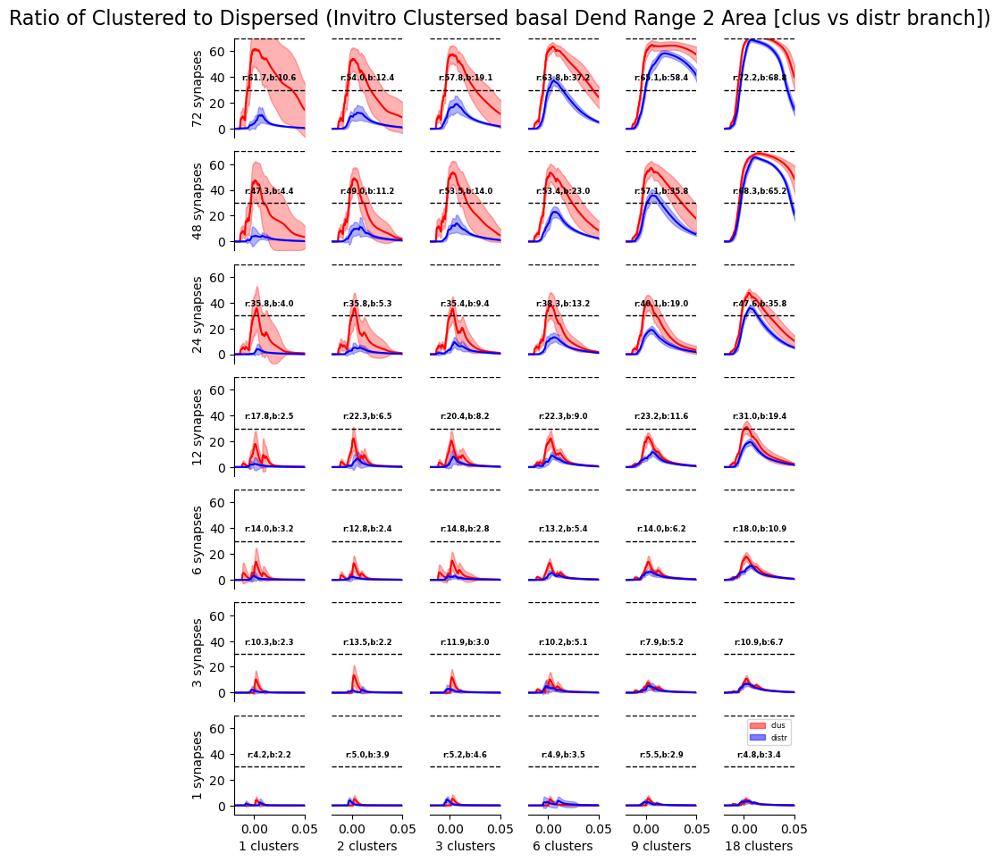

In [7]:
# Define parameters
num_clus = [1, 2, 3, 6, 9, 18] 
num_syn_per_clus = [1, 3, 6, 12, 24, 48, 72]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'clus', 'distr'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0,1,2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invitro_variedW_tau90', 
                                                                                                                                    f'distr_invitro_variedW_tau90', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=20)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0,1,2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro Clustersed {anal_loc} {rec_loc} Range {range_idx} {rec_attr} [{attr1} vs {attr2} branch])',
                                         attr1, attr2)
    

### Conductance test

3.20e-01 2.27e+00
3.33e-01 2.32e+00
3.25e-01 2.39e+00
3.10e-01 2.32e+00
3.26e-01 2.59e+00
3.00e-01 2.38e+00
4.72e-01 2.77e+00
3.67e-01 2.41e+00
7.24e-01 4.14e+00
3.95e-01 2.65e+00
1.41e+00 5.29e+00
5.06e-01 3.48e+00


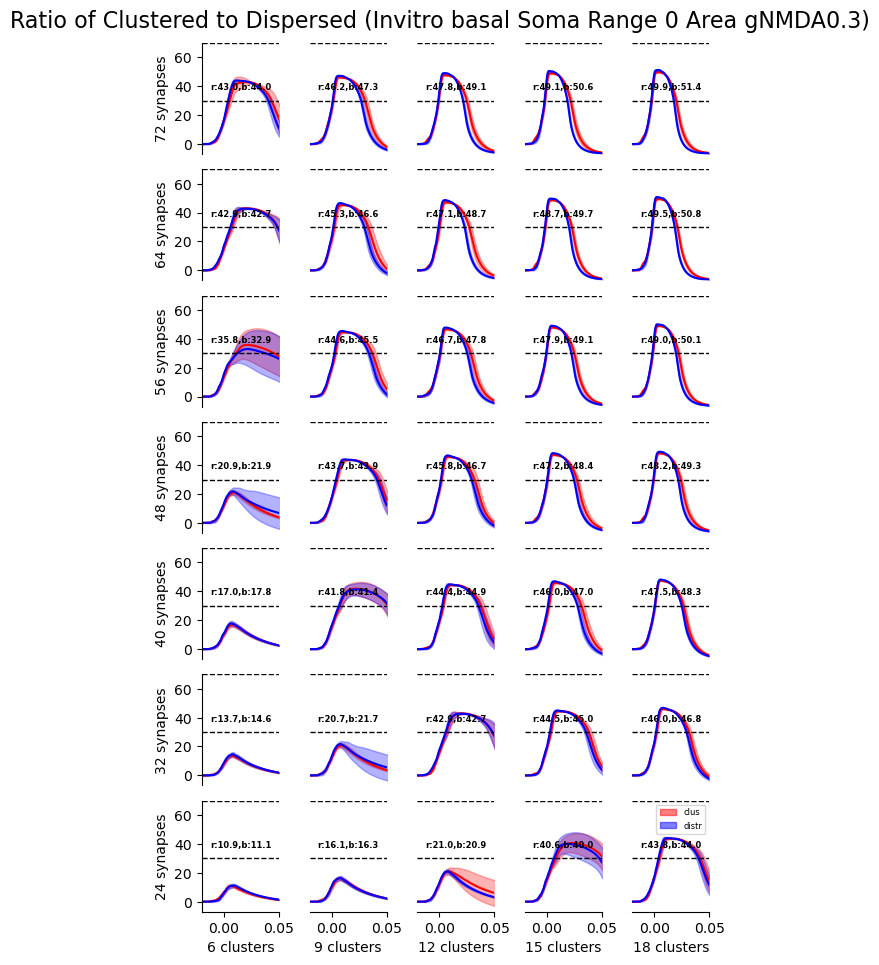

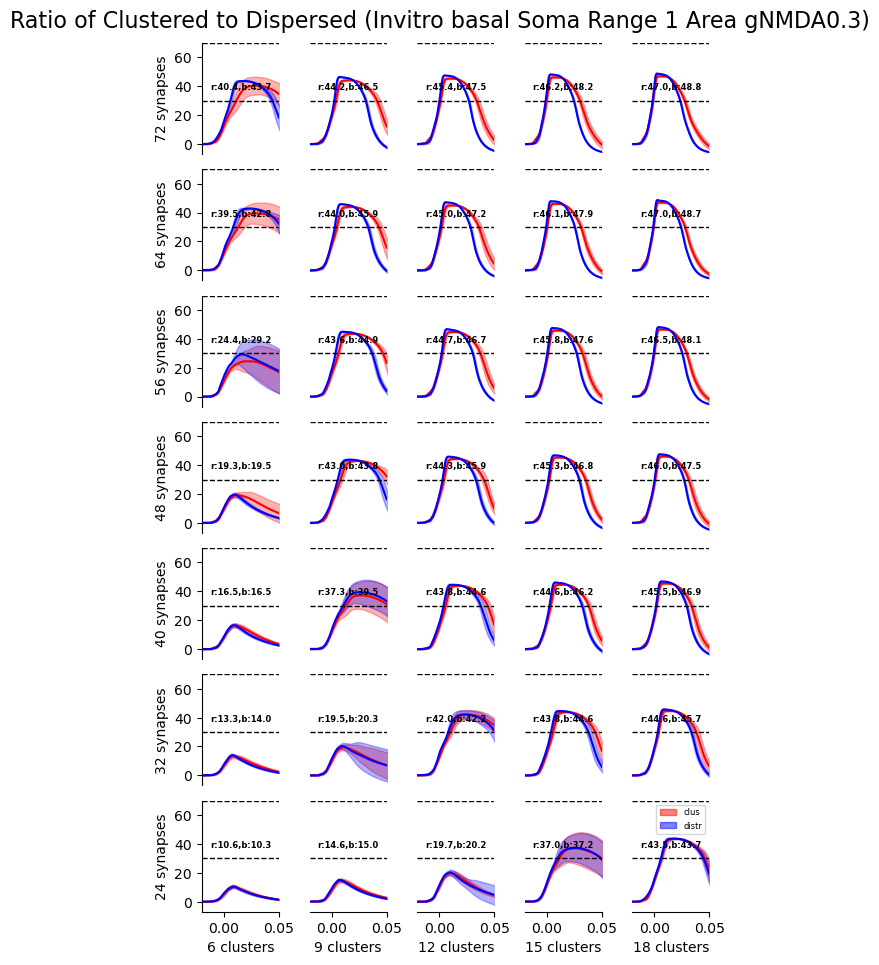

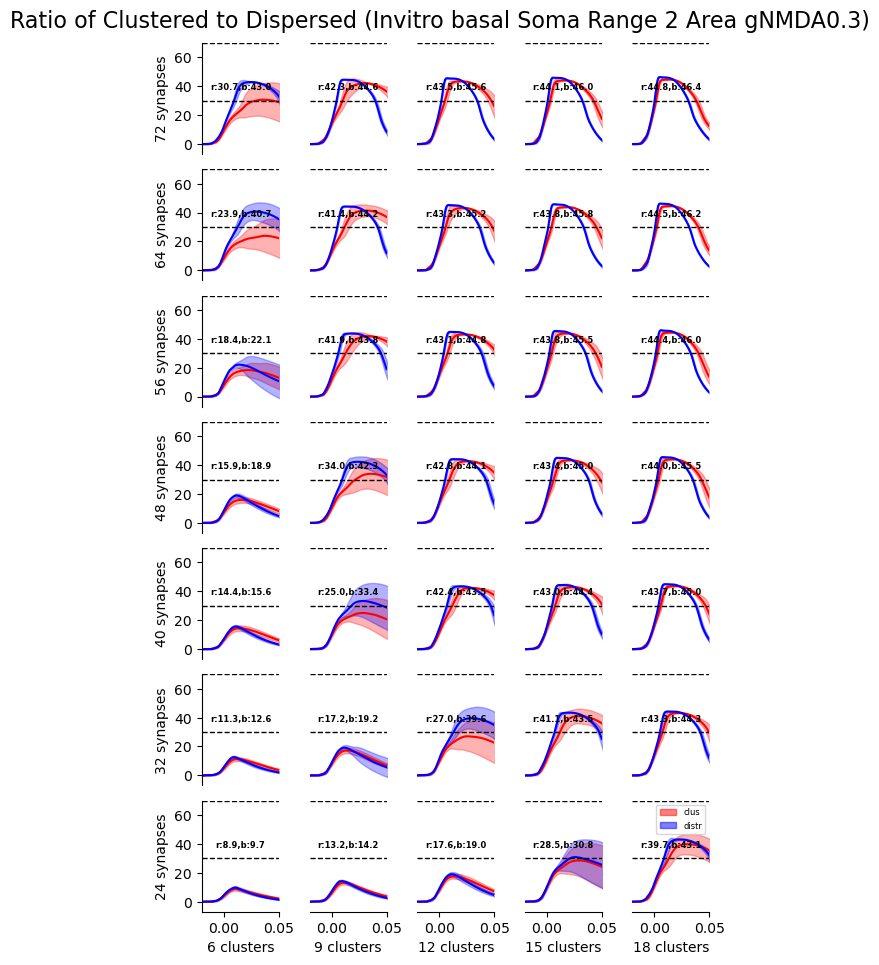

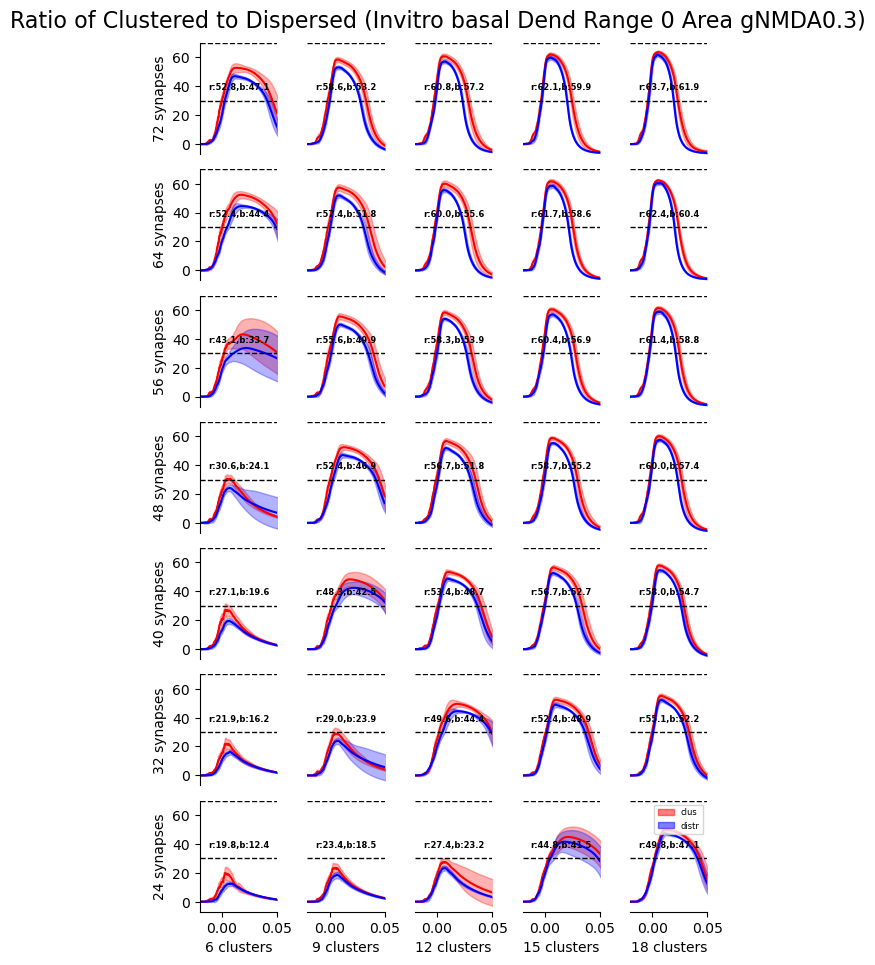

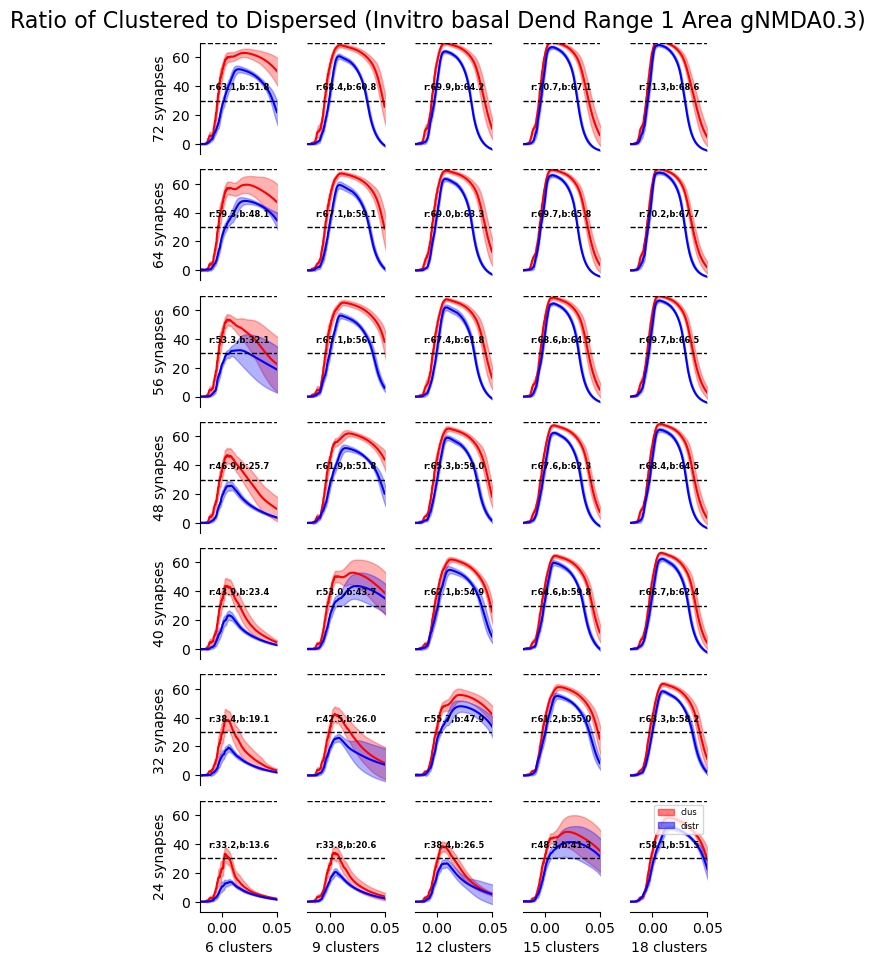

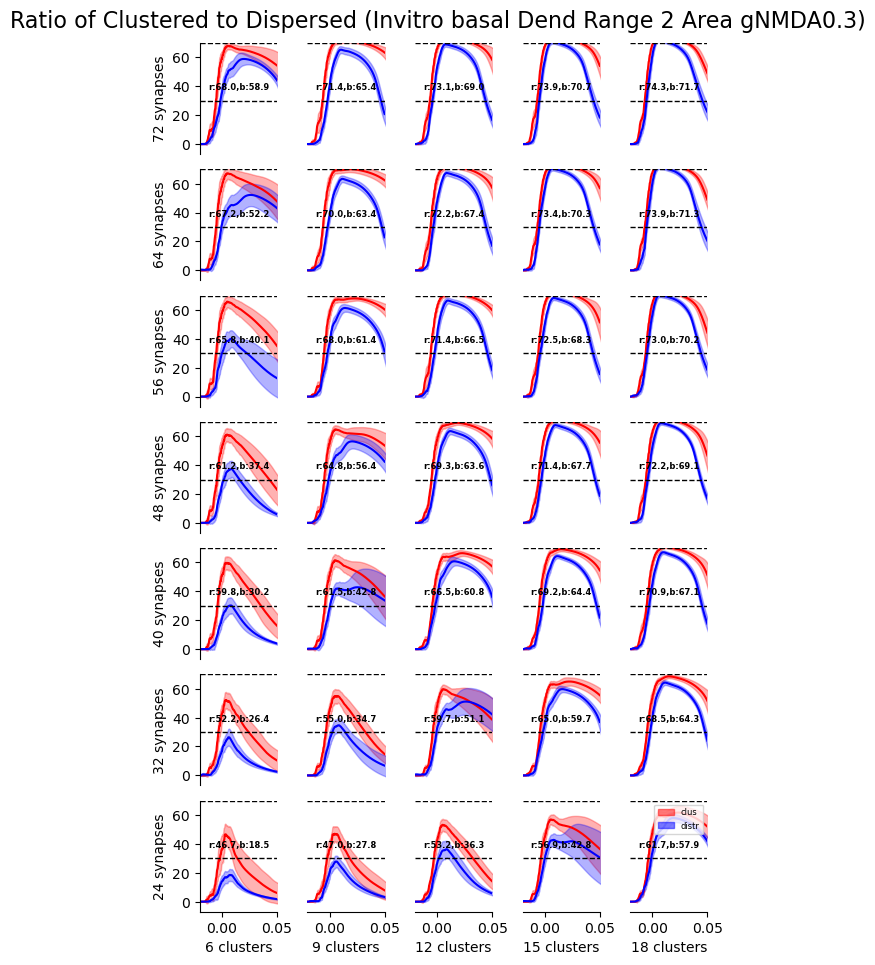

In [7]:
# Define parameters
num_clus = [6, 9, 12, 15, 18] 
num_syn_per_clus = [24, 32, 40, 48, 56, 64, 72]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'clus', 'distr'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0,1,2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invitro_variedW_tau90_shifted_g0.3', 
                                                                                                                                    f'distr_invitro_variedW_tau90_shifted_g0.3', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=30)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0,1,2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro {anal_loc} {rec_loc} Range {range_idx} {rec_attr} gNMDA0.3)',
                                         attr1, attr2)
    

2.17e-01 2.21e+00
2.21e-01 2.27e+00
2.04e-01 2.36e+00
2.00e-01 2.10e+00
2.15e-01 2.49e+00
1.96e-01 2.54e+00
3.00e-01 2.61e+00
2.40e-01 2.38e+00
4.74e-01 3.56e+00
2.57e-01 2.45e+00
8.81e-01 5.02e+00
3.37e-01 3.51e+00


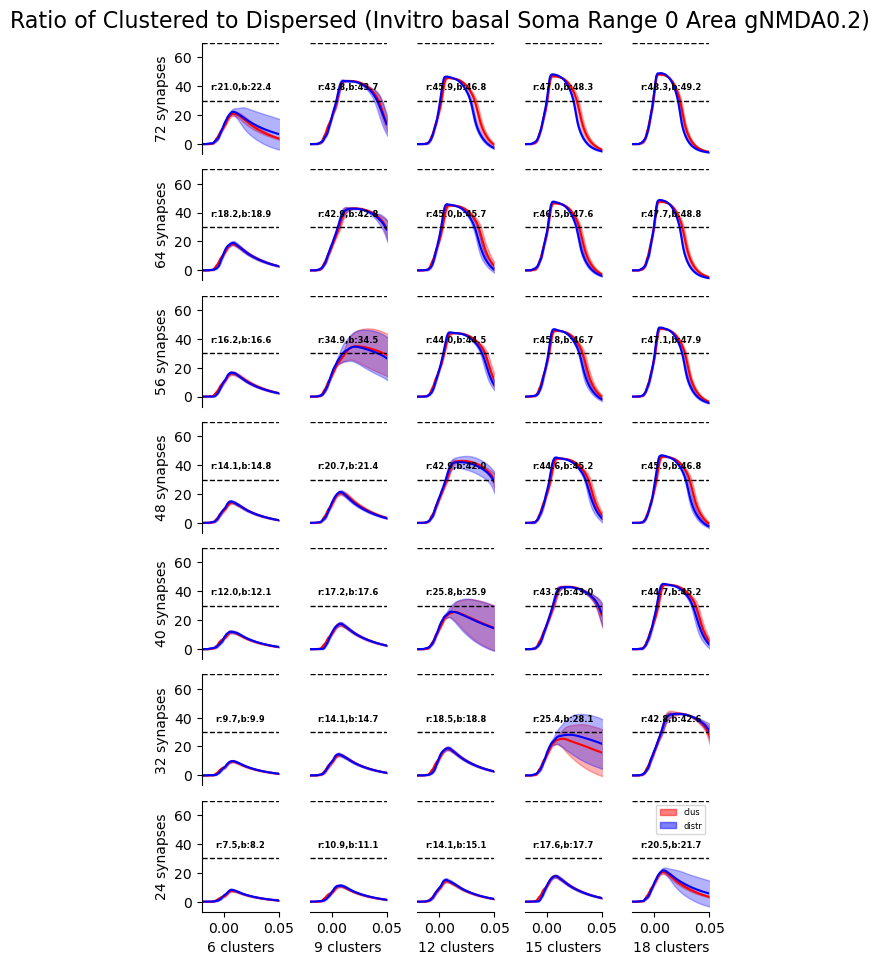

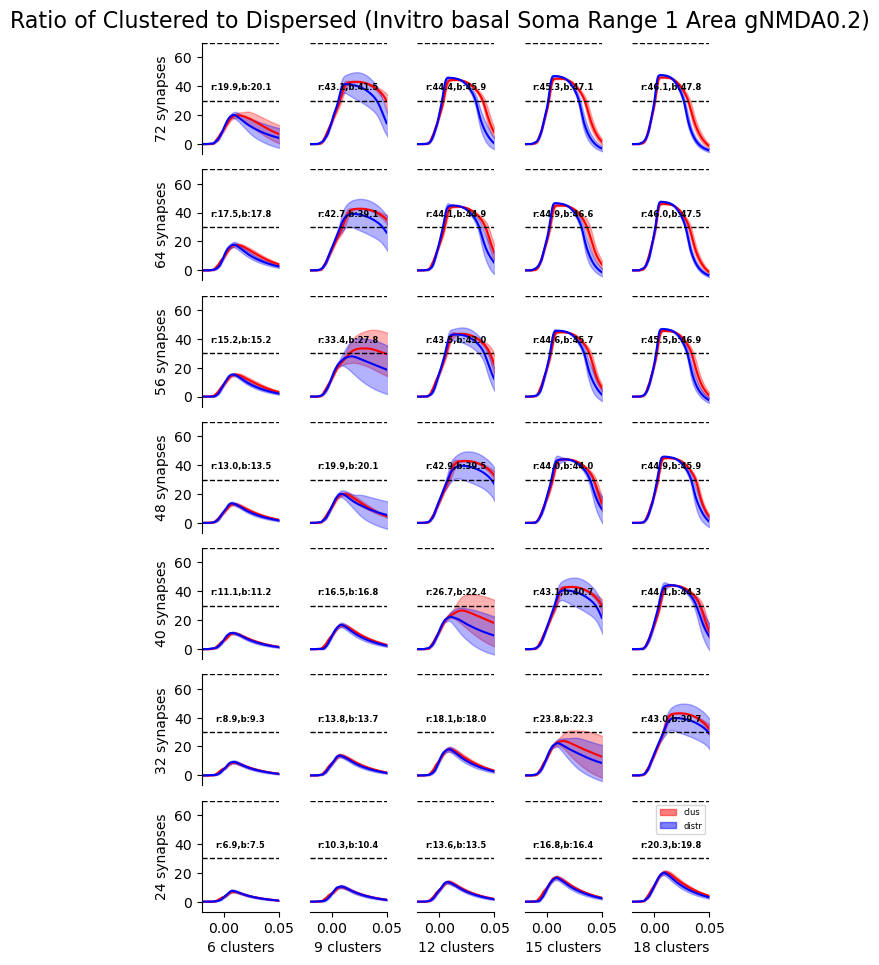

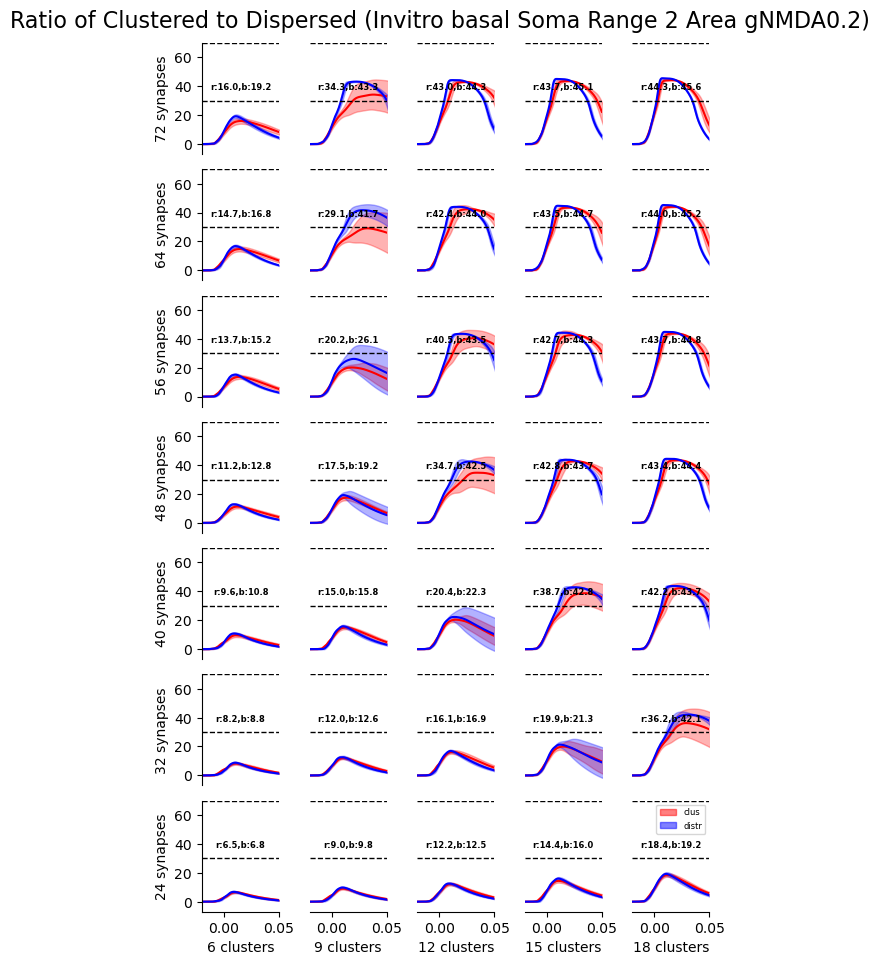

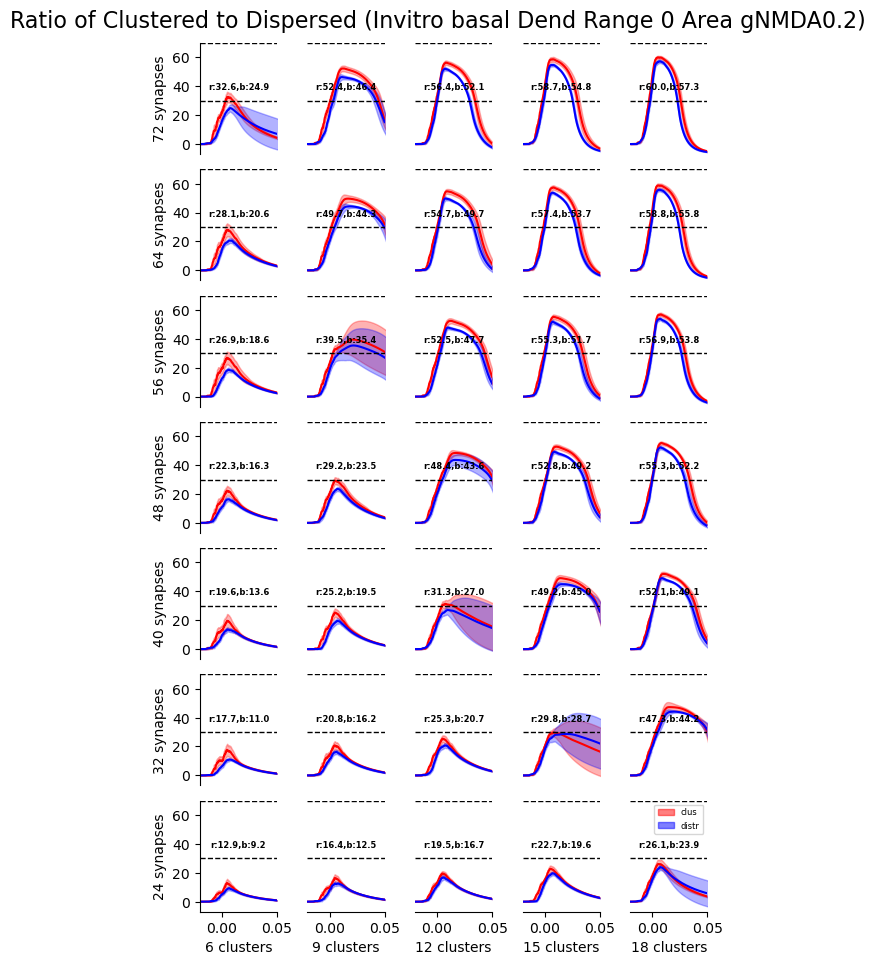

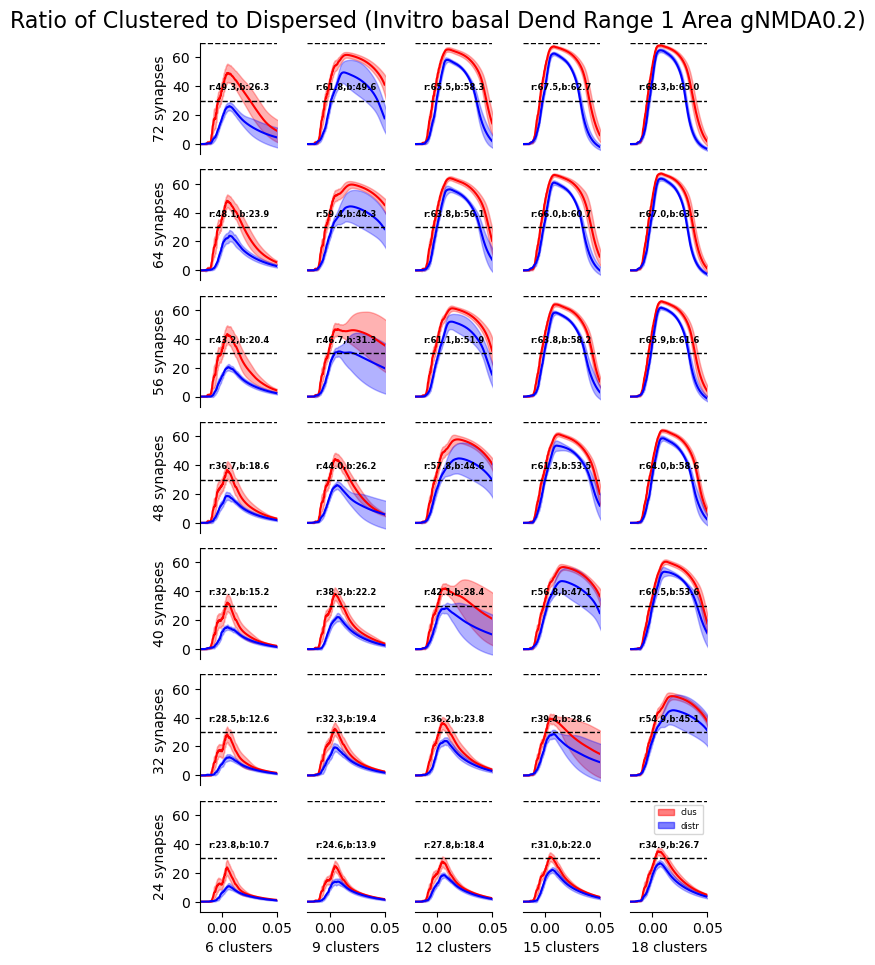

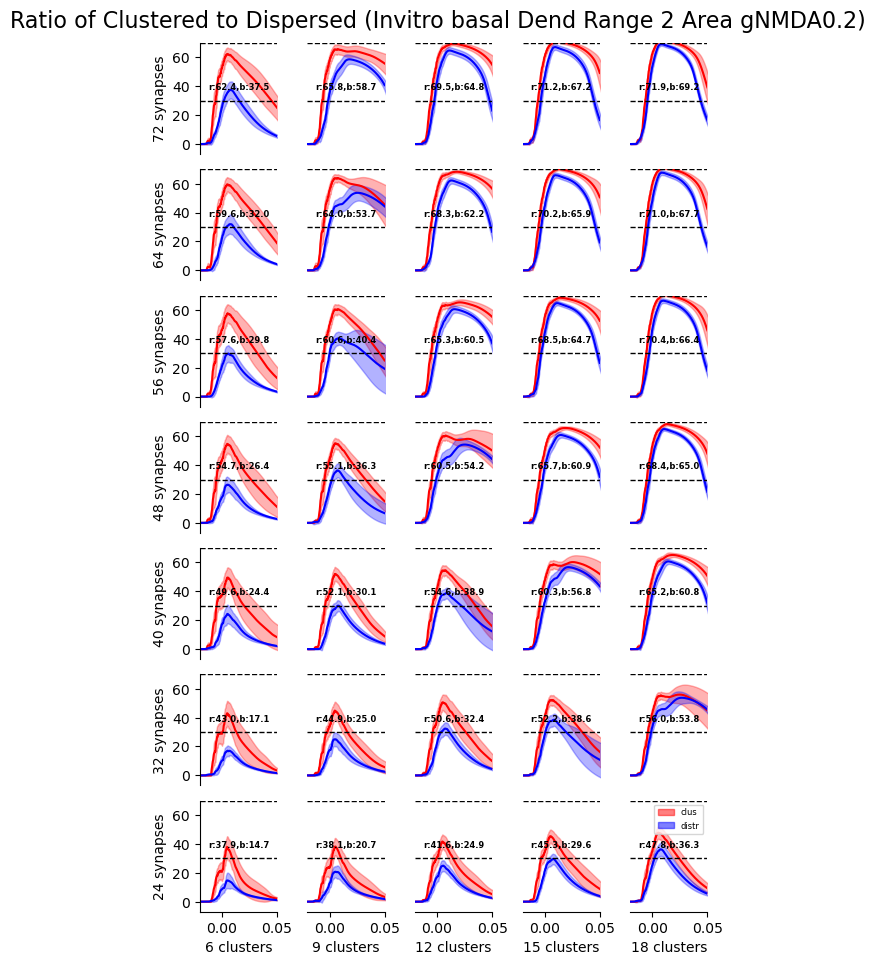

In [5]:
# Define parameters
num_clus = [6, 9, 12, 15, 18] 
num_syn_per_clus = [24, 32, 40, 48, 56, 64, 72]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'clus', 'distr'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0,1,2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invitro_variedW_tau90_shifted', 
                                                                                                                                    f'distr_invitro_variedW_tau90_shifted', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=30)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0,1,2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro {anal_loc} {rec_loc} Range {range_idx} {rec_attr} gNMDA0.2)',
                                         attr1, attr2)
    

2.17e-01 2.03e+00
2.27e-01 1.91e+00
2.08e-01 2.20e+00
2.09e-01 2.00e+00
2.19e-01 2.33e+00
2.04e-01 2.16e+00
3.12e-01 2.44e+00
2.48e-01 2.05e+00
4.64e-01 3.43e+00
2.63e-01 2.40e+00
8.48e-01 4.67e+00
3.67e-01 3.12e+00


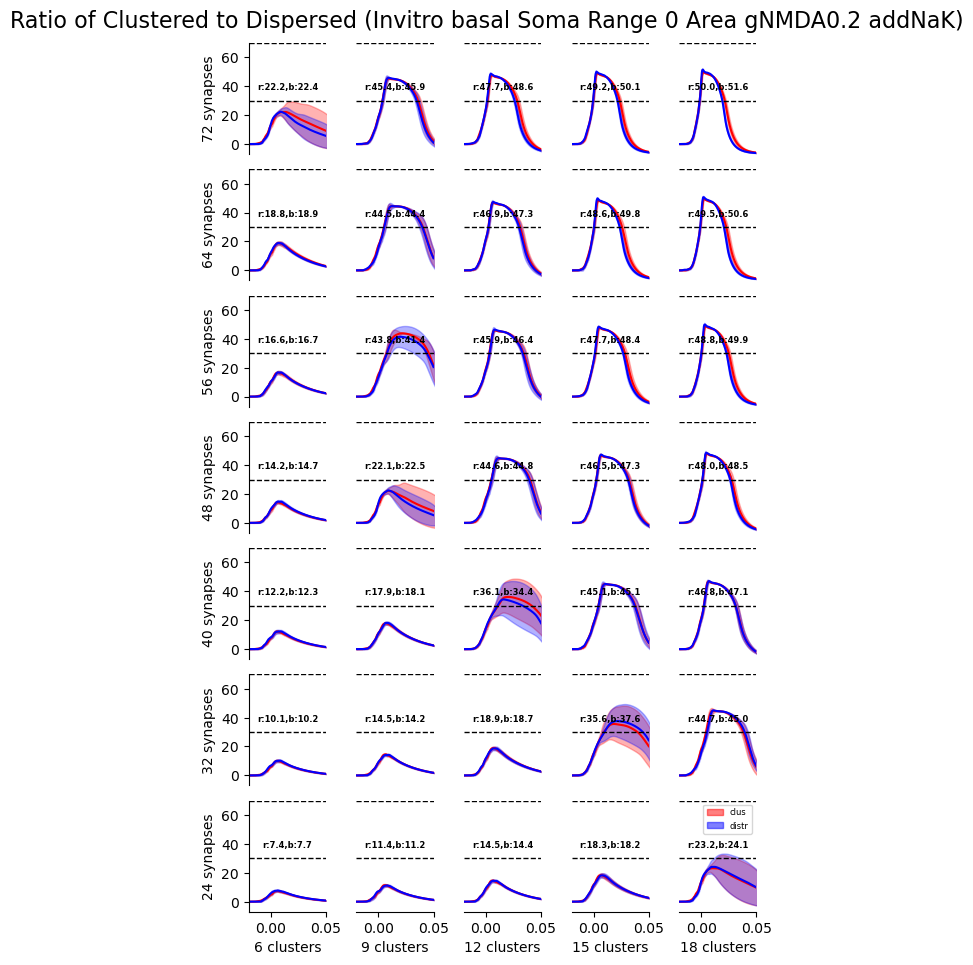

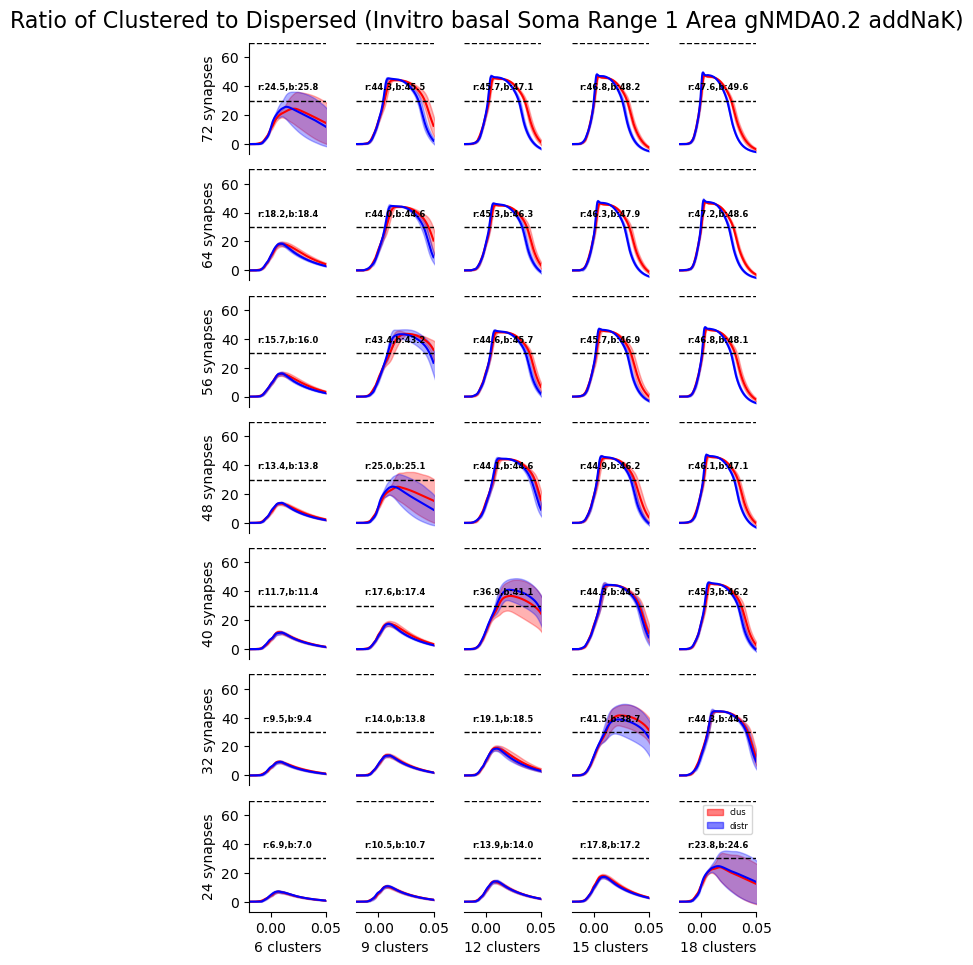

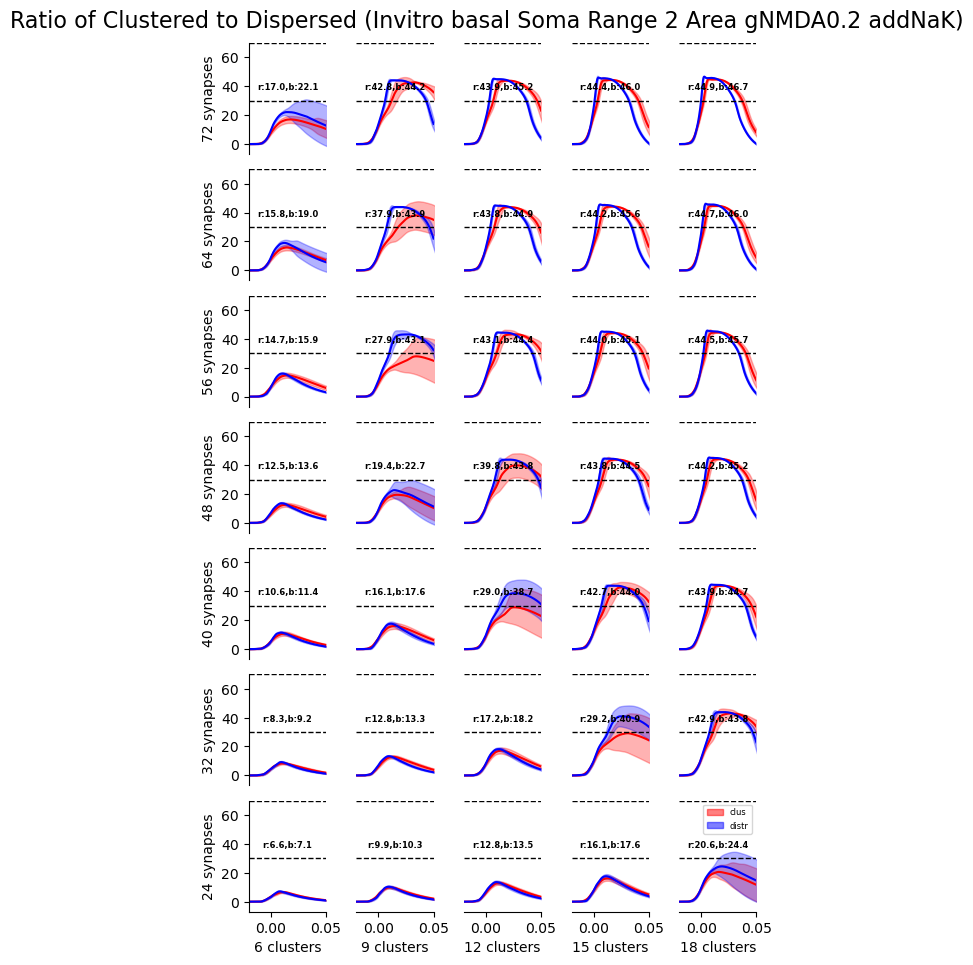

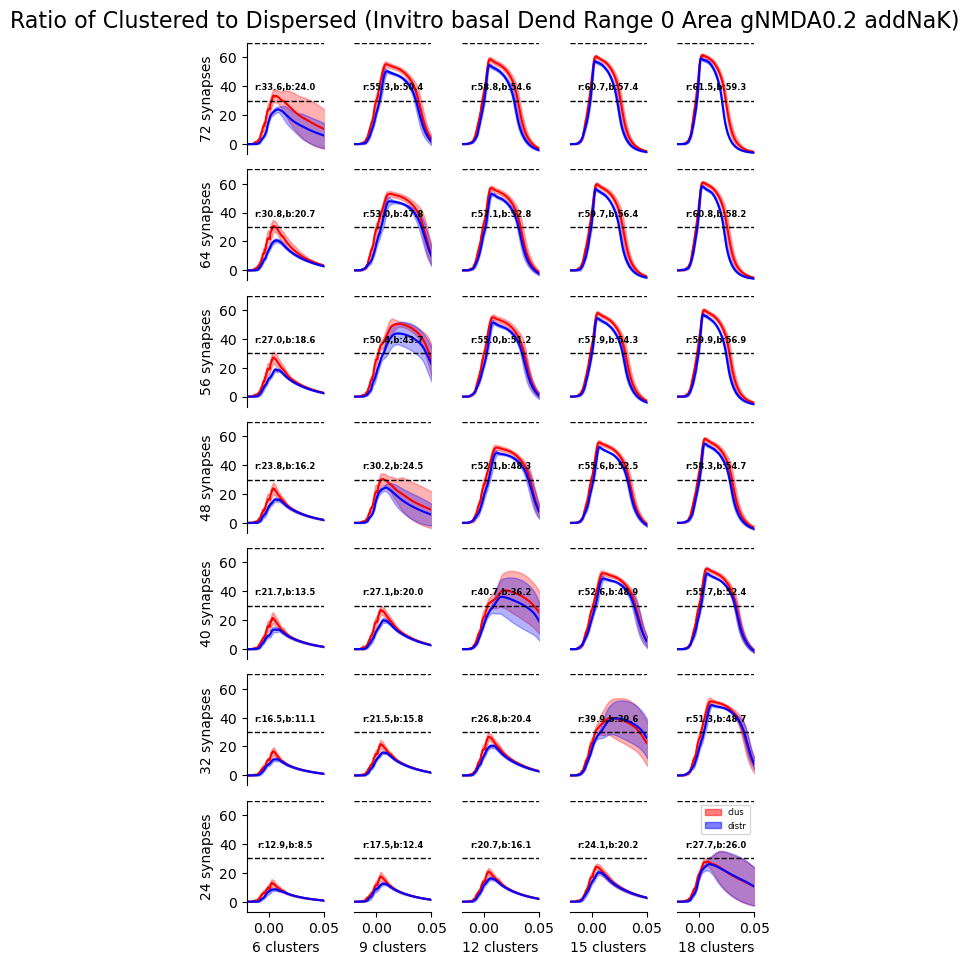

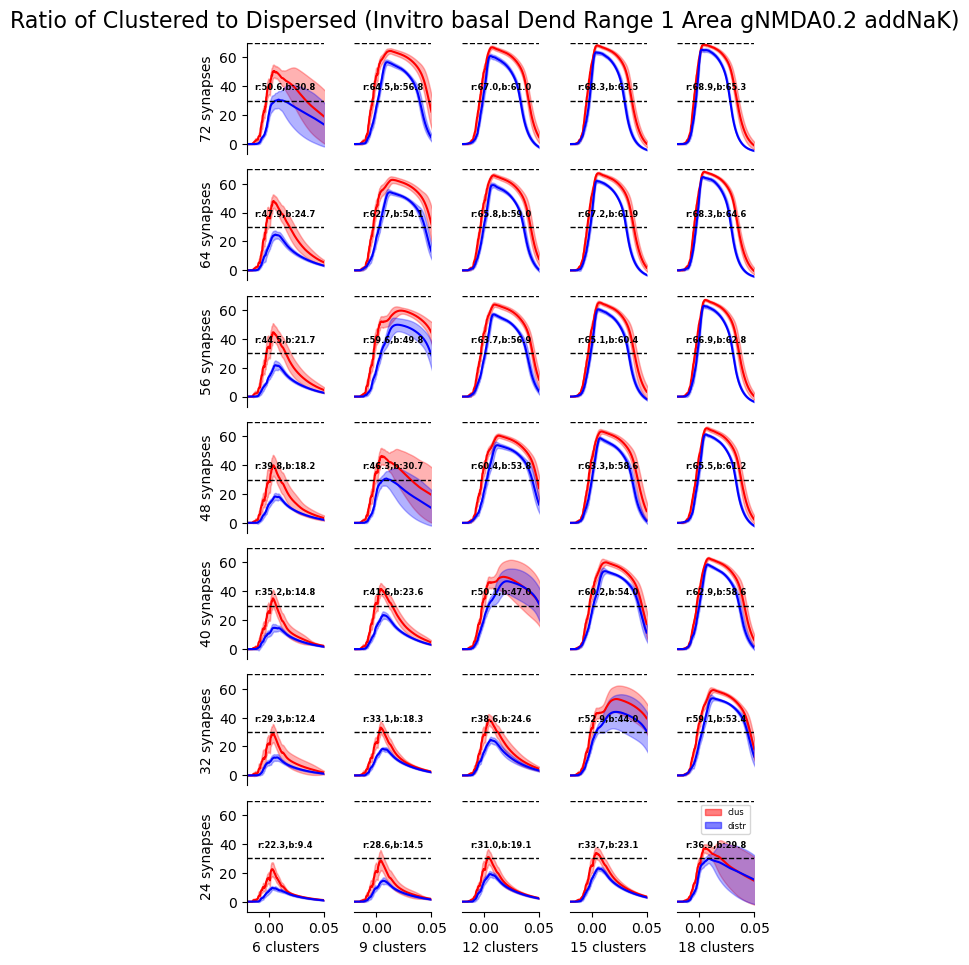

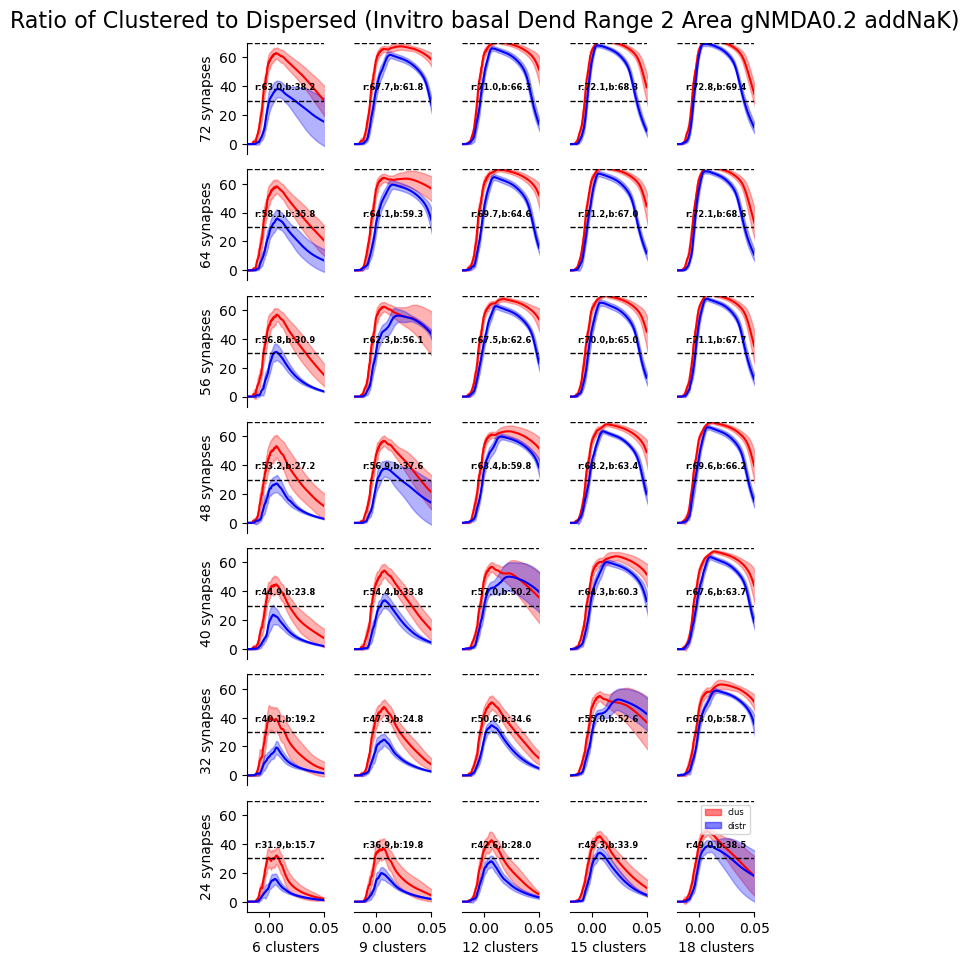

In [4]:
# Define parameters
num_clus = [6, 9, 12, 15, 18] 
num_syn_per_clus = [24, 32, 40, 48, 56, 64, 72]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'clus', 'distr'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0,1,2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invitro_variedW_tau90_shifted_addNaK', 
                                                                                                                                    f'distr_invitro_variedW_tau90_shifted_addNaK', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=30)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0,1,2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro {anal_loc} {rec_loc} Range {range_idx} {rec_attr} gNMDA0.2 addNaK)',
                                         attr1, attr2)
    

3.25e-01 1.96e+00
3.24e-01 1.89e+00
3.28e-01 2.15e+00
3.27e-01 1.89e+00
3.63e-01 2.31e+00
3.26e-01 2.21e+00
4.49e-01 2.58e+00
3.53e-01 2.06e+00
7.00e-01 3.87e+00
4.15e-01 2.34e+00
1.34e+00 5.04e+00
5.88e-01 3.45e+00


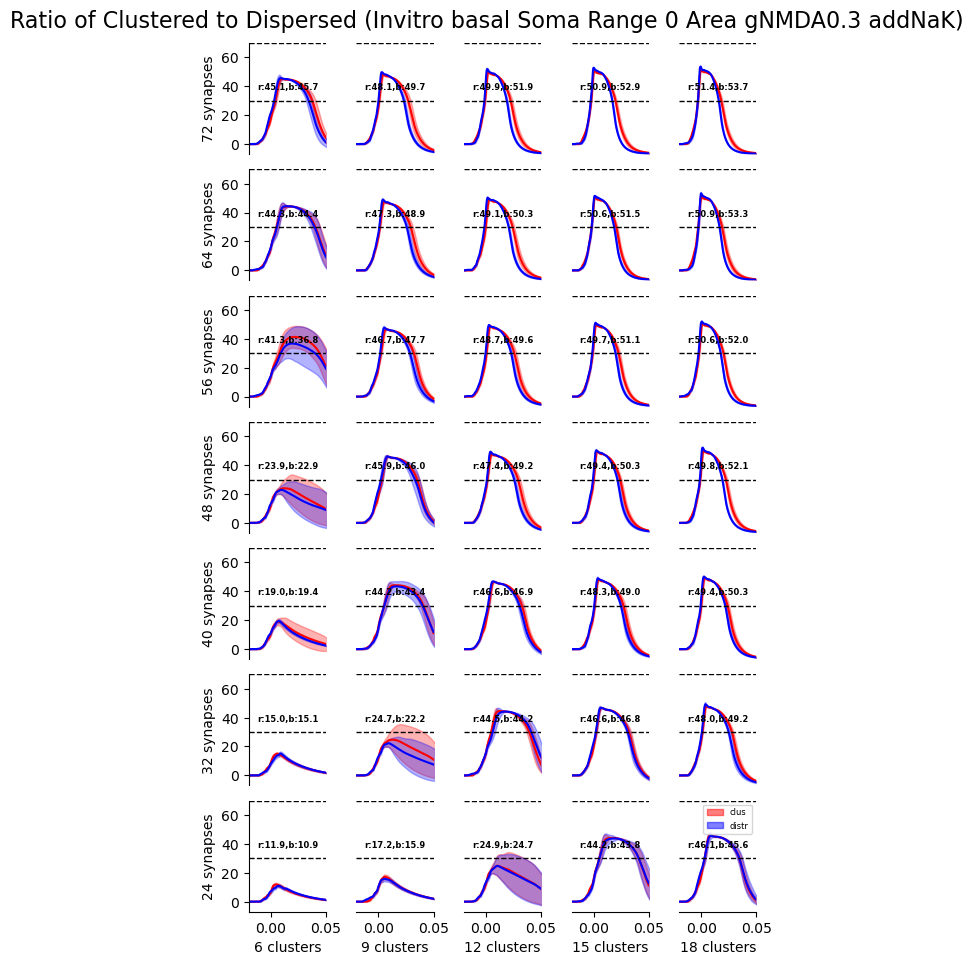

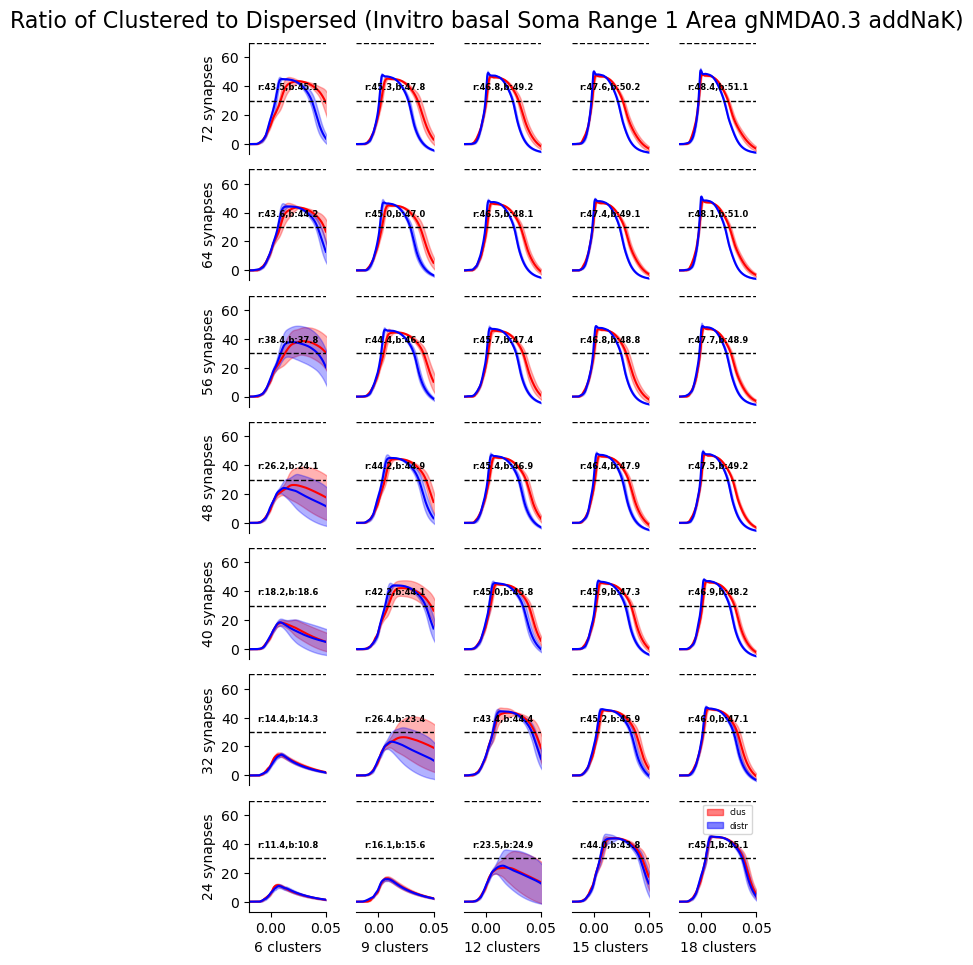

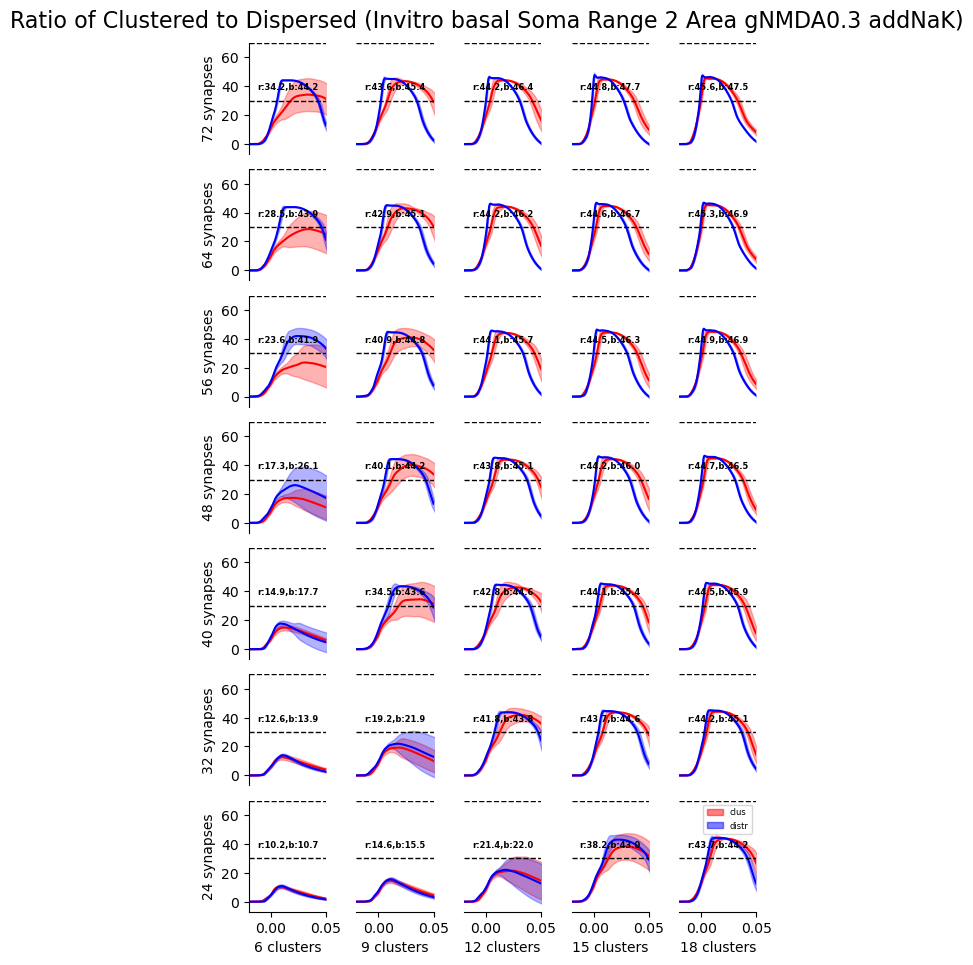

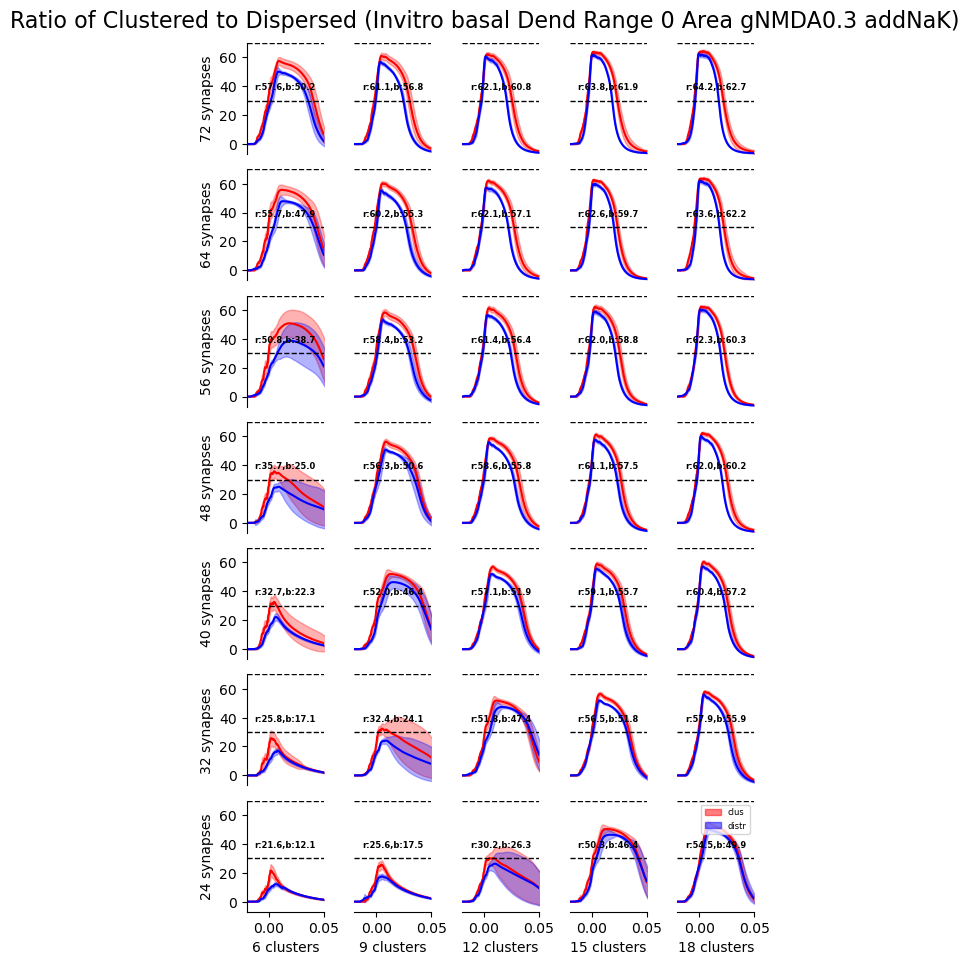

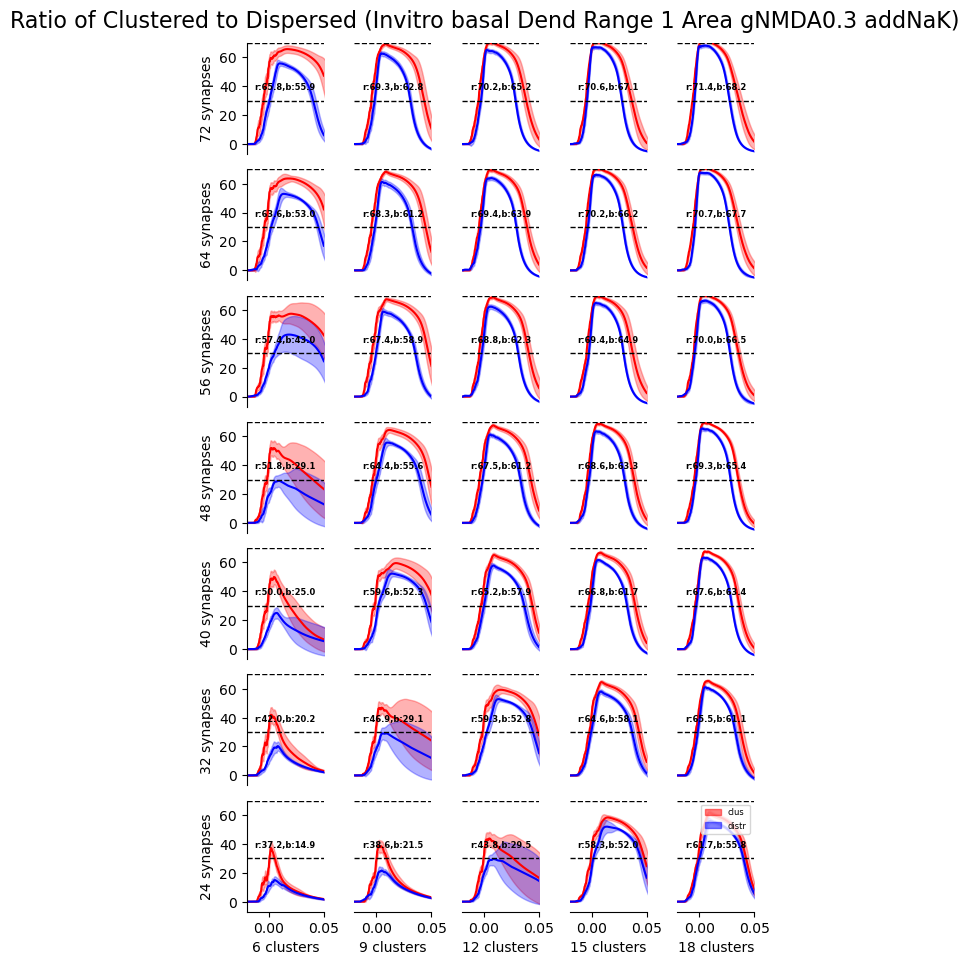

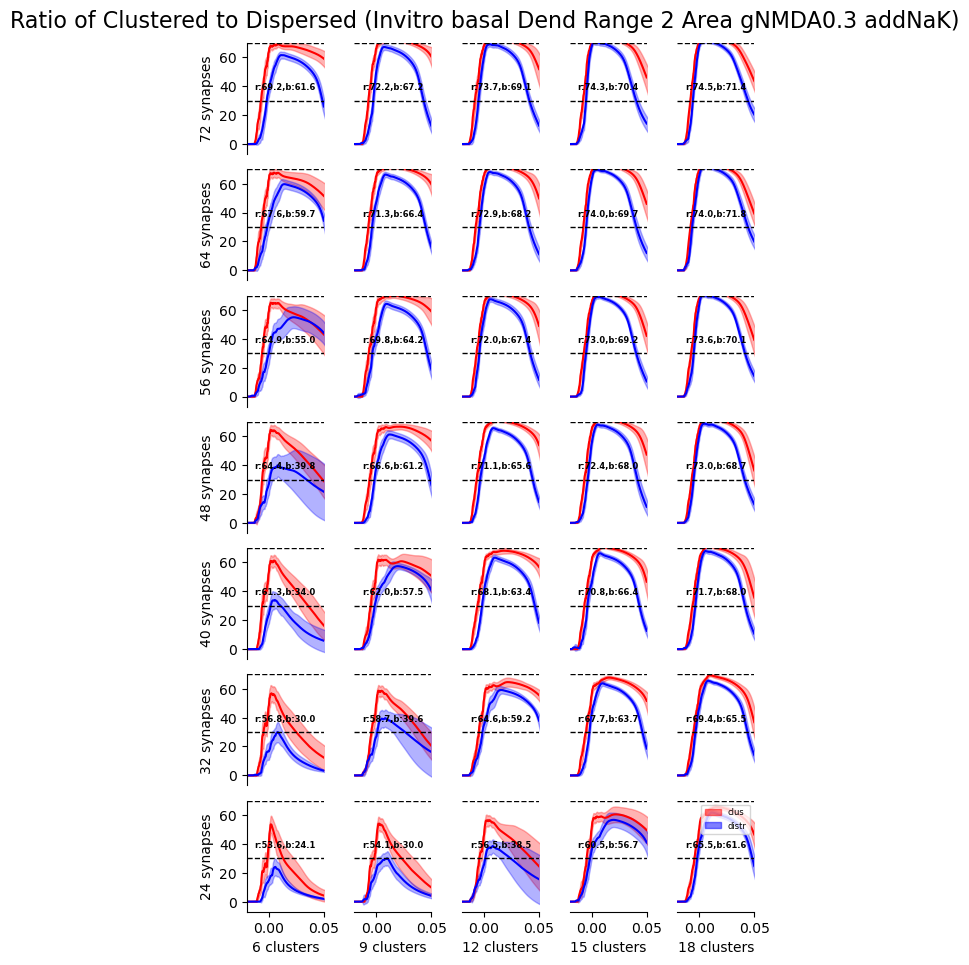

In [5]:
# Define parameters
num_clus = [6, 9, 12, 15, 18] 
num_syn_per_clus = [24, 32, 40, 48, 56, 64, 72]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'clus', 'distr'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0,1,2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invitro_variedW_tau90_shifted_addNaK_g0.3', 
                                                                                                                                    f'distr_invitro_variedW_tau90_shifted_addNaK_g0.3', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=30)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0,1,2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro {anal_loc} {rec_loc} Range {range_idx} {rec_attr} gNMDA0.3 addNaK)',
                                         attr1, attr2)
    

1.52e-01 2.33e+00
1.62e-01 2.13e+00
1.44e-01 2.39e+00
1.35e-01 2.40e+00
1.25e-01 2.84e+00
1.34e-01 2.55e+00
2.51e-01 2.60e+00
1.80e-01 2.22e+00
3.79e-01 3.53e+00
1.91e-01 2.74e+00
6.03e-01 5.09e+00
2.56e-01 3.72e+00


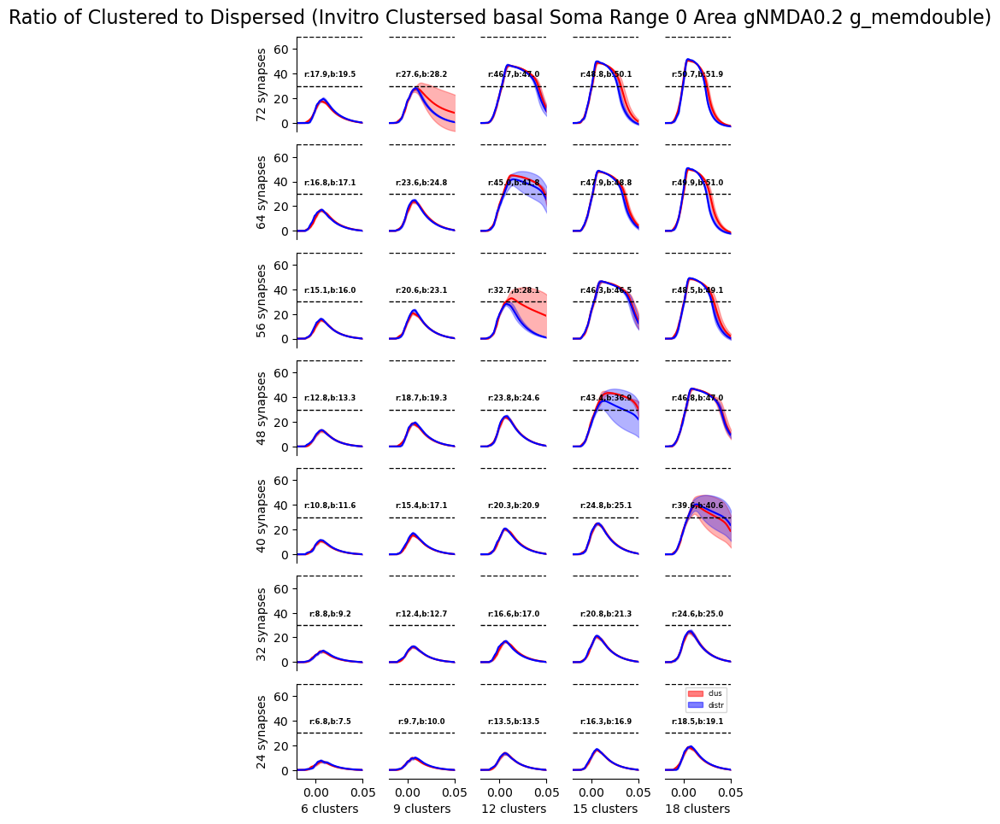

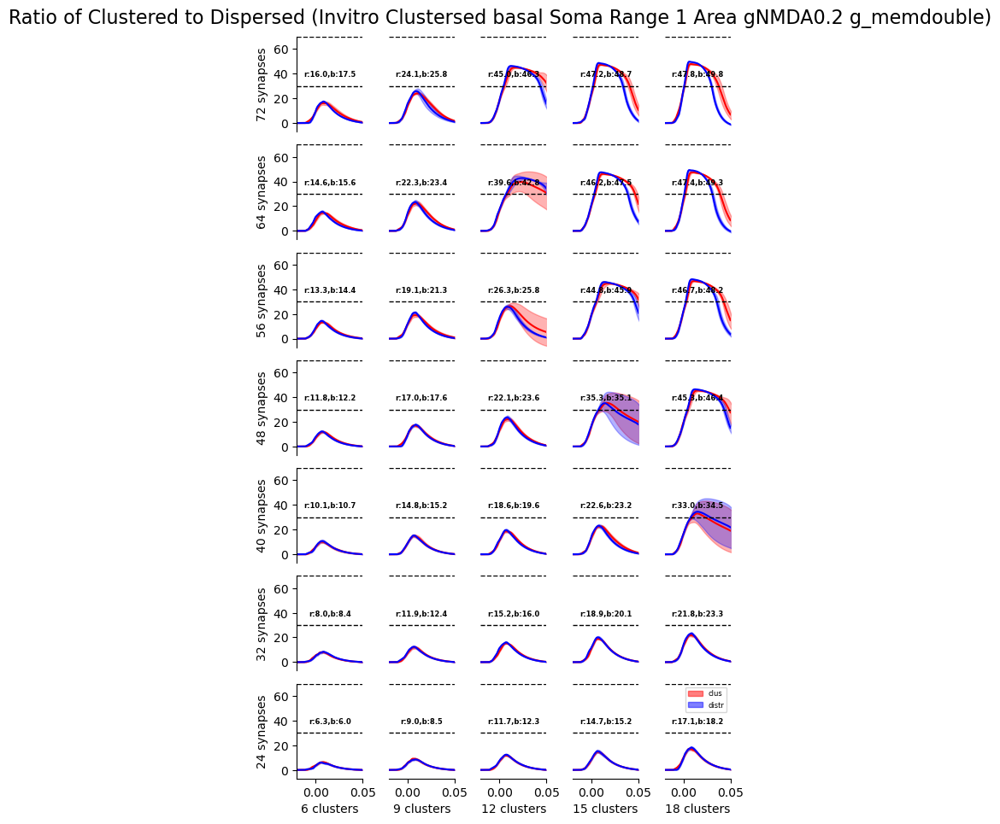

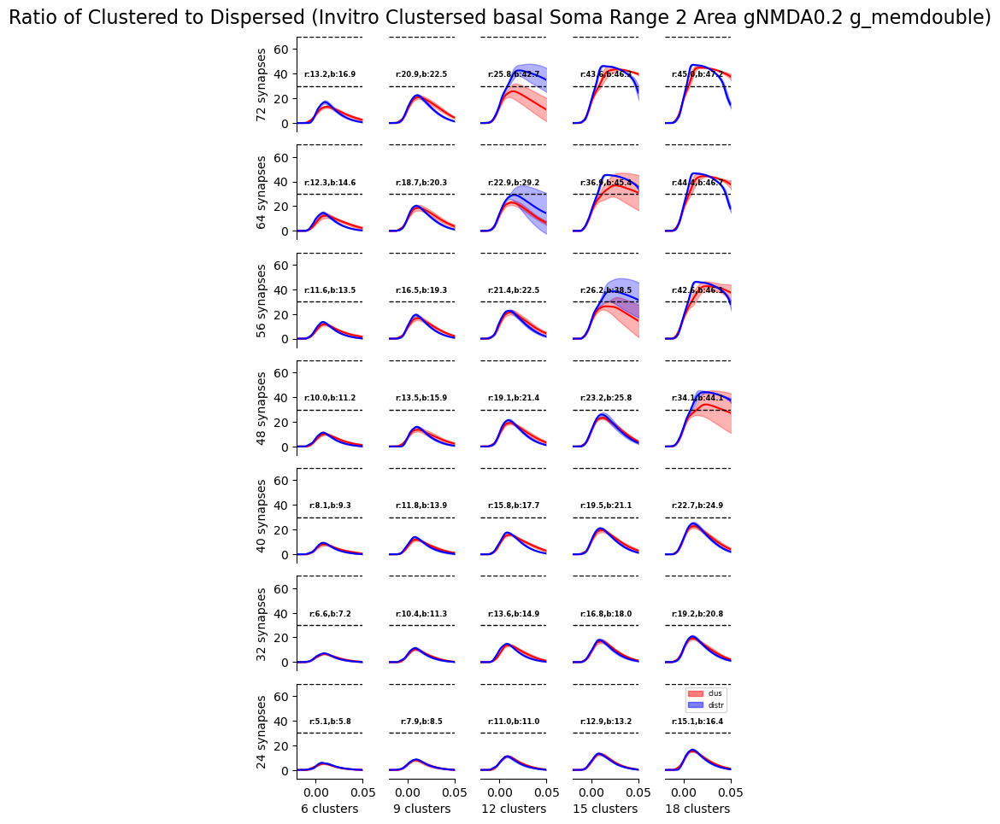

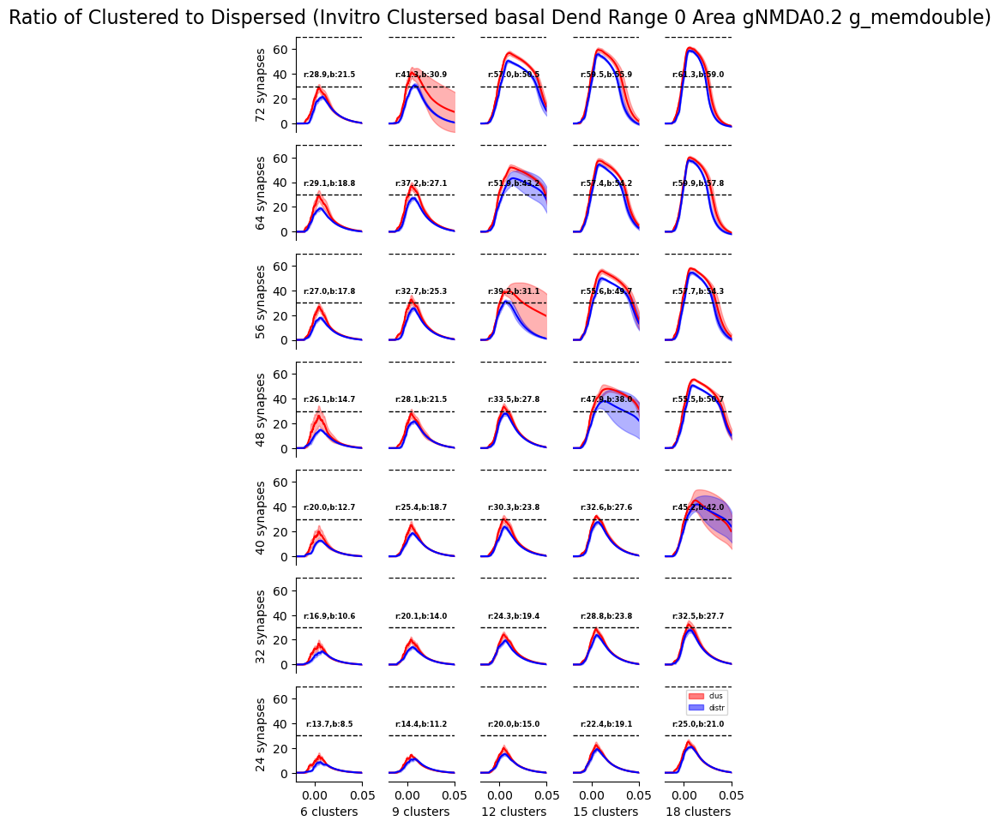

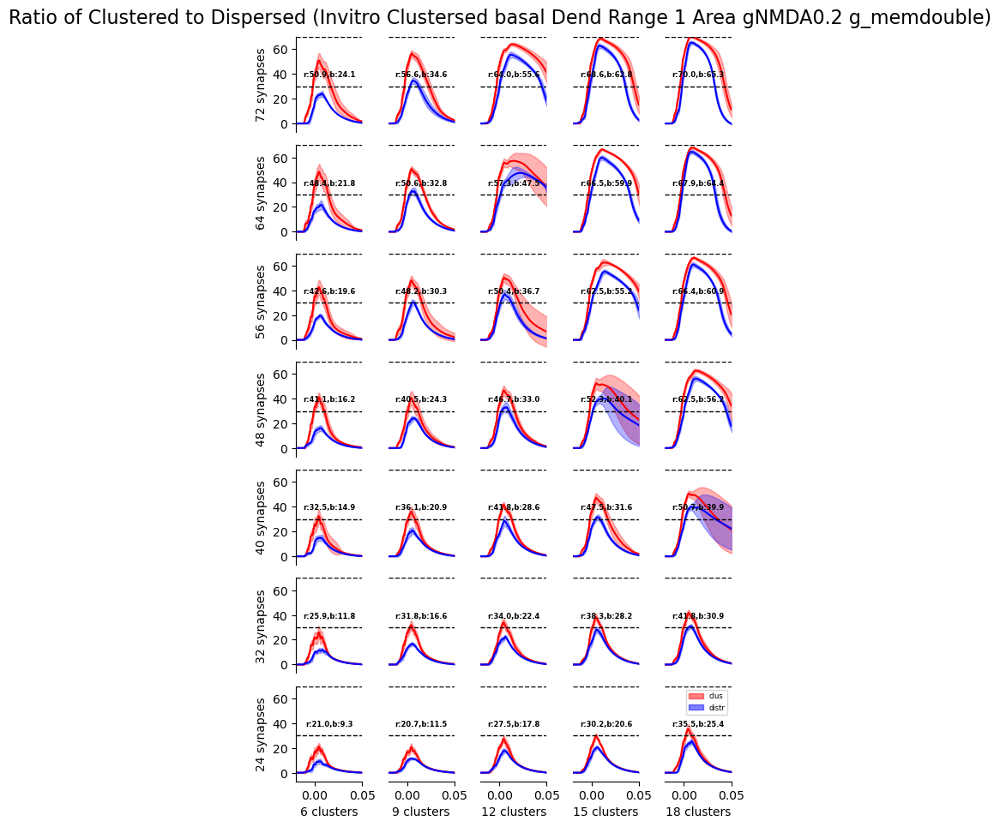

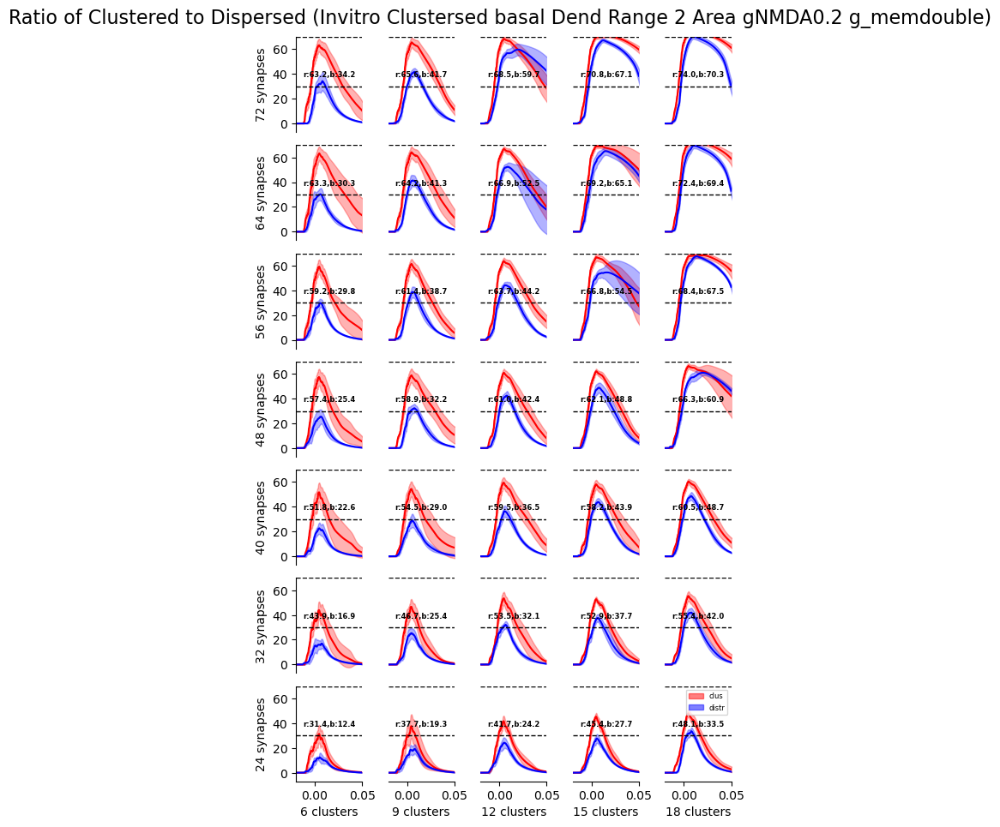

In [20]:
# Define parameters
num_clus = [6, 9, 12, 15, 18] 
num_syn_per_clus = [24, 32, 40, 48, 56, 64, 72]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'clus', 'distr'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0,1,2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invitro_variedW_tau90_shifted_doubleg', 
                                                                                                                                    f'distr_invitro_variedW_tau90_shifted_doubleg', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=10)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0,1,2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro Clustersed {anal_loc} {rec_loc} Range {range_idx} {rec_attr} gNMDA0.2 g_memdouble)',
                                         attr1, attr2)
    

### New in vivo

6.40e-03 1.09e+00
2.17e-02 1.04e+00
6.28e-03 1.03e+00
1.62e-02 1.20e+00
3.87e-03 1.34e+00
1.12e-02 1.03e+00
6.03e-02 1.29e+00
4.95e-02 1.01e+00
1.15e-01 1.67e+00
9.47e-02 1.26e+00
3.07e-01 3.64e+00
1.93e-01 1.60e+00


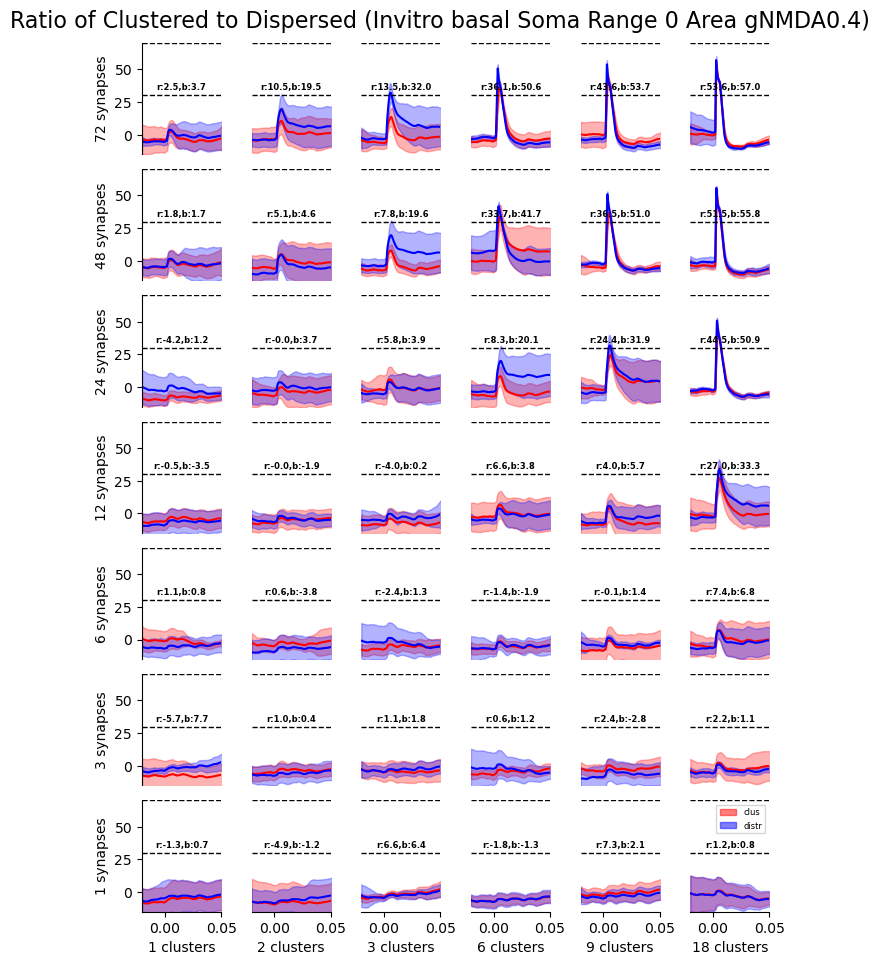

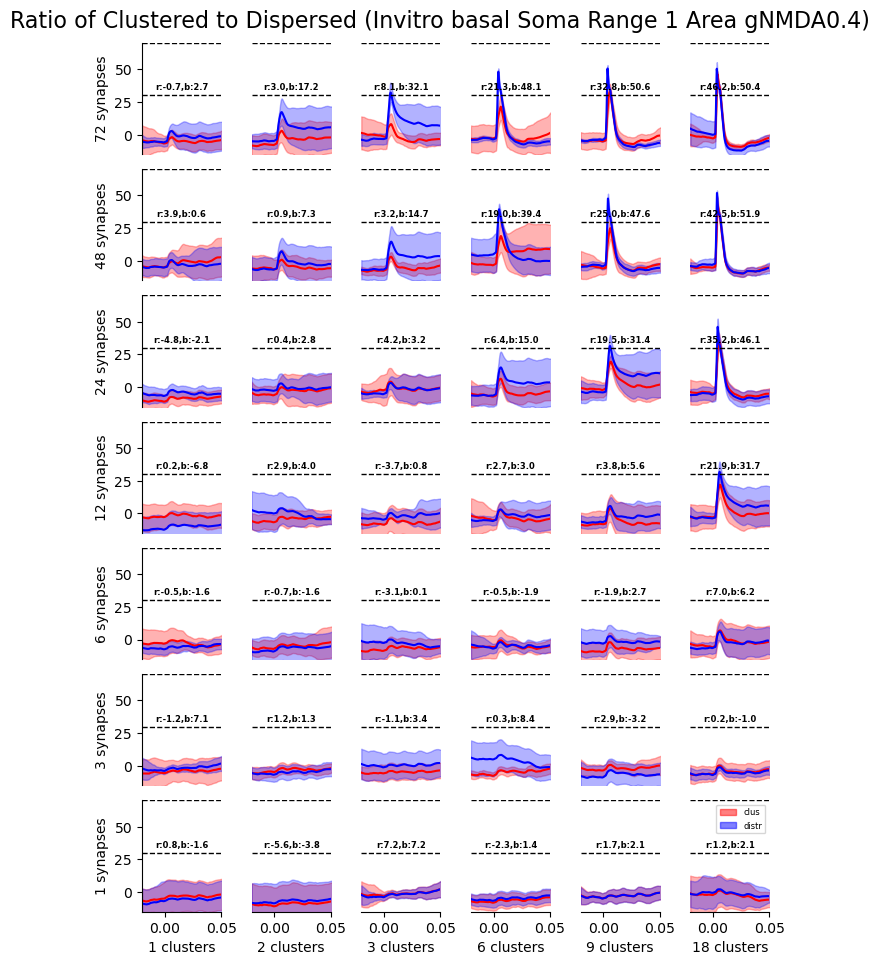

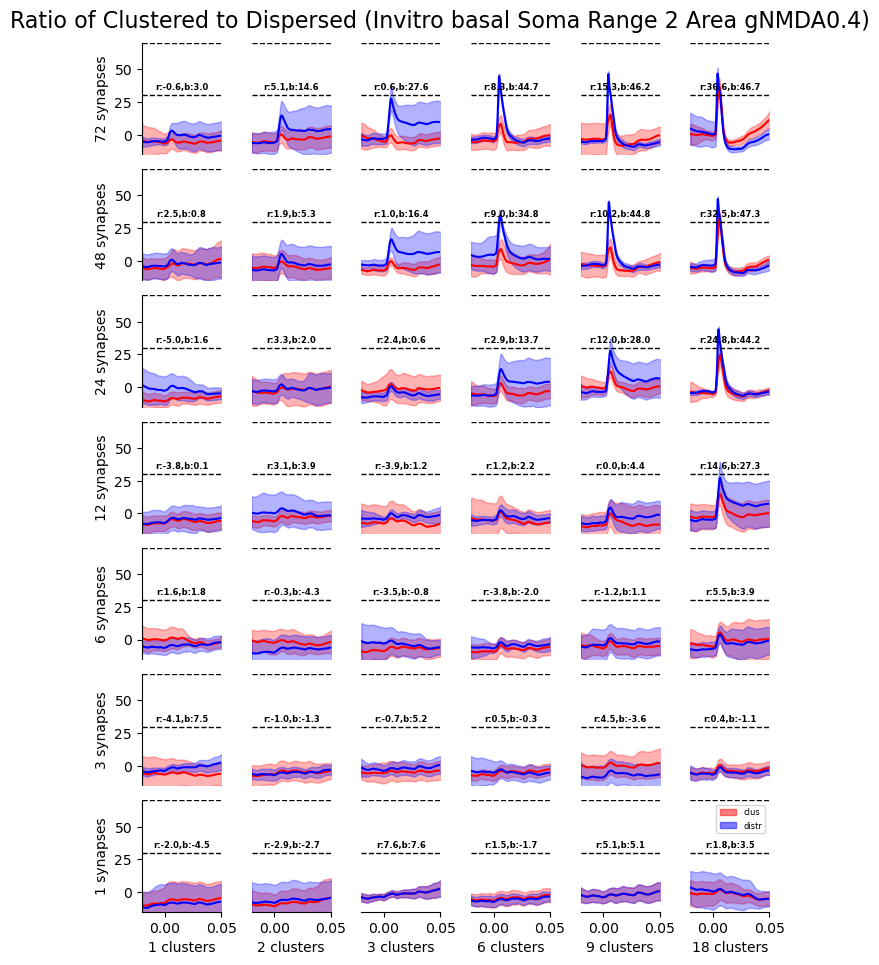

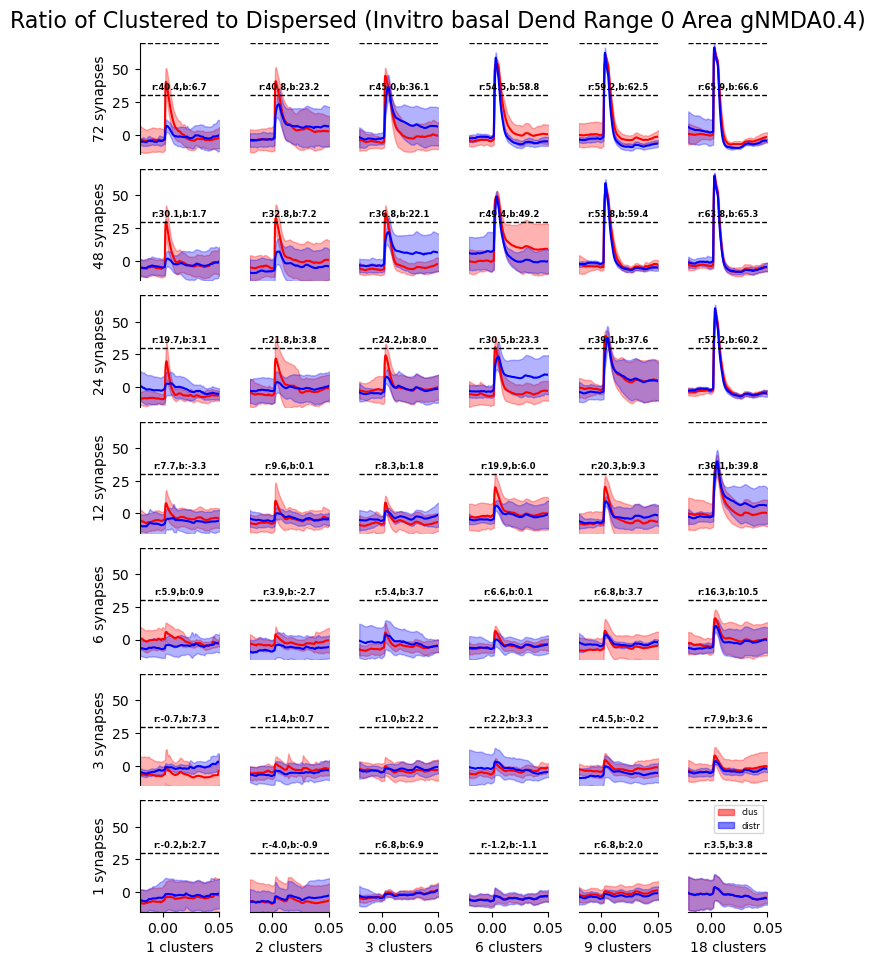

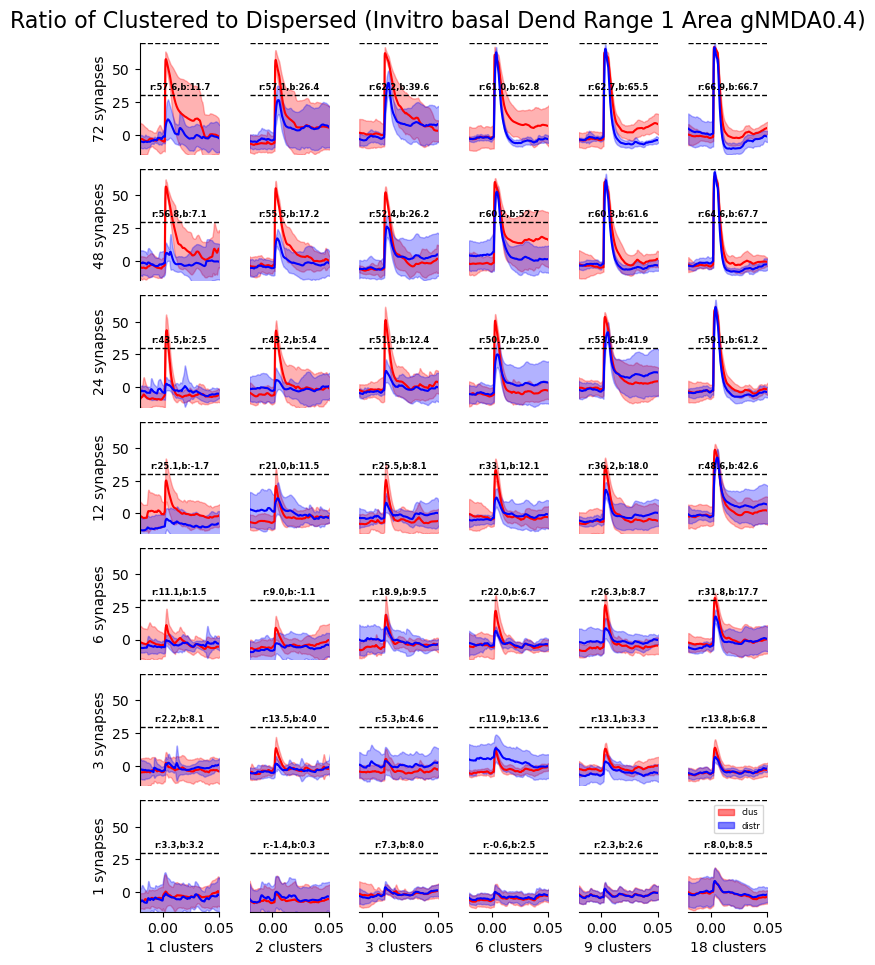

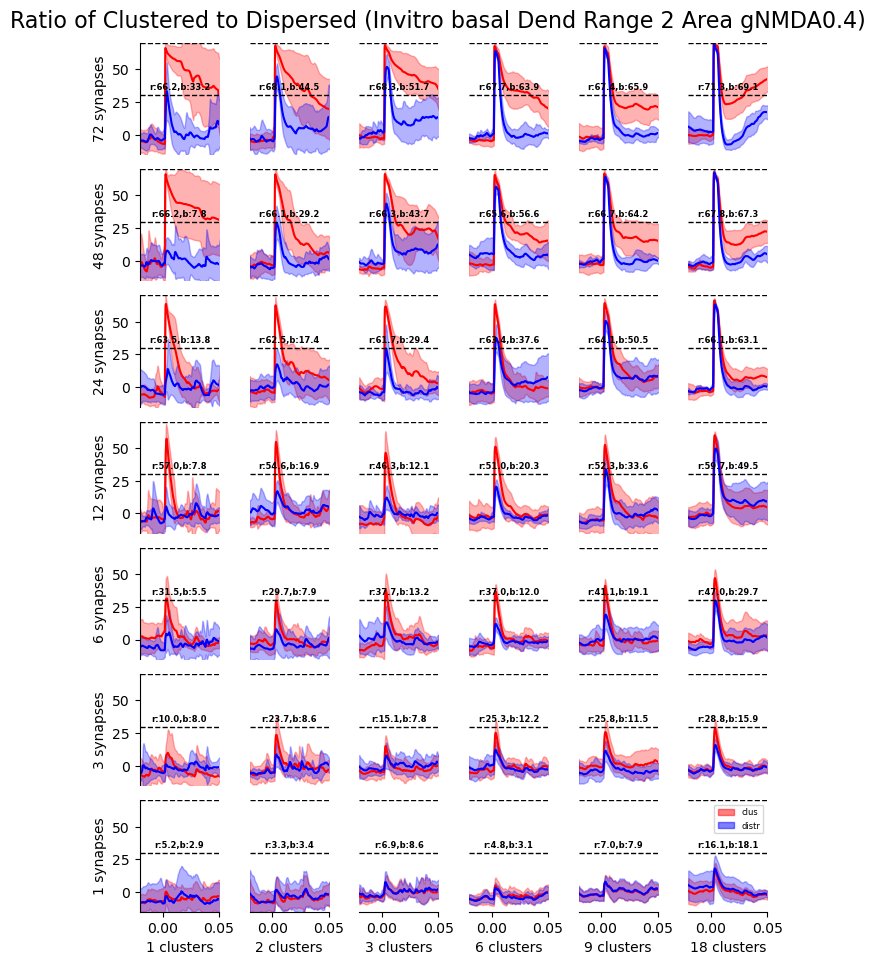

In [40]:
# Define parameters
num_clus = [1, 2, 3, 6, 9, 18] 
num_syn_per_clus = [1, 3, 6, 12, 24, 48, 72]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'clus', 'distr'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0,1,2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invivo_variedW_tau90_addNaK_overallbranchtest_woAP+Ca_withclus', 
                                                                                                                                    f'distr_invivo_variedW_tau90_addNaK_overallbranchtest_woAP+Ca_withclus', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=30)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0,1,2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro {anal_loc} {rec_loc} Range {range_idx} {rec_attr} gNMDA0.4)',
                                         attr1, attr2)
    

1.19e-01 4.23e-01


9.37e-02 3.99e-01
1.41e-01 4.36e-01
1.14e-01 4.23e-01
1.58e-01 5.30e-01
1.01e-01 3.97e-01
1.92e-01 5.49e-01
1.23e-01 3.80e-01
2.63e-01 1.70e+00
2.14e-01 5.41e-01
3.51e-01 3.13e+00
3.54e-01 1.45e+00


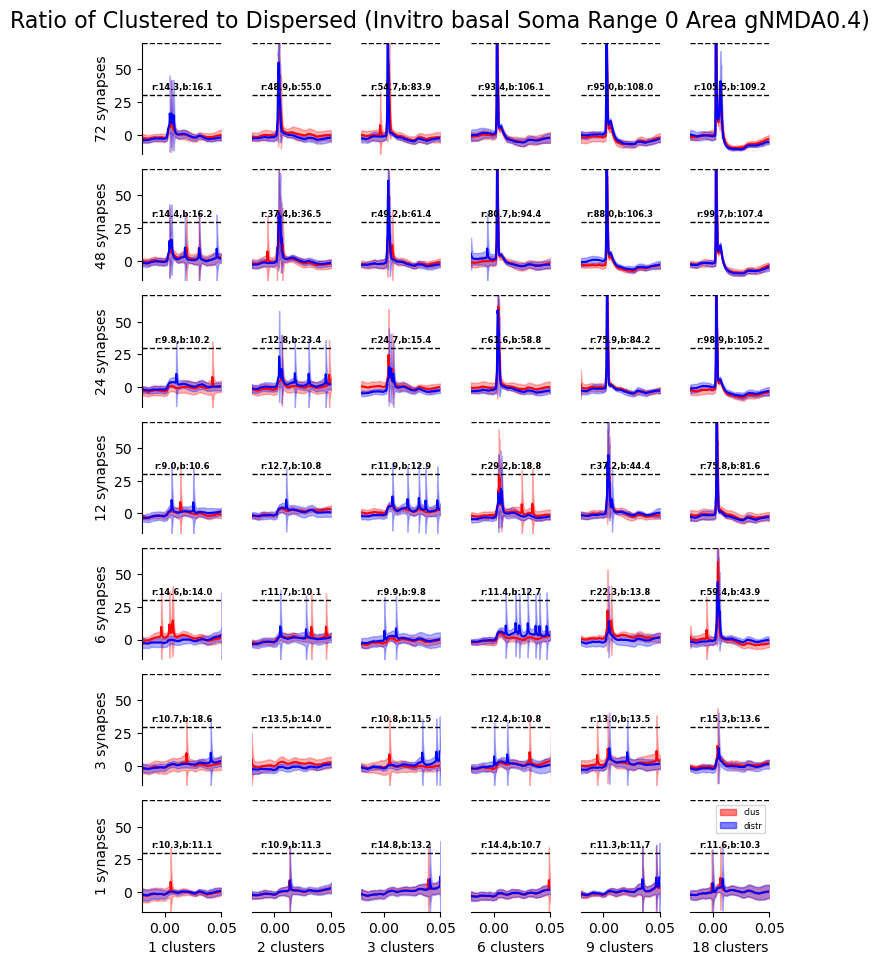

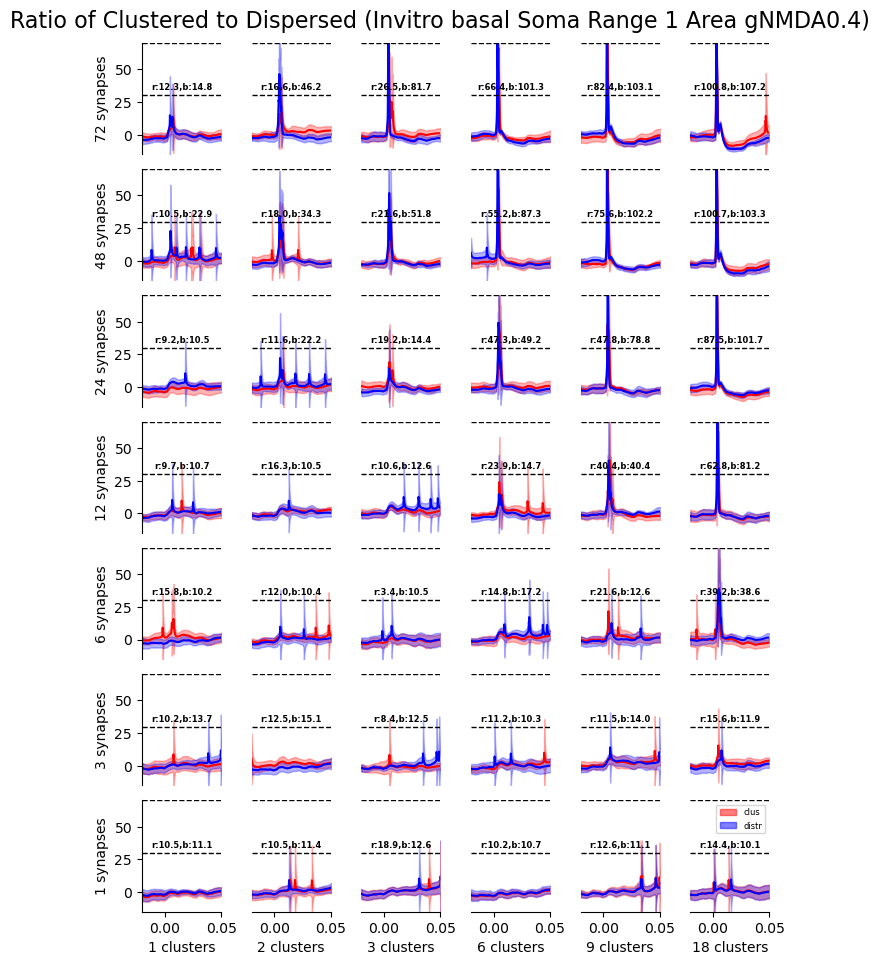

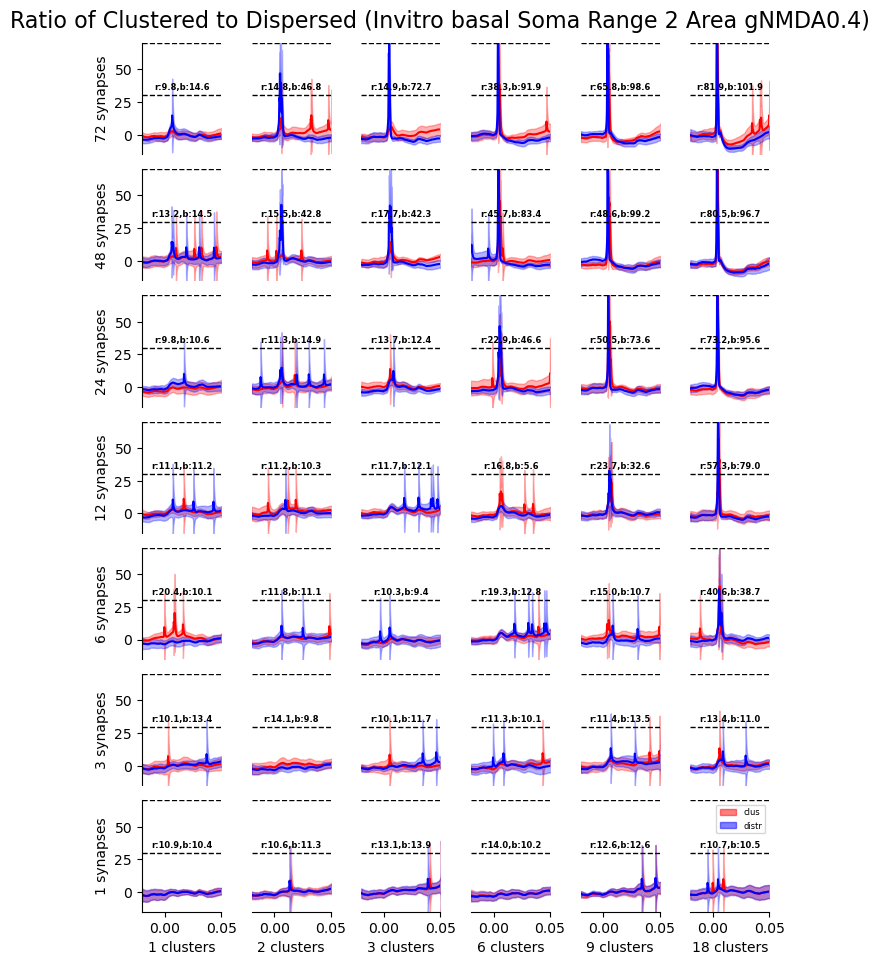

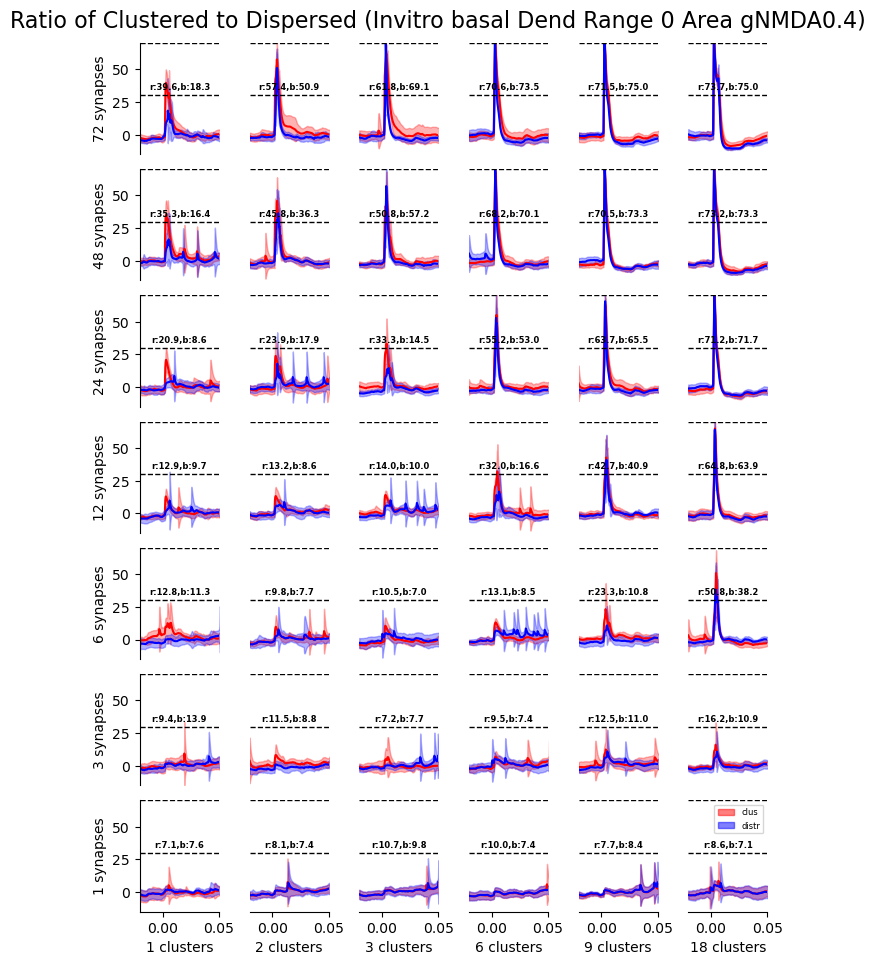

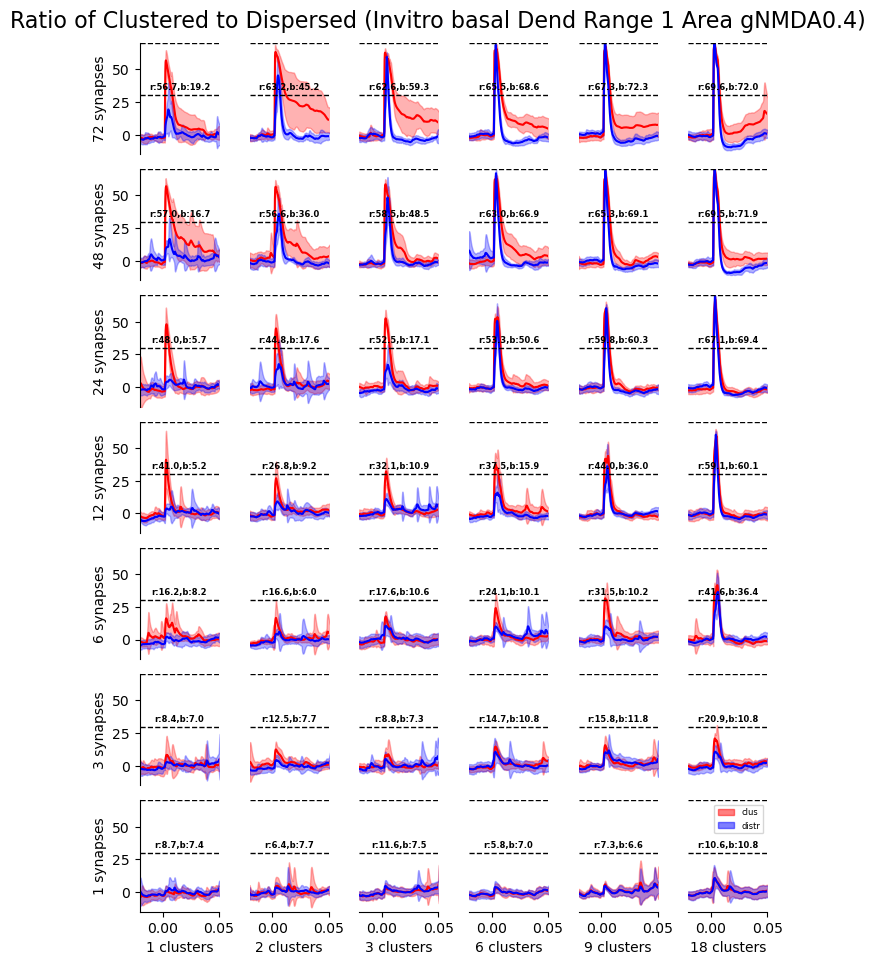

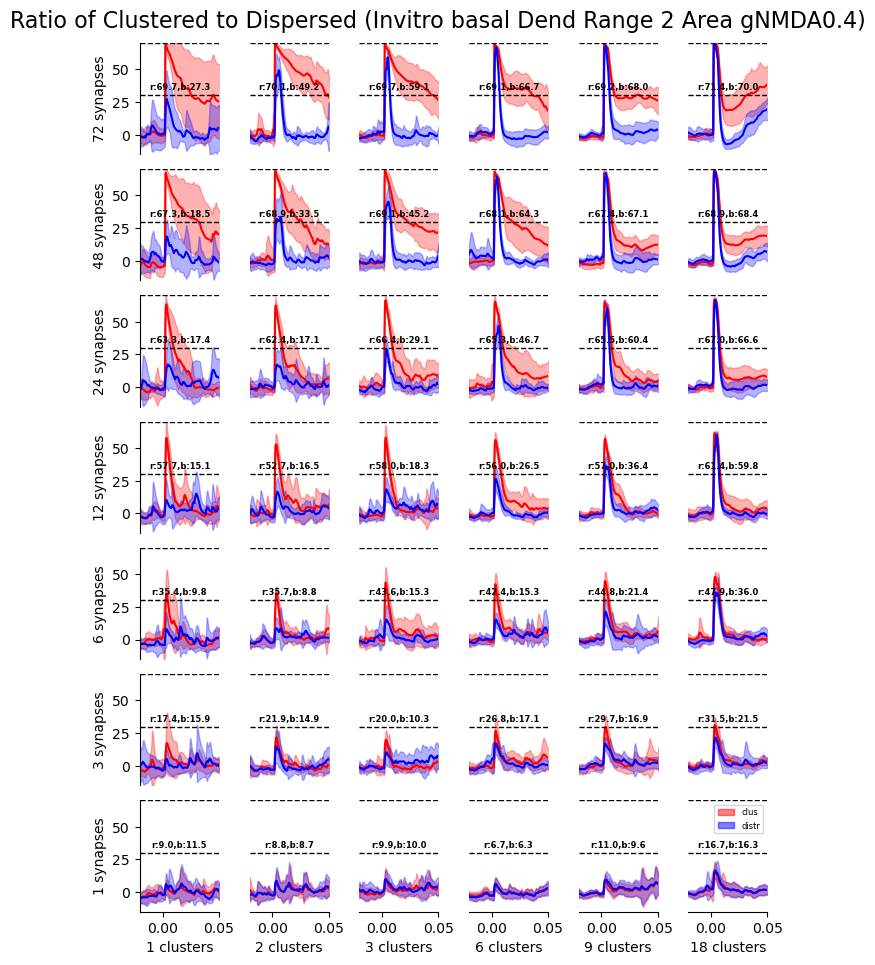

In [41]:
# Define parameters
num_clus = [1, 2, 3, 6, 9, 18] 
num_syn_per_clus = [1, 3, 6, 12, 24, 48, 72]  

anal_loc, rec_loc, rec_attr = 'basal', 'Soma', 'Area'
attr1, attr2 = 'clus', 'distr'

for rec_loc in ['Soma', 'Dend']:
    for range_idx in [0,1,2]:
        globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], \
        globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], \
        globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'] = full_analyze_case(f'clus_invivo_variedW_tau90_addNaK_overallbranchtest_withAPwoCa_withclus', 
                                                                                                                                    f'distr_invivo_variedW_tau90_addNaK_overallbranchtest_withAPwoCa_withclus', 
                                                                                                                                    anal_loc, rec_loc, rec_attr, range=range_idx, num_epochs=30)                                                                                                                           
    # Calculate ratio and draw heatmap
    for range_idx in [0,1,2]:
        calculate_ratio_and_draw_heatmap(globals()[f'attr1_dend_matrix_{range_idx}_area'], globals()[f'attr2_dend_matrix_{range_idx}_area'], 
                                         globals()[f'attr1_dend_root_v_{range_idx}_area'], globals()[f'attr2_dend_root_v_{range_idx}_area'], 
                                         globals()[f'attr1_dend_std_root_v_{range_idx}_area'], globals()[f'attr2_dend_std_root_v_{range_idx}_area'], 
                                         f'(Invitro {anal_loc} {rec_loc} Range {range_idx} {rec_attr} gNMDA0.4)',
                                         attr1, attr2)
    